https://natasha-klingenbrunn.medium.com/transformer-implementation-for-time-series-forecasting-a9db2db5c820

In [ ]:
## import drive
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
## imports
import torch
import torch.nn as nn
import torch.optim as optim
import torch.utils.data as data
import math
import copy
import numpy as np
import pandas as pd

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")  # Optional, just for confirmation

Using device: cuda


In [ ]:
test_data_import = pd.read_csv("/content/drive/MyDrive/results/test_data_not_normalised.csv")
train_data_nn_pre = pd.read_csv("/content/drive/MyDrive/results/train_data_not_normalised.csv")
val_data_nn_pre = test_data_import[test_data_import["patient_id"] == 'INH111'].copy()
test_data_nn_pre = test_data_import[test_data_import["patient_id"] != 'INH111'].copy()

print(f"Training Data has unique patient of [{train_data_nn_pre['patient_id'].unique()}]")
print(f"Testing Data has unique patient of [{test_data_nn_pre['patient_id'].unique()}]")
print(f"Validation Data has unique patient of [{val_data_nn_pre['patient_id'].unique()}]")
print(len(train_data_nn_pre), len(test_data_nn_pre), len(val_data_nn_pre))
print(len(train_data_nn_pre["patient_id"].unique()), len(test_data_nn_pre["patient_id"].unique()), len(val_data_nn_pre["patient_id"].unique()))

Training Data has unique patient of [['INH001' 'INH004' 'INH007' 'INH010' 'INH011' 'INH012' 'INH015' 'INH127'
 'INH018' 'INH023' 'INH024' 'INH028' 'INH100' 'INH101' 'INH102' 'INH107'
 'INH114' 'INH108' 'INH109' 'INH110' 'INH112' 'INH115' 'INH119' 'INH120'
 'INH121' 'INH123' 'INH128' 'INH131' 'INH138' 'INH139']]
Testing Data has unique patient of [['INH002' 'INH003' 'INH006' 'INH013' 'INH014' 'INH017' 'INH025' 'INH027'
 'INH103' 'INH106' 'INH113' 'INH117' 'INH135']]
Validation Data has unique patient of [['INH111']]
326894 159025 12738
30 13 1


In [ ]:
train_data_nn_pre

,Unnamed: 0,patient_id,age_x,sex_x,season_x,br_avg,br_std,act_level,step_count,activity,...,pm10,no,no2,o3,so2,co,sex_y,age_y,cubic_meterers_tv,inhale_tv
0,0,INH001,65,Female,Winter,19.542938,6.395616,0.116685,0,Sitting bent backwards,...,6.26,0.00,7.80,77.96,3.73,223.64,Female,65,0.000335,0.000573
1,1,INH001,65,Female,Winter,20.762518,2.593489,0.066786,0,Lying down on back,...,6.26,0.00,7.80,77.96,3.73,223.64,Female,65,0.000335,0.000613
2,2,INH001,65,Female,Winter,19.246227,2.828573,0.012011,0,Lying down on back,...,6.26,0.00,7.80,77.96,3.73,223.64,Female,65,0.000335,0.000560
3,3,INH001,65,Female,Winter,17.215359,4.588334,0.016393,0,Lying down on back,...,6.26,0.00,7.80,77.96,3.73,223.64,Female,65,0.000335,0.000550
4,4,INH001,65,Female,Winter,17.300472,2.968072,0.071856,9,Lying down on back,...,6.26,0.00,7.80,77.96,3.73,223.64,Female,65,0.000335,0.000707
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
326889,526497,INH139,47,Female,Winter,14.888110,0.611812,0.013874,0,Lying down to the left,...,37.16,139.47,74.03,0.00,56.74,674.25,Female,47,0.000284,0.000176
326890,526498,INH139,47,Female,Winter,14.972208,0.887404,0.014606,0,Lying down to the left,...,37.16,139.47,74.03,0.00,56.74,674.25,Female,47,0.000284,0.000156
326891,526499,INH139,47,Female,Winter,15.359121,1.316184,0.014437,0,Lying down to the left,...,37.16,139.47,74.03,0.00,56.74,674.25,Female,47,0.000284,0.000134
326892,526500,INH139,47,Female,Winter,15.506245,1.020111,0.014413,0,Lying down to the left,...,37.16,139.47,74.03,0.00,56.74,674.25,Female,47,0.000284,0.000108


In [ ]:
train_data_nn = train_data_nn_pre.copy()
test_data_nn = test_data_nn_pre.copy()

In [ ]:
train_data_nn.columns

Index(['Unnamed: 0', 'patient_id', 'age_x', 'sex_x', 'season_x', 'br_avg',
       'br_std', 'act_level', 'step_count', 'activity', 'latitude_x',
       'longitude_x', 'season_y', 'pm2_5_x', 'temperature', 'humidity',
       'time_diff', 'new_segment', 'segment_id', 'hour', 'dow', 'day_of_year',
       'hour_sin', 'hour_cos', 'dow_sin', 'dow_cos', 'yearly_sin',
       'yearly_cos', 'lat_round', 'lon_round', 'pm10', 'no', 'no2', 'o3',
       'so2', 'co', 'sex_y', 'age_y', 'cubic_meterers_tv', 'inhale_tv'],
      dtype='object')

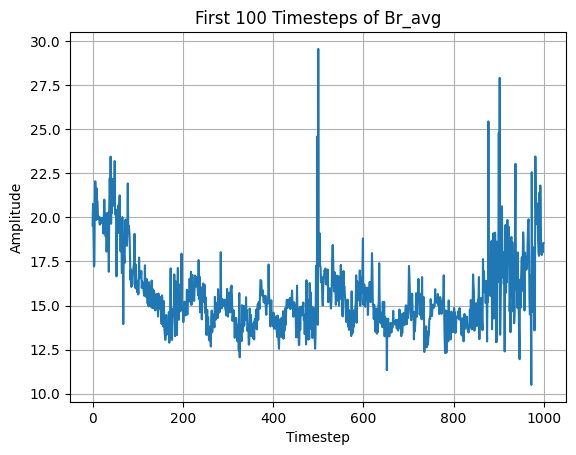

In [ ]:
import matplotlib.pyplot as plt
plt.plot(train_data_nn['br_avg'][:1000])
plt.title("First 100 Timesteps of Br_avg")
plt.xlabel("Timestep")
plt.ylabel("Amplitude")
plt.grid(True)
plt.show()


In [ ]:
from torch.utils.data import Dataset, DataLoader
# ============================== DEFINING INDIVIDUAL POSITIONING WITHIN DIFFERENT BATCHES ============================
class PositionalEncoding(nn.Module):
    def __init__(self, d_model, max_len=200):
        super().__init__()
        pe = torch.zeros(max_len, d_model)
        position = torch.arange(0, max_len, dtype=torch.float).unsqueeze(1)
        div_term = torch.exp(
            torch.arange(0, d_model, 2, dtype=torch.float) *
            (-math.log(10000.0) / d_model))
        pe[:, 0::2] = torch.sin(position * div_term)
        pe[:, 1::2] = torch.cos(position * div_term)
        pe = pe.unsqueeze(1)  # (max_len, 1, d_model)
        self.register_buffer('pe', pe)

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        x = x + self.pe[:x.size(0)]
        return x

# ============================== DEFINING CLASS DATASET TO HANDLE THE DATA ============================
class SlidingWindowDataset(Dataset):
    def __init__(self, data, window_size=8, forecast_steps=1, step=1):
        """
        Similar to professor's concat_timesteps but as a PyTorch Dataset
        """
        self.window_size = window_size
        self.forecast_steps = forecast_steps
        self.step = step

        # Create sliding windows
        n_samples, n_features = data.shape
        num_windows = (n_samples - window_size - forecast_steps) // step + 1

        self.windows = []
        self.targets = []

        for i in range(num_windows):
            start = i * step
            window = data[start:start + window_size]
            target = data[start + window_size:start + window_size + forecast_steps]

            self.windows.append(window)
            self.targets.append(target)

    def __len__(self):
        return len(self.windows)

    def __getitem__(self, idx):
        window = torch.FloatTensor(self.windows[idx])
        target = torch.FloatTensor(self.targets[idx])

        # For single step prediction, squeeze the target
        if self.forecast_steps == 1:
            target = target.squeeze(0)

        return window, target


In [ ]:
class CustomTransformerEncoderLayer(nn.Module):
    def __init__(self, d_model, nhead, dim_feedforward=512, dropout=0.1):
        super().__init__()
        self.self_attn = nn.MultiheadAttention(d_model, nhead, dropout=dropout, batch_first=False)
        self.linear1 = nn.Linear(d_model, dim_feedforward)
        self.dropout = nn.Dropout(dropout)
        self.linear2 = nn.Linear(dim_feedforward, d_model)
        self.norm1 = nn.LayerNorm(d_model)
        self.norm2 = nn.LayerNorm(d_model)
        self.dropout1 = nn.Dropout(dropout)
        self.dropout2 = nn.Dropout(dropout)
        self.activation = F.relu

    def forward(self, src, src_mask=None, src_key_padding_mask=None):
        attn_output, attn_weights = self.self_attn(
            src, src, src,
            attn_mask=src_mask,
            key_padding_mask=src_key_padding_mask,
            need_weights=True,
            average_attn_weights=False
        )
        src2 = self.dropout1(attn_output)
        src = self.norm1(src + src2)
        src2 = self.linear2(self.dropout(self.activation(self.linear1(src))))
        src = self.norm2(src + self.dropout2(src2))
        return src, attn_weights



class VariationalTimeSeriesTransformer(nn.Module):
    def __init__(
        self,
        input_features: int = 11,
        d_model: int = 128,
        latent_dim: int = 64,  # New: Latent dimension
        nhead: int = 8,
        num_layers: int = 6,
        dim_feedforward: int = 512,
        dropout: float = 0.2,
        forecast_steps: int = 1,
        output_features: int = 11
    ):
        super().__init__()

        self.input_proj = nn.Linear(input_features, d_model)
        self.pos_encoder = PositionalEncoding(d_model)

        ## trying to plot attention's map

        self.encoder_layers = nn.ModuleList([
            CustomTransformerEncoderLayer(
                d_model=d_model,
                nhead=nhead,
                dim_feedforward=dim_feedforward,
                dropout=dropout
            ) for _ in range(num_layers)
        ])



        # encoder_layer = nn.TransformerEncoderLayer(
        #     d_model=d_model,
        #     nhead=nhead,
        #     dim_feedforward=dim_feedforward,
        #     dropout=dropout,
        # )
        # self.transformer_encoder = nn.TransformerEncoder(
        #     encoder_layer,
        #     num_layers=num_layers,
        # )

        # Latent projection
        self.mean_layer = nn.Linear(d_model, latent_dim)
        self.logvar_layer = nn.Linear(d_model, latent_dim)

        # Decoder maps from latent space → forecast
        self.decoder = nn.Sequential(
            nn.Linear(latent_dim, dim_feedforward),
            nn.ReLU(),
            nn.Linear(dim_feedforward, output_features * forecast_steps),
        )

        self.d_model = d_model
        self.latent_dim = latent_dim
        self.forecast_steps = forecast_steps
        self.output_features = output_features

    def reparameterize(self, mu: torch.Tensor, logvar: torch.Tensor) -> torch.Tensor:
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        return mu + eps * std

    def forward(self, src: torch.Tensor):
        """
        Args:
            src: (seq_len, batch, input_features)
        Returns:
            recon: (batch, forecast_steps, output_features)
            mu: (batch, latent_dim)
            logvar: (batch, latent_dim)
        """
        x = self.input_proj(src) * math.sqrt(self.d_model)
        x = self.pos_encoder(x)

        # enc_out = self.transformer_encoder(x)  # (seq_len, batch, d_model)
        #pLOTTING ATTENTION'S MAP
        attentions = []
        for layer in self.encoder_layers:
          x, attn_weights = layer(x)
          attentions.append(attn_weights)
        enc_out = x


        # Take last time-step
        last = enc_out[-1, :, :]  # (batch, d_model)

        # Latent space
        mu = self.mean_layer(last)      # (batch, latent_dim)
        logvar = self.logvar_layer(last)  # (batch, latent_dim)

        # Sample from latent distribution
        z = self.reparameterize(mu, logvar)  # (batch, latent_dim)

        # Decode
        recon = self.decoder(z)  # (batch, forecast_steps * output_features)

        if self.forecast_steps > 1:
            recon = recon.view(-1, self.forecast_steps, self.output_features)

        return recon, mu, logvar, attentions


In [ ]:
class LatentDiscriminator(nn.Module):
    def __init__(self, latent_dim, hidden_dim=128):
        super().__init__()
        self.net = nn.Sequential(
            nn.Linear(latent_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, 1),
            nn.Sigmoid()  # Output: probability z is from N(0, I)
        )

    def forward(self, z):
        return self.net(z)

In [ ]:
import torch.nn.functional as F
from torch.nn import BCELoss

def train_model_aae(
    model,
    train_loader,
    val_loader,
    optimizer,
    discriminator,
    disc_optimizer,
    device,
    epochs=30,
    patience=5,
    min_delta=1e-4,
    adv_weight=0.01  # controls strength of adversarial regularization
):
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', patience=3, factor=0.5)
    adversarial_loss = BCELoss()

    best_val_loss = float('inf')
    patience_counter = 0

    for epoch in range(1, epochs + 1):
        model.train()
        discriminator.train()
        total_train_loss = 0.0

        for inputs, targets in train_loader:
            inputs = inputs.permute(1, 0, 2).to(device)  # (seq_len, batch, features)
            targets = targets.to(device)

            # ======== Phase 1: Train Discriminator ========
            with torch.no_grad():
                # Corrected unpacking to expect 4 values
                outputs, mu, logvar, _ = model(inputs)

                z_fake = model.reparameterize(mu, logvar).detach()

            z_real = torch.randn_like(z_fake).to(device)

            real_labels = torch.ones(z_real.size(0), 1).to(device)
            fake_labels = torch.zeros(z_fake.size(0), 1).to(device)

            disc_optimizer.zero_grad()
            real_preds = discriminator(z_real)
            fake_preds = discriminator(z_fake)

            disc_loss = adversarial_loss(real_preds, real_labels) + \
                        adversarial_loss(fake_preds, fake_labels)
            disc_loss.backward()
            disc_optimizer.step()

            # ======== Phase 2: Train VAE Generator ========
            optimizer.zero_grad()
            # Corrected unpacking to expect 4 values
            outputs, mu, logvar, attentions = model(inputs)

            z_gen = model.reparameterize(mu, logvar)

            gen_preds = discriminator(z_gen)
            adv_loss = adversarial_loss(gen_preds, real_labels)

            if model.forecast_steps > 1:
                outputs = outputs.view(targets.shape[0], targets.shape[1], targets.shape[2])

            recon_loss = F.mse_loss(outputs, targets, reduction='mean')
            loss = recon_loss + adv_weight * adv_loss

            loss.backward()
            optimizer.step()

            total_train_loss += loss.item()

        avg_train_loss = total_train_loss / len(train_loader)

        # ======== Validation Phase ========
        model.eval()
        discriminator.eval()  # Add this line to set discriminator to eval mode
        total_val_loss = 0.0
        total_val_recon = 0.0
        with torch.no_grad():
            for inputs, targets in val_loader:
                inputs = inputs.permute(1, 0, 2).to(device)
                targets = targets.to(device)

                # Corrected unpacking to expect 4 values
                outputs, mu, logvar, _ = model(inputs)

                if model.forecast_steps > 1:
                    outputs = outputs.view(targets.shape[0], targets.shape[1], targets.shape[2])

                recon_loss = F.mse_loss(outputs, targets, reduction='mean')
                val_loss = recon_loss  # no KL in AAE-style

                total_val_loss += val_loss.item()
                total_val_recon += recon_loss.item()

        avg_val_loss = total_val_loss / len(val_loader)
        avg_val_recon = total_val_recon / len(val_loader)

        scheduler.step(avg_val_loss)

        print(f"Epoch {epoch}/{epochs} - Train Loss: {avg_train_loss:.6f} - Val Loss: {avg_val_loss:.6f} - Recon: {avg_val_recon:.6f} - Disc Loss: {disc_loss.item():.6f} - Adv Loss: {adv_loss.item():.6f}")

        # Early Stopping
        if best_val_loss - avg_val_loss > min_delta:
            best_val_loss = avg_val_loss
            patience_counter = 0
        else:
            patience_counter += 1
            if patience_counter >= patience:
                print(f"Early stopping at epoch {epoch} - Best Val Loss: {best_val_loss:.6f}")
                break

In [ ]:
## Useful to filter down!

print(train_data_nn_pre["patient_id"].unique(), test_data_nn_pre["patient_id"].unique())
print(len(train_data_nn_pre["patient_id"].unique()), len(test_data_nn_pre["patient_id"].unique()))

train_data_nn_pre = train_data_nn_pre[train_data_nn_pre["patient_id"].isin(['INH001','INH003', 'INH006', 'INH106' ,'INH114' ,'INH110'])]
test_data_nn_pre = test_data_nn_pre[test_data_nn_pre["patient_id"].isin(['INH012','INH014','INH107' ])]

print(train_data_nn_pre["patient_id"].unique(), test_data_nn_pre["patient_id"].unique())
print(len(train_data_nn_pre["patient_id"].unique()), len(test_data_nn_pre["patient_id"].unique()))

['INH001' 'INH004' 'INH007' 'INH010' 'INH011' 'INH012' 'INH015' 'INH127'
 'INH018' 'INH023' 'INH024' 'INH028' 'INH100' 'INH101' 'INH102' 'INH107'
 'INH114' 'INH108' 'INH109' 'INH110' 'INH112' 'INH115' 'INH119' 'INH120'
 'INH121' 'INH123' 'INH128' 'INH131' 'INH138' 'INH139'] ['INH002' 'INH003' 'INH006' 'INH013' 'INH014' 'INH017' 'INH025' 'INH027'
 'INH103' 'INH106' 'INH113' 'INH117' 'INH135']
30 13
['INH001' 'INH114' 'INH110'] ['INH014']
3 1


In [ ]:
train_data_nn_pre.columns

Index(['Unnamed: 0', 'patient_id', 'age_x', 'sex_x', 'season_x', 'br_avg',
       'br_std', 'act_level', 'step_count', 'activity', 'latitude_x',
       'longitude_x', 'season_y', 'pm2_5_x', 'temperature', 'humidity',
       'time_diff', 'new_segment', 'segment_id', 'hour', 'dow', 'day_of_year',
       'hour_sin', 'hour_cos', 'dow_sin', 'dow_cos', 'yearly_sin',
       'yearly_cos', 'lat_round', 'lon_round', 'pm10', 'no', 'no2', 'o3',
       'so2', 'co', 'sex_y', 'age_y', 'cubic_meterers_tv', 'inhale_tv'],
      dtype='object')

In [ ]:
## ================= INSTANTIATING AND CALLING THE MODEL ==================

# Hyperparameters
window_size = 8
forecast_steps = 1
batch_size = 32
d_model = 128
nhead = 8
num_layers = 6
dim_feedforward = 512
dropout = 0.2
lr = 1e-3
epochs = 3
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
data_train = train_data_nn_pre.copy()
data_test = test_data_nn_pre.copy()


feature_cols = ['br_avg', 'br_std', 'act_level', 'step_count','pm2_5_x', 'temperature', 'humidity', 'hour_sin', 'hour_cos', 'dow_sin', 'dow_cos', 'yearly_sin',
       'yearly_cos', 'lat_round', 'lon_round','pm10', 'no', 'no2', 'o3', 'so2', 'co','inhale_tv']

from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
scaler.fit(data_train[feature_cols])

train_data = scaler.transform(data_train[feature_cols])
test_data = scaler.transform(data_test[feature_cols])

# Create datasets
train_dataset = SlidingWindowDataset(train_data, window_size, forecast_steps)
test_dataset = SlidingWindowDataset(test_data, window_size, forecast_steps)

# Create dataloaders
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# Initialize model
model = VariationalTimeSeriesTransformer(
    input_features=len(feature_cols),
    d_model=d_model,
    nhead=nhead,
    num_layers=num_layers,
    dim_feedforward=dim_feedforward,
    dropout=dropout,
    forecast_steps=forecast_steps,
    output_features=len(feature_cols)
).to(device)

# Loss and optimizer
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=lr)

discriminator = LatentDiscriminator(latent_dim=model.latent_dim).to(device)
disc_optimizer = torch.optim.Adam(discriminator.parameters(), lr=1e-4)

# Train
train_model_aae(
    model=model,
    train_loader=train_loader,
    val_loader=test_loader,
    optimizer=optimizer,
    discriminator=discriminator,
    disc_optimizer=disc_optimizer,
    device=device,
    epochs=epochs,
    adv_weight=0.01  # adjust this
)

Epoch 1/3 - Train Loss: 0.013427 - Val Loss: 0.006752 - Recon: 0.006752 - Disc Loss: 1.421482 - Adv Loss: 0.670280
Epoch 2/3 - Train Loss: 0.009708 - Val Loss: 0.005232 - Recon: 0.005232 - Disc Loss: 1.367847 - Adv Loss: 0.723020
Epoch 3/3 - Train Loss: 0.009349 - Val Loss: 0.004968 - Recon: 0.004968 - Disc Loss: 1.407116 - Adv Loss: 0.678958


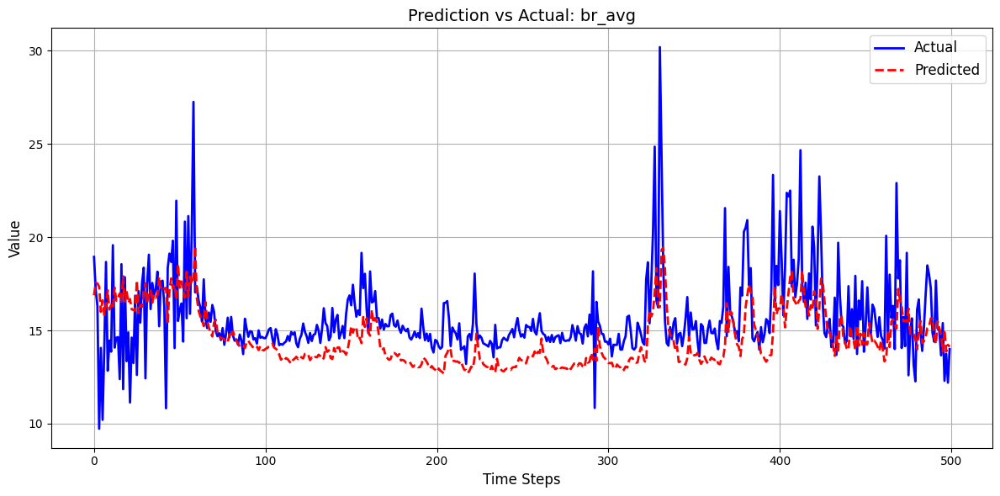

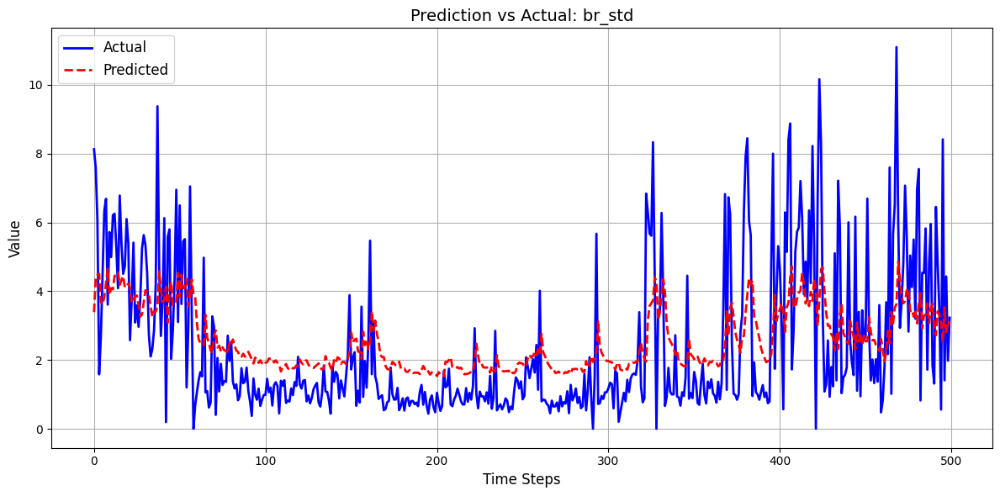

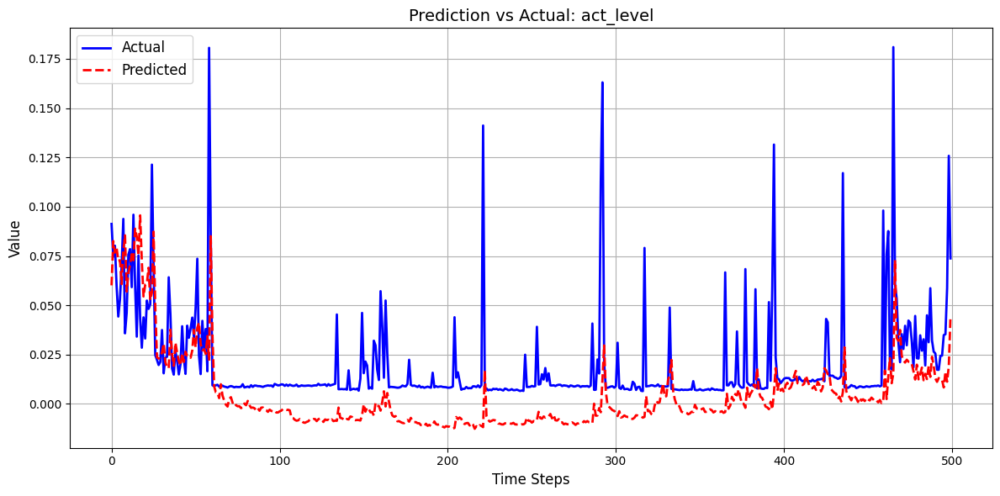

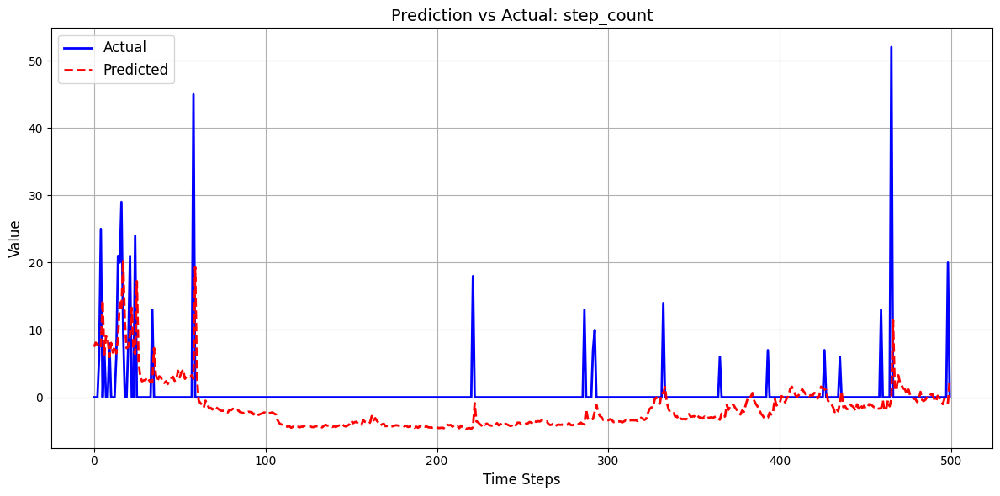

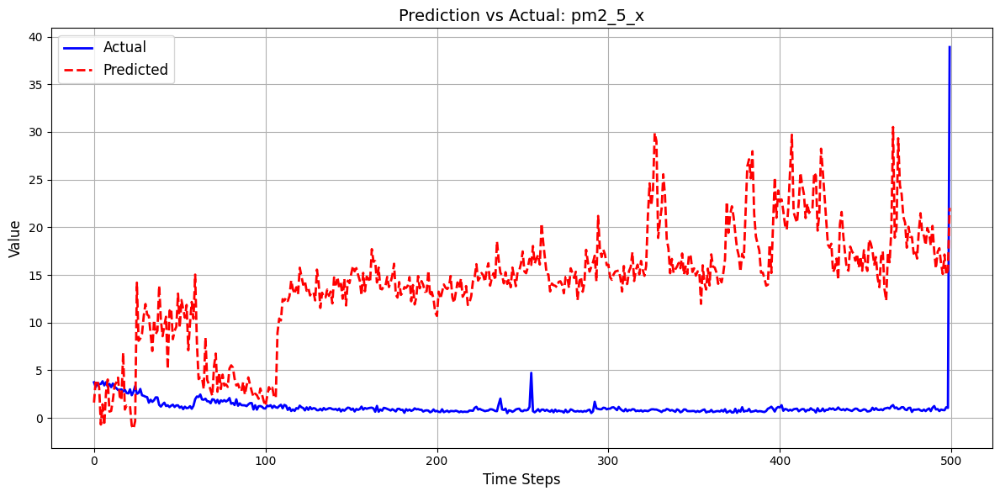

...

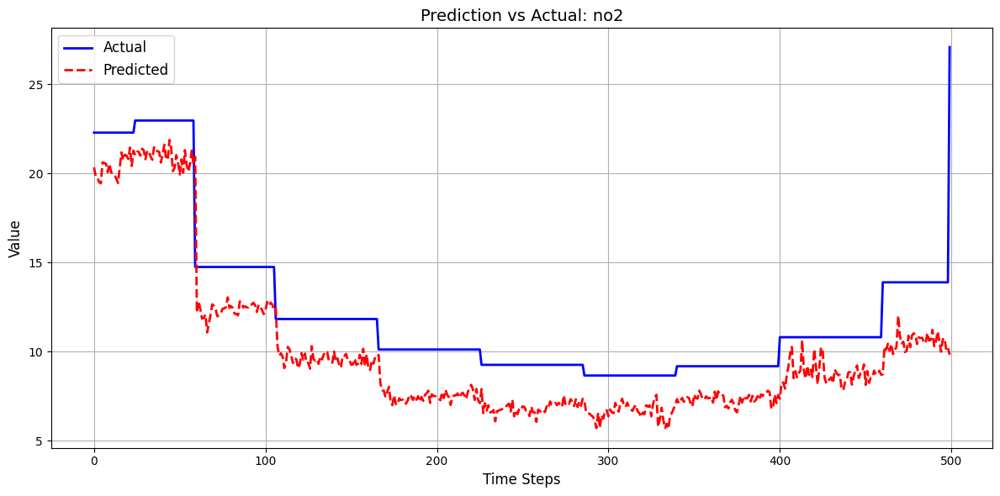

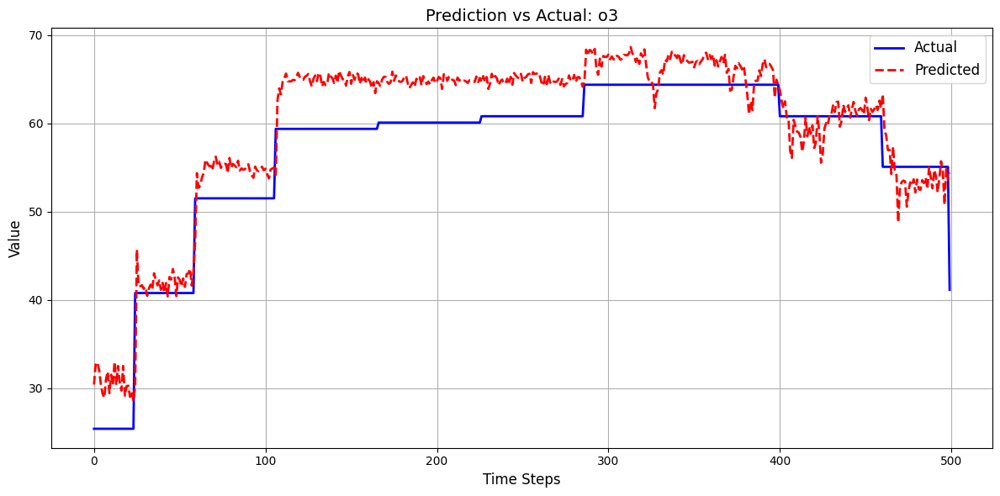

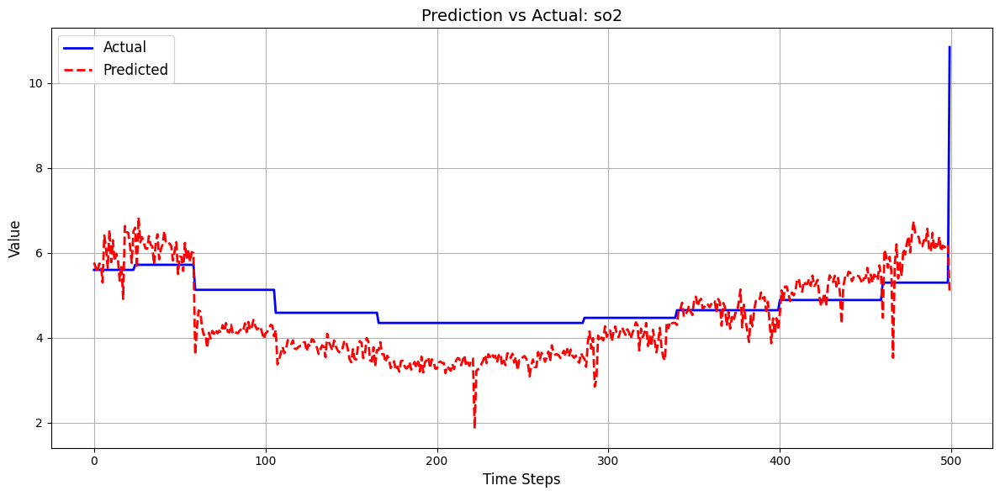

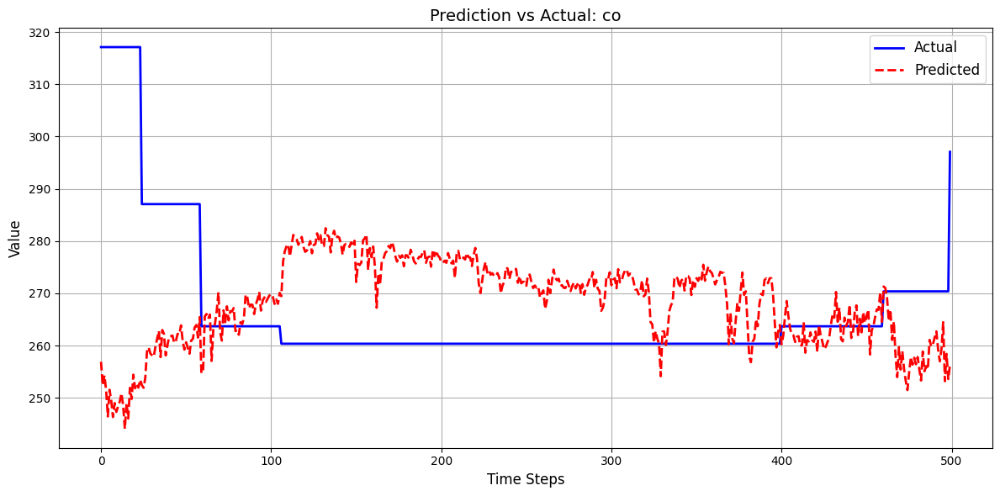

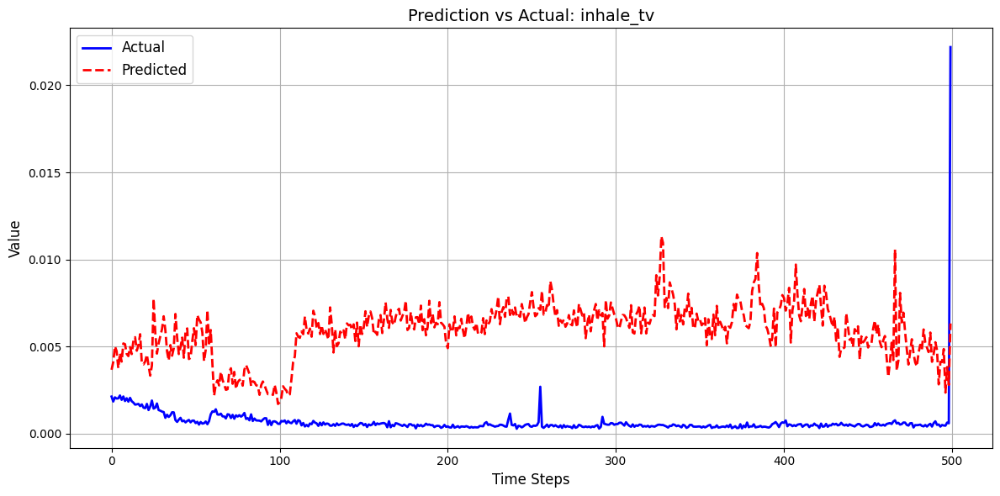


Overall Metrics:
MSE: 89.5375
MAE: 3.3705
R² Score: -5925288861302989824.0000

Per-feature Metrics:
br_avg:
  MSE: 4.5952, MAE: 1.4683, R²: 0.2039
br_std:
  MSE: 3.2487, MAE: 1.3831, R²: 0.3567
act_level:
  MSE: 0.0009, MAE: 0.0174, R²: 0.4948
step_count:
  MSE: 95.1114, MAE: 5.4880, R²: 0.6224
pm2_5_x:
  MSE: 298.2471, MAE: 16.0968, R²: -9.8170
temperature:
  MSE: 2.4878, MAE: 1.3883, R²: 0.6615
humidity:
  MSE: 13.5312, MAE: 3.3002, R²: -0.4958
hour_sin:
  MSE: 0.0127, MAE: 0.0777, R²: 0.9684
hour_cos:
  MSE: 0.0098, MAE: 0.0629, R²: 0.9751
dow_sin:
  MSE: 0.0064, MAE: 0.0573, R²: 0.9848
dow_cos:
  MSE: 0.0069, MAE: 0.0655, R²: 0.9878
yearly_sin:
  MSE: 0.0042, MAE: 0.0558, R²: -64.8905
yearly_cos:
  MSE: 0.0097, MAE: 0.0824, R²: -5.9243
lat_round:
  MSE: 0.0026, MAE: 0.0509, R²: 0.0000
lon_round:
  MSE: 0.0102, MAE: 0.1000, R²: -47239101.8035
pm10:
  MSE: 24.3359, MAE: 3.6195, R²: 0.8845
no:
  MSE: 263.3612, MAE: 11.0112, R²: 0.7815
no2:
  MSE: 10.4346, MAE: 2.1801, R²: 0.9753
o3:


In [ ]:
def evaluate_model(model, dataloader, device, scaler=None, feature_names=None):
    """
    Evaluate the model and plot predictions vs actual values for all features
    Similar to professor's plotting code but adapted for transformer

    Args:
        model: Trained model
        dataloader: DataLoader with test data
        device: torch device
        scaler: Optional scaler for inverse transformation
        feature_names: List of feature names for plotting
    """
    model.eval()
    all_preds = []
    all_targets = []

    with torch.no_grad():
        for inputs, targets in dataloader:
            inputs = inputs.permute(1, 0, 2).to(device)  # (seq_len, batch, features)
            outputs, mu, logvar, _ = model(inputs) # Corrected unpacking to expect 4 values

            # Store predictions and targets
            all_preds.append(outputs.cpu().numpy())
            all_targets.append(targets.cpu().numpy())

    # Concatenate all batches
    preds = np.concatenate(all_preds, axis=0)
    trues = np.concatenate(all_targets, axis=0)

    # If we predicted multiple steps, average them for visualization
    if preds.ndim == 3:  # (samples, forecast_steps, features)
        preds = preds.mean(axis=1)  # Average across forecast steps
        trues = trues.mean(axis=1)

    # Inverse transform if scaler is provided
    if scaler is not None:
        # Need to create dummy arrays with same shape as original data
        dummy_cols = scaler.n_features_in_

        # Create containers for inverse transform
        preds_full = np.zeros((len(preds), dummy_cols))
        trues_full = np.zeros((len(trues), dummy_cols))

        # Only fill the columns we predicted
        preds_full[:, :preds.shape[1]] = preds
        trues_full[:, :trues.shape[1]] = trues

        # Inverse transform
        preds = scaler.inverse_transform(preds_full)[:, :preds.shape[1]]
        trues = scaler.inverse_transform(trues_full)[:, :trues.shape[1]]

    # Plot each feature separately
    if feature_names is None:
        feature_names = [f'Feature {i}' for i in range(preds.shape[1])]

    for i, feature in enumerate(feature_names):
        plt.figure(figsize=(12, 6))

        # Plot first 100 samples for clarity
        plt.plot(trues[:500, i], 'b-', label='Actual', linewidth=2)
        plt.plot(preds[:500, i], 'r--', label='Predicted', linewidth=2)

        plt.title(f'Prediction vs Actual: {feature}', fontsize=14)
        plt.xlabel('Time Steps', fontsize=12)
        plt.ylabel('Value', fontsize=12)
        plt.legend(fontsize=12)
        plt.grid(True)
        plt.tight_layout()
        plt.show()

    return preds, trues

feature_names = feature_cols
# Evaluate and plot
preds, trues = evaluate_model(
    model=model,
    dataloader=test_loader,
    device=device,
    scaler=scaler,
    feature_names=feature_names
)

# Additional metrics calculation
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

print("\nOverall Metrics:")
print(f"MSE: {mean_squared_error(trues, preds):.4f}")
print(f"MAE: {mean_absolute_error(trues, preds):.4f}")
print(f"R² Score: {r2_score(trues, preds):.4f}")

# Per-feature metrics
print("\nPer-feature Metrics:")
for i, feature in enumerate(feature_names):
    mse = mean_squared_error(trues[:, i], preds[:, i])
    mae = mean_absolute_error(trues[:, i], preds[:, i])
    r2 = r2_score(trues[:, i], preds[:, i])

    print(f"{feature}:")
    print(f"  MSE: {mse:.4f}, MAE: {mae:.4f}, R²: {r2:.4f}")

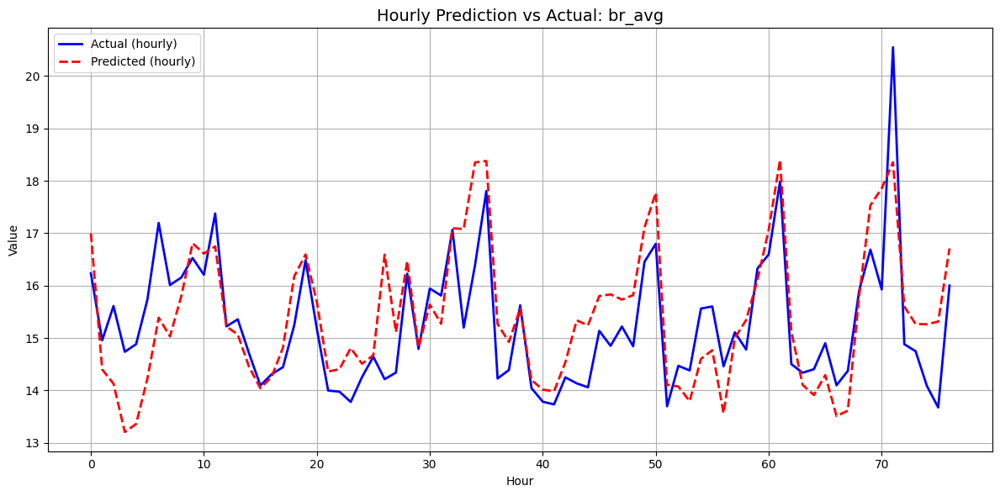

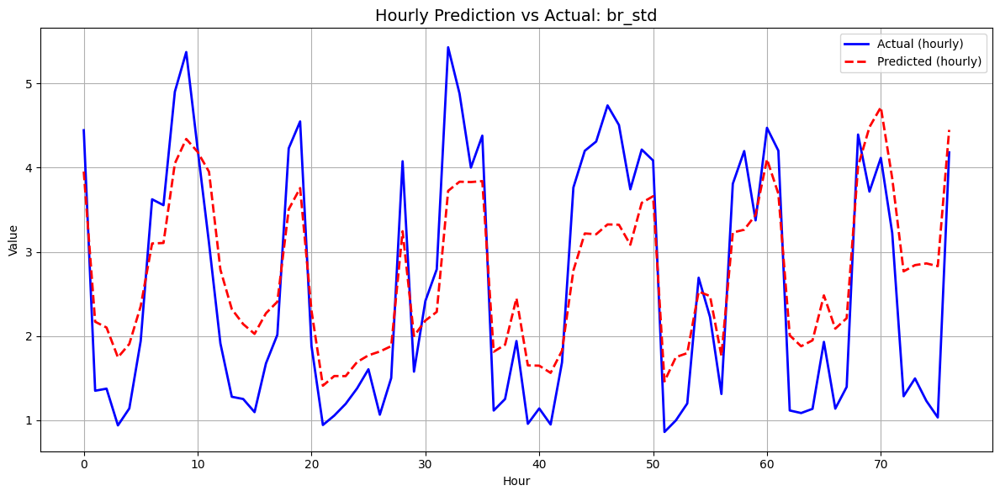

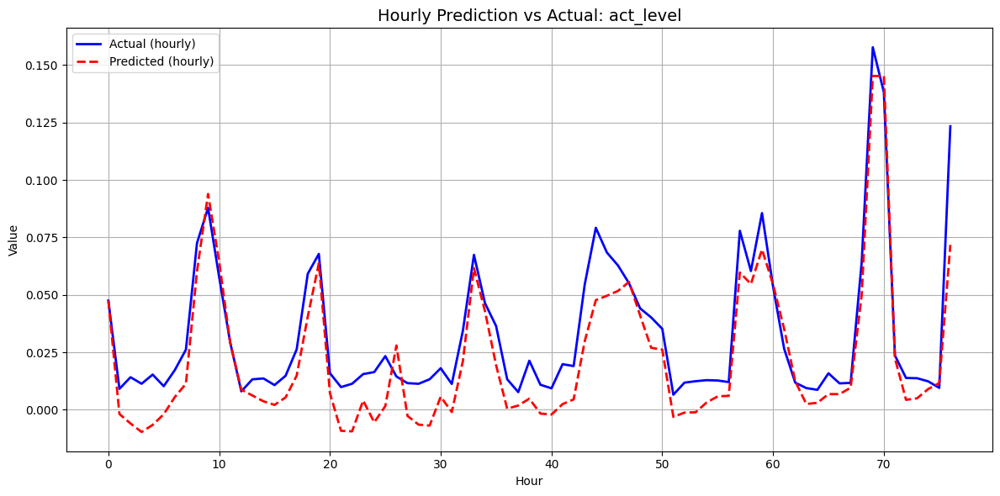

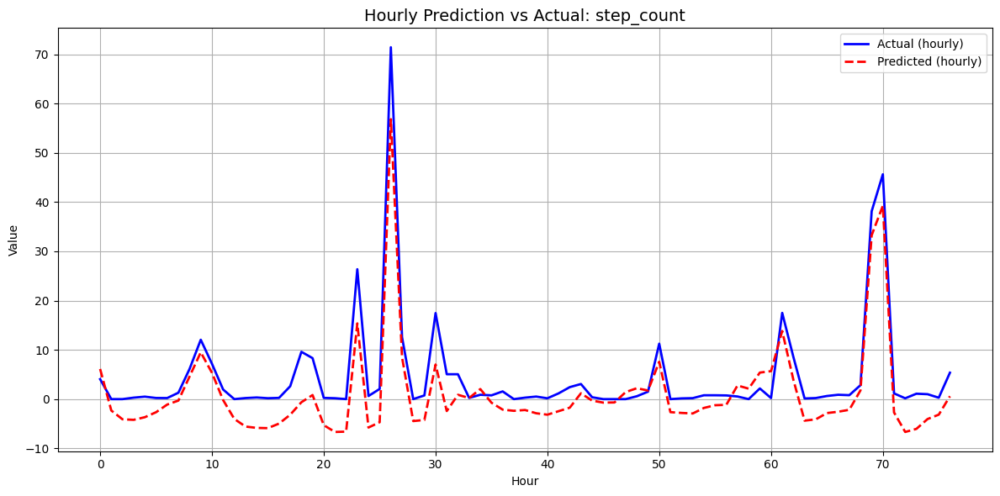

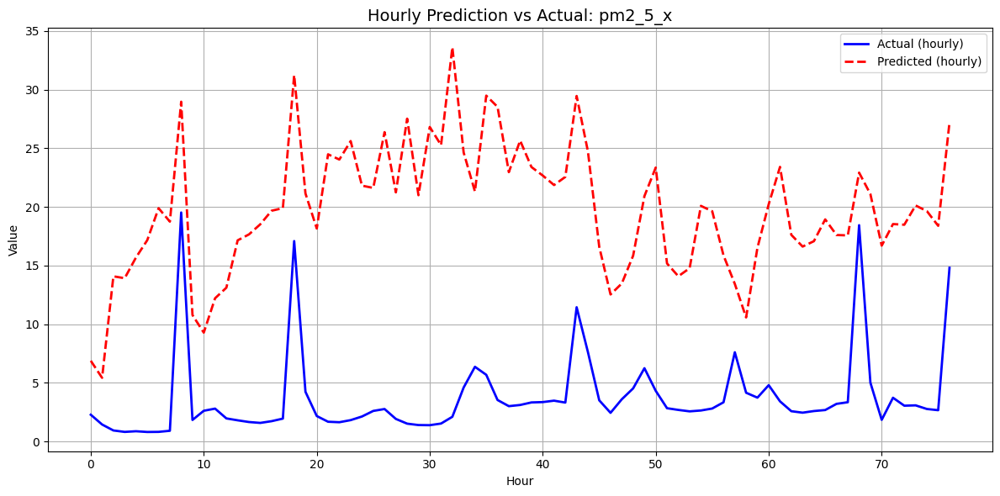

...

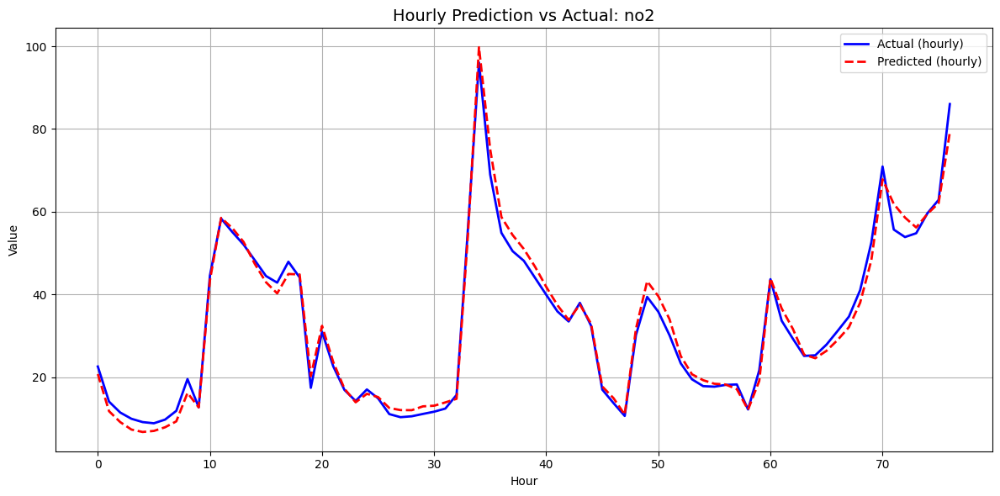

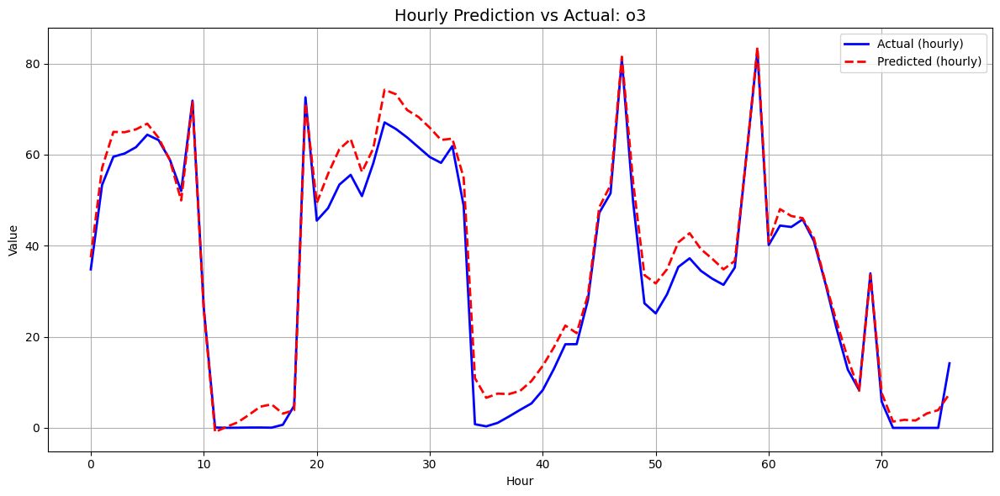

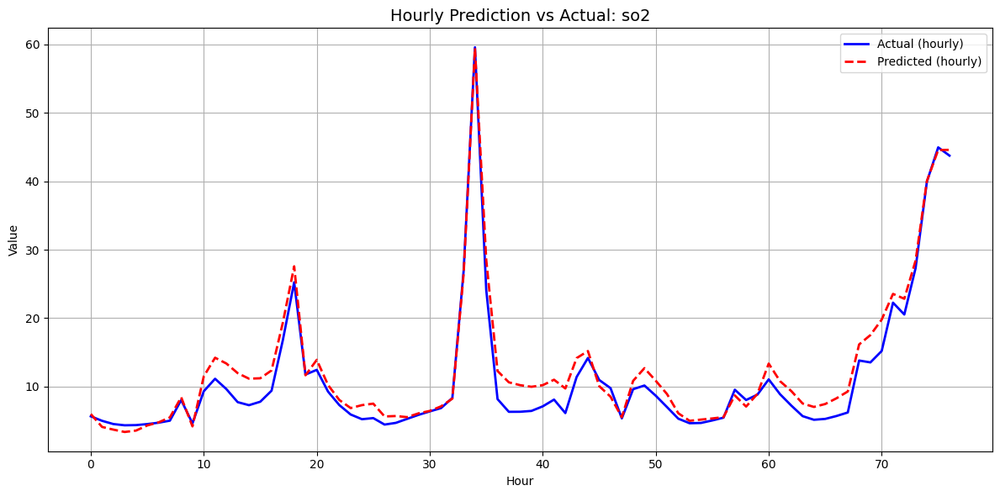

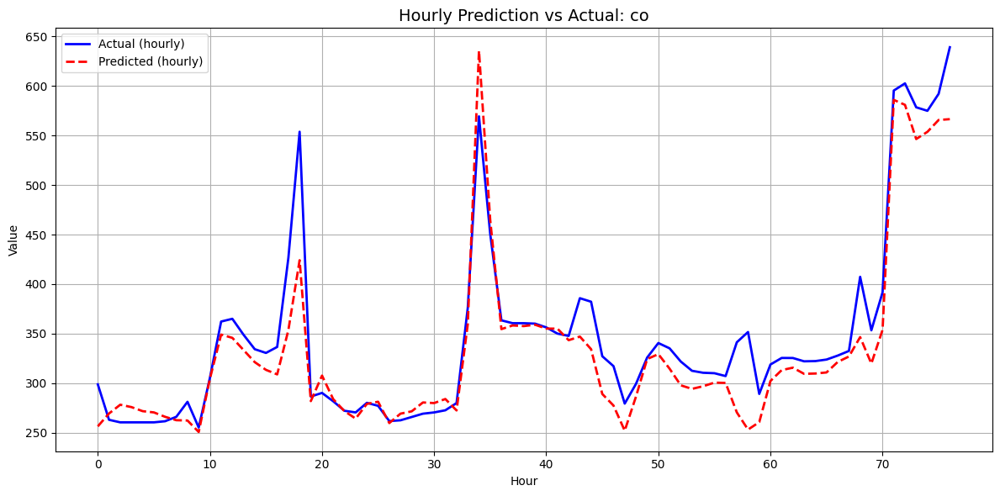

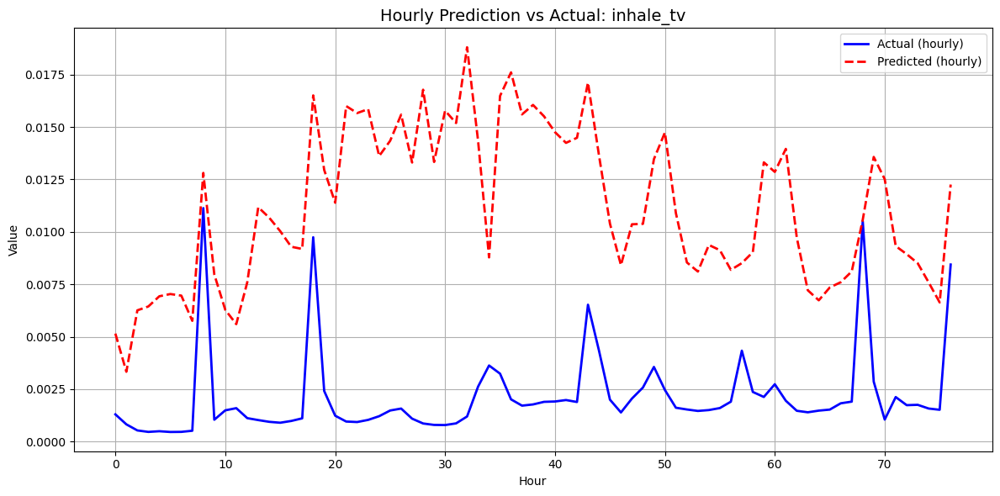


Hourly Aggregated Metrics:
MSE: 69.5956
MAE: 3.0759
R² Score: -48493708664181048213504.0000

Per-feature Hourly Metrics:
br_avg:
  MSE: 0.7950, MAE: 0.7006, R²: 0.4518
br_std:
  MSE: 0.6045, MAE: 0.6876, R²: 0.7099
act_level:
  MSE: 0.0002, MAE: 0.0116, R²: 0.7968
step_count:
  MSE: 22.9179, MAE: 4.0322, R²: 0.8091
pm2_5_x:
  MSE: 284.1499, MAE: 16.0121, R²: -20.2117
temperature:
  MSE: 2.3282, MAE: 1.3711, R²: 0.6502
humidity:
  MSE: 12.9440, MAE: 3.2614, R²: -0.7646
hour_sin:
  MSE: 0.0080, MAE: 0.0672, R²: 0.9779
hour_cos:
  MSE: 0.0056, MAE: 0.0549, R²: 0.9843
dow_sin:
  MSE: 0.0049, MAE: 0.0513, R²: 0.9881
dow_cos:
  MSE: 0.0054, MAE: 0.0611, R²: 0.9903
yearly_sin:
  MSE: 0.0036, MAE: 0.0539, R²: -56.1418
yearly_cos:
  MSE: 0.0092, MAE: 0.0798, R²: -5.6123
lat_round:
  MSE: 0.0026, MAE: 0.0508, R²: -13069054484996754459590656.0000
lon_round:
  MSE: 0.0101, MAE: 0.0999, R²: -2846116433.8518
pm10:
  MSE: 21.6516, MAE: 3.4242, R²: 0.8923
no:
  MSE: 202.7384, MAE: 10.2019, R²: 0.8085

In [ ]:
def evaluate_model_hourly(model, dataloader, device, scaler=None, feature_names=None):
    """
    Evaluate the model and plot hourly-aggregated predictions vs actual values.

    Args:
        model: Trained model
        dataloader: DataLoader with test data
        device: torch device
        scaler: Optional scaler for inverse transformation
        feature_names: List of feature names for plotting
    """
    model.eval()
    all_preds = []
    all_targets = []

    with torch.no_grad():
        for inputs, targets in dataloader:
            inputs = inputs.permute(1, 0, 2).to(device)  # (seq_len, batch, features)
            outputs, mu, logvar, _ = model(inputs) # Corrected unpacking

            all_preds.append(outputs.cpu().numpy())
            all_targets.append(targets.cpu().numpy())

    preds = np.concatenate(all_preds, axis=0)
    trues = np.concatenate(all_targets, axis=0)

    # Average across forecast steps if needed
    if preds.ndim == 3:
        preds = preds.mean(axis=1)
        trues = trues.mean(axis=1)

    # Inverse transform if needed
    if scaler is not None:
        dummy_cols = scaler.n_features_in_
        preds_full = np.zeros((len(preds), dummy_cols))
        trues_full = np.zeros((len(trues), dummy_cols))
        preds_full[:, :preds.shape[1]] = preds
        trues_full[:, :trues.shape[1]] = trues
        preds = scaler.inverse_transform(preds_full)[:, :preds.shape[1]]
        trues = scaler.inverse_transform(trues_full)[:, :trues.shape[1]]

    # ==== Hourly aggregation (average over every 60 timesteps) ====
    def aggregate_hourly(data, interval=60):
        n = len(data) // interval
        return data[:n * interval].reshape(n, interval, -1).mean(axis=1)

    preds_hourly = aggregate_hourly(preds)
    trues_hourly = aggregate_hourly(trues)

    # Plot each feature
    if feature_names is None:
        feature_names = [f'Feature {i}' for i in range(preds_hourly.shape[1])]

    for i, feature in enumerate(feature_names):
        plt.figure(figsize=(12, 6))
        plt.plot(trues_hourly[:100, i], 'b-', label='Actual (hourly)', linewidth=2)
        plt.plot(preds_hourly[:100, i], 'r--', label='Predicted (hourly)', linewidth=2)
        plt.title(f'Hourly Prediction vs Actual: {feature}', fontsize=14)
        plt.xlabel('Hour')
        plt.ylabel('Value')
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

    return preds_hourly, trues_hourly

# Run hourly evaluation
preds_hourly, trues_hourly = evaluate_model_hourly(
    model=model,
    dataloader=test_loader,
    device=device,
    scaler=scaler,
    feature_names=feature_cols
)

# Hourly-level metrics
print("\nHourly Aggregated Metrics:")
print(f"MSE: {mean_squared_error(trues_hourly, preds_hourly):.4f}")
print(f"MAE: {mean_absolute_error(trues_hourly, preds_hourly):.4f}")
print(f"R² Score: {r2_score(trues_hourly, preds_hourly):.4f}")

# Per-feature metrics
print("\nPer-feature Hourly Metrics:")
for i, feature in enumerate(feature_cols):
    mse = mean_squared_error(trues_hourly[:, i], preds_hourly[:, i])
    mae = mean_absolute_error(trues_hourly[:, i], preds_hourly[:, i])
    r2 = r2_score(trues_hourly[:, i], preds_hourly[:, i])
    print(f"{feature}:")
    print(f"  MSE: {mse:.4f}, MAE: {mae:.4f}, R²: {r2:.4f}")

## Now Applying on one individual only

Epoch 1/5 - Train Loss: 0.007895 - Val Loss: 0.001311 - Recon: 0.001311 - Disc Loss: 1.440821 - Adv Loss: 0.634994
Epoch 2/5 - Train Loss: 0.007950 - Val Loss: 0.001421 - Recon: 0.001421 - Disc Loss: 1.428080 - Adv Loss: 0.624896
Epoch 3/5 - Train Loss: 0.007500 - Val Loss: 0.001387 - Recon: 0.001387 - Disc Loss: 1.522495 - Adv Loss: 0.566683
Epoch 4/5 - Train Loss: 0.008005 - Val Loss: 0.001303 - Recon: 0.001303 - Disc Loss: 1.354073 - Adv Loss: 0.696074
Epoch 5/5 - Train Loss: 0.007797 - Val Loss: 0.001368 - Recon: 0.001368 - Disc Loss: 1.482683 - Adv Loss: 0.608695

🔍 Evaluation on Individual: INH111


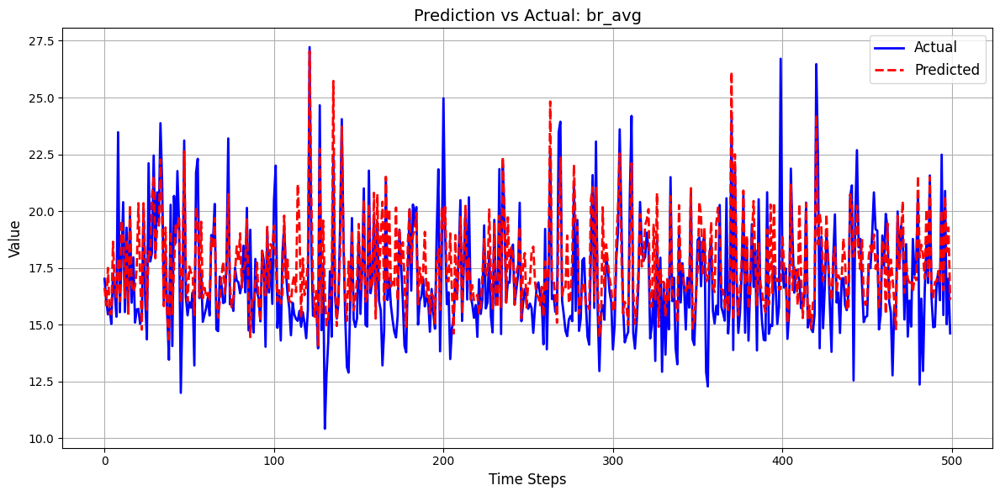

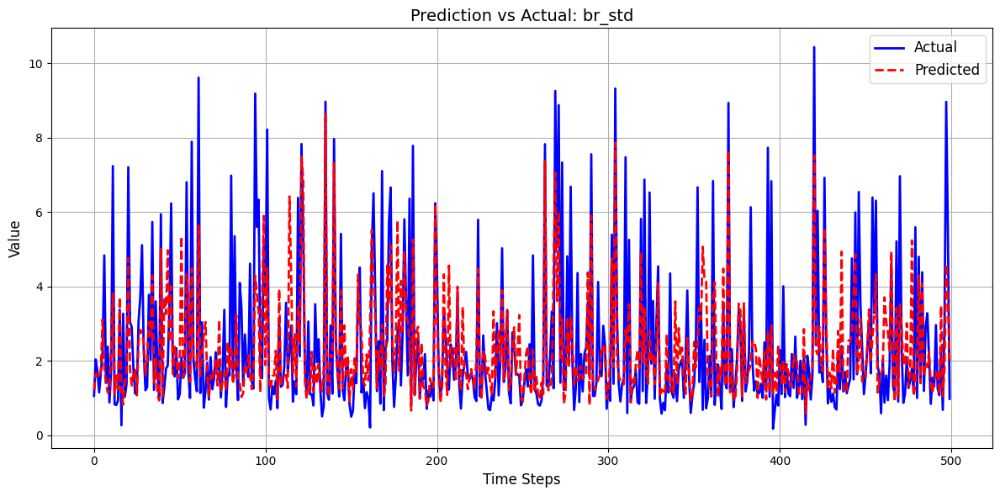

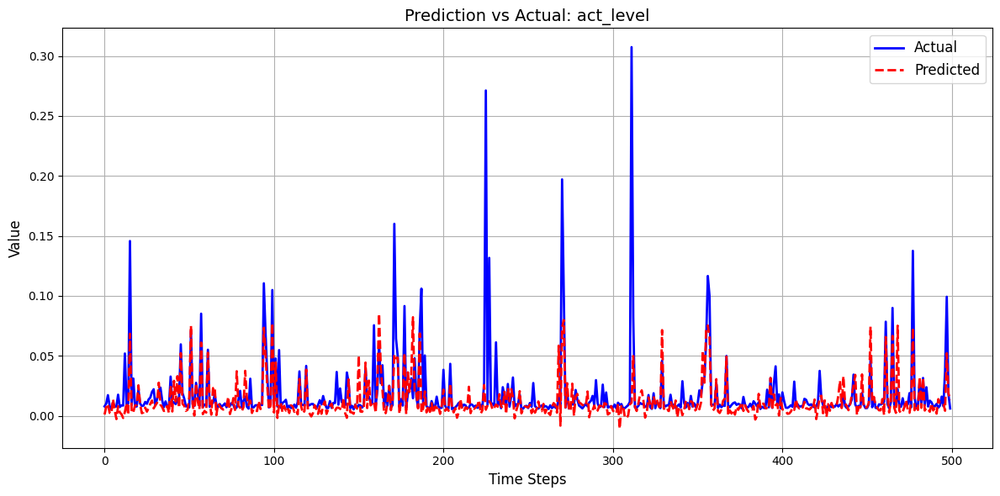

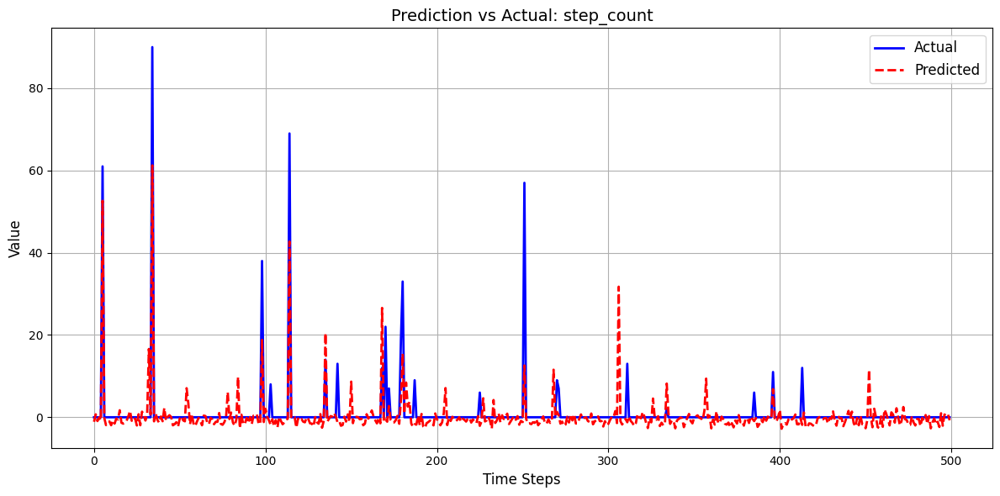

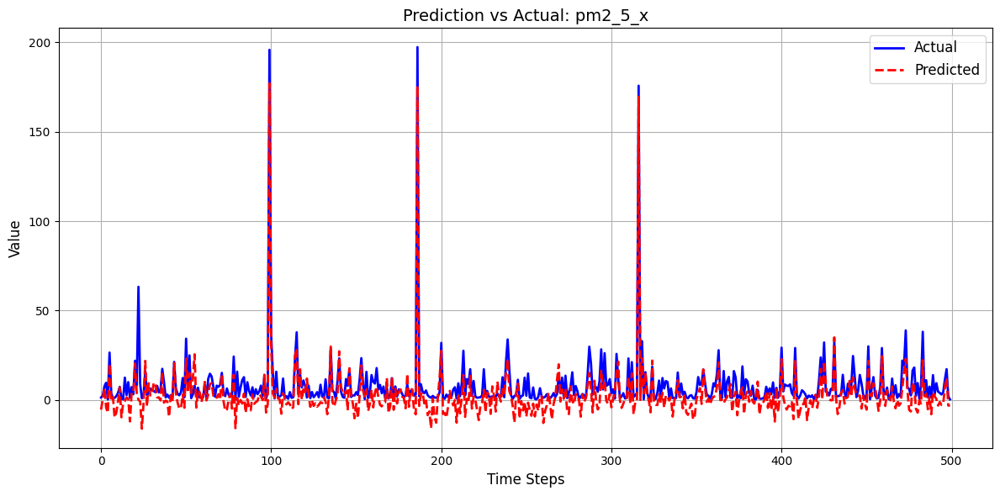

...

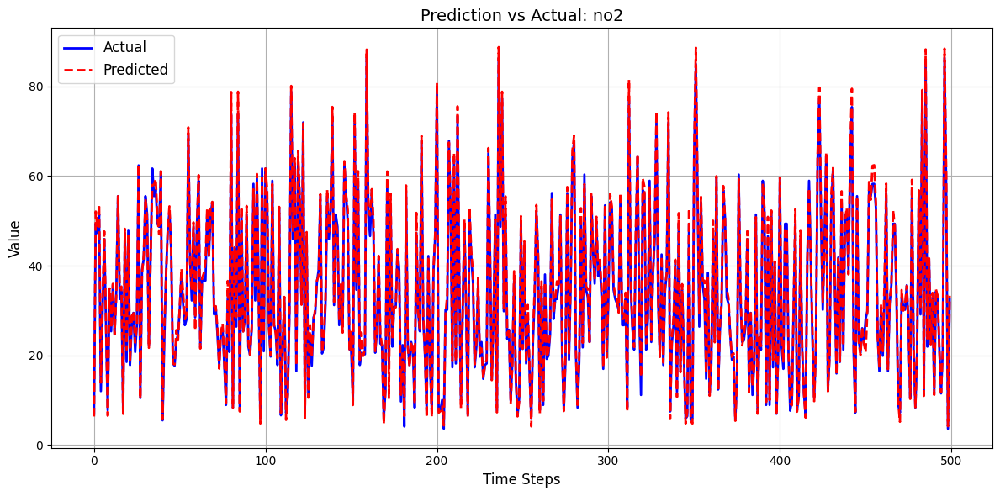

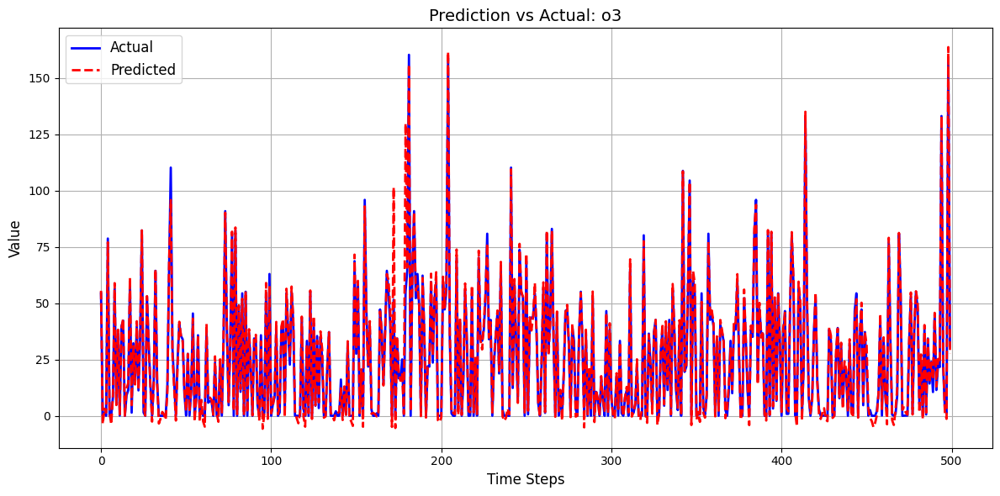

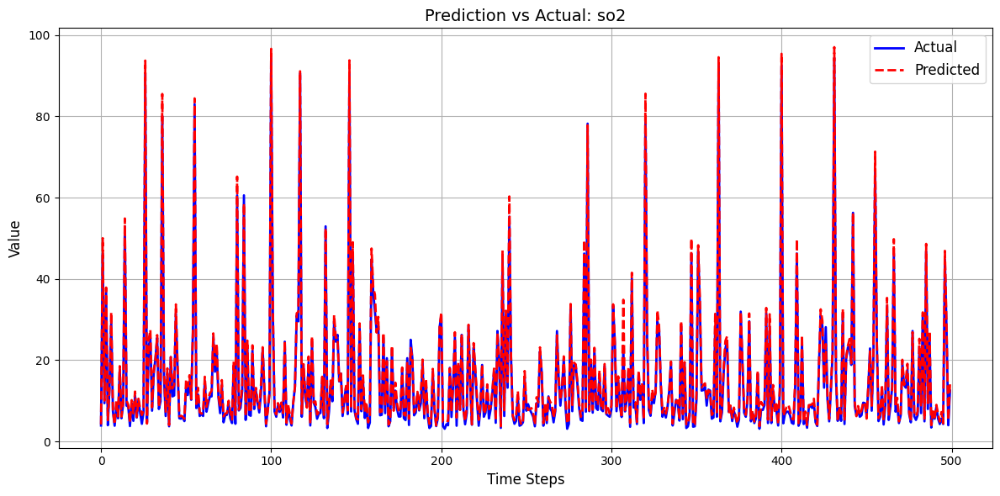

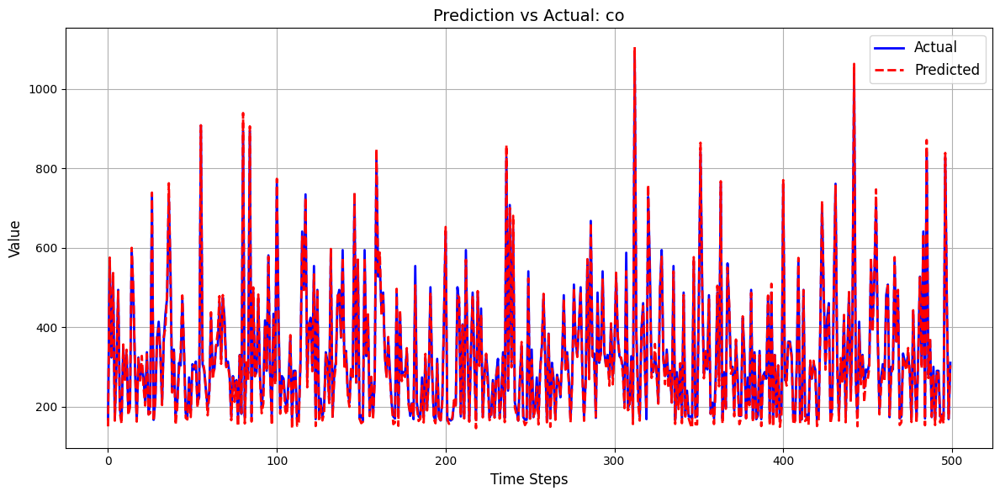

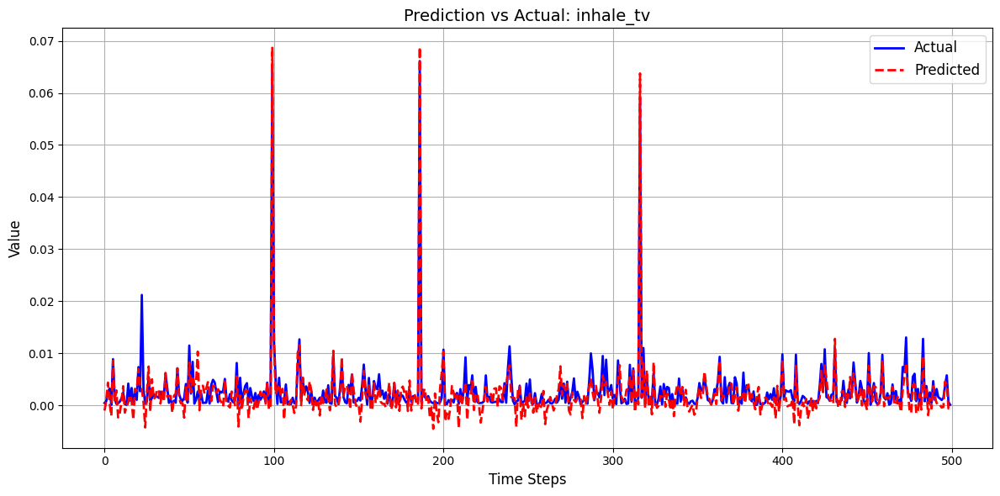


🕒 Hourly Aggregated Evaluation for INH111


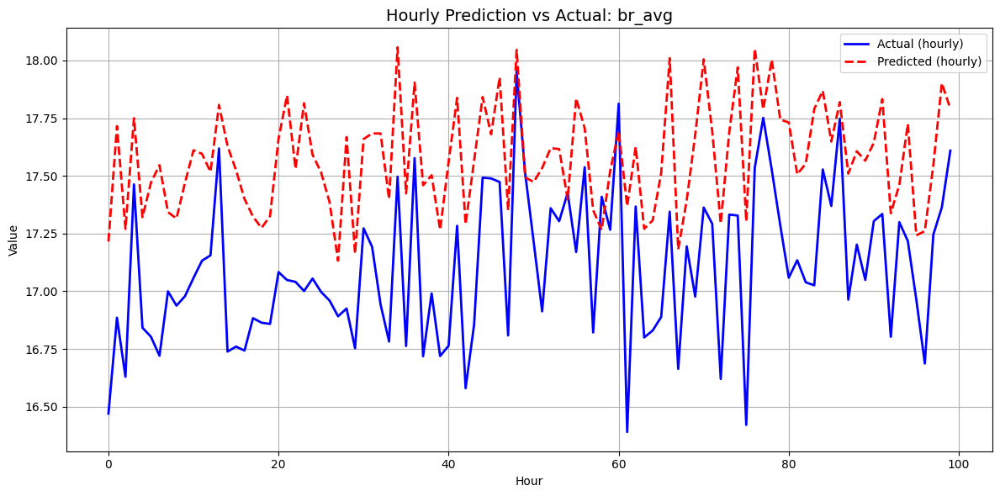

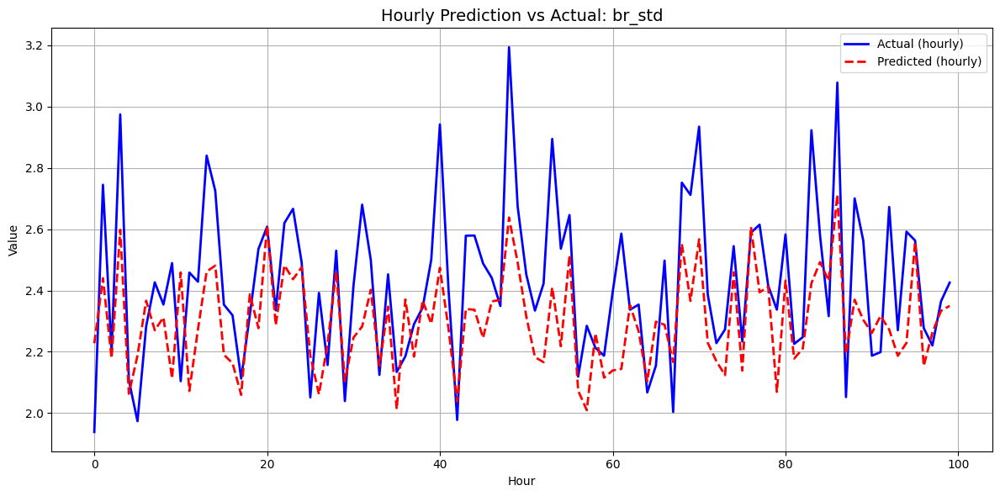

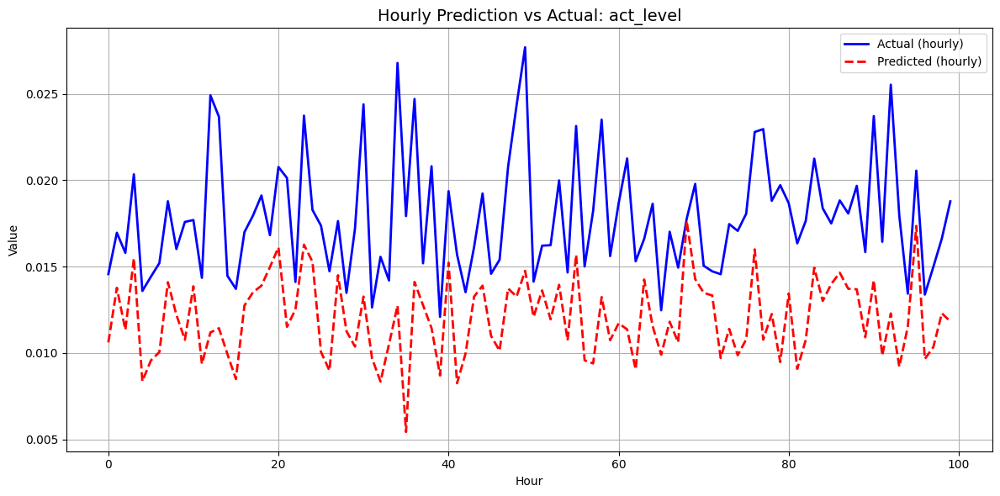

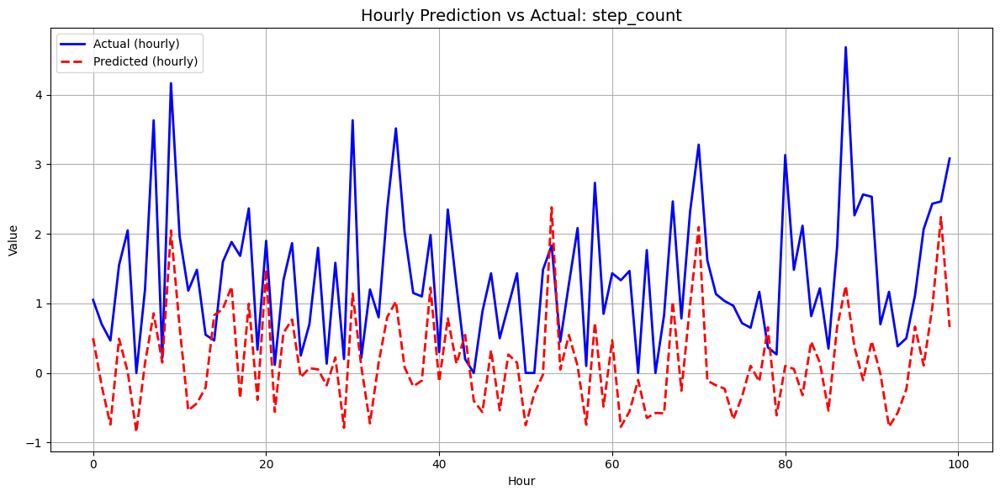

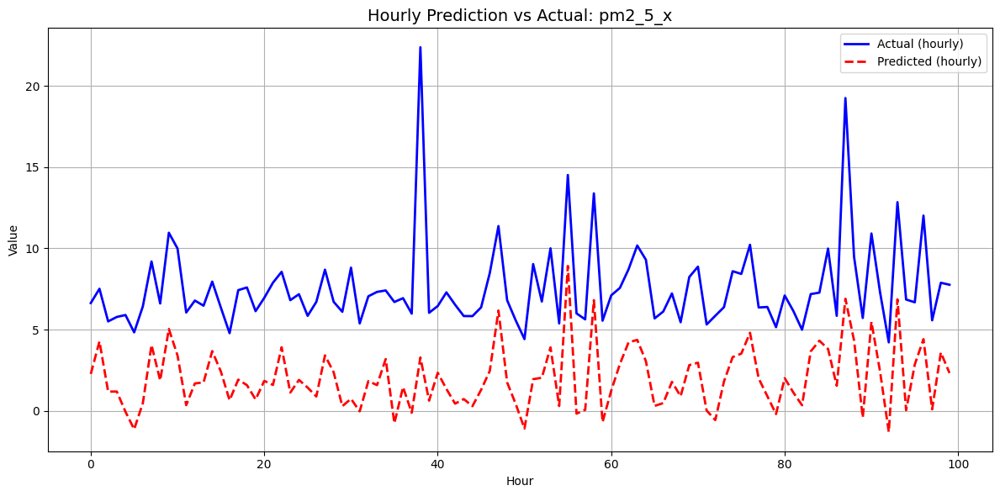

...

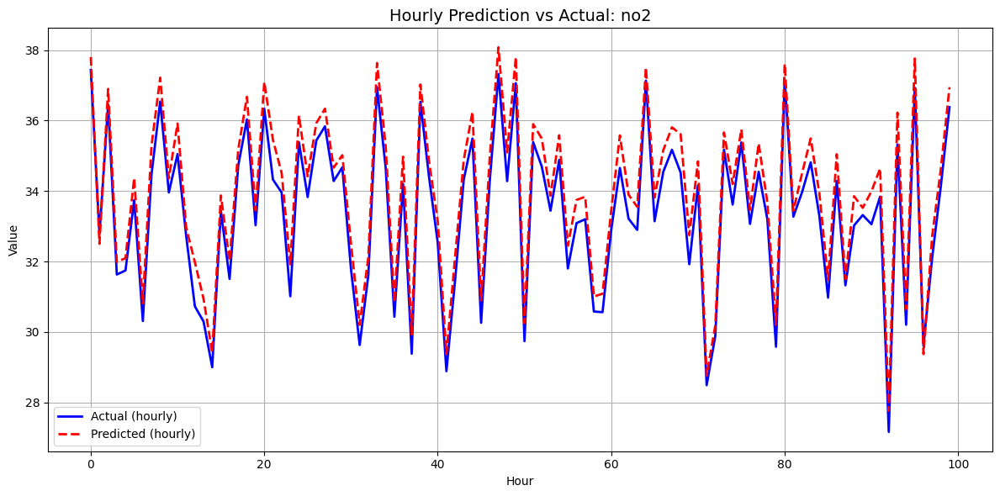

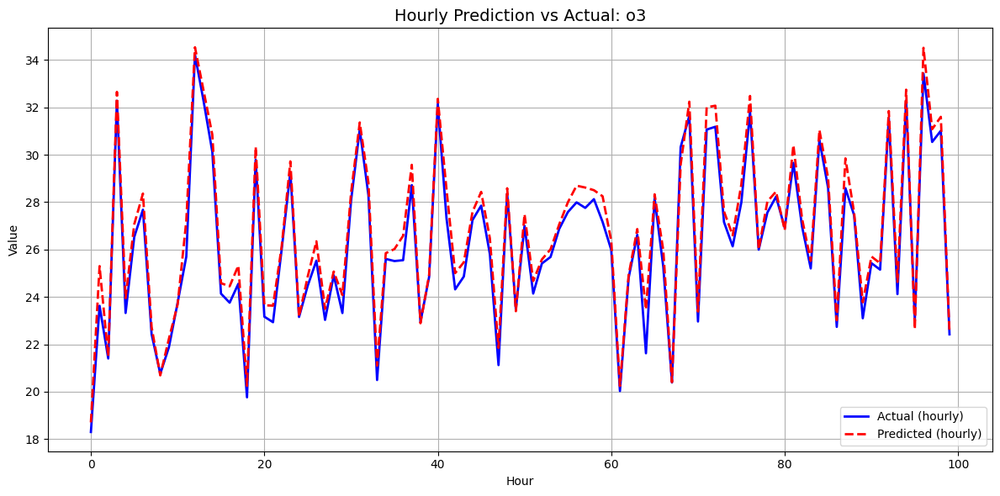

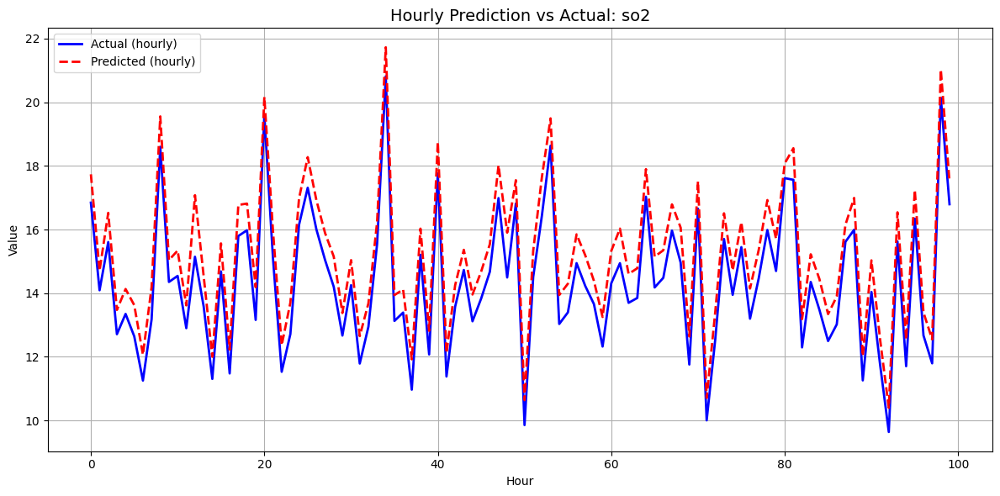

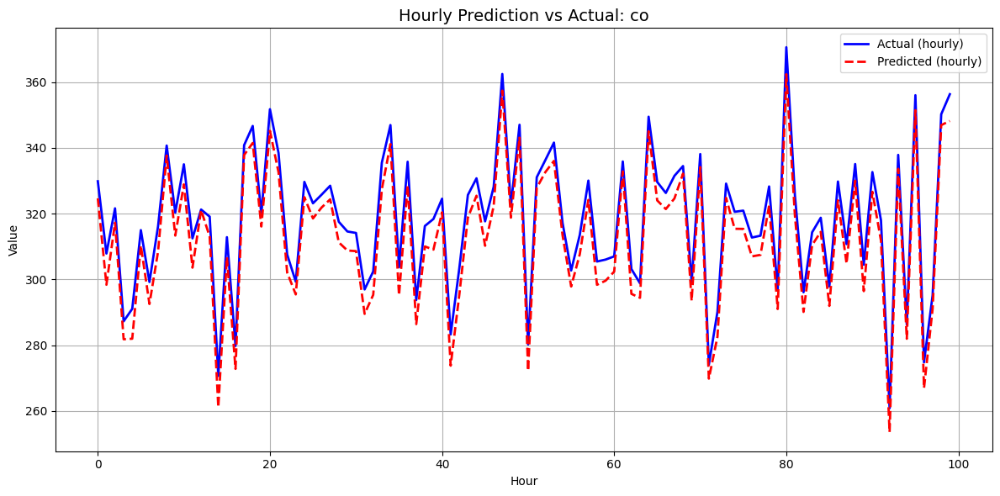

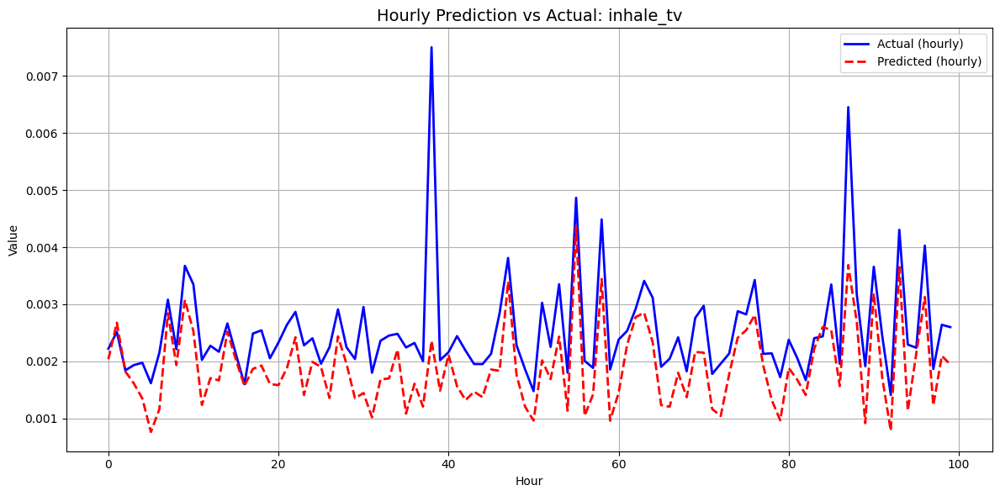


🔢 Individual Metrics:
MSE: 24.0358
MAE: 1.4728
R² Score: -0.4330

📊 Per-feature Metrics:
br_avg: MSE=3.2492, MAE=1.3092, R²=0.5120
br_std: MSE=2.2320, MAE=0.9981, R²=0.4545
act_level: MSE=0.0006, MAE=0.0098, R²=0.2834
step_count: MSE=34.7342, MAE=2.1694, R²=0.4935
pm2_5_x: MSE=183.5364, MAE=6.5061, R²=0.6448
temperature: MSE=0.3225, MAE=0.3171, R²=0.9882
humidity: MSE=0.8063, MAE=0.5970, R²=0.9794
hour_sin: MSE=0.0053, MAE=0.0405, R²=0.9868
hour_cos: MSE=0.0060, MAE=0.0475, R²=0.9857
dow_sin: MSE=0.0021, MAE=0.0297, R²=0.9956
dow_cos: MSE=0.0031, MAE=0.0403, R²=0.9939
yearly_sin: MSE=0.0008, MAE=0.0231, R²=0.8709
yearly_cos: MSE=0.0022, MAE=0.0360, R²=0.9976
lat_round: MSE=0.0000, MAE=0.0021, R²=-7.2122
lon_round: MSE=0.0000, MAE=0.0043, R²=-19.1306
pm10: MSE=2.0941, MAE=1.0557, R²=0.9879
no: MSE=34.5885, MAE=3.8564, R²=0.9863
no2: MSE=3.5917, MAE=1.2140, R²=0.9898
o3: MSE=9.3823, MAE=1.9018, R²=0.9889
so2: MSE=2.4512, MAE=1.0430, R²=0.9896
co: MSE=251.7791, MAE=11.1990, R²=0.9904
inh

In [ ]:
import copy
import torch
from torch.utils.data import DataLoader
from sklearn.preprocessing import MinMaxScaler

# ========================= 1. Extract and Normalize Individual Data =========================

## My individual id is --> 'INH111'
individual_id = 'INH111'


# Scale individual data using previously fitted scaler
val_data_nn_scaled = scaler.transform(val_data_nn_pre[feature_cols])

# ========================= 2. Wrap Individual Data in Dataset =========================

val_dataset = SlidingWindowDataset(val_data_nn_scaled, window_size, forecast_steps)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=True)

# ========================= 3. Clone & Prepare Model =========================

# Clone original model for safe fine-tuning
fine_tune_model = copy.deepcopy(model).to(device)

# # Optionally freeze encoder to avoid catastrophic forgetting
# for param in fine_tune_model.transformer_encoder.parameters():
#     param.requires_grad = False  # 🔒 freeze transformer encoder

# # New optimizer for fine-tuning (smaller LR)
# fine_tune_optimizer = torch.optim.Adam(
#     filter(lambda p: p.requires_grad, fine_tune_model.parameters()),
#     lr=1e-4
# )
# fine_tune_disc_optimizer = torch.optim.Adam(discriminator.parameters(), lr=1e-5)

# ========================= 4. Fine-tune on Individual =========================

fine_tune_optimizer = torch.optim.Adam(
    filter(lambda p: p.requires_grad, fine_tune_model.parameters()),
    lr=1e-4
)

fine_tune_disc_optimizer = torch.optim.Adam(discriminator.parameters(), lr=1e-5)


train_model_aae(
    model=fine_tune_model,
    train_loader=val_loader,
    val_loader=val_loader,
    optimizer=fine_tune_optimizer,
    discriminator=discriminator,
    disc_optimizer=fine_tune_disc_optimizer,
    device=device,
    epochs=5,         # 🔁 Small number of epochs for personalization
    adv_weight=0.01   # Balance reconstruction & latent regularization
)

# ========================= 5. Evaluate on Individual =========================

print(f"\n🔍 Evaluation on Individual: {individual_id}")
preds_ind, trues_ind = evaluate_model(
    model=fine_tune_model,
    dataloader=val_loader,
    device=device,
    scaler=scaler,
    feature_names=feature_cols
)

# Hourly-level evaluation
print(f"\n🕒 Hourly Aggregated Evaluation for {individual_id}")
preds_hourly_ind, trues_hourly_ind = evaluate_model_hourly(
    model=fine_tune_model,
    dataloader=val_loader,
    device=device,
    scaler=scaler,
    feature_names=feature_cols
)

# ========================= 6. Metrics =========================

from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

print("\n🔢 Individual Metrics:")
print(f"MSE: {mean_squared_error(trues_ind, preds_ind):.4f}")
print(f"MAE: {mean_absolute_error(trues_ind, preds_ind):.4f}")
print(f"R² Score: {r2_score(trues_ind, preds_ind):.4f}")

print("\n📊 Per-feature Metrics:")
for i, feature in enumerate(feature_cols):
    mse = mean_squared_error(trues_ind[:, i], preds_ind[:, i])
    mae = mean_absolute_error(trues_ind[:, i], preds_ind[:, i])
    r2 = r2_score(trues_ind[:, i], preds_ind[:, i])
    print(f"{feature}: MSE={mse:.4f}, MAE={mae:.4f}, R²={r2:.4f}")

# ========================= 7. Save Fine-Tuned Model =========================

torch.save(fine_tune_model.state_dict(), f"model_{individual_id}_finetuned.pt")
print(f"\n✅ Fine-tuned model for {individual_id} saved to model_{individual_id}_finetuned.pt")

In [ ]:
model.eval()

# Take 1 sample from training set
sample_input, _ = train_dataset[0]  # shape: (window_size, num_features)

# Add batch dimension and permute to (seq_len, batch, features)
sample_input = sample_input.unsqueeze(1).to(device)

# Run through model
with torch.no_grad():
    _, _, _, attentions = model(sample_input)


In [ ]:
# import matplotlib.pyplot as plt
# import seaborn as sns

# def plot_attention(attn, layer=0, head=0, time_labels=None):
#     """
#     attn: List of attention tensors from model
#           each of shape (batch_size, num_heads, seq_len, seq_len)
#     layer: which layer to visualize
#     head: which attention head to visualize
#     time_labels: optional list of strings for axis labels
#     """
#     attn_layer = attn[layer]  # (batch, heads, seq_len, seq_len)
#     attn_matrix = attn_layer[0, head].detach().cpu().numpy()  # (seq_len, seq_len)

#     if time_labels is None:
#         time_labels = [f"t{i}" for i in range(attn_matrix.shape[0])]

#     plt.figure(figsize=(8, 6))
#     sns.heatmap(attn_matrix, xticklabels=time_labels, yticklabels=time_labels, cmap="viridis", square=True)
#     plt.title(f"Attention Map — Layer {layer}, Head {head}")
#     plt.xlabel("Key (past positions)")
#     plt.ylabel("Query (current positions)")
#     plt.show()


In [ ]:
# for h in range(8):
#   for l in range(6):
#     plot_attention(attentions, layer=l, head=h)

# ## This is very interesting because it explains the concept of long dependencies and how deeper layers mean beiong able to look at short and long dependencies!

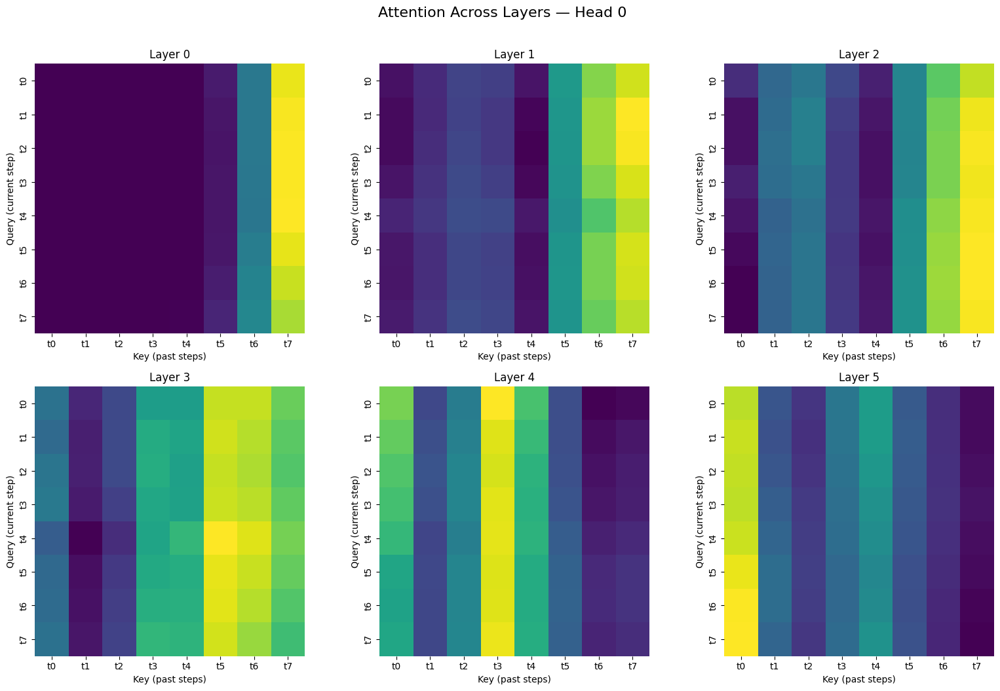

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

def plot_attention_across_layers(attn, head=0, time_labels=None, figsize=(16, 10)):
    """
    Plots attention maps across all layers for a single head.

    Args:
        attn: list of attention tensors from each layer (batch, heads, seq_len, seq_len)
        head: index of attention head to visualize
        time_labels: optional list of time-step labels (length = seq_len)
        figsize: size of the full figure
    """
    num_layers = len(attn)
    seq_len = attn[0].shape[-1]

    if time_labels is None:
        time_labels = [f"t{i}" for i in range(seq_len)]

    fig, axs = plt.subplots(2, (num_layers + 1) // 2, figsize=figsize)

    for i in range(num_layers):
        ax = axs[i // ((num_layers + 1) // 2)][i % ((num_layers + 1) // 2)]

        attn_matrix = attn[i][0, head].detach().cpu().numpy()
        sns.heatmap(attn_matrix,
                    xticklabels=time_labels,
                    yticklabels=time_labels,
                    cmap="viridis",
                    square=True,
                    cbar=False,
                    ax=ax)

        ax.set_title(f"Layer {i}")
        ax.set_xlabel("Key (past steps)")
        ax.set_ylabel("Query (current step)")

    plt.tight_layout()
    plt.suptitle(f"Attention Across Layers — Head {head}", fontsize=16, y=1.05)
    plt.show()

sample_input, _ = train_dataset[0]
sample_input = sample_input.unsqueeze(1).to(device)  # (seq_len, 1, features)

model.eval()
with torch.no_grad():
    _, _, _, attentions = model(sample_input)

# Plot attention maps across all layers for Head 0
plot_attention_across_layers(attentions, head=0)



In [ ]:
def plot_attention_across_heads(attn, layer=0, time_labels=None, figsize=(16, 10)):
    """
    Plots attention maps for all heads in a single Transformer layer.

    Args:
        attn: list of attention tensors from each layer (batch, heads, seq_len, seq_len)
        layer: which layer to visualize
        time_labels: optional list of time-step labels
        figsize: size of the figure
    """
    attn_layer = attn[layer]  # (batch, heads, seq_len, seq_len)
    num_heads = attn_layer.shape[1]
    seq_len = attn_layer.shape[-1]

    if time_labels is None:
        time_labels = [f"t{i}" for i in range(seq_len)]

    cols = (num_heads + 1) // 2
    fig, axs = plt.subplots(2, cols, figsize=figsize)

    for h in range(num_heads):
        ax = axs[h // cols][h % cols]

        attn_matrix = attn_layer[0, h].detach().cpu().numpy()
        sns.heatmap(attn_matrix,
                    xticklabels=time_labels,
                    yticklabels=time_labels,
                    cmap="viridis",
                    square=True,
                    cbar=False,
                    ax=ax)

        ax.set_title(f"Head {h}")
        ax.set_xlabel("Key (past steps)")
        ax.set_ylabel("Query (current step)")

    plt.tight_layout()
    plt.suptitle(f"Attention Across Heads — Layer {layer}", fontsize=16, y=1.05)
    plt.show()


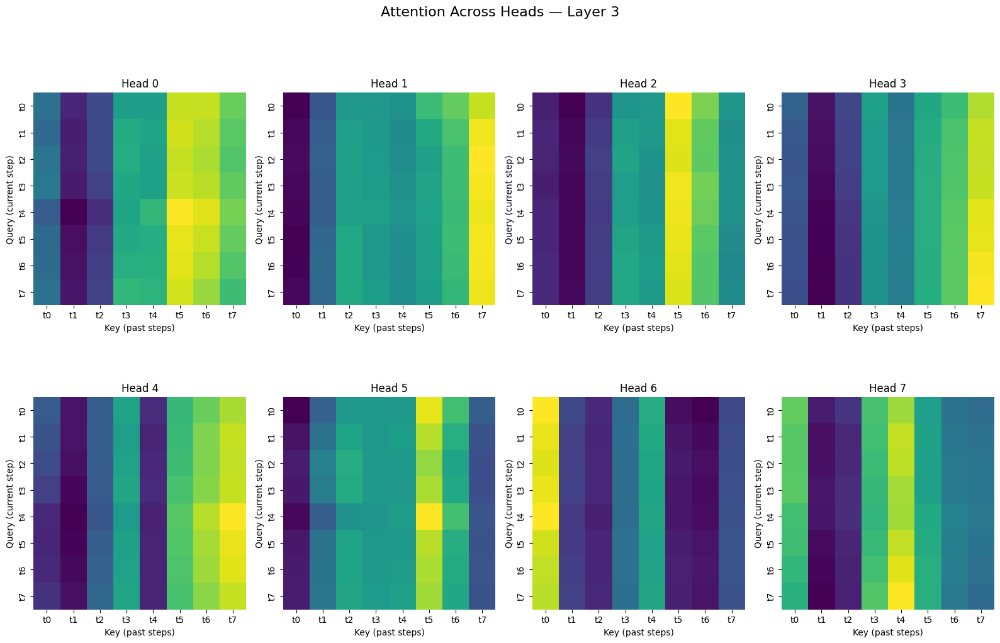

In [ ]:
# Plot all heads in Layer 3
plot_attention_across_heads(attentions, layer=3)

# Typical differences between heads:

# Some focus tightly on recent time steps (diagonal)

# Others jump to the beginning (e.g., t0)

# Some spread out attention → global heads



🔸 Local Heads:
Heads 0, 4, and 5 are heavily focused on recent steps

These are probably modeling short-term momentum, like immediate past → next prediction

🔸 Global/Semi-Global Heads:
Head 1: Strong on t0 and t7 (first and last steps!) → maybe learning positional anchors

Head 7: Gradual, smooth spread → good sign of global context scanning

🔸 Anchored Heads:
Head 3: Very consistent attention around t3, for all queries

This might indicate a fixed position dependency (e.g., daily rhythm at certain hours)

## Threshold

In [ ]:
## FULL SCRIPT HERE

import numpy as np
import torch
from tqdm import tqdm
import matplotlib.pyplot as plt

# ---- Define risk-relevant features ----
risk_features = ['br_avg', 'br_std', 'act_level', 'pm10', 'no2', 'o3', 'pm2_5_x', 'so2']
risk_indices = [feature_cols.index(f) for f in risk_features]

# ---- Normalize selected risk vector only ----
def normalize_risk_vector(vec, risk_indices, scaler):
    # Select only the risk-related features from the input vector
    # Check if vec is already a risk vector (size matches risk_indices)
    if len(vec) == len(risk_indices):
        risk_vec = vec  # It's already the risk vector
    else:
        risk_vec = vec[risk_indices] # Otherwise select risk features

    dummy = np.zeros((1, scaler.n_features_in_))
    dummy[0, risk_indices] = risk_vec  # Assign the risk features to the correct indices
    dummy_scaled = scaler.transform(dummy)
    return dummy_scaled[0, risk_indices]

# ---- Risk classification from prediction ----
def get_risk_from_prediction(
    pred_vector, baseline_vector,
    risk_indices,
    scaler,
    method="euclidean",
    green_thresh=0.3,
    yellow_thresh=1.0,
    return_distance=False
):
    pred_norm = normalize_risk_vector(pred_vector, risk_indices, scaler)
    # Pass baseline_vector directly as it already only contains risk features
    base_norm = normalize_risk_vector(baseline_vector, risk_indices, scaler)

    if method == "euclidean":
        dist = np.linalg.norm(pred_norm - base_norm)
    else:
        raise NotImplementedError("Only Euclidean distance supported")

    if dist < green_thresh:
        risk = "GREEN"
    elif dist < yellow_thresh:
        risk = "YELLOW"
    else:
        risk = "RED"

    return (risk, dist) if return_distance else risk

def get_baseline_prediction_vector(model, dataloader, device, scaler, risk_indices):
    model.eval()
    preds = []

    with torch.no_grad():
        for inputs, _ in dataloader:
            inputs = inputs.permute(1, 0, 2).to(device)
            output, _, _, _ = model(inputs)  # shape: (batch, features)
            output = output.cpu().numpy()

            for i in range(output.shape[0]):
                single_pred = output[i]  # shape: (features,)
                output_full = np.zeros((scaler.n_features_in_,))
                output_full[:single_pred.shape[0]] = single_pred
                output_original = scaler.inverse_transform(output_full.reshape(1, -1))[0]
                preds.append(output_original[risk_indices])

    preds = np.stack(preds, axis=0)
    return preds.mean(axis=0)  # shape: (len(risk_features),)


# ---- Step-by-step risk tracking ----
def scan_individual_risk(model, dataset, scaler, baseline_vector, risk_indices, device):
    print("🕵️ Scanning risk across time...\n")
    model.eval()
    risks = []
    distances = []

    with torch.no_grad():
        for step in range(len(dataset)):
            input_step, _ = dataset[step]
            input_step = input_step.unsqueeze(1).to(device)

            output, _, _, _ = model(input_step)
            output = output.squeeze().cpu().numpy()

            # Inverse transform
            output_full = np.zeros((scaler.n_features_in_,))
            output_full[:output.shape[0]] = output
            output_orig = scaler.inverse_transform(output_full.reshape(1, -1))[0]

            risk, dist = get_risk_from_prediction(
                pred_vector=output_orig,
                baseline_vector=baseline_vector,
                risk_indices=risk_indices,
                scaler=scaler,
                return_distance=True
            )

            print(f"→ Distance from baseline: {dist:.4f}")
            print(f"Step {step:03d} → Risk: {risk}")
            risks.append(risk)
            distances.append(dist)

    return risks, distances

In [ ]:
# STEP 1: Get baseline prediction vector (per-person)
baseline_pred_vector = get_baseline_prediction_vector(
    model=fine_tune_model,
    dataloader=val_loader,
    device=device,
    scaler=scaler,
    risk_indices=risk_indices
)

# STEP 2: Scan and classify risk
risks, distances = scan_individual_risk(
    model=fine_tune_model,
    dataset=val_dataset,
    scaler=scaler,
    baseline_vector=baseline_pred_vector,
    risk_indices=risk_indices,
    device=device
)


🕵️ Scanning risk across time...

→ Distance from baseline: 0.2380
Step 000 → Risk: GREEN
→ Distance from baseline: 0.2192
Step 001 → Risk: GREEN
→ Distance from baseline: 0.2131
Step 002 → Risk: GREEN
→ Distance from baseline: 0.2245
Step 003 → Risk: GREEN
→ Distance from baseline: 0.2123
Step 004 → Risk: GREEN
→ Distance from baseline: 0.2172
Step 005 → Risk: GREEN
→ Distance from baseline: 0.2310
Step 006 → Risk: GREEN
→ Distance from baseline: 0.2262
Step 007 → Risk: GREEN
→ Distance from baseline: 0.2201
Step 008 → Risk: GREEN
→ Distance from baseline: 0.2215
Step 009 → Risk: GREEN
→ Distance from baseline: 0.2089
Step 010 → Risk: GREEN
→ Distance from baseline: 0.2389
Step 011 → Risk: GREEN
→ Distance from baseline: 0.2713
Step 012 → Risk: GREEN
→ Distance from baseline: 0.2157
Step 013 → Risk: GREEN
→ Distance from baseline: 0.2093
Step 014 → Risk: GREEN
→ Distance from baseline: 0.2430
Step 015 → Risk: GREEN
→ Distance from baseline: 0.2175
Step 016 → Risk: GREEN
→ Distance from

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2012
Step 043 → Risk: GREEN
→ Distance from baseline: 0.2195
Step 044 → Risk: GREEN
→ Distance from baseline: 0.2237
Step 045 → Risk: GREEN
→ Distance from baseline: 0.2363
Step 046 → Risk: GREEN
→ Distance from baseline: 0.2331
Step 047 → Risk: GREEN
→ Distance from baseline: 0.2955
Step 048 → Risk: GREEN
→ Distance from baseline: 0.2894
Step 049 → Risk: GREEN
→ Distance from baseline: 0.3321
Step 050 → Risk: YELLOW
→ Distance from baseline: 0.3324
Step 051 → Risk: YELLOW
→ Distance from baseline: 0.3682
Step 052 → Risk: YELLOW
→ Distance from baseline: 0.3730
Step 053 → Risk: YELLOW
→ Distance from baseline: 0.3886
Step 054 → Risk: YELLOW
→ Distance from baseline: 0.3706
Step 055 → Risk: YELLOW
→ Distance from baseline: 0.3562
Step 056 → Risk: YELLOW
→ Distance from baseline: 0.3219
Step 057 → Risk: YELLOW
→ Distance from baseline: 0.3343
Step 058 → Risk: YELLOW
→ Distance from baseline: 0.3353
Step 059 → Risk: YELLOW
→ Distance from baseline: 0.3063
Step 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2808
Step 086 → Risk: GREEN
→ Distance from baseline: 0.2979
Step 087 → Risk: GREEN
→ Distance from baseline: 0.2567
Step 088 → Risk: GREEN
→ Distance from baseline: 0.2880
Step 089 → Risk: GREEN
→ Distance from baseline: 0.2696
Step 090 → Risk: GREEN
→ Distance from baseline: 0.2656
Step 091 → Risk: GREEN
→ Distance from baseline: 0.3084
Step 092 → Risk: YELLOW
→ Distance from baseline: 0.2987
Step 093 → Risk: GREEN
→ Distance from baseline: 0.3230
Step 094 → Risk: YELLOW
→ Distance from baseline: 0.3307
Step 095 → Risk: YELLOW
→ Distance from baseline: 0.2997
Step 096 → Risk: GREEN
→ Distance from baseline: 0.3607
Step 097 → Risk: YELLOW
→ Distance from baseline: 0.3471
Step 098 → Risk: YELLOW
→ Distance from baseline: 0.3098
Step 099 → Risk: YELLOW
→ Distance from baseline: 0.3098
Step 100 → Risk: YELLOW
→ Distance from baseline: 0.3394
Step 101 → Risk: YELLOW
→ Distance from baseline: 0.3203
Step 102 → Risk: YELLOW
→ Distance from baseline: 0.3099
Step 1

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2861
Step 134 → Risk: GREEN
→ Distance from baseline: 0.2744
Step 135 → Risk: GREEN
→ Distance from baseline: 0.3100
Step 136 → Risk: YELLOW
→ Distance from baseline: 0.2503
Step 137 → Risk: GREEN
→ Distance from baseline: 0.2384
Step 138 → Risk: GREEN
→ Distance from baseline: 0.2357
Step 139 → Risk: GREEN
→ Distance from baseline: 0.2365
Step 140 → Risk: GREEN
→ Distance from baseline: 0.2286
Step 141 → Risk: GREEN
→ Distance from baseline: 0.2355
Step 142 → Risk: GREEN
→ Distance from baseline: 0.2349
Step 143 → Risk: GREEN
→ Distance from baseline: 0.2702
Step 144 → Risk: GREEN
→ Distance from baseline: 0.2755
Step 145 → Risk: GREEN
→ Distance from baseline: 0.2701
Step 146 → Risk: GREEN
→ Distance from baseline: 0.2243
Step 147 → Risk: GREEN
→ Distance from baseline: 0.2196
Step 148 → Risk: GREEN
→ Distance from baseline: 0.2174
Step 149 → Risk: GREEN
→ Distance from baseline: 0.2165
Step 150 → Risk: GREEN
→ Distance from baseline: 0.2208
Step 151 → Ris

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1913
Step 182 → Risk: GREEN
→ Distance from baseline: 0.1903
Step 183 → Risk: GREEN
→ Distance from baseline: 0.2248
Step 184 → Risk: GREEN
→ Distance from baseline: 0.2436
Step 185 → Risk: GREEN
→ Distance from baseline: 0.1999
Step 186 → Risk: GREEN
→ Distance from baseline: 0.3066
Step 187 → Risk: YELLOW
→ Distance from baseline: 0.4132
Step 188 → Risk: YELLOW
→ Distance from baseline: 0.3166
Step 189 → Risk: YELLOW
→ Distance from baseline: 0.3368
Step 190 → Risk: YELLOW
→ Distance from baseline: 0.4957
Step 191 → Risk: YELLOW
→ Distance from baseline: 0.5586
Step 192 → Risk: YELLOW
→ Distance from baseline: 0.5746
Step 193 → Risk: YELLOW
→ Distance from baseline: 0.5969
Step 194 → Risk: YELLOW
→ Distance from baseline: 0.5687
Step 195 → Risk: YELLOW
→ Distance from baseline: 0.5415
Step 196 → Risk: YELLOW
→ Distance from baseline: 0.4705
Step 197 → Risk: YELLOW
→ Distance from baseline: 0.2599
Step 198 → Risk: GREEN
→ Distance from baseline: 0.2123
Step

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2130
Step 230 → Risk: GREEN
→ Distance from baseline: 0.2385
Step 231 → Risk: GREEN
→ Distance from baseline: 0.2167
Step 232 → Risk: GREEN
→ Distance from baseline: 0.2178
Step 233 → Risk: GREEN
→ Distance from baseline: 0.2903
Step 234 → Risk: GREEN
→ Distance from baseline: 0.2480
Step 235 → Risk: GREEN
→ Distance from baseline: 0.1905
Step 236 → Risk: GREEN
→ Distance from baseline: 0.1919
Step 237 → Risk: GREEN
→ Distance from baseline: 0.2119
Step 238 → Risk: GREEN
→ Distance from baseline: 0.1717
Step 239 → Risk: GREEN
→ Distance from baseline: 0.2117
Step 240 → Risk: GREEN
→ Distance from baseline: 0.1805
Step 241 → Risk: GREEN
→ Distance from baseline: 0.1810
Step 242 → Risk: GREEN
→ Distance from baseline: 0.2120
Step 243 → Risk: GREEN
→ Distance from baseline: 0.1911
Step 244 → Risk: GREEN
→ Distance from baseline: 0.1845
Step 245 → Risk: GREEN
→ Distance from baseline: 0.1738
Step 246 → Risk: GREEN
→ Distance from baseline: 0.1755
Step 247 → Risk

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1798
Step 275 → Risk: GREEN
→ Distance from baseline: 0.1854
Step 276 → Risk: GREEN
→ Distance from baseline: 0.1732
Step 277 → Risk: GREEN
→ Distance from baseline: 0.1806
Step 278 → Risk: GREEN
→ Distance from baseline: 0.1815
Step 279 → Risk: GREEN
→ Distance from baseline: 0.1785
Step 280 → Risk: GREEN
→ Distance from baseline: 0.1767
Step 281 → Risk: GREEN
→ Distance from baseline: 0.1769
Step 282 → Risk: GREEN
→ Distance from baseline: 0.2204
Step 283 → Risk: GREEN
→ Distance from baseline: 0.2301
Step 284 → Risk: GREEN
→ Distance from baseline: 0.2405
Step 285 → Risk: GREEN
→ Distance from baseline: 0.3240
Step 286 → Risk: YELLOW
→ Distance from baseline: 0.4597
Step 287 → Risk: YELLOW
→ Distance from baseline: 0.4709
Step 288 → Risk: YELLOW
→ Distance from baseline: 0.5348
Step 289 → Risk: YELLOW
→ Distance from baseline: 0.5922
Step 290 → Risk: YELLOW
→ Distance from baseline: 0.5981
Step 291 → Risk: YELLOW
→ Distance from baseline: 0.6182
Step 292 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1865
Step 318 → Risk: GREEN
→ Distance from baseline: 0.1649
Step 319 → Risk: GREEN
→ Distance from baseline: 0.1808
Step 320 → Risk: GREEN
→ Distance from baseline: 0.1754
Step 321 → Risk: GREEN
→ Distance from baseline: 0.1789
Step 322 → Risk: GREEN
→ Distance from baseline: 0.2043
Step 323 → Risk: GREEN
→ Distance from baseline: 0.1778
Step 324 → Risk: GREEN
→ Distance from baseline: 0.1767
Step 325 → Risk: GREEN
→ Distance from baseline: 0.1901
Step 326 → Risk: GREEN
→ Distance from baseline: 0.1843
Step 327 → Risk: GREEN
→ Distance from baseline: 0.1799
Step 328 → Risk: GREEN
→ Distance from baseline: 0.1859
Step 329 → Risk: GREEN
→ Distance from baseline: 0.1710
Step 330 → Risk: GREEN
→ Distance from baseline: 0.1797
Step 331 → Risk: GREEN
→ Distance from baseline: 0.1824
Step 332 → Risk: GREEN
→ Distance from baseline: 0.1820
Step 333 → Risk: GREEN
→ Distance from baseline: 0.1869
Step 334 → Risk: GREEN
→ Distance from baseline: 0.1800
Step 335 → Risk

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1884
Step 366 → Risk: GREEN
→ Distance from baseline: 0.1873
Step 367 → Risk: GREEN
→ Distance from baseline: 0.1775
Step 368 → Risk: GREEN
→ Distance from baseline: 0.1756
Step 369 → Risk: GREEN
→ Distance from baseline: 0.1825
Step 370 → Risk: GREEN
→ Distance from baseline: 0.1849
Step 371 → Risk: GREEN
→ Distance from baseline: 0.1765
Step 372 → Risk: GREEN
→ Distance from baseline: 0.1857
Step 373 → Risk: GREEN
→ Distance from baseline: 0.1762
Step 374 → Risk: GREEN
→ Distance from baseline: 0.1793
Step 375 → Risk: GREEN
→ Distance from baseline: 0.1791
Step 376 → Risk: GREEN
→ Distance from baseline: 0.1848
Step 377 → Risk: GREEN
→ Distance from baseline: 0.1790
Step 378 → Risk: GREEN
→ Distance from baseline: 0.1846
Step 379 → Risk: GREEN
→ Distance from baseline: 0.1797
Step 380 → Risk: GREEN
→ Distance from baseline: 0.1754
Step 381 → Risk: GREEN
→ Distance from baseline: 0.1856
Step 382 → Risk: GREEN
→ Distance from baseline: 0.1855
Step 383 → Risk

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1737
Step 414 → Risk: GREEN
→ Distance from baseline: 0.1765
Step 415 → Risk: GREEN
→ Distance from baseline: 0.1887
Step 416 → Risk: GREEN
→ Distance from baseline: 0.1775
Step 417 → Risk: GREEN
→ Distance from baseline: 0.1752
Step 418 → Risk: GREEN
→ Distance from baseline: 0.1804
Step 419 → Risk: GREEN
→ Distance from baseline: 0.2564
Step 420 → Risk: GREEN
→ Distance from baseline: 0.2128
Step 421 → Risk: GREEN
→ Distance from baseline: 0.2150
Step 422 → Risk: GREEN
→ Distance from baseline: 0.1782
Step 423 → Risk: GREEN
→ Distance from baseline: 0.2678
Step 424 → Risk: GREEN
→ Distance from baseline: 0.4016
Step 425 → Risk: YELLOW
→ Distance from baseline: 0.4481
Step 426 → Risk: YELLOW
→ Distance from baseline: 0.3406
Step 427 → Risk: YELLOW
→ Distance from baseline: 0.3918
Step 428 → Risk: YELLOW
→ Distance from baseline: 0.4274
Step 429 → Risk: YELLOW
→ Distance from baseline: 0.5094
Step 430 → Risk: YELLOW
→ Distance from baseline: 0.4992
Step 431 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2455
Step 462 → Risk: GREEN
→ Distance from baseline: 0.2293
Step 463 → Risk: GREEN
→ Distance from baseline: 0.3446
Step 464 → Risk: YELLOW
→ Distance from baseline: 0.3624
Step 465 → Risk: YELLOW
→ Distance from baseline: 0.3833
Step 466 → Risk: YELLOW
→ Distance from baseline: 0.3760
Step 467 → Risk: YELLOW
→ Distance from baseline: 0.3603
Step 468 → Risk: YELLOW
→ Distance from baseline: 0.3091
Step 469 → Risk: YELLOW
→ Distance from baseline: 0.4077
Step 470 → Risk: YELLOW
→ Distance from baseline: 0.3753
Step 471 → Risk: YELLOW
→ Distance from baseline: 0.3644
Step 472 → Risk: YELLOW
→ Distance from baseline: 0.2115
Step 473 → Risk: GREEN
→ Distance from baseline: 0.2841
Step 474 → Risk: GREEN
→ Distance from baseline: 0.2208
Step 475 → Risk: GREEN
→ Distance from baseline: 0.1791
Step 476 → Risk: GREEN
→ Distance from baseline: 0.1736
Step 477 → Risk: GREEN
→ Distance from baseline: 0.1721
Step 478 → Risk: GREEN
→ Distance from baseline: 0.1709
Step 4

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1603
Step 507 → Risk: GREEN
→ Distance from baseline: 0.1741
Step 508 → Risk: GREEN
→ Distance from baseline: 0.1771
Step 509 → Risk: GREEN
→ Distance from baseline: 0.1675
Step 510 → Risk: GREEN
→ Distance from baseline: 0.1657
Step 511 → Risk: GREEN
→ Distance from baseline: 0.1645
Step 512 → Risk: GREEN
→ Distance from baseline: 0.1780
Step 513 → Risk: GREEN
→ Distance from baseline: 0.1657
Step 514 → Risk: GREEN
→ Distance from baseline: 0.1723
Step 515 → Risk: GREEN
→ Distance from baseline: 0.2173
Step 516 → Risk: GREEN
→ Distance from baseline: 0.1685
Step 517 → Risk: GREEN
→ Distance from baseline: 0.1767
Step 518 → Risk: GREEN
→ Distance from baseline: 0.1601
Step 519 → Risk: GREEN
→ Distance from baseline: 0.1774
Step 520 → Risk: GREEN
→ Distance from baseline: 0.1717
Step 521 → Risk: GREEN
→ Distance from baseline: 0.1681
Step 522 → Risk: GREEN
→ Distance from baseline: 0.1805
Step 523 → Risk: GREEN
→ Distance from baseline: 0.1764
Step 524 → Risk

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1708
Step 551 → Risk: GREEN
→ Distance from baseline: 0.1698
Step 552 → Risk: GREEN
→ Distance from baseline: 0.1664
Step 553 → Risk: GREEN
→ Distance from baseline: 0.1780
Step 554 → Risk: GREEN
→ Distance from baseline: 0.1643
Step 555 → Risk: GREEN
→ Distance from baseline: 0.1685
Step 556 → Risk: GREEN
→ Distance from baseline: 0.1660
Step 557 → Risk: GREEN
→ Distance from baseline: 0.1630
Step 558 → Risk: GREEN
→ Distance from baseline: 0.1579
Step 559 → Risk: GREEN
→ Distance from baseline: 0.1690
Step 560 → Risk: GREEN
→ Distance from baseline: 0.1723
Step 561 → Risk: GREEN
→ Distance from baseline: 0.1647
Step 562 → Risk: GREEN
→ Distance from baseline: 0.1641
Step 563 → Risk: GREEN
→ Distance from baseline: 0.1547
Step 564 → Risk: GREEN
→ Distance from baseline: 0.1588
Step 565 → Risk: GREEN
→ Distance from baseline: 0.2433
Step 566 → Risk: GREEN
→ Distance from baseline: 0.2437
Step 567 → Risk: GREEN
→ Distance from baseline: 0.3714
Step 568 → Risk

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.5856
Step 599 → Risk: YELLOW
→ Distance from baseline: 0.5833
Step 600 → Risk: YELLOW
→ Distance from baseline: 0.5742
Step 601 → Risk: YELLOW
→ Distance from baseline: 0.5865
Step 602 → Risk: YELLOW
→ Distance from baseline: 0.5927
Step 603 → Risk: YELLOW
→ Distance from baseline: 0.5415
Step 604 → Risk: YELLOW
→ Distance from baseline: 0.2962
Step 605 → Risk: GREEN
→ Distance from baseline: 0.2196
Step 606 → Risk: GREEN
→ Distance from baseline: 0.1851
Step 607 → Risk: GREEN
→ Distance from baseline: 0.1845
Step 608 → Risk: GREEN
→ Distance from baseline: 0.1825
Step 609 → Risk: GREEN
→ Distance from baseline: 0.1722
Step 610 → Risk: GREEN
→ Distance from baseline: 0.1731
Step 611 → Risk: GREEN
→ Distance from baseline: 0.1827
Step 612 → Risk: GREEN
→ Distance from baseline: 0.1807
Step 613 → Risk: GREEN
→ Distance from baseline: 0.1787
Step 614 → Risk: GREEN
→ Distance from baseline: 0.1743
Step 615 → Risk: GREEN
→ Distance from baseline: 0.1739
Step 616 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2774
Step 646 → Risk: GREEN
→ Distance from baseline: 0.2300
Step 647 → Risk: GREEN
→ Distance from baseline: 0.3072
Step 648 → Risk: YELLOW
→ Distance from baseline: 0.2347
Step 649 → Risk: GREEN
→ Distance from baseline: 0.2430
Step 650 → Risk: GREEN
→ Distance from baseline: 0.3166
Step 651 → Risk: YELLOW
→ Distance from baseline: 0.2706
Step 652 → Risk: GREEN
→ Distance from baseline: 0.3250
Step 653 → Risk: YELLOW
→ Distance from baseline: 0.3221
Step 654 → Risk: YELLOW
→ Distance from baseline: 0.2398
Step 655 → Risk: GREEN
→ Distance from baseline: 0.1947
Step 656 → Risk: GREEN
→ Distance from baseline: 0.2089
Step 657 → Risk: GREEN
→ Distance from baseline: 0.1946
Step 658 → Risk: GREEN
→ Distance from baseline: 0.2549
Step 659 → Risk: GREEN
→ Distance from baseline: 0.2175
Step 660 → Risk: GREEN
→ Distance from baseline: 0.2897
Step 661 → Risk: GREEN
→ Distance from baseline: 0.1883
Step 662 → Risk: GREEN
→ Distance from baseline: 0.1887
Step 663 → 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2406
Step 693 → Risk: GREEN
→ Distance from baseline: 0.2458
Step 694 → Risk: GREEN
→ Distance from baseline: 0.2359
Step 695 → Risk: GREEN
→ Distance from baseline: 0.2440
Step 696 → Risk: GREEN
→ Distance from baseline: 0.2424
Step 697 → Risk: GREEN
→ Distance from baseline: 0.2498
Step 698 → Risk: GREEN
→ Distance from baseline: 0.2523
Step 699 → Risk: GREEN
→ Distance from baseline: 0.2445
Step 700 → Risk: GREEN
→ Distance from baseline: 0.2671
Step 701 → Risk: GREEN
→ Distance from baseline: 0.2351
Step 702 → Risk: GREEN
→ Distance from baseline: 0.2481
Step 703 → Risk: GREEN
→ Distance from baseline: 0.2670
Step 704 → Risk: GREEN
→ Distance from baseline: 0.3057
Step 705 → Risk: YELLOW
→ Distance from baseline: 0.3262
Step 706 → Risk: YELLOW
→ Distance from baseline: 0.3763
Step 707 → Risk: YELLOW
→ Distance from baseline: 0.3507
Step 708 → Risk: YELLOW
→ Distance from baseline: 0.2961
Step 709 → Risk: GREEN
→ Distance from baseline: 0.3038
Step 710 → 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4209
Step 739 → Risk: YELLOW
→ Distance from baseline: 0.4076
Step 740 → Risk: YELLOW
→ Distance from baseline: 0.4120
Step 741 → Risk: YELLOW
→ Distance from baseline: 0.3776
Step 742 → Risk: YELLOW
→ Distance from baseline: 0.3918
Step 743 → Risk: YELLOW
→ Distance from baseline: 0.3932
Step 744 → Risk: YELLOW
→ Distance from baseline: 0.3958
Step 745 → Risk: YELLOW
→ Distance from baseline: 0.3565
Step 746 → Risk: YELLOW
→ Distance from baseline: 0.3559
Step 747 → Risk: YELLOW
→ Distance from baseline: 0.3586
Step 748 → Risk: YELLOW
→ Distance from baseline: 0.3458
Step 749 → Risk: YELLOW
→ Distance from baseline: 0.3495
Step 750 → Risk: YELLOW
→ Distance from baseline: 0.4207
Step 751 → Risk: YELLOW
→ Distance from baseline: 0.4088
Step 752 → Risk: YELLOW
→ Distance from baseline: 0.4274
Step 753 → Risk: YELLOW
→ Distance from baseline: 0.4169
Step 754 → Risk: YELLOW
→ Distance from baseline: 0.4265
Step 755 → Risk: YELLOW
→ Distance from baseline: 0.425

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4974
Step 783 → Risk: YELLOW
→ Distance from baseline: 0.4945
Step 784 → Risk: YELLOW
→ Distance from baseline: 0.4777
Step 785 → Risk: YELLOW
→ Distance from baseline: 0.4873
Step 786 → Risk: YELLOW
→ Distance from baseline: 0.4744
Step 787 → Risk: YELLOW
→ Distance from baseline: 0.4822
Step 788 → Risk: YELLOW
→ Distance from baseline: 0.4932
Step 789 → Risk: YELLOW
→ Distance from baseline: 0.4888
Step 790 → Risk: YELLOW
→ Distance from baseline: 0.4726
Step 791 → Risk: YELLOW
→ Distance from baseline: 0.4843
Step 792 → Risk: YELLOW
→ Distance from baseline: 0.4847
Step 793 → Risk: YELLOW
→ Distance from baseline: 0.4705
Step 794 → Risk: YELLOW
→ Distance from baseline: 0.4713
Step 795 → Risk: YELLOW
→ Distance from baseline: 0.4595
Step 796 → Risk: YELLOW
→ Distance from baseline: 0.4751
Step 797 → Risk: YELLOW
→ Distance from baseline: 0.4820
Step 798 → Risk: YELLOW
→ Distance from baseline: 0.4779
Step 799 → Risk: YELLOW
→ Distance from baseline: 0.477

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.5024
Step 830 → Risk: YELLOW
→ Distance from baseline: 0.4953
Step 831 → Risk: YELLOW
→ Distance from baseline: 0.4786
Step 832 → Risk: YELLOW
→ Distance from baseline: 0.4709
Step 833 → Risk: YELLOW
→ Distance from baseline: 0.4476
Step 834 → Risk: YELLOW
→ Distance from baseline: 0.4642
Step 835 → Risk: YELLOW
→ Distance from baseline: 0.4279
Step 836 → Risk: YELLOW
→ Distance from baseline: 0.4504
Step 837 → Risk: YELLOW
→ Distance from baseline: 0.4571
Step 838 → Risk: YELLOW
→ Distance from baseline: 0.4563
Step 839 → Risk: YELLOW
→ Distance from baseline: 0.4511
Step 840 → Risk: YELLOW
→ Distance from baseline: 0.4654
Step 841 → Risk: YELLOW
→ Distance from baseline: 0.4396
Step 842 → Risk: YELLOW
→ Distance from baseline: 0.4296
Step 843 → Risk: YELLOW
→ Distance from baseline: 0.4702
Step 844 → Risk: YELLOW
→ Distance from baseline: 0.4790
Step 845 → Risk: YELLOW
→ Distance from baseline: 0.4521
Step 846 → Risk: YELLOW
→ Distance from baseline: 0.453

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4510
Step 877 → Risk: YELLOW
→ Distance from baseline: 0.4417
Step 878 → Risk: YELLOW
→ Distance from baseline: 0.4550
Step 879 → Risk: YELLOW
→ Distance from baseline: 0.4429
Step 880 → Risk: YELLOW
→ Distance from baseline: 0.4473
Step 881 → Risk: YELLOW
→ Distance from baseline: 0.4530
Step 882 → Risk: YELLOW
→ Distance from baseline: 0.4477
Step 883 → Risk: YELLOW
→ Distance from baseline: 0.4463
Step 884 → Risk: YELLOW
→ Distance from baseline: 0.4258
Step 885 → Risk: YELLOW
→ Distance from baseline: 0.4338
Step 886 → Risk: YELLOW
→ Distance from baseline: 0.4327
Step 887 → Risk: YELLOW
→ Distance from baseline: 0.4349
Step 888 → Risk: YELLOW
→ Distance from baseline: 0.4205
Step 889 → Risk: YELLOW
→ Distance from baseline: 0.4111
Step 890 → Risk: YELLOW
→ Distance from baseline: 0.4115
Step 891 → Risk: YELLOW
→ Distance from baseline: 0.4122
Step 892 → Risk: YELLOW
→ Distance from baseline: 0.4305
Step 893 → Risk: YELLOW
→ Distance from baseline: 0.466

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4433
Step 922 → Risk: YELLOW
→ Distance from baseline: 0.4642
Step 923 → Risk: YELLOW
→ Distance from baseline: 0.4394
Step 924 → Risk: YELLOW
→ Distance from baseline: 0.4651
Step 925 → Risk: YELLOW
→ Distance from baseline: 0.4501
Step 926 → Risk: YELLOW
→ Distance from baseline: 0.4379
Step 927 → Risk: YELLOW
→ Distance from baseline: 0.4453
Step 928 → Risk: YELLOW
→ Distance from baseline: 0.4276
Step 929 → Risk: YELLOW
→ Distance from baseline: 0.4592
Step 930 → Risk: YELLOW
→ Distance from baseline: 0.4398
Step 931 → Risk: YELLOW
→ Distance from baseline: 0.4310
Step 932 → Risk: YELLOW
→ Distance from baseline: 0.4359
Step 933 → Risk: YELLOW
→ Distance from baseline: 0.4423
Step 934 → Risk: YELLOW
→ Distance from baseline: 0.4350
Step 935 → Risk: YELLOW
→ Distance from baseline: 0.4280
Step 936 → Risk: YELLOW
→ Distance from baseline: 0.4469
Step 937 → Risk: YELLOW
→ Distance from baseline: 0.4413
Step 938 → Risk: YELLOW
→ Distance from baseline: 0.444

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4101
Step 969 → Risk: YELLOW
→ Distance from baseline: 0.4126
Step 970 → Risk: YELLOW
→ Distance from baseline: 0.4122
Step 971 → Risk: YELLOW
→ Distance from baseline: 0.4097
Step 972 → Risk: YELLOW
→ Distance from baseline: 0.4198
Step 973 → Risk: YELLOW
→ Distance from baseline: 0.4199
Step 974 → Risk: YELLOW
→ Distance from baseline: 0.4292
Step 975 → Risk: YELLOW
→ Distance from baseline: 0.4202
Step 976 → Risk: YELLOW
→ Distance from baseline: 0.4142
Step 977 → Risk: YELLOW
→ Distance from baseline: 0.4052
Step 978 → Risk: YELLOW
→ Distance from baseline: 0.4111
Step 979 → Risk: YELLOW
→ Distance from baseline: 0.4282
Step 980 → Risk: YELLOW
→ Distance from baseline: 0.4244
Step 981 → Risk: YELLOW
→ Distance from baseline: 0.4131
Step 982 → Risk: YELLOW
→ Distance from baseline: 0.4146
Step 983 → Risk: YELLOW
→ Distance from baseline: 0.4143
Step 984 → Risk: YELLOW
→ Distance from baseline: 0.4512
Step 985 → Risk: YELLOW
→ Distance from baseline: 0.444

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4445
Step 1013 → Risk: YELLOW
→ Distance from baseline: 0.5605
Step 1014 → Risk: YELLOW
→ Distance from baseline: 0.5887
Step 1015 → Risk: YELLOW
→ Distance from baseline: 0.5740
Step 1016 → Risk: YELLOW
→ Distance from baseline: 0.5710
Step 1017 → Risk: YELLOW
→ Distance from baseline: 0.5591
Step 1018 → Risk: YELLOW
→ Distance from baseline: 0.5608
Step 1019 → Risk: YELLOW
→ Distance from baseline: 0.5527
Step 1020 → Risk: YELLOW
→ Distance from baseline: 0.5524
Step 1021 → Risk: YELLOW
→ Distance from baseline: 0.5545
Step 1022 → Risk: YELLOW
→ Distance from baseline: 0.5427
Step 1023 → Risk: YELLOW
→ Distance from baseline: 0.5398
Step 1024 → Risk: YELLOW
→ Distance from baseline: 0.5419
Step 1025 → Risk: YELLOW
→ Distance from baseline: 0.5454
Step 1026 → Risk: YELLOW
→ Distance from baseline: 0.5467
Step 1027 → Risk: YELLOW
→ Distance from baseline: 0.5432
Step 1028 → Risk: YELLOW
→ Distance from baseline: 0.5443
Step 1029 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.5365
Step 1060 → Risk: YELLOW
→ Distance from baseline: 0.5394
Step 1061 → Risk: YELLOW
→ Distance from baseline: 0.5432
Step 1062 → Risk: YELLOW
→ Distance from baseline: 0.5667
Step 1063 → Risk: YELLOW
→ Distance from baseline: 0.5387
Step 1064 → Risk: YELLOW
→ Distance from baseline: 0.5324
Step 1065 → Risk: YELLOW
→ Distance from baseline: 0.5263
Step 1066 → Risk: YELLOW
→ Distance from baseline: 0.5275
Step 1067 → Risk: YELLOW
→ Distance from baseline: 0.5230
Step 1068 → Risk: YELLOW
→ Distance from baseline: 0.5239
Step 1069 → Risk: YELLOW
→ Distance from baseline: 0.5128
Step 1070 → Risk: YELLOW
→ Distance from baseline: 0.5074
Step 1071 → Risk: YELLOW
→ Distance from baseline: 0.5113
Step 1072 → Risk: YELLOW
→ Distance from baseline: 0.5166
Step 1073 → Risk: YELLOW
→ Distance from baseline: 0.4952
Step 1074 → Risk: YELLOW
→ Distance from baseline: 0.4880
Step 1075 → Risk: YELLOW
→ Distance from baseline: 0.4897
Step 1076 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.5424
Step 1106 → Risk: YELLOW
→ Distance from baseline: 0.5573
Step 1107 → Risk: YELLOW
→ Distance from baseline: 0.5795
Step 1108 → Risk: YELLOW
→ Distance from baseline: 0.6190
Step 1109 → Risk: YELLOW
→ Distance from baseline: 0.5735
Step 1110 → Risk: YELLOW
→ Distance from baseline: 0.5958
Step 1111 → Risk: YELLOW
→ Distance from baseline: 0.6340
Step 1112 → Risk: YELLOW
→ Distance from baseline: 0.6264
Step 1113 → Risk: YELLOW
→ Distance from baseline: 0.6541
Step 1114 → Risk: YELLOW
→ Distance from baseline: 0.5797
Step 1115 → Risk: YELLOW
→ Distance from baseline: 0.6093
Step 1116 → Risk: YELLOW
→ Distance from baseline: 0.5832
Step 1117 → Risk: YELLOW
→ Distance from baseline: 0.6230
Step 1118 → Risk: YELLOW
→ Distance from baseline: 0.6305
Step 1119 → Risk: YELLOW
→ Distance from baseline: 0.6160
Step 1120 → Risk: YELLOW
→ Distance from baseline: 0.6022
Step 1121 → Risk: YELLOW
→ Distance from baseline: 0.5684
Step 1122 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4743
Step 1151 → Risk: YELLOW
→ Distance from baseline: 0.4635
Step 1152 → Risk: YELLOW
→ Distance from baseline: 0.4742
Step 1153 → Risk: YELLOW
→ Distance from baseline: 0.4757
Step 1154 → Risk: YELLOW
→ Distance from baseline: 0.4804
Step 1155 → Risk: YELLOW
→ Distance from baseline: 0.4729
Step 1156 → Risk: YELLOW
→ Distance from baseline: 0.4810
Step 1157 → Risk: YELLOW
→ Distance from baseline: 0.4828
Step 1158 → Risk: YELLOW
→ Distance from baseline: 0.4683
Step 1159 → Risk: YELLOW
→ Distance from baseline: 0.4776
Step 1160 → Risk: YELLOW
→ Distance from baseline: 0.4712
Step 1161 → Risk: YELLOW
→ Distance from baseline: 0.4744
Step 1162 → Risk: YELLOW
→ Distance from baseline: 0.4784
Step 1163 → Risk: YELLOW
→ Distance from baseline: 0.4821
Step 1164 → Risk: YELLOW
→ Distance from baseline: 0.4758
Step 1165 → Risk: YELLOW
→ Distance from baseline: 0.4741
Step 1166 → Risk: YELLOW
→ Distance from baseline: 0.4724
Step 1167 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4108
Step 1198 → Risk: YELLOW
→ Distance from baseline: 0.4195
Step 1199 → Risk: YELLOW
→ Distance from baseline: 0.4093
Step 1200 → Risk: YELLOW
→ Distance from baseline: 0.4430
Step 1201 → Risk: YELLOW
→ Distance from baseline: 0.4127
Step 1202 → Risk: YELLOW
→ Distance from baseline: 0.4226
Step 1203 → Risk: YELLOW
→ Distance from baseline: 0.4267
Step 1204 → Risk: YELLOW
→ Distance from baseline: 0.4157
Step 1205 → Risk: YELLOW
→ Distance from baseline: 0.4217
Step 1206 → Risk: YELLOW
→ Distance from baseline: 0.4155
Step 1207 → Risk: YELLOW
→ Distance from baseline: 0.4211
Step 1208 → Risk: YELLOW
→ Distance from baseline: 0.4158
Step 1209 → Risk: YELLOW
→ Distance from baseline: 0.4176
Step 1210 → Risk: YELLOW
→ Distance from baseline: 0.4201
Step 1211 → Risk: YELLOW
→ Distance from baseline: 0.4152
Step 1212 → Risk: YELLOW
→ Distance from baseline: 0.4157
Step 1213 → Risk: YELLOW
→ Distance from baseline: 0.4285
Step 1214 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4290
Step 1243 → Risk: YELLOW
→ Distance from baseline: 0.4230
Step 1244 → Risk: YELLOW
→ Distance from baseline: 0.3956
Step 1245 → Risk: YELLOW
→ Distance from baseline: 0.3993
Step 1246 → Risk: YELLOW
→ Distance from baseline: 0.3920
Step 1247 → Risk: YELLOW
→ Distance from baseline: 0.3913
Step 1248 → Risk: YELLOW
→ Distance from baseline: 0.3942
Step 1249 → Risk: YELLOW
→ Distance from baseline: 0.3831
Step 1250 → Risk: YELLOW
→ Distance from baseline: 0.3838
Step 1251 → Risk: YELLOW
→ Distance from baseline: 0.3745
Step 1252 → Risk: YELLOW
→ Distance from baseline: 0.3908
Step 1253 → Risk: YELLOW
→ Distance from baseline: 0.3776
Step 1254 → Risk: YELLOW
→ Distance from baseline: 0.3828
Step 1255 → Risk: YELLOW
→ Distance from baseline: 0.3746
Step 1256 → Risk: YELLOW
→ Distance from baseline: 0.3948
Step 1257 → Risk: YELLOW
→ Distance from baseline: 0.3877
Step 1258 → Risk: YELLOW
→ Distance from baseline: 0.3767
Step 1259 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3997
Step 1291 → Risk: YELLOW
→ Distance from baseline: 0.3861
Step 1292 → Risk: YELLOW
→ Distance from baseline: 0.3858
Step 1293 → Risk: YELLOW
→ Distance from baseline: 0.3860
Step 1294 → Risk: YELLOW
→ Distance from baseline: 0.3804
Step 1295 → Risk: YELLOW
→ Distance from baseline: 0.3903
Step 1296 → Risk: YELLOW
→ Distance from baseline: 0.3589
Step 1297 → Risk: YELLOW
→ Distance from baseline: 0.3669
Step 1298 → Risk: YELLOW
→ Distance from baseline: 0.3638
Step 1299 → Risk: YELLOW
→ Distance from baseline: 0.3668
Step 1300 → Risk: YELLOW
→ Distance from baseline: 0.3961
Step 1301 → Risk: YELLOW
→ Distance from baseline: 0.3536
Step 1302 → Risk: YELLOW
→ Distance from baseline: 0.3831
Step 1303 → Risk: YELLOW
→ Distance from baseline: 0.3640
Step 1304 → Risk: YELLOW
→ Distance from baseline: 0.3623
Step 1305 → Risk: YELLOW
→ Distance from baseline: 0.3799
Step 1306 → Risk: YELLOW
→ Distance from baseline: 0.3486
Step 1307 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3373
Step 1339 → Risk: YELLOW
→ Distance from baseline: 0.3309
Step 1340 → Risk: YELLOW
→ Distance from baseline: 0.3381
Step 1341 → Risk: YELLOW
→ Distance from baseline: 0.3431
Step 1342 → Risk: YELLOW
→ Distance from baseline: 0.3391
Step 1343 → Risk: YELLOW
→ Distance from baseline: 0.3317
Step 1344 → Risk: YELLOW
→ Distance from baseline: 0.3245
Step 1345 → Risk: YELLOW
→ Distance from baseline: 0.3310
Step 1346 → Risk: YELLOW
→ Distance from baseline: 0.3464
Step 1347 → Risk: YELLOW
→ Distance from baseline: 0.3886
Step 1348 → Risk: YELLOW
→ Distance from baseline: 0.3344
Step 1349 → Risk: YELLOW
→ Distance from baseline: 0.3386
Step 1350 → Risk: YELLOW
→ Distance from baseline: 0.3386
Step 1351 → Risk: YELLOW
→ Distance from baseline: 0.3337
Step 1352 → Risk: YELLOW
→ Distance from baseline: 0.3327
Step 1353 → Risk: YELLOW
→ Distance from baseline: 0.3269
Step 1354 → Risk: YELLOW
→ Distance from baseline: 0.3279
Step 1355 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2992
Step 1385 → Risk: GREEN
→ Distance from baseline: 0.3160
Step 1386 → Risk: YELLOW
→ Distance from baseline: 0.3080
Step 1387 → Risk: YELLOW
→ Distance from baseline: 0.3155
Step 1388 → Risk: YELLOW
→ Distance from baseline: 0.3109
Step 1389 → Risk: YELLOW
→ Distance from baseline: 0.3131
Step 1390 → Risk: YELLOW
→ Distance from baseline: 0.3110
Step 1391 → Risk: YELLOW
→ Distance from baseline: 0.3128
Step 1392 → Risk: YELLOW
→ Distance from baseline: 0.3107
Step 1393 → Risk: YELLOW
→ Distance from baseline: 0.3081
Step 1394 → Risk: YELLOW
→ Distance from baseline: 0.3032
Step 1395 → Risk: YELLOW
→ Distance from baseline: 0.3174
Step 1396 → Risk: YELLOW
→ Distance from baseline: 0.3228
Step 1397 → Risk: YELLOW
→ Distance from baseline: 0.3031
Step 1398 → Risk: YELLOW
→ Distance from baseline: 0.3092
Step 1399 → Risk: YELLOW
→ Distance from baseline: 0.3090
Step 1400 → Risk: YELLOW
→ Distance from baseline: 0.3104
Step 1401 → Risk: YELLOW
→ Distance from

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2935
Step 1432 → Risk: GREEN
→ Distance from baseline: 0.2822
Step 1433 → Risk: GREEN
→ Distance from baseline: 0.2954
Step 1434 → Risk: GREEN
→ Distance from baseline: 0.3129
Step 1435 → Risk: YELLOW
→ Distance from baseline: 0.2964
Step 1436 → Risk: GREEN
→ Distance from baseline: 0.3375
Step 1437 → Risk: YELLOW
→ Distance from baseline: 0.3064
Step 1438 → Risk: YELLOW
→ Distance from baseline: 0.3360
Step 1439 → Risk: YELLOW
→ Distance from baseline: 0.3334
Step 1440 → Risk: YELLOW
→ Distance from baseline: 0.3296
Step 1441 → Risk: YELLOW
→ Distance from baseline: 0.3180
Step 1442 → Risk: YELLOW
→ Distance from baseline: 0.3162
Step 1443 → Risk: YELLOW
→ Distance from baseline: 0.3332
Step 1444 → Risk: YELLOW
→ Distance from baseline: 0.3020
Step 1445 → Risk: YELLOW
→ Distance from baseline: 0.3124
Step 1446 → Risk: YELLOW
→ Distance from baseline: 0.3118
Step 1447 → Risk: YELLOW
→ Distance from baseline: 0.3259
Step 1448 → Risk: YELLOW
→ Distance from ba

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2905
Step 1476 → Risk: GREEN
→ Distance from baseline: 0.2931
Step 1477 → Risk: GREEN
→ Distance from baseline: 0.2913
Step 1478 → Risk: GREEN
→ Distance from baseline: 0.2958
Step 1479 → Risk: GREEN
→ Distance from baseline: 0.2973
Step 1480 → Risk: GREEN
→ Distance from baseline: 0.3294
Step 1481 → Risk: YELLOW
→ Distance from baseline: 0.3522
Step 1482 → Risk: YELLOW
→ Distance from baseline: 0.4098
Step 1483 → Risk: YELLOW
→ Distance from baseline: 0.3952
Step 1484 → Risk: YELLOW
→ Distance from baseline: 0.4013
Step 1485 → Risk: YELLOW
→ Distance from baseline: 0.3765
Step 1486 → Risk: YELLOW
→ Distance from baseline: 0.4197
Step 1487 → Risk: YELLOW
→ Distance from baseline: 0.4591
Step 1488 → Risk: YELLOW
→ Distance from baseline: 0.4554
Step 1489 → Risk: YELLOW
→ Distance from baseline: 0.3970
Step 1490 → Risk: YELLOW
→ Distance from baseline: 0.4022
Step 1491 → Risk: YELLOW
→ Distance from baseline: 0.3848
Step 1492 → Risk: YELLOW
→ Distance from bas

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3620
Step 1507 → Risk: YELLOW
→ Distance from baseline: 0.3695
Step 1508 → Risk: YELLOW
→ Distance from baseline: 0.3753
Step 1509 → Risk: YELLOW
→ Distance from baseline: 0.3777
Step 1510 → Risk: YELLOW
→ Distance from baseline: 0.3662
Step 1511 → Risk: YELLOW
→ Distance from baseline: 0.3616
Step 1512 → Risk: YELLOW
→ Distance from baseline: 0.3625
Step 1513 → Risk: YELLOW
→ Distance from baseline: 0.3626
Step 1514 → Risk: YELLOW
→ Distance from baseline: 0.3589
Step 1515 → Risk: YELLOW
→ Distance from baseline: 0.3551
Step 1516 → Risk: YELLOW
→ Distance from baseline: 0.3632
Step 1517 → Risk: YELLOW
→ Distance from baseline: 0.3540
Step 1518 → Risk: YELLOW
→ Distance from baseline: 0.3560
Step 1519 → Risk: YELLOW
→ Distance from baseline: 0.3557
Step 1520 → Risk: YELLOW
→ Distance from baseline: 0.3611
Step 1521 → Risk: YELLOW
→ Distance from baseline: 0.3449
Step 1522 → Risk: YELLOW
→ Distance from baseline: 0.3569
Step 1523 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3828
Step 1543 → Risk: YELLOW
→ Distance from baseline: 0.3961
Step 1544 → Risk: YELLOW
→ Distance from baseline: 0.3970
Step 1545 → Risk: YELLOW
→ Distance from baseline: 0.4224
Step 1546 → Risk: YELLOW
→ Distance from baseline: 0.4035
Step 1547 → Risk: YELLOW
→ Distance from baseline: 0.4163
Step 1548 → Risk: YELLOW
→ Distance from baseline: 0.3997
Step 1549 → Risk: YELLOW
→ Distance from baseline: 0.4069
Step 1550 → Risk: YELLOW
→ Distance from baseline: 0.4114
Step 1551 → Risk: YELLOW
→ Distance from baseline: 0.4179
Step 1552 → Risk: YELLOW
→ Distance from baseline: 0.4291
Step 1553 → Risk: YELLOW
→ Distance from baseline: 0.4179
Step 1554 → Risk: YELLOW
→ Distance from baseline: 0.4336
Step 1555 → Risk: YELLOW
→ Distance from baseline: 0.4392
Step 1556 → Risk: YELLOW
→ Distance from baseline: 0.4331
Step 1557 → Risk: YELLOW
→ Distance from baseline: 0.4431
Step 1558 → Risk: YELLOW
→ Distance from baseline: 0.4281
Step 1559 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4192
Step 1577 → Risk: YELLOW
→ Distance from baseline: 0.4380
Step 1578 → Risk: YELLOW
→ Distance from baseline: 0.4383
Step 1579 → Risk: YELLOW
→ Distance from baseline: 0.4340
Step 1580 → Risk: YELLOW
→ Distance from baseline: 0.4311
Step 1581 → Risk: YELLOW
→ Distance from baseline: 0.4410
Step 1582 → Risk: YELLOW
→ Distance from baseline: 0.4476
Step 1583 → Risk: YELLOW
→ Distance from baseline: 0.4450
Step 1584 → Risk: YELLOW
→ Distance from baseline: 0.4419
Step 1585 → Risk: YELLOW
→ Distance from baseline: 0.4398
Step 1586 → Risk: YELLOW
→ Distance from baseline: 0.4242
Step 1587 → Risk: YELLOW
→ Distance from baseline: 0.4284
Step 1588 → Risk: YELLOW
→ Distance from baseline: 0.4286
Step 1589 → Risk: YELLOW
→ Distance from baseline: 0.4363
Step 1590 → Risk: YELLOW
→ Distance from baseline: 0.4399
Step 1591 → Risk: YELLOW
→ Distance from baseline: 0.4435
Step 1592 → Risk: YELLOW
→ Distance from baseline: 0.4327
Step 1593 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4314
Step 1612 → Risk: YELLOW
→ Distance from baseline: 0.4266
Step 1613 → Risk: YELLOW
→ Distance from baseline: 0.4205
Step 1614 → Risk: YELLOW
→ Distance from baseline: 0.4166
Step 1615 → Risk: YELLOW
→ Distance from baseline: 0.4096
Step 1616 → Risk: YELLOW
→ Distance from baseline: 0.4227
Step 1617 → Risk: YELLOW
→ Distance from baseline: 0.4129
Step 1618 → Risk: YELLOW
→ Distance from baseline: 0.4181
Step 1619 → Risk: YELLOW
→ Distance from baseline: 0.4283
Step 1620 → Risk: YELLOW
→ Distance from baseline: 0.4364
Step 1621 → Risk: YELLOW
→ Distance from baseline: 0.4332
Step 1622 → Risk: YELLOW
→ Distance from baseline: 0.4258
Step 1623 → Risk: YELLOW
→ Distance from baseline: 0.4076
Step 1624 → Risk: YELLOW
→ Distance from baseline: 0.4234
Step 1625 → Risk: YELLOW
→ Distance from baseline: 0.4221
Step 1626 → Risk: YELLOW
→ Distance from baseline: 0.4178
Step 1627 → Risk: YELLOW
→ Distance from baseline: 0.4062
Step 1628 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4430
Step 1644 → Risk: YELLOW
→ Distance from baseline: 0.4186
Step 1645 → Risk: YELLOW
→ Distance from baseline: 0.4054
Step 1646 → Risk: YELLOW
→ Distance from baseline: 0.3926
Step 1647 → Risk: YELLOW
→ Distance from baseline: 0.3920
Step 1648 → Risk: YELLOW
→ Distance from baseline: 0.4058
Step 1649 → Risk: YELLOW
→ Distance from baseline: 0.4038
Step 1650 → Risk: YELLOW
→ Distance from baseline: 0.4141
Step 1651 → Risk: YELLOW
→ Distance from baseline: 0.3947
Step 1652 → Risk: YELLOW
→ Distance from baseline: 0.4137
Step 1653 → Risk: YELLOW
→ Distance from baseline: 0.3953
Step 1654 → Risk: YELLOW
→ Distance from baseline: 0.4100
Step 1655 → Risk: YELLOW
→ Distance from baseline: 0.4036
Step 1656 → Risk: YELLOW
→ Distance from baseline: 0.4151
Step 1657 → Risk: YELLOW
→ Distance from baseline: 0.4004
Step 1658 → Risk: YELLOW
→ Distance from baseline: 0.4017
Step 1659 → Risk: YELLOW
→ Distance from baseline: 0.3990
Step 1660 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4210
Step 1682 → Risk: YELLOW
→ Distance from baseline: 0.4121
Step 1683 → Risk: YELLOW
→ Distance from baseline: 0.3966
Step 1684 → Risk: YELLOW
→ Distance from baseline: 0.3954
Step 1685 → Risk: YELLOW
→ Distance from baseline: 0.3857
Step 1686 → Risk: YELLOW
→ Distance from baseline: 0.3736
Step 1687 → Risk: YELLOW
→ Distance from baseline: 0.3924
Step 1688 → Risk: YELLOW
→ Distance from baseline: 0.3821
Step 1689 → Risk: YELLOW
→ Distance from baseline: 0.3819
Step 1690 → Risk: YELLOW
→ Distance from baseline: 0.3814
Step 1691 → Risk: YELLOW
→ Distance from baseline: 0.3788
Step 1692 → Risk: YELLOW
→ Distance from baseline: 0.3974
Step 1693 → Risk: YELLOW
→ Distance from baseline: 0.3926
Step 1694 → Risk: YELLOW
→ Distance from baseline: 0.3937
Step 1695 → Risk: YELLOW
→ Distance from baseline: 0.3996
Step 1696 → Risk: YELLOW
→ Distance from baseline: 0.4201
Step 1697 → Risk: YELLOW
→ Distance from baseline: 0.4009
Step 1698 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3906
Step 1716 → Risk: YELLOW
→ Distance from baseline: 0.3988
Step 1717 → Risk: YELLOW
→ Distance from baseline: 0.3755
Step 1718 → Risk: YELLOW
→ Distance from baseline: 0.4147
Step 1719 → Risk: YELLOW
→ Distance from baseline: 0.4052
Step 1720 → Risk: YELLOW
→ Distance from baseline: 0.3912
Step 1721 → Risk: YELLOW
→ Distance from baseline: 0.3676
Step 1722 → Risk: YELLOW
→ Distance from baseline: 0.3637
Step 1723 → Risk: YELLOW
→ Distance from baseline: 0.3695
Step 1724 → Risk: YELLOW
→ Distance from baseline: 0.3604
Step 1725 → Risk: YELLOW
→ Distance from baseline: 0.3662
Step 1726 → Risk: YELLOW
→ Distance from baseline: 0.3512
Step 1727 → Risk: YELLOW
→ Distance from baseline: 0.3816
Step 1728 → Risk: YELLOW
→ Distance from baseline: 0.3874
Step 1729 → Risk: YELLOW
→ Distance from baseline: 0.3782
Step 1730 → Risk: YELLOW
→ Distance from baseline: 0.4007
Step 1731 → Risk: YELLOW
→ Distance from baseline: 0.3829
Step 1732 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3829
Step 1750 → Risk: YELLOW
→ Distance from baseline: 0.3759
Step 1751 → Risk: YELLOW
→ Distance from baseline: 0.3931
Step 1752 → Risk: YELLOW
→ Distance from baseline: 0.3916
Step 1753 → Risk: YELLOW
→ Distance from baseline: 0.3786
Step 1754 → Risk: YELLOW
→ Distance from baseline: 0.3855
Step 1755 → Risk: YELLOW
→ Distance from baseline: 0.3865
Step 1756 → Risk: YELLOW
→ Distance from baseline: 0.4018
Step 1757 → Risk: YELLOW
→ Distance from baseline: 0.3978
Step 1758 → Risk: YELLOW
→ Distance from baseline: 0.4116
Step 1759 → Risk: YELLOW
→ Distance from baseline: 0.3910
Step 1760 → Risk: YELLOW
→ Distance from baseline: 0.4316
Step 1761 → Risk: YELLOW
→ Distance from baseline: 0.4141
Step 1762 → Risk: YELLOW
→ Distance from baseline: 0.4066
Step 1763 → Risk: YELLOW
→ Distance from baseline: 0.4068
Step 1764 → Risk: YELLOW
→ Distance from baseline: 0.4180
Step 1765 → Risk: YELLOW
→ Distance from baseline: 0.4220
Step 1766 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3877
Step 1785 → Risk: YELLOW
→ Distance from baseline: 0.3857
Step 1786 → Risk: YELLOW
→ Distance from baseline: 0.4010
Step 1787 → Risk: YELLOW
→ Distance from baseline: 0.3728
Step 1788 → Risk: YELLOW
→ Distance from baseline: 0.3699
Step 1789 → Risk: YELLOW
→ Distance from baseline: 0.3785
Step 1790 → Risk: YELLOW
→ Distance from baseline: 0.3515
Step 1791 → Risk: YELLOW
→ Distance from baseline: 0.3585
Step 1792 → Risk: YELLOW
→ Distance from baseline: 0.3603
Step 1793 → Risk: YELLOW
→ Distance from baseline: 0.3617
Step 1794 → Risk: YELLOW
→ Distance from baseline: 0.3713
Step 1795 → Risk: YELLOW
→ Distance from baseline: 0.3574
Step 1796 → Risk: YELLOW
→ Distance from baseline: 0.3699
Step 1797 → Risk: YELLOW
→ Distance from baseline: 0.3633
Step 1798 → Risk: YELLOW
→ Distance from baseline: 0.3743
Step 1799 → Risk: YELLOW
→ Distance from baseline: 0.3706
Step 1800 → Risk: YELLOW
→ Distance from baseline: 0.3955
Step 1801 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4404
Step 1820 → Risk: YELLOW
→ Distance from baseline: 0.4330
Step 1821 → Risk: YELLOW
→ Distance from baseline: 0.4313
Step 1822 → Risk: YELLOW
→ Distance from baseline: 0.4335
Step 1823 → Risk: YELLOW
→ Distance from baseline: 0.4211
Step 1824 → Risk: YELLOW
→ Distance from baseline: 0.3943
Step 1825 → Risk: YELLOW
→ Distance from baseline: 0.3961
Step 1826 → Risk: YELLOW
→ Distance from baseline: 0.3836
Step 1827 → Risk: YELLOW
→ Distance from baseline: 0.3945
Step 1828 → Risk: YELLOW
→ Distance from baseline: 0.3928
Step 1829 → Risk: YELLOW
→ Distance from baseline: 0.4320
Step 1830 → Risk: YELLOW
→ Distance from baseline: 0.4024
Step 1831 → Risk: YELLOW
→ Distance from baseline: 0.3978
Step 1832 → Risk: YELLOW
→ Distance from baseline: 0.4233
Step 1833 → Risk: YELLOW
→ Distance from baseline: 0.4055
Step 1834 → Risk: YELLOW
→ Distance from baseline: 0.4046
Step 1835 → Risk: YELLOW
→ Distance from baseline: 0.4363
Step 1836 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4028
Step 1851 → Risk: YELLOW
→ Distance from baseline: 0.4222
Step 1852 → Risk: YELLOW
→ Distance from baseline: 0.4225
Step 1853 → Risk: YELLOW
→ Distance from baseline: 0.4052
Step 1854 → Risk: YELLOW
→ Distance from baseline: 0.3868
Step 1855 → Risk: YELLOW
→ Distance from baseline: 0.3691
Step 1856 → Risk: YELLOW
→ Distance from baseline: 0.3748
Step 1857 → Risk: YELLOW
→ Distance from baseline: 0.3677
Step 1858 → Risk: YELLOW
→ Distance from baseline: 0.3756
Step 1859 → Risk: YELLOW
→ Distance from baseline: 0.3609
Step 1860 → Risk: YELLOW
→ Distance from baseline: 0.3428
Step 1861 → Risk: YELLOW
→ Distance from baseline: 0.3489
Step 1862 → Risk: YELLOW
→ Distance from baseline: 0.3544
Step 1863 → Risk: YELLOW
→ Distance from baseline: 0.3305
Step 1864 → Risk: YELLOW
→ Distance from baseline: 0.3307
Step 1865 → Risk: YELLOW
→ Distance from baseline: 0.3480
Step 1866 → Risk: YELLOW
→ Distance from baseline: 0.3467
Step 1867 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3276
Step 1879 → Risk: YELLOW
→ Distance from baseline: 0.3345
Step 1880 → Risk: YELLOW
→ Distance from baseline: 0.3616
Step 1881 → Risk: YELLOW
→ Distance from baseline: 0.3546
Step 1882 → Risk: YELLOW
→ Distance from baseline: 0.3604
Step 1883 → Risk: YELLOW
→ Distance from baseline: 0.3577
Step 1884 → Risk: YELLOW
→ Distance from baseline: 0.3715
Step 1885 → Risk: YELLOW
→ Distance from baseline: 0.3468
Step 1886 → Risk: YELLOW
→ Distance from baseline: 0.3554
Step 1887 → Risk: YELLOW
→ Distance from baseline: 0.3429
Step 1888 → Risk: YELLOW
→ Distance from baseline: 0.3485
Step 1889 → Risk: YELLOW
→ Distance from baseline: 0.3434
Step 1890 → Risk: YELLOW
→ Distance from baseline: 0.3465
Step 1891 → Risk: YELLOW
→ Distance from baseline: 0.3590
Step 1892 → Risk: YELLOW
→ Distance from baseline: 0.3497
Step 1893 → Risk: YELLOW
→ Distance from baseline: 0.3491
Step 1894 → Risk: YELLOW
→ Distance from baseline: 0.3439
Step 1895 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3491
Step 1942 → Risk: YELLOW
→ Distance from baseline: 0.3495
Step 1943 → Risk: YELLOW
→ Distance from baseline: 0.3477
Step 1944 → Risk: YELLOW
→ Distance from baseline: 0.3516
Step 1945 → Risk: YELLOW
→ Distance from baseline: 0.3396
Step 1946 → Risk: YELLOW
→ Distance from baseline: 0.3450
Step 1947 → Risk: YELLOW
→ Distance from baseline: 0.3500
Step 1948 → Risk: YELLOW
→ Distance from baseline: 0.3467
Step 1949 → Risk: YELLOW
→ Distance from baseline: 0.3515
Step 1950 → Risk: YELLOW
→ Distance from baseline: 0.3501
Step 1951 → Risk: YELLOW
→ Distance from baseline: 0.3532
Step 1952 → Risk: YELLOW
→ Distance from baseline: 0.3442
Step 1953 → Risk: YELLOW
→ Distance from baseline: 0.3384
Step 1954 → Risk: YELLOW
→ Distance from baseline: 0.3497
Step 1955 → Risk: YELLOW
→ Distance from baseline: 0.3448
Step 1956 → Risk: YELLOW
→ Distance from baseline: 0.3434
Step 1957 → Risk: YELLOW
→ Distance from baseline: 0.3449
Step 1958 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3341
Step 1971 → Risk: YELLOW
→ Distance from baseline: 0.3343
Step 1972 → Risk: YELLOW
→ Distance from baseline: 0.3542
Step 1973 → Risk: YELLOW
→ Distance from baseline: 0.3322
Step 1974 → Risk: YELLOW
→ Distance from baseline: 0.3475
Step 1975 → Risk: YELLOW
→ Distance from baseline: 0.3450
Step 1976 → Risk: YELLOW
→ Distance from baseline: 0.3488
Step 1977 → Risk: YELLOW
→ Distance from baseline: 0.3424
Step 1978 → Risk: YELLOW
→ Distance from baseline: 0.3389
Step 1979 → Risk: YELLOW
→ Distance from baseline: 0.3444
Step 1980 → Risk: YELLOW
→ Distance from baseline: 0.3391
Step 1981 → Risk: YELLOW
→ Distance from baseline: 0.3361
Step 1982 → Risk: YELLOW
→ Distance from baseline: 0.3447
Step 1983 → Risk: YELLOW
→ Distance from baseline: 0.3393
Step 1984 → Risk: YELLOW
→ Distance from baseline: 0.3409
Step 1985 → Risk: YELLOW
→ Distance from baseline: 0.3387
Step 1986 → Risk: YELLOW
→ Distance from baseline: 0.3472
Step 1987 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3522
Step 2003 → Risk: YELLOW
→ Distance from baseline: 0.3477
Step 2004 → Risk: YELLOW
→ Distance from baseline: 0.3326
Step 2005 → Risk: YELLOW
→ Distance from baseline: 0.3412
Step 2006 → Risk: YELLOW
→ Distance from baseline: 0.3336
Step 2007 → Risk: YELLOW
→ Distance from baseline: 0.3522
Step 2008 → Risk: YELLOW
→ Distance from baseline: 0.3420
Step 2009 → Risk: YELLOW
→ Distance from baseline: 0.3460
Step 2010 → Risk: YELLOW
→ Distance from baseline: 0.3572
Step 2011 → Risk: YELLOW
→ Distance from baseline: 0.3459
Step 2012 → Risk: YELLOW
→ Distance from baseline: 0.3580
Step 2013 → Risk: YELLOW
→ Distance from baseline: 0.3486
Step 2014 → Risk: YELLOW
→ Distance from baseline: 0.3496
Step 2015 → Risk: YELLOW
→ Distance from baseline: 0.3645
Step 2016 → Risk: YELLOW
→ Distance from baseline: 0.3547
Step 2017 → Risk: YELLOW
→ Distance from baseline: 0.3506
Step 2018 → Risk: YELLOW
→ Distance from baseline: 0.3641
Step 2019 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3385
Step 2047 → Risk: YELLOW
→ Distance from baseline: 0.3457
Step 2048 → Risk: YELLOW
→ Distance from baseline: 0.3178
Step 2049 → Risk: YELLOW
→ Distance from baseline: 0.3548
Step 2050 → Risk: YELLOW
→ Distance from baseline: 0.3616
Step 2051 → Risk: YELLOW
→ Distance from baseline: 0.3450
Step 2052 → Risk: YELLOW
→ Distance from baseline: 0.3340
Step 2053 → Risk: YELLOW
→ Distance from baseline: 0.3417
Step 2054 → Risk: YELLOW
→ Distance from baseline: 0.3409
Step 2055 → Risk: YELLOW
→ Distance from baseline: 0.3367
Step 2056 → Risk: YELLOW
→ Distance from baseline: 0.3465
Step 2057 → Risk: YELLOW
→ Distance from baseline: 0.3372
Step 2058 → Risk: YELLOW
→ Distance from baseline: 0.3442
Step 2059 → Risk: YELLOW
→ Distance from baseline: 0.3380
Step 2060 → Risk: YELLOW
→ Distance from baseline: 0.3295
Step 2061 → Risk: YELLOW
→ Distance from baseline: 0.3434
Step 2062 → Risk: YELLOW
→ Distance from baseline: 0.3487
Step 2063 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3466
Step 2090 → Risk: YELLOW
→ Distance from baseline: 0.3415
Step 2091 → Risk: YELLOW
→ Distance from baseline: 0.3427
Step 2092 → Risk: YELLOW
→ Distance from baseline: 0.3717
Step 2093 → Risk: YELLOW
→ Distance from baseline: 0.3815
Step 2094 → Risk: YELLOW
→ Distance from baseline: 0.3959
Step 2095 → Risk: YELLOW
→ Distance from baseline: 0.3938
Step 2096 → Risk: YELLOW
→ Distance from baseline: 0.3976
Step 2097 → Risk: YELLOW
→ Distance from baseline: 0.4001
Step 2098 → Risk: YELLOW
→ Distance from baseline: 0.3957
Step 2099 → Risk: YELLOW
→ Distance from baseline: 0.3890
Step 2100 → Risk: YELLOW
→ Distance from baseline: 0.3916
Step 2101 → Risk: YELLOW
→ Distance from baseline: 0.3927
Step 2102 → Risk: YELLOW
→ Distance from baseline: 0.3887
Step 2103 → Risk: YELLOW
→ Distance from baseline: 0.3869
Step 2104 → Risk: YELLOW
→ Distance from baseline: 0.3888
Step 2105 → Risk: YELLOW
→ Distance from baseline: 0.3827
Step 2106 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3908
Step 2136 → Risk: YELLOW
→ Distance from baseline: 0.4065
Step 2137 → Risk: YELLOW
→ Distance from baseline: 0.4071
Step 2138 → Risk: YELLOW
→ Distance from baseline: 0.3928
Step 2139 → Risk: YELLOW
→ Distance from baseline: 0.3880
Step 2140 → Risk: YELLOW
→ Distance from baseline: 0.3765
Step 2141 → Risk: YELLOW
→ Distance from baseline: 0.3815
Step 2142 → Risk: YELLOW
→ Distance from baseline: 0.4017
Step 2143 → Risk: YELLOW
→ Distance from baseline: 0.3943
Step 2144 → Risk: YELLOW
→ Distance from baseline: 0.3965
Step 2145 → Risk: YELLOW
→ Distance from baseline: 0.3937
Step 2146 → Risk: YELLOW
→ Distance from baseline: 0.3819
Step 2147 → Risk: YELLOW
→ Distance from baseline: 0.4072
Step 2148 → Risk: YELLOW
→ Distance from baseline: 0.3905
Step 2149 → Risk: YELLOW
→ Distance from baseline: 0.3980
Step 2150 → Risk: YELLOW
→ Distance from baseline: 0.3900
Step 2151 → Risk: YELLOW
→ Distance from baseline: 0.3957
Step 2152 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.6751
Step 2182 → Risk: YELLOW
→ Distance from baseline: 0.6650
Step 2183 → Risk: YELLOW
→ Distance from baseline: 0.6691
Step 2184 → Risk: YELLOW
→ Distance from baseline: 0.6666
Step 2185 → Risk: YELLOW
→ Distance from baseline: 0.6798
Step 2186 → Risk: YELLOW
→ Distance from baseline: 0.6717
Step 2187 → Risk: YELLOW
→ Distance from baseline: 0.6774
Step 2188 → Risk: YELLOW
→ Distance from baseline: 0.6682
Step 2189 → Risk: YELLOW
→ Distance from baseline: 0.6755
Step 2190 → Risk: YELLOW
→ Distance from baseline: 0.6722
Step 2191 → Risk: YELLOW
→ Distance from baseline: 0.6550
Step 2192 → Risk: YELLOW
→ Distance from baseline: 0.6763
Step 2193 → Risk: YELLOW
→ Distance from baseline: 0.6663
Step 2194 → Risk: YELLOW
→ Distance from baseline: 0.6695
Step 2195 → Risk: YELLOW
→ Distance from baseline: 0.6808
Step 2196 → Risk: YELLOW
→ Distance from baseline: 0.6708
Step 2197 → Risk: YELLOW
→ Distance from baseline: 0.6888
Step 2198 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 1.3009
Step 2225 → Risk: RED
→ Distance from baseline: 1.3143
Step 2226 → Risk: RED
→ Distance from baseline: 1.3340
Step 2227 → Risk: RED
→ Distance from baseline: 1.3350
Step 2228 → Risk: RED
→ Distance from baseline: 1.3450
Step 2229 → Risk: RED
→ Distance from baseline: 1.3562
Step 2230 → Risk: RED
→ Distance from baseline: 1.3440
Step 2231 → Risk: RED
→ Distance from baseline: 1.3563
Step 2232 → Risk: RED
→ Distance from baseline: 1.3467
Step 2233 → Risk: RED
→ Distance from baseline: 1.3474
Step 2234 → Risk: RED
→ Distance from baseline: 1.3576
Step 2235 → Risk: RED
→ Distance from baseline: 1.3530
Step 2236 → Risk: RED
→ Distance from baseline: 1.3568
Step 2237 → Risk: RED
→ Distance from baseline: 1.3465
Step 2238 → Risk: RED
→ Distance from baseline: 1.3516
Step 2239 → Risk: RED
→ Distance from baseline: 1.3410
Step 2240 → Risk: RED
→ Distance from baseline: 1.3574
Step 2241 → Risk: RED
→ Distance from baseline: 1.3453
Step 2242 → Risk: RED
→ Distance

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 1.0741
Step 2270 → Risk: RED
→ Distance from baseline: 1.1102
Step 2271 → Risk: RED
→ Distance from baseline: 1.1094
Step 2272 → Risk: RED
→ Distance from baseline: 1.1062
Step 2273 → Risk: RED
→ Distance from baseline: 1.0932
Step 2274 → Risk: RED
→ Distance from baseline: 1.0879
Step 2275 → Risk: RED
→ Distance from baseline: 1.0851
Step 2276 → Risk: RED
→ Distance from baseline: 1.0847
Step 2277 → Risk: RED
→ Distance from baseline: 1.0715
Step 2278 → Risk: RED
→ Distance from baseline: 1.0689
Step 2279 → Risk: RED
→ Distance from baseline: 1.0718
Step 2280 → Risk: RED
→ Distance from baseline: 1.0783
Step 2281 → Risk: RED
→ Distance from baseline: 1.0755
Step 2282 → Risk: RED
→ Distance from baseline: 1.0617
Step 2283 → Risk: RED
→ Distance from baseline: 1.0183
Step 2284 → Risk: RED
→ Distance from baseline: 1.0273
Step 2285 → Risk: RED
→ Distance from baseline: 0.9886
Step 2286 → Risk: YELLOW
→ Distance from baseline: 1.0042
Step 2287 → Risk: RED
→ Dista

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.9931
Step 2314 → Risk: YELLOW
→ Distance from baseline: 0.9849
Step 2315 → Risk: YELLOW
→ Distance from baseline: 0.9934
Step 2316 → Risk: YELLOW
→ Distance from baseline: 0.9904
Step 2317 → Risk: YELLOW
→ Distance from baseline: 0.9916
Step 2318 → Risk: YELLOW
→ Distance from baseline: 0.9802
Step 2319 → Risk: YELLOW
→ Distance from baseline: 0.9908
Step 2320 → Risk: YELLOW
→ Distance from baseline: 0.9944
Step 2321 → Risk: YELLOW
→ Distance from baseline: 0.9883
Step 2322 → Risk: YELLOW
→ Distance from baseline: 0.9891
Step 2323 → Risk: YELLOW
→ Distance from baseline: 0.9963
Step 2324 → Risk: YELLOW
→ Distance from baseline: 0.9976
Step 2325 → Risk: YELLOW
→ Distance from baseline: 0.9974
Step 2326 → Risk: YELLOW
→ Distance from baseline: 0.9749
Step 2327 → Risk: YELLOW
→ Distance from baseline: 0.9974
Step 2328 → Risk: YELLOW
→ Distance from baseline: 0.9876
Step 2329 → Risk: YELLOW
→ Distance from baseline: 0.9994
Step 2330 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 1.0151
Step 2360 → Risk: RED
→ Distance from baseline: 1.0202
Step 2361 → Risk: RED
→ Distance from baseline: 1.0263
Step 2362 → Risk: RED
→ Distance from baseline: 1.0150
Step 2363 → Risk: RED
→ Distance from baseline: 1.0166
Step 2364 → Risk: RED
→ Distance from baseline: 1.0190
Step 2365 → Risk: RED
→ Distance from baseline: 1.0161
Step 2366 → Risk: RED
→ Distance from baseline: 1.0151
Step 2367 → Risk: RED
→ Distance from baseline: 1.0215
Step 2368 → Risk: RED
→ Distance from baseline: 1.0284
Step 2369 → Risk: RED
→ Distance from baseline: 1.0207
Step 2370 → Risk: RED
→ Distance from baseline: 1.0124
Step 2371 → Risk: RED
→ Distance from baseline: 1.0179
Step 2372 → Risk: RED
→ Distance from baseline: 1.0190
Step 2373 → Risk: RED
→ Distance from baseline: 1.0206
Step 2374 → Risk: RED
→ Distance from baseline: 0.9940
Step 2375 → Risk: YELLOW
→ Distance from baseline: 1.0199
Step 2376 → Risk: RED
→ Distance from baseline: 1.0063
Step 2377 → Risk: RED
→ Dista

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 1.0367
Step 2406 → Risk: RED
→ Distance from baseline: 1.2228
Step 2407 → Risk: RED
→ Distance from baseline: 1.2526
Step 2408 → Risk: RED
→ Distance from baseline: 1.2413
Step 2409 → Risk: RED
→ Distance from baseline: 1.2569
Step 2410 → Risk: RED
→ Distance from baseline: 1.2767
Step 2411 → Risk: RED
→ Distance from baseline: 1.2709
Step 2412 → Risk: RED
→ Distance from baseline: 1.2770
Step 2413 → Risk: RED
→ Distance from baseline: 1.2864
Step 2414 → Risk: RED
→ Distance from baseline: 1.2743
Step 2415 → Risk: RED
→ Distance from baseline: 1.2861
Step 2416 → Risk: RED
→ Distance from baseline: 1.2836
Step 2417 → Risk: RED
→ Distance from baseline: 1.2865
Step 2418 → Risk: RED
→ Distance from baseline: 1.2832
Step 2419 → Risk: RED
→ Distance from baseline: 1.2817
Step 2420 → Risk: RED
→ Distance from baseline: 1.2661
Step 2421 → Risk: RED
→ Distance from baseline: 1.2694
Step 2422 → Risk: RED
→ Distance from baseline: 1.2753
Step 2423 → Risk: RED
→ Distance

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 1.0752
Step 2449 → Risk: RED
→ Distance from baseline: 1.0723
Step 2450 → Risk: RED
→ Distance from baseline: 1.0710
Step 2451 → Risk: RED
→ Distance from baseline: 1.0914
Step 2452 → Risk: RED
→ Distance from baseline: 1.0742
Step 2453 → Risk: RED
→ Distance from baseline: 1.0943
Step 2454 → Risk: RED
→ Distance from baseline: 1.0988
Step 2455 → Risk: RED
→ Distance from baseline: 1.1045
Step 2456 → Risk: RED
→ Distance from baseline: 1.0949
Step 2457 → Risk: RED
→ Distance from baseline: 1.1014
Step 2458 → Risk: RED
→ Distance from baseline: 1.0962
Step 2459 → Risk: RED
→ Distance from baseline: 1.1038
Step 2460 → Risk: RED
→ Distance from baseline: 1.1064
Step 2461 → Risk: RED
→ Distance from baseline: 1.0860
Step 2462 → Risk: RED
→ Distance from baseline: 1.0897
Step 2463 → Risk: RED
→ Distance from baseline: 1.0869
Step 2464 → Risk: RED
→ Distance from baseline: 1.0896
Step 2465 → Risk: RED
→ Distance from baseline: 1.0609
Step 2466 → Risk: RED
→ Distance

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3699
Step 2493 → Risk: YELLOW
→ Distance from baseline: 0.3524
Step 2494 → Risk: YELLOW
→ Distance from baseline: 0.3739
Step 2495 → Risk: YELLOW
→ Distance from baseline: 0.3620
Step 2496 → Risk: YELLOW
→ Distance from baseline: 0.3643
Step 2497 → Risk: YELLOW
→ Distance from baseline: 0.3632
Step 2498 → Risk: YELLOW
→ Distance from baseline: 0.3644
Step 2499 → Risk: YELLOW
→ Distance from baseline: 0.3598
Step 2500 → Risk: YELLOW
→ Distance from baseline: 0.3741
Step 2501 → Risk: YELLOW
→ Distance from baseline: 0.3697
Step 2502 → Risk: YELLOW
→ Distance from baseline: 0.3630
Step 2503 → Risk: YELLOW
→ Distance from baseline: 0.3743
Step 2504 → Risk: YELLOW
→ Distance from baseline: 0.3660
Step 2505 → Risk: YELLOW
→ Distance from baseline: 0.3665
Step 2506 → Risk: YELLOW
→ Distance from baseline: 0.3706
Step 2507 → Risk: YELLOW
→ Distance from baseline: 0.3642
Step 2508 → Risk: YELLOW
→ Distance from baseline: 0.3677
Step 2509 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3565
Step 2536 → Risk: YELLOW
→ Distance from baseline: 0.3508
Step 2537 → Risk: YELLOW
→ Distance from baseline: 0.3439
Step 2538 → Risk: YELLOW
→ Distance from baseline: 0.3673
Step 2539 → Risk: YELLOW
→ Distance from baseline: 0.3655
Step 2540 → Risk: YELLOW
→ Distance from baseline: 0.3696
Step 2541 → Risk: YELLOW
→ Distance from baseline: 0.3647
Step 2542 → Risk: YELLOW
→ Distance from baseline: 0.3316
Step 2543 → Risk: YELLOW
→ Distance from baseline: 0.3321
Step 2544 → Risk: YELLOW
→ Distance from baseline: 0.3303
Step 2545 → Risk: YELLOW
→ Distance from baseline: 0.3405
Step 2546 → Risk: YELLOW
→ Distance from baseline: 0.2923
Step 2547 → Risk: GREEN
→ Distance from baseline: 0.3158
Step 2548 → Risk: YELLOW
→ Distance from baseline: 0.3066
Step 2549 → Risk: YELLOW
→ Distance from baseline: 0.3179
Step 2550 → Risk: YELLOW
→ Distance from baseline: 0.3232
Step 2551 → Risk: YELLOW
→ Distance from baseline: 0.3206
Step 2552 → Risk: YELLOW
→ Distance from

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3373
Step 2581 → Risk: YELLOW
→ Distance from baseline: 0.3243
Step 2582 → Risk: YELLOW
→ Distance from baseline: 0.3264
Step 2583 → Risk: YELLOW
→ Distance from baseline: 0.3231
Step 2584 → Risk: YELLOW
→ Distance from baseline: 0.3314
Step 2585 → Risk: YELLOW
→ Distance from baseline: 0.3284
Step 2586 → Risk: YELLOW
→ Distance from baseline: 0.3215
Step 2587 → Risk: YELLOW
→ Distance from baseline: 0.3296
Step 2588 → Risk: YELLOW
→ Distance from baseline: 0.3207
Step 2589 → Risk: YELLOW
→ Distance from baseline: 0.3315
Step 2590 → Risk: YELLOW
→ Distance from baseline: 0.3284
Step 2591 → Risk: YELLOW
→ Distance from baseline: 0.3249
Step 2592 → Risk: YELLOW
→ Distance from baseline: 0.3251
Step 2593 → Risk: YELLOW
→ Distance from baseline: 0.3250
Step 2594 → Risk: YELLOW
→ Distance from baseline: 0.3483
Step 2595 → Risk: YELLOW
→ Distance from baseline: 0.3123
Step 2596 → Risk: YELLOW
→ Distance from baseline: 0.3190
Step 2597 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2864
Step 2626 → Risk: GREEN
→ Distance from baseline: 0.2807
Step 2627 → Risk: GREEN
→ Distance from baseline: 0.2839
Step 2628 → Risk: GREEN
→ Distance from baseline: 0.2855
Step 2629 → Risk: GREEN
→ Distance from baseline: 0.2747
Step 2630 → Risk: GREEN
→ Distance from baseline: 0.2708
Step 2631 → Risk: GREEN
→ Distance from baseline: 0.2850
Step 2632 → Risk: GREEN
→ Distance from baseline: 0.2794
Step 2633 → Risk: GREEN
→ Distance from baseline: 0.2883
Step 2634 → Risk: GREEN
→ Distance from baseline: 0.2936
Step 2635 → Risk: GREEN
→ Distance from baseline: 0.3006
Step 2636 → Risk: YELLOW
→ Distance from baseline: 0.2927
Step 2637 → Risk: GREEN
→ Distance from baseline: 0.2950
Step 2638 → Risk: GREEN
→ Distance from baseline: 0.2984
Step 2639 → Risk: GREEN
→ Distance from baseline: 0.2830
Step 2640 → Risk: GREEN
→ Distance from baseline: 0.2779
Step 2641 → Risk: GREEN
→ Distance from baseline: 0.2704
Step 2642 → Risk: GREEN
→ Distance from baseline: 0.26

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2459
Step 2667 → Risk: GREEN
→ Distance from baseline: 0.2413
Step 2668 → Risk: GREEN
→ Distance from baseline: 0.2355
Step 2669 → Risk: GREEN
→ Distance from baseline: 0.2380
Step 2670 → Risk: GREEN
→ Distance from baseline: 0.2376
Step 2671 → Risk: GREEN
→ Distance from baseline: 0.2346
Step 2672 → Risk: GREEN
→ Distance from baseline: 0.2408
Step 2673 → Risk: GREEN
→ Distance from baseline: 0.2345
Step 2674 → Risk: GREEN
→ Distance from baseline: 0.2249
Step 2675 → Risk: GREEN
→ Distance from baseline: 0.2385
Step 2676 → Risk: GREEN
→ Distance from baseline: 0.2299
Step 2677 → Risk: GREEN
→ Distance from baseline: 0.2342
Step 2678 → Risk: GREEN
→ Distance from baseline: 0.2362
Step 2679 → Risk: GREEN
→ Distance from baseline: 0.2451
Step 2680 → Risk: GREEN
→ Distance from baseline: 0.2417
Step 2681 → Risk: GREEN
→ Distance from baseline: 0.2425
Step 2682 → Risk: GREEN
→ Distance from baseline: 0.2434
Step 2683 → Risk: GREEN
→ Distance from baseline: 0.239

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2135
Step 2712 → Risk: GREEN
→ Distance from baseline: 0.2164
Step 2713 → Risk: GREEN
→ Distance from baseline: 0.2212
Step 2714 → Risk: GREEN
→ Distance from baseline: 0.2151
Step 2715 → Risk: GREEN
→ Distance from baseline: 0.2307
Step 2716 → Risk: GREEN
→ Distance from baseline: 0.2328
Step 2717 → Risk: GREEN
→ Distance from baseline: 0.2071
Step 2718 → Risk: GREEN
→ Distance from baseline: 0.2022
Step 2719 → Risk: GREEN
→ Distance from baseline: 0.2034
Step 2720 → Risk: GREEN
→ Distance from baseline: 0.2248
Step 2721 → Risk: GREEN
→ Distance from baseline: 0.2244
Step 2722 → Risk: GREEN
→ Distance from baseline: 0.1831
Step 2723 → Risk: GREEN
→ Distance from baseline: 0.1954
Step 2724 → Risk: GREEN
→ Distance from baseline: 0.1910
Step 2725 → Risk: GREEN
→ Distance from baseline: 0.2104
Step 2726 → Risk: GREEN
→ Distance from baseline: 0.2248
Step 2727 → Risk: GREEN
→ Distance from baseline: 0.2275
Step 2728 → Risk: GREEN
→ Distance from baseline: 0.224

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2224
Step 2756 → Risk: GREEN
→ Distance from baseline: 0.2217
Step 2757 → Risk: GREEN
→ Distance from baseline: 0.2094
Step 2758 → Risk: GREEN
→ Distance from baseline: 0.2133
Step 2759 → Risk: GREEN
→ Distance from baseline: 0.2168
Step 2760 → Risk: GREEN
→ Distance from baseline: 0.2095
Step 2761 → Risk: GREEN
→ Distance from baseline: 0.2236
Step 2762 → Risk: GREEN
→ Distance from baseline: 0.2213
Step 2763 → Risk: GREEN
→ Distance from baseline: 0.2228
Step 2764 → Risk: GREEN
→ Distance from baseline: 0.2276
Step 2765 → Risk: GREEN
→ Distance from baseline: 0.2213
Step 2766 → Risk: GREEN
→ Distance from baseline: 0.1995
Step 2767 → Risk: GREEN
→ Distance from baseline: 0.1990
Step 2768 → Risk: GREEN
→ Distance from baseline: 0.2132
Step 2769 → Risk: GREEN
→ Distance from baseline: 0.2234
Step 2770 → Risk: GREEN
→ Distance from baseline: 0.2117
Step 2771 → Risk: GREEN
→ Distance from baseline: 0.2164
Step 2772 → Risk: GREEN
→ Distance from baseline: 0.213

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2031
Step 2803 → Risk: GREEN
→ Distance from baseline: 0.2108
Step 2804 → Risk: GREEN
→ Distance from baseline: 0.2085
Step 2805 → Risk: GREEN
→ Distance from baseline: 0.2034
Step 2806 → Risk: GREEN
→ Distance from baseline: 0.2060
Step 2807 → Risk: GREEN
→ Distance from baseline: 0.2106
Step 2808 → Risk: GREEN
→ Distance from baseline: 0.2090
Step 2809 → Risk: GREEN
→ Distance from baseline: 0.2193
Step 2810 → Risk: GREEN
→ Distance from baseline: 0.2086
Step 2811 → Risk: GREEN
→ Distance from baseline: 0.2159
Step 2812 → Risk: GREEN
→ Distance from baseline: 0.2150
Step 2813 → Risk: GREEN
→ Distance from baseline: 0.2131
Step 2814 → Risk: GREEN
→ Distance from baseline: 0.2063
Step 2815 → Risk: GREEN
→ Distance from baseline: 0.1969
Step 2816 → Risk: GREEN
→ Distance from baseline: 0.2155
Step 2817 → Risk: GREEN
→ Distance from baseline: 0.2084
Step 2818 → Risk: GREEN
→ Distance from baseline: 0.1933
Step 2819 → Risk: GREEN
→ Distance from baseline: 0.174

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1934
Step 2849 → Risk: GREEN
→ Distance from baseline: 0.1985
Step 2850 → Risk: GREEN
→ Distance from baseline: 0.1953
Step 2851 → Risk: GREEN
→ Distance from baseline: 0.2102
Step 2852 → Risk: GREEN
→ Distance from baseline: 0.2022
Step 2853 → Risk: GREEN
→ Distance from baseline: 0.2101
Step 2854 → Risk: GREEN
→ Distance from baseline: 0.2078
Step 2855 → Risk: GREEN
→ Distance from baseline: 0.2094
Step 2856 → Risk: GREEN
→ Distance from baseline: 0.2197
Step 2857 → Risk: GREEN
→ Distance from baseline: 0.2235
Step 2858 → Risk: GREEN
→ Distance from baseline: 0.2248
Step 2859 → Risk: GREEN
→ Distance from baseline: 0.2217
Step 2860 → Risk: GREEN
→ Distance from baseline: 0.2158
Step 2861 → Risk: GREEN
→ Distance from baseline: 0.2137
Step 2862 → Risk: GREEN
→ Distance from baseline: 0.2165
Step 2863 → Risk: GREEN
→ Distance from baseline: 0.2126
Step 2864 → Risk: GREEN
→ Distance from baseline: 0.1988
Step 2865 → Risk: GREEN
→ Distance from baseline: 0.209

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2110
Step 2892 → Risk: GREEN
→ Distance from baseline: 0.2168
Step 2893 → Risk: GREEN
→ Distance from baseline: 0.2107
Step 2894 → Risk: GREEN
→ Distance from baseline: 0.2145
Step 2895 → Risk: GREEN
→ Distance from baseline: 0.2162
Step 2896 → Risk: GREEN
→ Distance from baseline: 0.2201
Step 2897 → Risk: GREEN
→ Distance from baseline: 0.2164
Step 2898 → Risk: GREEN
→ Distance from baseline: 0.2075
Step 2899 → Risk: GREEN
→ Distance from baseline: 0.2079
Step 2900 → Risk: GREEN
→ Distance from baseline: 0.2051
Step 2901 → Risk: GREEN
→ Distance from baseline: 0.2058
Step 2902 → Risk: GREEN
→ Distance from baseline: 0.2236
Step 2903 → Risk: GREEN
→ Distance from baseline: 0.2302
Step 2904 → Risk: GREEN
→ Distance from baseline: 0.2369
Step 2905 → Risk: GREEN
→ Distance from baseline: 0.2384
Step 2906 → Risk: GREEN
→ Distance from baseline: 0.2479
Step 2907 → Risk: GREEN
→ Distance from baseline: 0.2466
Step 2908 → Risk: GREEN
→ Distance from baseline: 0.252

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2426
Step 2934 → Risk: GREEN
→ Distance from baseline: 0.2455
Step 2935 → Risk: GREEN
→ Distance from baseline: 0.2521
Step 2936 → Risk: GREEN
→ Distance from baseline: 0.2403
Step 2937 → Risk: GREEN
→ Distance from baseline: 0.2474
Step 2938 → Risk: GREEN
→ Distance from baseline: 0.2466
Step 2939 → Risk: GREEN
→ Distance from baseline: 0.2444
Step 2940 → Risk: GREEN
→ Distance from baseline: 0.2506
Step 2941 → Risk: GREEN
→ Distance from baseline: 0.2484
Step 2942 → Risk: GREEN
→ Distance from baseline: 0.2514
Step 2943 → Risk: GREEN
→ Distance from baseline: 0.2598
Step 2944 → Risk: GREEN
→ Distance from baseline: 0.2565
Step 2945 → Risk: GREEN
→ Distance from baseline: 0.2544
Step 2946 → Risk: GREEN
→ Distance from baseline: 0.2604
Step 2947 → Risk: GREEN
→ Distance from baseline: 0.2495
Step 2948 → Risk: GREEN
→ Distance from baseline: 0.2539
Step 2949 → Risk: GREEN
→ Distance from baseline: 0.2688
Step 2950 → Risk: GREEN
→ Distance from baseline: 0.282

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3641
Step 2974 → Risk: YELLOW
→ Distance from baseline: 0.3717
Step 2975 → Risk: YELLOW
→ Distance from baseline: 0.3629
Step 2976 → Risk: YELLOW
→ Distance from baseline: 0.3687
Step 2977 → Risk: YELLOW
→ Distance from baseline: 0.3726
Step 2978 → Risk: YELLOW
→ Distance from baseline: 0.3667
Step 2979 → Risk: YELLOW
→ Distance from baseline: 0.3654
Step 2980 → Risk: YELLOW
→ Distance from baseline: 0.3707
Step 2981 → Risk: YELLOW
→ Distance from baseline: 0.3685
Step 2982 → Risk: YELLOW
→ Distance from baseline: 0.3611
Step 2983 → Risk: YELLOW
→ Distance from baseline: 0.3727
Step 2984 → Risk: YELLOW
→ Distance from baseline: 0.3789
Step 2985 → Risk: YELLOW
→ Distance from baseline: 0.3785
Step 2986 → Risk: YELLOW
→ Distance from baseline: 0.3553
Step 2987 → Risk: YELLOW
→ Distance from baseline: 0.3616
Step 2988 → Risk: YELLOW
→ Distance from baseline: 0.3468
Step 2989 → Risk: YELLOW
→ Distance from baseline: 0.3857
Step 2990 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3833
Step 3020 → Risk: YELLOW
→ Distance from baseline: 0.3723
Step 3021 → Risk: YELLOW
→ Distance from baseline: 0.3526
Step 3022 → Risk: YELLOW
→ Distance from baseline: 0.3879
Step 3023 → Risk: YELLOW
→ Distance from baseline: 0.3691
Step 3024 → Risk: YELLOW
→ Distance from baseline: 0.3559
Step 3025 → Risk: YELLOW
→ Distance from baseline: 0.3740
Step 3026 → Risk: YELLOW
→ Distance from baseline: 0.3656
Step 3027 → Risk: YELLOW
→ Distance from baseline: 0.3378
Step 3028 → Risk: YELLOW
→ Distance from baseline: 0.3662
Step 3029 → Risk: YELLOW
→ Distance from baseline: 0.3471
Step 3030 → Risk: YELLOW
→ Distance from baseline: 0.3436
Step 3031 → Risk: YELLOW
→ Distance from baseline: 0.3594
Step 3032 → Risk: YELLOW
→ Distance from baseline: 0.3623
Step 3033 → Risk: YELLOW
→ Distance from baseline: 0.3653
Step 3034 → Risk: YELLOW
→ Distance from baseline: 0.3780
Step 3035 → Risk: YELLOW
→ Distance from baseline: 0.3930
Step 3036 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3149
Step 3065 → Risk: YELLOW
→ Distance from baseline: 0.3182
Step 3066 → Risk: YELLOW
→ Distance from baseline: 0.3108
Step 3067 → Risk: YELLOW
→ Distance from baseline: 0.3109
Step 3068 → Risk: YELLOW
→ Distance from baseline: 0.3088
Step 3069 → Risk: YELLOW
→ Distance from baseline: 0.3016
Step 3070 → Risk: YELLOW
→ Distance from baseline: 0.3054
Step 3071 → Risk: YELLOW
→ Distance from baseline: 0.2999
Step 3072 → Risk: GREEN
→ Distance from baseline: 0.3093
Step 3073 → Risk: YELLOW
→ Distance from baseline: 0.2967
Step 3074 → Risk: GREEN
→ Distance from baseline: 0.3084
Step 3075 → Risk: YELLOW
→ Distance from baseline: 0.3033
Step 3076 → Risk: YELLOW
→ Distance from baseline: 0.3048
Step 3077 → Risk: YELLOW
→ Distance from baseline: 0.3110
Step 3078 → Risk: YELLOW
→ Distance from baseline: 0.3073
Step 3079 → Risk: YELLOW
→ Distance from baseline: 0.3075
Step 3080 → Risk: YELLOW
→ Distance from baseline: 0.3235
Step 3081 → Risk: YELLOW
→ Distance from 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3026
Step 3105 → Risk: YELLOW
→ Distance from baseline: 0.2948
Step 3106 → Risk: GREEN
→ Distance from baseline: 0.2945
Step 3107 → Risk: GREEN
→ Distance from baseline: 0.2765
Step 3108 → Risk: GREEN
→ Distance from baseline: 0.2763
Step 3109 → Risk: GREEN
→ Distance from baseline: 0.2898
Step 3110 → Risk: GREEN
→ Distance from baseline: 0.2821
Step 3111 → Risk: GREEN
→ Distance from baseline: 0.2885
Step 3112 → Risk: GREEN
→ Distance from baseline: 0.2866
Step 3113 → Risk: GREEN
→ Distance from baseline: 0.2843
Step 3114 → Risk: GREEN
→ Distance from baseline: 0.2846
Step 3115 → Risk: GREEN
→ Distance from baseline: 0.2851
Step 3116 → Risk: GREEN
→ Distance from baseline: 0.2808
Step 3117 → Risk: GREEN
→ Distance from baseline: 0.2860
Step 3118 → Risk: GREEN
→ Distance from baseline: 0.2860
Step 3119 → Risk: GREEN
→ Distance from baseline: 0.2808
Step 3120 → Risk: GREEN
→ Distance from baseline: 0.2913
Step 3121 → Risk: GREEN
→ Distance from baseline: 0.28

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2740
Step 3150 → Risk: GREEN
→ Distance from baseline: 0.2866
Step 3151 → Risk: GREEN
→ Distance from baseline: 0.2791
Step 3152 → Risk: GREEN
→ Distance from baseline: 0.2669
Step 3153 → Risk: GREEN
→ Distance from baseline: 0.2890
Step 3154 → Risk: GREEN
→ Distance from baseline: 0.2693
Step 3155 → Risk: GREEN
→ Distance from baseline: 0.2661
Step 3156 → Risk: GREEN
→ Distance from baseline: 0.2739
Step 3157 → Risk: GREEN
→ Distance from baseline: 0.2113
Step 3158 → Risk: GREEN
→ Distance from baseline: 0.2130
Step 3159 → Risk: GREEN
→ Distance from baseline: 0.2107
Step 3160 → Risk: GREEN
→ Distance from baseline: 0.2106
Step 3161 → Risk: GREEN
→ Distance from baseline: 0.2001
Step 3162 → Risk: GREEN
→ Distance from baseline: 0.1998
Step 3163 → Risk: GREEN
→ Distance from baseline: 0.1954
Step 3164 → Risk: GREEN
→ Distance from baseline: 0.1990
Step 3165 → Risk: GREEN
→ Distance from baseline: 0.1693
Step 3166 → Risk: GREEN
→ Distance from baseline: 0.186

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1759
Step 3195 → Risk: GREEN
→ Distance from baseline: 0.1591
Step 3196 → Risk: GREEN
→ Distance from baseline: 0.1813
Step 3197 → Risk: GREEN
→ Distance from baseline: 0.1776
Step 3198 → Risk: GREEN
→ Distance from baseline: 0.1862
Step 3199 → Risk: GREEN
→ Distance from baseline: 0.1923
Step 3200 → Risk: GREEN
→ Distance from baseline: 0.1917
Step 3201 → Risk: GREEN
→ Distance from baseline: 0.1870
Step 3202 → Risk: GREEN
→ Distance from baseline: 0.1950
Step 3203 → Risk: GREEN
→ Distance from baseline: 0.1814
Step 3204 → Risk: GREEN
→ Distance from baseline: 0.1837
Step 3205 → Risk: GREEN
→ Distance from baseline: 0.1828
Step 3206 → Risk: GREEN
→ Distance from baseline: 0.1792
Step 3207 → Risk: GREEN
→ Distance from baseline: 0.1585
Step 3208 → Risk: GREEN
→ Distance from baseline: 0.1637
Step 3209 → Risk: GREEN
→ Distance from baseline: 0.1679
Step 3210 → Risk: GREEN
→ Distance from baseline: 0.1742
Step 3211 → Risk: GREEN
→ Distance from baseline: 0.168

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1777
Step 3240 → Risk: GREEN
→ Distance from baseline: 0.1610
Step 3241 → Risk: GREEN
→ Distance from baseline: 0.1680
Step 3242 → Risk: GREEN
→ Distance from baseline: 0.1667
Step 3243 → Risk: GREEN
→ Distance from baseline: 0.1794
Step 3244 → Risk: GREEN
→ Distance from baseline: 0.1719
Step 3245 → Risk: GREEN
→ Distance from baseline: 0.1768
Step 3246 → Risk: GREEN
→ Distance from baseline: 0.1786
Step 3247 → Risk: GREEN
→ Distance from baseline: 0.1857
Step 3248 → Risk: GREEN
→ Distance from baseline: 0.1821
Step 3249 → Risk: GREEN
→ Distance from baseline: 0.1686
Step 3250 → Risk: GREEN
→ Distance from baseline: 0.1593
Step 3251 → Risk: GREEN
→ Distance from baseline: 0.1748
Step 3252 → Risk: GREEN
→ Distance from baseline: 0.1614
Step 3253 → Risk: GREEN
→ Distance from baseline: 0.1811
Step 3254 → Risk: GREEN
→ Distance from baseline: 0.1720
Step 3255 → Risk: GREEN
→ Distance from baseline: 0.1743
Step 3256 → Risk: GREEN
→ Distance from baseline: 0.171

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1706
Step 3286 → Risk: GREEN
→ Distance from baseline: 0.1635
Step 3287 → Risk: GREEN
→ Distance from baseline: 0.1701
Step 3288 → Risk: GREEN
→ Distance from baseline: 0.1651
Step 3289 → Risk: GREEN
→ Distance from baseline: 0.1676
Step 3290 → Risk: GREEN
→ Distance from baseline: 0.1659
Step 3291 → Risk: GREEN
→ Distance from baseline: 0.1719
Step 3292 → Risk: GREEN
→ Distance from baseline: 0.1722
Step 3293 → Risk: GREEN
→ Distance from baseline: 0.1784
Step 3294 → Risk: GREEN
→ Distance from baseline: 0.1794
Step 3295 → Risk: GREEN
→ Distance from baseline: 0.1724
Step 3296 → Risk: GREEN
→ Distance from baseline: 0.1700
Step 3297 → Risk: GREEN
→ Distance from baseline: 0.1836
Step 3298 → Risk: GREEN
→ Distance from baseline: 0.1792
Step 3299 → Risk: GREEN
→ Distance from baseline: 0.1751
Step 3300 → Risk: GREEN
→ Distance from baseline: 0.1803
Step 3301 → Risk: GREEN
→ Distance from baseline: 0.1779
Step 3302 → Risk: GREEN
→ Distance from baseline: 0.173

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1707
Step 3326 → Risk: GREEN
→ Distance from baseline: 0.1603
Step 3327 → Risk: GREEN
→ Distance from baseline: 0.1694
Step 3328 → Risk: GREEN
→ Distance from baseline: 0.1843
Step 3329 → Risk: GREEN
→ Distance from baseline: 0.1777
Step 3330 → Risk: GREEN
→ Distance from baseline: 0.1748
Step 3331 → Risk: GREEN
→ Distance from baseline: 0.1853
Step 3332 → Risk: GREEN
→ Distance from baseline: 0.1813
Step 3333 → Risk: GREEN
→ Distance from baseline: 0.1842
Step 3334 → Risk: GREEN
→ Distance from baseline: 0.1834
Step 3335 → Risk: GREEN
→ Distance from baseline: 0.1664
Step 3336 → Risk: GREEN
→ Distance from baseline: 0.1670
Step 3337 → Risk: GREEN
→ Distance from baseline: 0.1672
Step 3338 → Risk: GREEN
→ Distance from baseline: 0.1670
Step 3339 → Risk: GREEN
→ Distance from baseline: 0.1752
Step 3340 → Risk: GREEN
→ Distance from baseline: 0.1583
Step 3341 → Risk: GREEN
→ Distance from baseline: 0.1842
Step 3342 → Risk: GREEN
→ Distance from baseline: 0.163

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1818
Step 3369 → Risk: GREEN
→ Distance from baseline: 0.1619
Step 3370 → Risk: GREEN
→ Distance from baseline: 0.1631
Step 3371 → Risk: GREEN
→ Distance from baseline: 0.2287
Step 3372 → Risk: GREEN
→ Distance from baseline: 0.1511
Step 3373 → Risk: GREEN
→ Distance from baseline: 0.1386
Step 3374 → Risk: GREEN
→ Distance from baseline: 0.1304
Step 3375 → Risk: GREEN
→ Distance from baseline: 0.1940
Step 3376 → Risk: GREEN
→ Distance from baseline: 0.1484
Step 3377 → Risk: GREEN
→ Distance from baseline: 0.1375
Step 3378 → Risk: GREEN
→ Distance from baseline: 0.1354
Step 3379 → Risk: GREEN
→ Distance from baseline: 0.1286
Step 3380 → Risk: GREEN
→ Distance from baseline: 0.1446
Step 3381 → Risk: GREEN
→ Distance from baseline: 0.1449
Step 3382 → Risk: GREEN
→ Distance from baseline: 0.1460
Step 3383 → Risk: GREEN
→ Distance from baseline: 0.1511
Step 3384 → Risk: GREEN
→ Distance from baseline: 0.1599
Step 3385 → Risk: GREEN
→ Distance from baseline: 0.166

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1844
Step 3415 → Risk: GREEN
→ Distance from baseline: 0.1983
Step 3416 → Risk: GREEN
→ Distance from baseline: 0.1887
Step 3417 → Risk: GREEN
→ Distance from baseline: 0.1990
Step 3418 → Risk: GREEN
→ Distance from baseline: 0.1885
Step 3419 → Risk: GREEN
→ Distance from baseline: 0.1895
Step 3420 → Risk: GREEN
→ Distance from baseline: 0.1852
Step 3421 → Risk: GREEN
→ Distance from baseline: 0.1842
Step 3422 → Risk: GREEN
→ Distance from baseline: 0.1810
Step 3423 → Risk: GREEN
→ Distance from baseline: 0.1850
Step 3424 → Risk: GREEN
→ Distance from baseline: 0.1866
Step 3425 → Risk: GREEN
→ Distance from baseline: 0.1831
Step 3426 → Risk: GREEN
→ Distance from baseline: 0.1833
Step 3427 → Risk: GREEN
→ Distance from baseline: 0.1946
Step 3428 → Risk: GREEN
→ Distance from baseline: 0.1996
Step 3429 → Risk: GREEN
→ Distance from baseline: 0.1783
Step 3430 → Risk: GREEN
→ Distance from baseline: 0.1904
Step 3431 → Risk: GREEN
→ Distance from baseline: 0.190

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2115
Step 3461 → Risk: GREEN
→ Distance from baseline: 0.2155
Step 3462 → Risk: GREEN
→ Distance from baseline: 0.2212
Step 3463 → Risk: GREEN
→ Distance from baseline: 0.2042
Step 3464 → Risk: GREEN
→ Distance from baseline: 0.2169
Step 3465 → Risk: GREEN
→ Distance from baseline: 0.2165
Step 3466 → Risk: GREEN
→ Distance from baseline: 0.2129
Step 3467 → Risk: GREEN
→ Distance from baseline: 0.2084
Step 3468 → Risk: GREEN
→ Distance from baseline: 0.2148
Step 3469 → Risk: GREEN
→ Distance from baseline: 0.2193
Step 3470 → Risk: GREEN
→ Distance from baseline: 0.2103
Step 3471 → Risk: GREEN
→ Distance from baseline: 0.2047
Step 3472 → Risk: GREEN
→ Distance from baseline: 0.2112
Step 3473 → Risk: GREEN
→ Distance from baseline: 0.2136
Step 3474 → Risk: GREEN
→ Distance from baseline: 0.2228
Step 3475 → Risk: GREEN
→ Distance from baseline: 0.2128
Step 3476 → Risk: GREEN
→ Distance from baseline: 0.2090
Step 3477 → Risk: GREEN
→ Distance from baseline: 0.221

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2155
Step 3506 → Risk: GREEN
→ Distance from baseline: 0.2261
Step 3507 → Risk: GREEN
→ Distance from baseline: 0.2227
Step 3508 → Risk: GREEN
→ Distance from baseline: 0.2194
Step 3509 → Risk: GREEN
→ Distance from baseline: 0.2223
Step 3510 → Risk: GREEN
→ Distance from baseline: 0.2169
Step 3511 → Risk: GREEN
→ Distance from baseline: 0.2196
Step 3512 → Risk: GREEN
→ Distance from baseline: 0.2375
Step 3513 → Risk: GREEN
→ Distance from baseline: 0.2410
Step 3514 → Risk: GREEN
→ Distance from baseline: 0.2484
Step 3515 → Risk: GREEN
→ Distance from baseline: 0.2411
Step 3516 → Risk: GREEN
→ Distance from baseline: 0.2491
Step 3517 → Risk: GREEN
→ Distance from baseline: 0.2299
Step 3518 → Risk: GREEN
→ Distance from baseline: 0.2478
Step 3519 → Risk: GREEN
→ Distance from baseline: 0.2466
Step 3520 → Risk: GREEN
→ Distance from baseline: 0.2429
Step 3521 → Risk: GREEN
→ Distance from baseline: 0.2426
Step 3522 → Risk: GREEN
→ Distance from baseline: 0.235

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2308
Step 3547 → Risk: GREEN
→ Distance from baseline: 0.2433
Step 3548 → Risk: GREEN
→ Distance from baseline: 0.2555
Step 3549 → Risk: GREEN
→ Distance from baseline: 0.2401
Step 3550 → Risk: GREEN
→ Distance from baseline: 0.2354
Step 3551 → Risk: GREEN
→ Distance from baseline: 0.2353
Step 3552 → Risk: GREEN
→ Distance from baseline: 0.2326
Step 3553 → Risk: GREEN
→ Distance from baseline: 0.2379
Step 3554 → Risk: GREEN
→ Distance from baseline: 0.2272
Step 3555 → Risk: GREEN
→ Distance from baseline: 0.2404
Step 3556 → Risk: GREEN
→ Distance from baseline: 0.2376
Step 3557 → Risk: GREEN
→ Distance from baseline: 0.2188
Step 3558 → Risk: GREEN
→ Distance from baseline: 0.2321
Step 3559 → Risk: GREEN
→ Distance from baseline: 0.2213
Step 3560 → Risk: GREEN
→ Distance from baseline: 0.2247
Step 3561 → Risk: GREEN
→ Distance from baseline: 0.2223
Step 3562 → Risk: GREEN
→ Distance from baseline: 0.2312
Step 3563 → Risk: GREEN
→ Distance from baseline: 0.228

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2385
Step 3592 → Risk: GREEN
→ Distance from baseline: 0.2393
Step 3593 → Risk: GREEN
→ Distance from baseline: 0.2391
Step 3594 → Risk: GREEN
→ Distance from baseline: 0.2334
Step 3595 → Risk: GREEN
→ Distance from baseline: 0.2435
Step 3596 → Risk: GREEN
→ Distance from baseline: 0.2531
Step 3597 → Risk: GREEN
→ Distance from baseline: 0.2528
Step 3598 → Risk: GREEN
→ Distance from baseline: 0.2426
Step 3599 → Risk: GREEN
→ Distance from baseline: 0.2527
Step 3600 → Risk: GREEN
→ Distance from baseline: 0.2538
Step 3601 → Risk: GREEN
→ Distance from baseline: 0.2579
Step 3602 → Risk: GREEN
→ Distance from baseline: 0.2569
Step 3603 → Risk: GREEN
→ Distance from baseline: 0.2522
Step 3604 → Risk: GREEN
→ Distance from baseline: 0.2508
Step 3605 → Risk: GREEN
→ Distance from baseline: 0.2582
Step 3606 → Risk: GREEN
→ Distance from baseline: 0.2522
Step 3607 → Risk: GREEN
→ Distance from baseline: 0.2425
Step 3608 → Risk: GREEN
→ Distance from baseline: 0.242

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2646
Step 3637 → Risk: GREEN
→ Distance from baseline: 0.2678
Step 3638 → Risk: GREEN
→ Distance from baseline: 0.2608
Step 3639 → Risk: GREEN
→ Distance from baseline: 0.2501
Step 3640 → Risk: GREEN
→ Distance from baseline: 0.2749
Step 3641 → Risk: GREEN
→ Distance from baseline: 0.2584
Step 3642 → Risk: GREEN
→ Distance from baseline: 0.2576
Step 3643 → Risk: GREEN
→ Distance from baseline: 0.2539
Step 3644 → Risk: GREEN
→ Distance from baseline: 0.2546
Step 3645 → Risk: GREEN
→ Distance from baseline: 0.2695
Step 3646 → Risk: GREEN
→ Distance from baseline: 0.2605
Step 3647 → Risk: GREEN
→ Distance from baseline: 0.2629
Step 3648 → Risk: GREEN
→ Distance from baseline: 0.2565
Step 3649 → Risk: GREEN
→ Distance from baseline: 0.2515
Step 3650 → Risk: GREEN
→ Distance from baseline: 0.2497
Step 3651 → Risk: GREEN
→ Distance from baseline: 0.2388
Step 3652 → Risk: GREEN
→ Distance from baseline: 0.2512
Step 3653 → Risk: GREEN
→ Distance from baseline: 0.239

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2448
Step 3682 → Risk: GREEN
→ Distance from baseline: 0.2383
Step 3683 → Risk: GREEN
→ Distance from baseline: 0.2467
Step 3684 → Risk: GREEN
→ Distance from baseline: 0.2496
Step 3685 → Risk: GREEN
→ Distance from baseline: 0.2486
Step 3686 → Risk: GREEN
→ Distance from baseline: 0.2521
Step 3687 → Risk: GREEN
→ Distance from baseline: 0.2462
Step 3688 → Risk: GREEN
→ Distance from baseline: 0.2384
Step 3689 → Risk: GREEN
→ Distance from baseline: 0.2516
Step 3690 → Risk: GREEN
→ Distance from baseline: 0.2525
Step 3691 → Risk: GREEN
→ Distance from baseline: 0.2565
Step 3692 → Risk: GREEN
→ Distance from baseline: 0.2466
Step 3693 → Risk: GREEN
→ Distance from baseline: 0.2468
Step 3694 → Risk: GREEN
→ Distance from baseline: 0.2551
Step 3695 → Risk: GREEN
→ Distance from baseline: 0.2551
Step 3696 → Risk: GREEN
→ Distance from baseline: 0.2512
Step 3697 → Risk: GREEN
→ Distance from baseline: 0.2523
Step 3698 → Risk: GREEN
→ Distance from baseline: 0.245

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2656
Step 3728 → Risk: GREEN
→ Distance from baseline: 0.2656
Step 3729 → Risk: GREEN
→ Distance from baseline: 0.2508
Step 3730 → Risk: GREEN
→ Distance from baseline: 0.2617
Step 3731 → Risk: GREEN
→ Distance from baseline: 0.2554
Step 3732 → Risk: GREEN
→ Distance from baseline: 0.2633
Step 3733 → Risk: GREEN
→ Distance from baseline: 0.2544
Step 3734 → Risk: GREEN
→ Distance from baseline: 0.2560
Step 3735 → Risk: GREEN
→ Distance from baseline: 0.2610
Step 3736 → Risk: GREEN
→ Distance from baseline: 0.2417
Step 3737 → Risk: GREEN
→ Distance from baseline: 0.2590
Step 3738 → Risk: GREEN
→ Distance from baseline: 0.2533
Step 3739 → Risk: GREEN
→ Distance from baseline: 0.2407
Step 3740 → Risk: GREEN
→ Distance from baseline: 0.2534
Step 3741 → Risk: GREEN
→ Distance from baseline: 0.1972
Step 3742 → Risk: GREEN
→ Distance from baseline: 0.1945
Step 3743 → Risk: GREEN
→ Distance from baseline: 0.1881
Step 3744 → Risk: GREEN
→ Distance from baseline: 0.192

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1892
Step 3769 → Risk: GREEN
→ Distance from baseline: 0.1911
Step 3770 → Risk: GREEN
→ Distance from baseline: 0.1895
Step 3771 → Risk: GREEN
→ Distance from baseline: 0.1956
Step 3772 → Risk: GREEN
→ Distance from baseline: 0.2017
Step 3773 → Risk: GREEN
→ Distance from baseline: 0.1945
Step 3774 → Risk: GREEN
→ Distance from baseline: 0.1955
Step 3775 → Risk: GREEN
→ Distance from baseline: 0.1869
Step 3776 → Risk: GREEN
→ Distance from baseline: 0.1643
Step 3777 → Risk: GREEN
→ Distance from baseline: 0.1739
Step 3778 → Risk: GREEN
→ Distance from baseline: 0.1729
Step 3779 → Risk: GREEN
→ Distance from baseline: 0.1750
Step 3780 → Risk: GREEN
→ Distance from baseline: 0.1779
Step 3781 → Risk: GREEN
→ Distance from baseline: 0.1669
Step 3782 → Risk: GREEN
→ Distance from baseline: 0.1693
Step 3783 → Risk: GREEN
→ Distance from baseline: 0.1705
Step 3784 → Risk: GREEN
→ Distance from baseline: 0.1645
Step 3785 → Risk: GREEN
→ Distance from baseline: 0.186

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1921
Step 3814 → Risk: GREEN
→ Distance from baseline: 0.1919
Step 3815 → Risk: GREEN
→ Distance from baseline: 0.1986
Step 3816 → Risk: GREEN
→ Distance from baseline: 0.1948
Step 3817 → Risk: GREEN
→ Distance from baseline: 0.1873
Step 3818 → Risk: GREEN
→ Distance from baseline: 0.1962
Step 3819 → Risk: GREEN
→ Distance from baseline: 0.1975
Step 3820 → Risk: GREEN
→ Distance from baseline: 0.2005
Step 3821 → Risk: GREEN
→ Distance from baseline: 0.1920
Step 3822 → Risk: GREEN
→ Distance from baseline: 0.2025
Step 3823 → Risk: GREEN
→ Distance from baseline: 0.1964
Step 3824 → Risk: GREEN
→ Distance from baseline: 0.1977
Step 3825 → Risk: GREEN
→ Distance from baseline: 0.2057
Step 3826 → Risk: GREEN
→ Distance from baseline: 0.1973
Step 3827 → Risk: GREEN
→ Distance from baseline: 0.1961
Step 3828 → Risk: GREEN
→ Distance from baseline: 0.1996
Step 3829 → Risk: GREEN
→ Distance from baseline: 0.1976
Step 3830 → Risk: GREEN
→ Distance from baseline: 0.206

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2184
Step 3860 → Risk: GREEN
→ Distance from baseline: 0.2158
Step 3861 → Risk: GREEN
→ Distance from baseline: 0.2233
Step 3862 → Risk: GREEN
→ Distance from baseline: 0.2232
Step 3863 → Risk: GREEN
→ Distance from baseline: 0.2225
Step 3864 → Risk: GREEN
→ Distance from baseline: 0.2146
Step 3865 → Risk: GREEN
→ Distance from baseline: 0.2242
Step 3866 → Risk: GREEN
→ Distance from baseline: 0.2234
Step 3867 → Risk: GREEN
→ Distance from baseline: 0.2449
Step 3868 → Risk: GREEN
→ Distance from baseline: 0.2278
Step 3869 → Risk: GREEN
→ Distance from baseline: 0.2414
Step 3870 → Risk: GREEN
→ Distance from baseline: 0.2549
Step 3871 → Risk: GREEN
→ Distance from baseline: 0.2365
Step 3872 → Risk: GREEN
→ Distance from baseline: 0.2402
Step 3873 → Risk: GREEN
→ Distance from baseline: 0.2343
Step 3874 → Risk: GREEN
→ Distance from baseline: 0.2323
Step 3875 → Risk: GREEN
→ Distance from baseline: 0.2240
Step 3876 → Risk: GREEN
→ Distance from baseline: 0.214

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2120
Step 3904 → Risk: GREEN
→ Distance from baseline: 0.2213
Step 3905 → Risk: GREEN
→ Distance from baseline: 0.2260
Step 3906 → Risk: GREEN
→ Distance from baseline: 0.2203
Step 3907 → Risk: GREEN
→ Distance from baseline: 0.2269
Step 3908 → Risk: GREEN
→ Distance from baseline: 0.2341
Step 3909 → Risk: GREEN
→ Distance from baseline: 0.2191
Step 3910 → Risk: GREEN
→ Distance from baseline: 0.2239
Step 3911 → Risk: GREEN
→ Distance from baseline: 0.2252
Step 3912 → Risk: GREEN
→ Distance from baseline: 0.2405
Step 3913 → Risk: GREEN
→ Distance from baseline: 0.2221
Step 3914 → Risk: GREEN
→ Distance from baseline: 0.2243
Step 3915 → Risk: GREEN
→ Distance from baseline: 0.2509
Step 3916 → Risk: GREEN
→ Distance from baseline: 0.2357
Step 3917 → Risk: GREEN
→ Distance from baseline: 0.2555
Step 3918 → Risk: GREEN
→ Distance from baseline: 0.2183
Step 3919 → Risk: GREEN
→ Distance from baseline: 0.2238
Step 3920 → Risk: GREEN
→ Distance from baseline: 0.216

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2166
Step 3947 → Risk: GREEN
→ Distance from baseline: 0.2336
Step 3948 → Risk: GREEN
→ Distance from baseline: 0.2089
Step 3949 → Risk: GREEN
→ Distance from baseline: 0.2136
Step 3950 → Risk: GREEN
→ Distance from baseline: 0.2116
Step 3951 → Risk: GREEN
→ Distance from baseline: 0.2155
Step 3952 → Risk: GREEN
→ Distance from baseline: 0.2091
Step 3953 → Risk: GREEN
→ Distance from baseline: 0.2768
Step 3954 → Risk: GREEN
→ Distance from baseline: 0.2544
Step 3955 → Risk: GREEN
→ Distance from baseline: 0.2115
Step 3956 → Risk: GREEN
→ Distance from baseline: 0.1968
Step 3957 → Risk: GREEN
→ Distance from baseline: 0.1935
Step 3958 → Risk: GREEN
→ Distance from baseline: 0.2188
Step 3959 → Risk: GREEN
→ Distance from baseline: 0.2399
Step 3960 → Risk: GREEN
→ Distance from baseline: 0.2833
Step 3961 → Risk: GREEN
→ Distance from baseline: 0.2186
Step 3962 → Risk: GREEN
→ Distance from baseline: 0.1935
Step 3963 → Risk: GREEN
→ Distance from baseline: 0.183

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2643
Step 3987 → Risk: GREEN
→ Distance from baseline: 0.2239
Step 3988 → Risk: GREEN
→ Distance from baseline: 0.3207
Step 3989 → Risk: YELLOW
→ Distance from baseline: 0.3173
Step 3990 → Risk: YELLOW
→ Distance from baseline: 0.3823
Step 3991 → Risk: YELLOW
→ Distance from baseline: 0.3652
Step 3992 → Risk: YELLOW
→ Distance from baseline: 0.3947
Step 3993 → Risk: YELLOW
→ Distance from baseline: 0.4169
Step 3994 → Risk: YELLOW
→ Distance from baseline: 0.4284
Step 3995 → Risk: YELLOW
→ Distance from baseline: 0.3635
Step 3996 → Risk: YELLOW
→ Distance from baseline: 0.4188
Step 3997 → Risk: YELLOW
→ Distance from baseline: 0.3833
Step 3998 → Risk: YELLOW
→ Distance from baseline: 0.3876
Step 3999 → Risk: YELLOW
→ Distance from baseline: 0.3515
Step 4000 → Risk: YELLOW
→ Distance from baseline: 0.2678
Step 4001 → Risk: GREEN
→ Distance from baseline: 0.3431
Step 4002 → Risk: YELLOW
→ Distance from baseline: 0.3186
Step 4003 → Risk: YELLOW
→ Distance from b

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1803
Step 4031 → Risk: GREEN
→ Distance from baseline: 0.1836
Step 4032 → Risk: GREEN
→ Distance from baseline: 0.1804
Step 4033 → Risk: GREEN
→ Distance from baseline: 0.1902
Step 4034 → Risk: GREEN
→ Distance from baseline: 0.1819
Step 4035 → Risk: GREEN
→ Distance from baseline: 0.1919
Step 4036 → Risk: GREEN
→ Distance from baseline: 0.1843
Step 4037 → Risk: GREEN
→ Distance from baseline: 0.1883
Step 4038 → Risk: GREEN
→ Distance from baseline: 0.1902
Step 4039 → Risk: GREEN
→ Distance from baseline: 0.1935
Step 4040 → Risk: GREEN
→ Distance from baseline: 0.1887
Step 4041 → Risk: GREEN
→ Distance from baseline: 0.1885
Step 4042 → Risk: GREEN
→ Distance from baseline: 0.1874
Step 4043 → Risk: GREEN
→ Distance from baseline: 0.1916
Step 4044 → Risk: GREEN
→ Distance from baseline: 0.1890
Step 4045 → Risk: GREEN
→ Distance from baseline: 0.1808
Step 4046 → Risk: GREEN
→ Distance from baseline: 0.1863
Step 4047 → Risk: GREEN
→ Distance from baseline: 0.188

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1870
Step 4075 → Risk: GREEN
→ Distance from baseline: 0.1911
Step 4076 → Risk: GREEN
→ Distance from baseline: 0.1953
Step 4077 → Risk: GREEN
→ Distance from baseline: 0.2057
Step 4078 → Risk: GREEN
→ Distance from baseline: 0.1919
Step 4079 → Risk: GREEN
→ Distance from baseline: 0.2165
Step 4080 → Risk: GREEN
→ Distance from baseline: 0.2173
Step 4081 → Risk: GREEN
→ Distance from baseline: 0.2108
Step 4082 → Risk: GREEN
→ Distance from baseline: 0.2159
Step 4083 → Risk: GREEN
→ Distance from baseline: 0.1989
Step 4084 → Risk: GREEN
→ Distance from baseline: 0.1990
Step 4085 → Risk: GREEN
→ Distance from baseline: 0.2027
Step 4086 → Risk: GREEN
→ Distance from baseline: 0.1978
Step 4087 → Risk: GREEN
→ Distance from baseline: 0.1913
Step 4088 → Risk: GREEN
→ Distance from baseline: 0.1856
Step 4089 → Risk: GREEN
→ Distance from baseline: 0.1973
Step 4090 → Risk: GREEN
→ Distance from baseline: 0.1912
Step 4091 → Risk: GREEN
→ Distance from baseline: 0.193

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1887
Step 4120 → Risk: GREEN
→ Distance from baseline: 0.1857
Step 4121 → Risk: GREEN
→ Distance from baseline: 0.1860
Step 4122 → Risk: GREEN
→ Distance from baseline: 0.1784
Step 4123 → Risk: GREEN
→ Distance from baseline: 0.1911
Step 4124 → Risk: GREEN
→ Distance from baseline: 0.1965
Step 4125 → Risk: GREEN
→ Distance from baseline: 0.1883
Step 4126 → Risk: GREEN
→ Distance from baseline: 0.1854
Step 4127 → Risk: GREEN
→ Distance from baseline: 0.1858
Step 4128 → Risk: GREEN
→ Distance from baseline: 0.1915
Step 4129 → Risk: GREEN
→ Distance from baseline: 0.1871
Step 4130 → Risk: GREEN
→ Distance from baseline: 0.1830
Step 4131 → Risk: GREEN
→ Distance from baseline: 0.1928
Step 4132 → Risk: GREEN
→ Distance from baseline: 0.2018
Step 4133 → Risk: GREEN
→ Distance from baseline: 0.2077
Step 4134 → Risk: GREEN
→ Distance from baseline: 0.2223
Step 4135 → Risk: GREEN
→ Distance from baseline: 0.2147
Step 4136 → Risk: GREEN
→ Distance from baseline: 0.215

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2149
Step 4148 → Risk: GREEN
→ Distance from baseline: 0.2218
Step 4149 → Risk: GREEN
→ Distance from baseline: 0.2074
Step 4150 → Risk: GREEN
→ Distance from baseline: 0.2198
Step 4151 → Risk: GREEN
→ Distance from baseline: 0.2158
Step 4152 → Risk: GREEN
→ Distance from baseline: 0.2196
Step 4153 → Risk: GREEN
→ Distance from baseline: 0.2210
Step 4154 → Risk: GREEN
→ Distance from baseline: 0.2176
Step 4155 → Risk: GREEN
→ Distance from baseline: 0.2345
Step 4156 → Risk: GREEN
→ Distance from baseline: 0.2354
Step 4157 → Risk: GREEN
→ Distance from baseline: 0.2211
Step 4158 → Risk: GREEN
→ Distance from baseline: 0.2924
Step 4159 → Risk: GREEN
→ Distance from baseline: 0.2786
Step 4160 → Risk: GREEN
→ Distance from baseline: 0.2769
Step 4161 → Risk: GREEN
→ Distance from baseline: 0.2442
Step 4162 → Risk: GREEN
→ Distance from baseline: 0.2680
Step 4163 → Risk: GREEN
→ Distance from baseline: 0.2396
Step 4164 → Risk: GREEN
→ Distance from baseline: 0.236

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3553
Step 4176 → Risk: YELLOW
→ Distance from baseline: 0.2695
Step 4177 → Risk: GREEN
→ Distance from baseline: 0.2117
Step 4178 → Risk: GREEN
→ Distance from baseline: 0.2177
Step 4179 → Risk: GREEN
→ Distance from baseline: 0.2689
Step 4180 → Risk: GREEN
→ Distance from baseline: 0.2696
Step 4181 → Risk: GREEN
→ Distance from baseline: 0.2138
Step 4182 → Risk: GREEN
→ Distance from baseline: 0.2011
Step 4183 → Risk: GREEN
→ Distance from baseline: 0.2077
Step 4184 → Risk: GREEN
→ Distance from baseline: 0.2175
Step 4185 → Risk: GREEN
→ Distance from baseline: 0.2139
Step 4186 → Risk: GREEN
→ Distance from baseline: 0.2214
Step 4187 → Risk: GREEN
→ Distance from baseline: 0.2496
Step 4188 → Risk: GREEN
→ Distance from baseline: 0.2255
Step 4189 → Risk: GREEN
→ Distance from baseline: 0.3090
Step 4190 → Risk: YELLOW
→ Distance from baseline: 0.2616
Step 4191 → Risk: GREEN
→ Distance from baseline: 0.2473
Step 4192 → Risk: GREEN
→ Distance from baseline: 0.2

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2411
Step 4210 → Risk: GREEN
→ Distance from baseline: 0.2418
Step 4211 → Risk: GREEN
→ Distance from baseline: 0.2426
Step 4212 → Risk: GREEN
→ Distance from baseline: 0.2366
Step 4213 → Risk: GREEN
→ Distance from baseline: 0.2412
Step 4214 → Risk: GREEN
→ Distance from baseline: 0.2288
Step 4215 → Risk: GREEN
→ Distance from baseline: 0.2425
Step 4216 → Risk: GREEN
→ Distance from baseline: 0.2446
Step 4217 → Risk: GREEN
→ Distance from baseline: 0.2386
Step 4218 → Risk: GREEN
→ Distance from baseline: 0.2346
Step 4219 → Risk: GREEN
→ Distance from baseline: 0.2312
Step 4220 → Risk: GREEN
→ Distance from baseline: 0.2342
Step 4221 → Risk: GREEN
→ Distance from baseline: 0.2463
Step 4222 → Risk: GREEN
→ Distance from baseline: 0.2332
Step 4223 → Risk: GREEN
→ Distance from baseline: 0.2453
Step 4224 → Risk: GREEN
→ Distance from baseline: 0.2399
Step 4225 → Risk: GREEN
→ Distance from baseline: 0.2459
Step 4226 → Risk: GREEN
→ Distance from baseline: 0.234

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2611
Step 4244 → Risk: GREEN
→ Distance from baseline: 0.2677
Step 4245 → Risk: GREEN
→ Distance from baseline: 0.2484
Step 4246 → Risk: GREEN
→ Distance from baseline: 0.2417
Step 4247 → Risk: GREEN
→ Distance from baseline: 0.2537
Step 4248 → Risk: GREEN
→ Distance from baseline: 0.2493
Step 4249 → Risk: GREEN
→ Distance from baseline: 0.2479
Step 4250 → Risk: GREEN
→ Distance from baseline: 0.2505
Step 4251 → Risk: GREEN
→ Distance from baseline: 0.2580
Step 4252 → Risk: GREEN
→ Distance from baseline: 0.2587
Step 4253 → Risk: GREEN
→ Distance from baseline: 0.2497
Step 4254 → Risk: GREEN
→ Distance from baseline: 0.2486
Step 4255 → Risk: GREEN
→ Distance from baseline: 0.2702
Step 4256 → Risk: GREEN
→ Distance from baseline: 0.2653
Step 4257 → Risk: GREEN
→ Distance from baseline: 0.2691
Step 4258 → Risk: GREEN
→ Distance from baseline: 0.2519
Step 4259 → Risk: GREEN
→ Distance from baseline: 0.2638
Step 4260 → Risk: GREEN
→ Distance from baseline: 0.272

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2673
Step 4279 → Risk: GREEN
→ Distance from baseline: 0.2757
Step 4280 → Risk: GREEN
→ Distance from baseline: 0.2727
Step 4281 → Risk: GREEN
→ Distance from baseline: 0.2676
Step 4282 → Risk: GREEN
→ Distance from baseline: 0.2701
Step 4283 → Risk: GREEN
→ Distance from baseline: 0.2681
Step 4284 → Risk: GREEN
→ Distance from baseline: 0.2778
Step 4285 → Risk: GREEN
→ Distance from baseline: 0.2795
Step 4286 → Risk: GREEN
→ Distance from baseline: 0.2765
Step 4287 → Risk: GREEN
→ Distance from baseline: 0.2710
Step 4288 → Risk: GREEN
→ Distance from baseline: 0.2581
Step 4289 → Risk: GREEN
→ Distance from baseline: 0.2610
Step 4290 → Risk: GREEN
→ Distance from baseline: 0.2596
Step 4291 → Risk: GREEN
→ Distance from baseline: 0.2704
Step 4292 → Risk: GREEN
→ Distance from baseline: 0.2602
Step 4293 → Risk: GREEN
→ Distance from baseline: 0.2653
Step 4294 → Risk: GREEN
→ Distance from baseline: 0.2694
Step 4295 → Risk: GREEN
→ Distance from baseline: 0.281

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2870
Step 4314 → Risk: GREEN
→ Distance from baseline: 0.2732
Step 4315 → Risk: GREEN
→ Distance from baseline: 0.2789
Step 4316 → Risk: GREEN
→ Distance from baseline: 0.2810
Step 4317 → Risk: GREEN
→ Distance from baseline: 0.2823
Step 4318 → Risk: GREEN
→ Distance from baseline: 0.2833
Step 4319 → Risk: GREEN
→ Distance from baseline: 0.2818
Step 4320 → Risk: GREEN
→ Distance from baseline: 0.2767
Step 4321 → Risk: GREEN
→ Distance from baseline: 0.2833
Step 4322 → Risk: GREEN
→ Distance from baseline: 0.2708
Step 4323 → Risk: GREEN
→ Distance from baseline: 0.2763
Step 4324 → Risk: GREEN
→ Distance from baseline: 0.2871
Step 4325 → Risk: GREEN
→ Distance from baseline: 0.2820
Step 4326 → Risk: GREEN
→ Distance from baseline: 0.2711
Step 4327 → Risk: GREEN
→ Distance from baseline: 0.2799
Step 4328 → Risk: GREEN
→ Distance from baseline: 0.2805
Step 4329 → Risk: GREEN
→ Distance from baseline: 0.2854
Step 4330 → Risk: GREEN
→ Distance from baseline: 0.278

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2857
Step 4345 → Risk: GREEN
→ Distance from baseline: 0.2776
Step 4346 → Risk: GREEN
→ Distance from baseline: 0.2611
Step 4347 → Risk: GREEN
→ Distance from baseline: 0.2701
Step 4348 → Risk: GREEN
→ Distance from baseline: 0.2527
Step 4349 → Risk: GREEN
→ Distance from baseline: 0.2613
Step 4350 → Risk: GREEN
→ Distance from baseline: 0.2693
Step 4351 → Risk: GREEN
→ Distance from baseline: 0.2738
Step 4352 → Risk: GREEN
→ Distance from baseline: 0.2668
Step 4353 → Risk: GREEN
→ Distance from baseline: 0.2677
Step 4354 → Risk: GREEN
→ Distance from baseline: 0.2795
Step 4355 → Risk: GREEN
→ Distance from baseline: 0.2841
Step 4356 → Risk: GREEN
→ Distance from baseline: 0.2779
Step 4357 → Risk: GREEN
→ Distance from baseline: 0.2879
Step 4358 → Risk: GREEN
→ Distance from baseline: 0.2722
Step 4359 → Risk: GREEN
→ Distance from baseline: 0.2828
Step 4360 → Risk: GREEN
→ Distance from baseline: 0.2812
Step 4361 → Risk: GREEN
→ Distance from baseline: 0.284

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3004
Step 4380 → Risk: YELLOW
→ Distance from baseline: 0.2906
Step 4381 → Risk: GREEN
→ Distance from baseline: 0.2904
Step 4382 → Risk: GREEN
→ Distance from baseline: 0.2955
Step 4383 → Risk: GREEN
→ Distance from baseline: 0.2969
Step 4384 → Risk: GREEN
→ Distance from baseline: 0.2806
Step 4385 → Risk: GREEN
→ Distance from baseline: 0.2808
Step 4386 → Risk: GREEN
→ Distance from baseline: 0.2778
Step 4387 → Risk: GREEN
→ Distance from baseline: 0.2818
Step 4388 → Risk: GREEN
→ Distance from baseline: 0.2792
Step 4389 → Risk: GREEN
→ Distance from baseline: 0.2895
Step 4390 → Risk: GREEN
→ Distance from baseline: 0.2743
Step 4391 → Risk: GREEN
→ Distance from baseline: 0.2900
Step 4392 → Risk: GREEN
→ Distance from baseline: 0.2749
Step 4393 → Risk: GREEN
→ Distance from baseline: 0.2809
Step 4394 → Risk: GREEN
→ Distance from baseline: 0.2882
Step 4395 → Risk: GREEN
→ Distance from baseline: 0.2743
Step 4396 → Risk: GREEN
→ Distance from baseline: 0.27

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2990
Step 4412 → Risk: GREEN
→ Distance from baseline: 0.2980
Step 4413 → Risk: GREEN
→ Distance from baseline: 0.2923
Step 4414 → Risk: GREEN
→ Distance from baseline: 0.2881
Step 4415 → Risk: GREEN
→ Distance from baseline: 0.2899
Step 4416 → Risk: GREEN
→ Distance from baseline: 0.2920
Step 4417 → Risk: GREEN
→ Distance from baseline: 0.2855
Step 4418 → Risk: GREEN
→ Distance from baseline: 0.2846
Step 4419 → Risk: GREEN
→ Distance from baseline: 0.2952
Step 4420 → Risk: GREEN
→ Distance from baseline: 0.2856
Step 4421 → Risk: GREEN
→ Distance from baseline: 0.2879
Step 4422 → Risk: GREEN
→ Distance from baseline: 0.2896
Step 4423 → Risk: GREEN
→ Distance from baseline: 0.2896
Step 4424 → Risk: GREEN
→ Distance from baseline: 0.2887
Step 4425 → Risk: GREEN
→ Distance from baseline: 0.2828
Step 4426 → Risk: GREEN
→ Distance from baseline: 0.2692
Step 4427 → Risk: GREEN
→ Distance from baseline: 0.2756
Step 4428 → Risk: GREEN
→ Distance from baseline: 0.265

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2837
Step 4444 → Risk: GREEN
→ Distance from baseline: 0.2735
Step 4445 → Risk: GREEN
→ Distance from baseline: 0.2745
Step 4446 → Risk: GREEN
→ Distance from baseline: 0.2730
Step 4447 → Risk: GREEN
→ Distance from baseline: 0.2715
Step 4448 → Risk: GREEN
→ Distance from baseline: 0.2798
Step 4449 → Risk: GREEN
→ Distance from baseline: 0.2724
Step 4450 → Risk: GREEN
→ Distance from baseline: 0.2758
Step 4451 → Risk: GREEN
→ Distance from baseline: 0.2719
Step 4452 → Risk: GREEN
→ Distance from baseline: 0.2844
Step 4453 → Risk: GREEN
→ Distance from baseline: 0.2770
Step 4454 → Risk: GREEN
→ Distance from baseline: 0.2805
Step 4455 → Risk: GREEN
→ Distance from baseline: 0.2724
Step 4456 → Risk: GREEN
→ Distance from baseline: 0.2756
Step 4457 → Risk: GREEN
→ Distance from baseline: 0.2916
Step 4458 → Risk: GREEN
→ Distance from baseline: 0.2870
Step 4459 → Risk: GREEN
→ Distance from baseline: 0.2718
Step 4460 → Risk: GREEN
→ Distance from baseline: 0.281

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1860
Step 4476 → Risk: GREEN
→ Distance from baseline: 0.1889
Step 4477 → Risk: GREEN
→ Distance from baseline: 0.1684
Step 4478 → Risk: GREEN
→ Distance from baseline: 0.1615
Step 4479 → Risk: GREEN
→ Distance from baseline: 0.1598
Step 4480 → Risk: GREEN
→ Distance from baseline: 0.1497
Step 4481 → Risk: GREEN
→ Distance from baseline: 0.1577
Step 4482 → Risk: GREEN
→ Distance from baseline: 0.1517
Step 4483 → Risk: GREEN
→ Distance from baseline: 0.1630
Step 4484 → Risk: GREEN
→ Distance from baseline: 0.1612
Step 4485 → Risk: GREEN
→ Distance from baseline: 0.1763
Step 4486 → Risk: GREEN
→ Distance from baseline: 0.1743
Step 4487 → Risk: GREEN
→ Distance from baseline: 0.1752
Step 4488 → Risk: GREEN
→ Distance from baseline: 0.1668
Step 4489 → Risk: GREEN
→ Distance from baseline: 0.1671
Step 4490 → Risk: GREEN
→ Distance from baseline: 0.1761
Step 4491 → Risk: GREEN
→ Distance from baseline: 0.1663
Step 4492 → Risk: GREEN
→ Distance from baseline: 0.177

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1998
Step 4508 → Risk: GREEN
→ Distance from baseline: 0.1585
Step 4509 → Risk: GREEN
→ Distance from baseline: 0.1586
Step 4510 → Risk: GREEN
→ Distance from baseline: 0.1515
Step 4511 → Risk: GREEN
→ Distance from baseline: 0.1594
Step 4512 → Risk: GREEN
→ Distance from baseline: 0.2015
Step 4513 → Risk: GREEN
→ Distance from baseline: 0.2024
Step 4514 → Risk: GREEN
→ Distance from baseline: 0.2356
Step 4515 → Risk: GREEN
→ Distance from baseline: 0.1714
Step 4516 → Risk: GREEN
→ Distance from baseline: 0.1630
Step 4517 → Risk: GREEN
→ Distance from baseline: 0.1516
Step 4518 → Risk: GREEN
→ Distance from baseline: 0.1545
Step 4519 → Risk: GREEN
→ Distance from baseline: 0.1590
Step 4520 → Risk: GREEN
→ Distance from baseline: 0.1559
Step 4521 → Risk: GREEN
→ Distance from baseline: 0.1815
Step 4522 → Risk: GREEN
→ Distance from baseline: 0.1559
Step 4523 → Risk: GREEN
→ Distance from baseline: 0.2193
Step 4524 → Risk: GREEN
→ Distance from baseline: 0.159

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2088
Step 4542 → Risk: GREEN
→ Distance from baseline: 0.1892
Step 4543 → Risk: GREEN
→ Distance from baseline: 0.1879
Step 4544 → Risk: GREEN
→ Distance from baseline: 0.1953
Step 4545 → Risk: GREEN
→ Distance from baseline: 0.1862
Step 4546 → Risk: GREEN
→ Distance from baseline: 0.1863
Step 4547 → Risk: GREEN
→ Distance from baseline: 0.1892
Step 4548 → Risk: GREEN
→ Distance from baseline: 0.1865
Step 4549 → Risk: GREEN
→ Distance from baseline: 0.1781
Step 4550 → Risk: GREEN
→ Distance from baseline: 0.1898
Step 4551 → Risk: GREEN
→ Distance from baseline: 0.1845
Step 4552 → Risk: GREEN
→ Distance from baseline: 0.1757
Step 4553 → Risk: GREEN
→ Distance from baseline: 0.1850
Step 4554 → Risk: GREEN
→ Distance from baseline: 0.2755
Step 4555 → Risk: GREEN
→ Distance from baseline: 0.2900
Step 4556 → Risk: GREEN
→ Distance from baseline: 0.2812
Step 4557 → Risk: GREEN
→ Distance from baseline: 0.2726
Step 4558 → Risk: GREEN
→ Distance from baseline: 0.277

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2602
Step 4578 → Risk: GREEN
→ Distance from baseline: 0.2655
Step 4579 → Risk: GREEN
→ Distance from baseline: 0.2574
Step 4580 → Risk: GREEN
→ Distance from baseline: 0.2606
Step 4581 → Risk: GREEN
→ Distance from baseline: 0.2596
Step 4582 → Risk: GREEN
→ Distance from baseline: 0.2605
Step 4583 → Risk: GREEN
→ Distance from baseline: 0.2692
Step 4584 → Risk: GREEN
→ Distance from baseline: 0.2689
Step 4585 → Risk: GREEN
→ Distance from baseline: 0.2644
Step 4586 → Risk: GREEN
→ Distance from baseline: 0.2601
Step 4587 → Risk: GREEN
→ Distance from baseline: 0.2682
Step 4588 → Risk: GREEN
→ Distance from baseline: 0.2694
Step 4589 → Risk: GREEN
→ Distance from baseline: 0.2742
Step 4590 → Risk: GREEN
→ Distance from baseline: 0.2680
Step 4591 → Risk: GREEN
→ Distance from baseline: 0.2606
Step 4592 → Risk: GREEN
→ Distance from baseline: 0.2633
Step 4593 → Risk: GREEN
→ Distance from baseline: 0.2504
Step 4594 → Risk: GREEN
→ Distance from baseline: 0.266

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3006
Step 4607 → Risk: YELLOW
→ Distance from baseline: 0.3105
Step 4608 → Risk: YELLOW
→ Distance from baseline: 0.3010
Step 4609 → Risk: YELLOW
→ Distance from baseline: 0.3065
Step 4610 → Risk: YELLOW
→ Distance from baseline: 0.3103
Step 4611 → Risk: YELLOW
→ Distance from baseline: 0.3108
Step 4612 → Risk: YELLOW
→ Distance from baseline: 0.3058
Step 4613 → Risk: YELLOW
→ Distance from baseline: 0.3176
Step 4614 → Risk: YELLOW
→ Distance from baseline: 0.3804
Step 4615 → Risk: YELLOW
→ Distance from baseline: 0.3750
Step 4616 → Risk: YELLOW
→ Distance from baseline: 0.3866
Step 4617 → Risk: YELLOW
→ Distance from baseline: 0.3973
Step 4618 → Risk: YELLOW
→ Distance from baseline: 0.3801
Step 4619 → Risk: YELLOW
→ Distance from baseline: 0.3815
Step 4620 → Risk: YELLOW
→ Distance from baseline: 0.3955
Step 4621 → Risk: YELLOW
→ Distance from baseline: 0.3865
Step 4622 → Risk: YELLOW
→ Distance from baseline: 0.3929
Step 4623 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3776
Step 4636 → Risk: YELLOW
→ Distance from baseline: 0.3886
Step 4637 → Risk: YELLOW
→ Distance from baseline: 0.3863
Step 4638 → Risk: YELLOW
→ Distance from baseline: 0.3877
Step 4639 → Risk: YELLOW
→ Distance from baseline: 0.3928
Step 4640 → Risk: YELLOW
→ Distance from baseline: 0.3831
Step 4641 → Risk: YELLOW
→ Distance from baseline: 0.3845
Step 4642 → Risk: YELLOW
→ Distance from baseline: 0.3720
Step 4643 → Risk: YELLOW
→ Distance from baseline: 0.3811
Step 4644 → Risk: YELLOW
→ Distance from baseline: 0.4715
Step 4645 → Risk: YELLOW
→ Distance from baseline: 0.4665
Step 4646 → Risk: YELLOW
→ Distance from baseline: 0.4571
Step 4647 → Risk: YELLOW
→ Distance from baseline: 0.4547
Step 4648 → Risk: YELLOW
→ Distance from baseline: 0.4568
Step 4649 → Risk: YELLOW
→ Distance from baseline: 0.4590
Step 4650 → Risk: YELLOW
→ Distance from baseline: 0.4509
Step 4651 → Risk: YELLOW
→ Distance from baseline: 0.4643
Step 4652 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4612
Step 4666 → Risk: YELLOW
→ Distance from baseline: 0.6544
Step 4667 → Risk: YELLOW
→ Distance from baseline: 0.7159
Step 4668 → Risk: YELLOW
→ Distance from baseline: 0.7347
Step 4669 → Risk: YELLOW
→ Distance from baseline: 0.7548
Step 4670 → Risk: YELLOW
→ Distance from baseline: 0.8035
Step 4671 → Risk: YELLOW
→ Distance from baseline: 0.8125
Step 4672 → Risk: YELLOW
→ Distance from baseline: 0.8082
Step 4673 → Risk: YELLOW
→ Distance from baseline: 0.8234
Step 4674 → Risk: YELLOW
→ Distance from baseline: 0.8375
Step 4675 → Risk: YELLOW
→ Distance from baseline: 0.8382
Step 4676 → Risk: YELLOW
→ Distance from baseline: 0.8369
Step 4677 → Risk: YELLOW
→ Distance from baseline: 0.8228
Step 4678 → Risk: YELLOW
→ Distance from baseline: 0.8294
Step 4679 → Risk: YELLOW
→ Distance from baseline: 0.8322
Step 4680 → Risk: YELLOW
→ Distance from baseline: 0.8313
Step 4681 → Risk: YELLOW
→ Distance from baseline: 0.8264
Step 4682 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.8358
Step 4694 → Risk: YELLOW
→ Distance from baseline: 0.8491
Step 4695 → Risk: YELLOW
→ Distance from baseline: 0.8275
Step 4696 → Risk: YELLOW
→ Distance from baseline: 0.8203
Step 4697 → Risk: YELLOW
→ Distance from baseline: 0.8376
Step 4698 → Risk: YELLOW
→ Distance from baseline: 0.8344
Step 4699 → Risk: YELLOW
→ Distance from baseline: 0.8307
Step 4700 → Risk: YELLOW
→ Distance from baseline: 0.8413
Step 4701 → Risk: YELLOW
→ Distance from baseline: 0.8466
Step 4702 → Risk: YELLOW
→ Distance from baseline: 0.8479
Step 4703 → Risk: YELLOW
→ Distance from baseline: 0.8453
Step 4704 → Risk: YELLOW
→ Distance from baseline: 0.8458
Step 4705 → Risk: YELLOW
→ Distance from baseline: 0.8378
Step 4706 → Risk: YELLOW
→ Distance from baseline: 0.8300
Step 4707 → Risk: YELLOW
→ Distance from baseline: 0.8354
Step 4708 → Risk: YELLOW
→ Distance from baseline: 0.8397
Step 4709 → Risk: YELLOW
→ Distance from baseline: 0.8287
Step 4710 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.8284
Step 4722 → Risk: YELLOW
→ Distance from baseline: 0.8392
Step 4723 → Risk: YELLOW
→ Distance from baseline: 1.0987
Step 4724 → Risk: RED
→ Distance from baseline: 1.1311
Step 4725 → Risk: RED
→ Distance from baseline: 1.1783
Step 4726 → Risk: RED
→ Distance from baseline: 1.1878
Step 4727 → Risk: RED
→ Distance from baseline: 1.1995
Step 4728 → Risk: RED
→ Distance from baseline: 1.2218
Step 4729 → Risk: RED
→ Distance from baseline: 1.2446
Step 4730 → Risk: RED
→ Distance from baseline: 1.2484
Step 4731 → Risk: RED
→ Distance from baseline: 1.2356
Step 4732 → Risk: RED
→ Distance from baseline: 1.2558
Step 4733 → Risk: RED
→ Distance from baseline: 1.2509
Step 4734 → Risk: RED
→ Distance from baseline: 1.2372
Step 4735 → Risk: RED
→ Distance from baseline: 1.2475
Step 4736 → Risk: RED
→ Distance from baseline: 1.2404
Step 4737 → Risk: RED
→ Distance from baseline: 1.2582
Step 4738 → Risk: RED
→ Distance from baseline: 1.2513
Step 4739 → Risk: RED
→ Di

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 1.2430
Step 4750 → Risk: RED
→ Distance from baseline: 1.2557
Step 4751 → Risk: RED
→ Distance from baseline: 1.2454
Step 4752 → Risk: RED
→ Distance from baseline: 1.2527
Step 4753 → Risk: RED
→ Distance from baseline: 1.2541
Step 4754 → Risk: RED
→ Distance from baseline: 1.2557
Step 4755 → Risk: RED
→ Distance from baseline: 1.2685
Step 4756 → Risk: RED
→ Distance from baseline: 1.2602
Step 4757 → Risk: RED
→ Distance from baseline: 1.2664
Step 4758 → Risk: RED
→ Distance from baseline: 1.2436
Step 4759 → Risk: RED
→ Distance from baseline: 1.2482
Step 4760 → Risk: RED
→ Distance from baseline: 1.2602
Step 4761 → Risk: RED
→ Distance from baseline: 1.2508
Step 4762 → Risk: RED
→ Distance from baseline: 1.2565
Step 4763 → Risk: RED
→ Distance from baseline: 1.2419
Step 4764 → Risk: RED
→ Distance from baseline: 1.2406
Step 4765 → Risk: RED
→ Distance from baseline: 1.2449
Step 4766 → Risk: RED
→ Distance from baseline: 1.2685
Step 4767 → Risk: RED
→ Distance

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 1.4044
Step 4789 → Risk: RED
→ Distance from baseline: 1.4296
Step 4790 → Risk: RED
→ Distance from baseline: 1.4114
Step 4791 → Risk: RED
→ Distance from baseline: 1.4179
Step 4792 → Risk: RED
→ Distance from baseline: 1.4030
Step 4793 → Risk: RED
→ Distance from baseline: 1.4083
Step 4794 → Risk: RED
→ Distance from baseline: 1.4089
Step 4795 → Risk: RED
→ Distance from baseline: 1.4150
Step 4796 → Risk: RED
→ Distance from baseline: 1.4129
Step 4797 → Risk: RED
→ Distance from baseline: 1.3914
Step 4798 → Risk: RED
→ Distance from baseline: 1.4064
Step 4799 → Risk: RED
→ Distance from baseline: 1.3822
Step 4800 → Risk: RED
→ Distance from baseline: 1.4215
Step 4801 → Risk: RED
→ Distance from baseline: 1.4101
Step 4802 → Risk: RED
→ Distance from baseline: 1.4140
Step 4803 → Risk: RED
→ Distance from baseline: 1.4138
Step 4804 → Risk: RED
→ Distance from baseline: 1.4129
Step 4805 → Risk: RED
→ Distance from baseline: 1.4319
Step 4806 → Risk: RED
→ Distance

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 1.4242
Step 4834 → Risk: RED
→ Distance from baseline: 1.4358
Step 4835 → Risk: RED
→ Distance from baseline: 1.4219
Step 4836 → Risk: RED
→ Distance from baseline: 1.4051
Step 4837 → Risk: RED
→ Distance from baseline: 1.4177
Step 4838 → Risk: RED
→ Distance from baseline: 1.4277
Step 4839 → Risk: RED
→ Distance from baseline: 1.4402
Step 4840 → Risk: RED
→ Distance from baseline: 1.4401
Step 4841 → Risk: RED
→ Distance from baseline: 1.4400
Step 4842 → Risk: RED
→ Distance from baseline: 1.4181
Step 4843 → Risk: RED
→ Distance from baseline: 1.4329
Step 4844 → Risk: RED
→ Distance from baseline: 1.4487
Step 4845 → Risk: RED
→ Distance from baseline: 1.4327
Step 4846 → Risk: RED
→ Distance from baseline: 1.4316
Step 4847 → Risk: RED
→ Distance from baseline: 1.4297
Step 4848 → Risk: RED
→ Distance from baseline: 1.4419
Step 4849 → Risk: RED
→ Distance from baseline: 1.4332
Step 4850 → Risk: RED
→ Distance from baseline: 1.4507
Step 4851 → Risk: RED
→ Distance

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 1.4324
Step 4874 → Risk: RED
→ Distance from baseline: 1.4325
Step 4875 → Risk: RED
→ Distance from baseline: 1.4394
Step 4876 → Risk: RED
→ Distance from baseline: 1.4349
Step 4877 → Risk: RED
→ Distance from baseline: 1.4334
Step 4878 → Risk: RED
→ Distance from baseline: 1.4390
Step 4879 → Risk: RED
→ Distance from baseline: 1.3991
Step 4880 → Risk: RED
→ Distance from baseline: 1.3913
Step 4881 → Risk: RED
→ Distance from baseline: 1.3766
Step 4882 → Risk: RED
→ Distance from baseline: 1.3697
Step 4883 → Risk: RED
→ Distance from baseline: 1.3653
Step 4884 → Risk: RED
→ Distance from baseline: 1.3789
Step 4885 → Risk: RED
→ Distance from baseline: 1.3136
Step 4886 → Risk: RED
→ Distance from baseline: 1.2856
Step 4887 → Risk: RED
→ Distance from baseline: 1.3525
Step 4888 → Risk: RED
→ Distance from baseline: 1.3234
Step 4889 → Risk: RED
→ Distance from baseline: 1.3280
Step 4890 → Risk: RED
→ Distance from baseline: 1.3548
Step 4891 → Risk: RED
→ Distance

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 1.3330
Step 4918 → Risk: RED
→ Distance from baseline: 1.3599
Step 4919 → Risk: RED
→ Distance from baseline: 1.3336
Step 4920 → Risk: RED
→ Distance from baseline: 1.3365
Step 4921 → Risk: RED
→ Distance from baseline: 1.3278
Step 4922 → Risk: RED
→ Distance from baseline: 1.3378
Step 4923 → Risk: RED
→ Distance from baseline: 1.3187
Step 4924 → Risk: RED
→ Distance from baseline: 1.3312
Step 4925 → Risk: RED
→ Distance from baseline: 1.2216
Step 4926 → Risk: RED
→ Distance from baseline: 1.2358
Step 4927 → Risk: RED
→ Distance from baseline: 1.2017
Step 4928 → Risk: RED
→ Distance from baseline: 1.1831
Step 4929 → Risk: RED
→ Distance from baseline: 1.1696
Step 4930 → Risk: RED
→ Distance from baseline: 1.1447
Step 4931 → Risk: RED
→ Distance from baseline: 1.1368
Step 4932 → Risk: RED
→ Distance from baseline: 1.1250
Step 4933 → Risk: RED
→ Distance from baseline: 1.1207
Step 4934 → Risk: RED
→ Distance from baseline: 1.1194
Step 4935 → Risk: RED
→ Distance

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 1.1187
Step 4962 → Risk: RED
→ Distance from baseline: 1.1323
Step 4963 → Risk: RED
→ Distance from baseline: 1.1255
Step 4964 → Risk: RED
→ Distance from baseline: 1.1261
Step 4965 → Risk: RED
→ Distance from baseline: 1.1312
Step 4966 → Risk: RED
→ Distance from baseline: 1.1332
Step 4967 → Risk: RED
→ Distance from baseline: 1.1464
Step 4968 → Risk: RED
→ Distance from baseline: 1.1369
Step 4969 → Risk: RED
→ Distance from baseline: 1.1232
Step 4970 → Risk: RED
→ Distance from baseline: 1.1387
Step 4971 → Risk: RED
→ Distance from baseline: 1.1363
Step 4972 → Risk: RED
→ Distance from baseline: 1.1349
Step 4973 → Risk: RED
→ Distance from baseline: 1.1223
Step 4974 → Risk: RED
→ Distance from baseline: 1.1257
Step 4975 → Risk: RED
→ Distance from baseline: 1.1468
Step 4976 → Risk: RED
→ Distance from baseline: 1.1298
Step 4977 → Risk: RED
→ Distance from baseline: 1.1352
Step 4978 → Risk: RED
→ Distance from baseline: 1.1277
Step 4979 → Risk: RED
→ Distance

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.7226
Step 5006 → Risk: YELLOW
→ Distance from baseline: 0.7401
Step 5007 → Risk: YELLOW
→ Distance from baseline: 0.7199
Step 5008 → Risk: YELLOW
→ Distance from baseline: 0.7311
Step 5009 → Risk: YELLOW
→ Distance from baseline: 0.7310
Step 5010 → Risk: YELLOW
→ Distance from baseline: 0.7159
Step 5011 → Risk: YELLOW
→ Distance from baseline: 0.7338
Step 5012 → Risk: YELLOW
→ Distance from baseline: 0.7255
Step 5013 → Risk: YELLOW
→ Distance from baseline: 0.7201
Step 5014 → Risk: YELLOW
→ Distance from baseline: 0.7447
Step 5015 → Risk: YELLOW
→ Distance from baseline: 0.7400
Step 5016 → Risk: YELLOW
→ Distance from baseline: 0.7315
Step 5017 → Risk: YELLOW
→ Distance from baseline: 0.7266
Step 5018 → Risk: YELLOW
→ Distance from baseline: 0.7451
Step 5019 → Risk: YELLOW
→ Distance from baseline: 0.7375
Step 5020 → Risk: YELLOW
→ Distance from baseline: 0.7476
Step 5021 → Risk: YELLOW
→ Distance from baseline: 0.7496
Step 5022 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.5853
Step 5046 → Risk: YELLOW
→ Distance from baseline: 0.5708
Step 5047 → Risk: YELLOW
→ Distance from baseline: 0.5236
Step 5048 → Risk: YELLOW
→ Distance from baseline: 0.5257
Step 5049 → Risk: YELLOW
→ Distance from baseline: 0.5045
Step 5050 → Risk: YELLOW
→ Distance from baseline: 0.4923
Step 5051 → Risk: YELLOW
→ Distance from baseline: 0.4948
Step 5052 → Risk: YELLOW
→ Distance from baseline: 0.4830
Step 5053 → Risk: YELLOW
→ Distance from baseline: 0.4841
Step 5054 → Risk: YELLOW
→ Distance from baseline: 0.4866
Step 5055 → Risk: YELLOW
→ Distance from baseline: 0.4977
Step 5056 → Risk: YELLOW
→ Distance from baseline: 0.4819
Step 5057 → Risk: YELLOW
→ Distance from baseline: 0.4838
Step 5058 → Risk: YELLOW
→ Distance from baseline: 0.4929
Step 5059 → Risk: YELLOW
→ Distance from baseline: 0.4857
Step 5060 → Risk: YELLOW
→ Distance from baseline: 0.4873
Step 5061 → Risk: YELLOW
→ Distance from baseline: 0.4908
Step 5062 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4993
Step 5086 → Risk: YELLOW
→ Distance from baseline: 0.5004
Step 5087 → Risk: YELLOW
→ Distance from baseline: 0.4843
Step 5088 → Risk: YELLOW
→ Distance from baseline: 0.4964
Step 5089 → Risk: YELLOW
→ Distance from baseline: 0.4905
Step 5090 → Risk: YELLOW
→ Distance from baseline: 0.4949
Step 5091 → Risk: YELLOW
→ Distance from baseline: 0.4965
Step 5092 → Risk: YELLOW
→ Distance from baseline: 0.4996
Step 5093 → Risk: YELLOW
→ Distance from baseline: 0.4822
Step 5094 → Risk: YELLOW
→ Distance from baseline: 0.4941
Step 5095 → Risk: YELLOW
→ Distance from baseline: 0.4983
Step 5096 → Risk: YELLOW
→ Distance from baseline: 0.4924
Step 5097 → Risk: YELLOW
→ Distance from baseline: 0.4927
Step 5098 → Risk: YELLOW
→ Distance from baseline: 0.4921
Step 5099 → Risk: YELLOW
→ Distance from baseline: 0.4872
Step 5100 → Risk: YELLOW
→ Distance from baseline: 0.4945
Step 5101 → Risk: YELLOW
→ Distance from baseline: 0.4954
Step 5102 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3638
Step 5130 → Risk: YELLOW
→ Distance from baseline: 0.3664
Step 5131 → Risk: YELLOW
→ Distance from baseline: 0.3647
Step 5132 → Risk: YELLOW
→ Distance from baseline: 0.3723
Step 5133 → Risk: YELLOW
→ Distance from baseline: 0.3701
Step 5134 → Risk: YELLOW
→ Distance from baseline: 0.3715
Step 5135 → Risk: YELLOW
→ Distance from baseline: 0.3817
Step 5136 → Risk: YELLOW
→ Distance from baseline: 0.3790
Step 5137 → Risk: YELLOW
→ Distance from baseline: 0.3797
Step 5138 → Risk: YELLOW
→ Distance from baseline: 0.3667
Step 5139 → Risk: YELLOW
→ Distance from baseline: 0.3730
Step 5140 → Risk: YELLOW
→ Distance from baseline: 0.3724
Step 5141 → Risk: YELLOW
→ Distance from baseline: 0.3766
Step 5142 → Risk: YELLOW
→ Distance from baseline: 0.3635
Step 5143 → Risk: YELLOW
→ Distance from baseline: 0.3648
Step 5144 → Risk: YELLOW
→ Distance from baseline: 0.3762
Step 5145 → Risk: YELLOW
→ Distance from baseline: 0.3669
Step 5146 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3507
Step 5174 → Risk: YELLOW
→ Distance from baseline: 0.3409
Step 5175 → Risk: YELLOW
→ Distance from baseline: 0.3470
Step 5176 → Risk: YELLOW
→ Distance from baseline: 0.3470
Step 5177 → Risk: YELLOW
→ Distance from baseline: 0.3444
Step 5178 → Risk: YELLOW
→ Distance from baseline: 0.3504
Step 5179 → Risk: YELLOW
→ Distance from baseline: 0.3368
Step 5180 → Risk: YELLOW
→ Distance from baseline: 0.3490
Step 5181 → Risk: YELLOW
→ Distance from baseline: 0.3409
Step 5182 → Risk: YELLOW
→ Distance from baseline: 0.3405
Step 5183 → Risk: YELLOW
→ Distance from baseline: 0.3420
Step 5184 → Risk: YELLOW
→ Distance from baseline: 0.3448
Step 5185 → Risk: YELLOW
→ Distance from baseline: 0.3329
Step 5186 → Risk: YELLOW
→ Distance from baseline: 0.3420
Step 5187 → Risk: YELLOW
→ Distance from baseline: 0.3329
Step 5188 → Risk: YELLOW
→ Distance from baseline: 0.3293
Step 5189 → Risk: YELLOW
→ Distance from baseline: 0.3312
Step 5190 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3695
Step 5219 → Risk: YELLOW
→ Distance from baseline: 0.3693
Step 5220 → Risk: YELLOW
→ Distance from baseline: 0.3610
Step 5221 → Risk: YELLOW
→ Distance from baseline: 0.3578
Step 5222 → Risk: YELLOW
→ Distance from baseline: 0.3713
Step 5223 → Risk: YELLOW
→ Distance from baseline: 0.3685
Step 5224 → Risk: YELLOW
→ Distance from baseline: 0.3635
Step 5225 → Risk: YELLOW
→ Distance from baseline: 0.3633
Step 5226 → Risk: YELLOW
→ Distance from baseline: 0.3759
Step 5227 → Risk: YELLOW
→ Distance from baseline: 0.3636
Step 5228 → Risk: YELLOW
→ Distance from baseline: 0.3621
Step 5229 → Risk: YELLOW
→ Distance from baseline: 0.3634
Step 5230 → Risk: YELLOW
→ Distance from baseline: 0.3715
Step 5231 → Risk: YELLOW
→ Distance from baseline: 0.3637
Step 5232 → Risk: YELLOW
→ Distance from baseline: 0.4405
Step 5233 → Risk: YELLOW
→ Distance from baseline: 0.4664
Step 5234 → Risk: YELLOW
→ Distance from baseline: 0.4630
Step 5235 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4922
Step 5264 → Risk: YELLOW
→ Distance from baseline: 0.4772
Step 5265 → Risk: YELLOW
→ Distance from baseline: 0.4574
Step 5266 → Risk: YELLOW
→ Distance from baseline: 0.4779
Step 5267 → Risk: YELLOW
→ Distance from baseline: 0.4938
Step 5268 → Risk: YELLOW
→ Distance from baseline: 0.4853
Step 5269 → Risk: YELLOW
→ Distance from baseline: 0.4893
Step 5270 → Risk: YELLOW
→ Distance from baseline: 0.4823
Step 5271 → Risk: YELLOW
→ Distance from baseline: 0.4867
Step 5272 → Risk: YELLOW
→ Distance from baseline: 0.4805
Step 5273 → Risk: YELLOW
→ Distance from baseline: 0.4874
Step 5274 → Risk: YELLOW
→ Distance from baseline: 0.4945
Step 5275 → Risk: YELLOW
→ Distance from baseline: 0.4831
Step 5276 → Risk: YELLOW
→ Distance from baseline: 0.4823
Step 5277 → Risk: YELLOW
→ Distance from baseline: 0.4840
Step 5278 → Risk: YELLOW
→ Distance from baseline: 0.4977
Step 5279 → Risk: YELLOW
→ Distance from baseline: 0.4959
Step 5280 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2849
Step 5303 → Risk: GREEN
→ Distance from baseline: 0.2955
Step 5304 → Risk: GREEN
→ Distance from baseline: 0.2636
Step 5305 → Risk: GREEN
→ Distance from baseline: 0.2633
Step 5306 → Risk: GREEN
→ Distance from baseline: 0.2699
Step 5307 → Risk: GREEN
→ Distance from baseline: 0.2785
Step 5308 → Risk: GREEN
→ Distance from baseline: 0.2583
Step 5309 → Risk: GREEN
→ Distance from baseline: 0.2631
Step 5310 → Risk: GREEN
→ Distance from baseline: 0.2760
Step 5311 → Risk: GREEN
→ Distance from baseline: 0.2604
Step 5312 → Risk: GREEN
→ Distance from baseline: 0.2559
Step 5313 → Risk: GREEN
→ Distance from baseline: 0.2148
Step 5314 → Risk: GREEN
→ Distance from baseline: 0.1843
Step 5315 → Risk: GREEN
→ Distance from baseline: 0.2098
Step 5316 → Risk: GREEN
→ Distance from baseline: 0.1807
Step 5317 → Risk: GREEN
→ Distance from baseline: 0.1721
Step 5318 → Risk: GREEN
→ Distance from baseline: 0.1819
Step 5319 → Risk: GREEN
→ Distance from baseline: 0.176

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1757
Step 5347 → Risk: GREEN
→ Distance from baseline: 0.1666
Step 5348 → Risk: GREEN
→ Distance from baseline: 0.1815
Step 5349 → Risk: GREEN
→ Distance from baseline: 0.1659
Step 5350 → Risk: GREEN
→ Distance from baseline: 0.1618
Step 5351 → Risk: GREEN
→ Distance from baseline: 0.1684
Step 5352 → Risk: GREEN
→ Distance from baseline: 0.1605
Step 5353 → Risk: GREEN
→ Distance from baseline: 0.1632
Step 5354 → Risk: GREEN
→ Distance from baseline: 0.1555
Step 5355 → Risk: GREEN
→ Distance from baseline: 0.1728
Step 5356 → Risk: GREEN
→ Distance from baseline: 0.1694
Step 5357 → Risk: GREEN
→ Distance from baseline: 0.1625
Step 5358 → Risk: GREEN
→ Distance from baseline: 0.1647
Step 5359 → Risk: GREEN
→ Distance from baseline: 0.1658
Step 5360 → Risk: GREEN
→ Distance from baseline: 0.1786
Step 5361 → Risk: GREEN
→ Distance from baseline: 0.1577
Step 5362 → Risk: GREEN
→ Distance from baseline: 0.1713
Step 5363 → Risk: GREEN
→ Distance from baseline: 0.204

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2244
Step 5389 → Risk: GREEN
→ Distance from baseline: 0.2272
Step 5390 → Risk: GREEN
→ Distance from baseline: 0.2310
Step 5391 → Risk: GREEN
→ Distance from baseline: 0.2345
Step 5392 → Risk: GREEN
→ Distance from baseline: 0.2324
Step 5393 → Risk: GREEN
→ Distance from baseline: 0.1426
Step 5394 → Risk: GREEN
→ Distance from baseline: 0.1234
Step 5395 → Risk: GREEN
→ Distance from baseline: 0.1297
Step 5396 → Risk: GREEN
→ Distance from baseline: 0.1300
Step 5397 → Risk: GREEN
→ Distance from baseline: 0.1326
Step 5398 → Risk: GREEN
→ Distance from baseline: 0.1322
Step 5399 → Risk: GREEN
→ Distance from baseline: 0.1405
Step 5400 → Risk: GREEN
→ Distance from baseline: 0.1360
Step 5401 → Risk: GREEN
→ Distance from baseline: 0.1617
Step 5402 → Risk: GREEN
→ Distance from baseline: 0.1322
Step 5403 → Risk: GREEN
→ Distance from baseline: 0.1179
Step 5404 → Risk: GREEN
→ Distance from baseline: 0.1402
Step 5405 → Risk: GREEN
→ Distance from baseline: 0.228

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3609
Step 5433 → Risk: YELLOW
→ Distance from baseline: 0.3589
Step 5434 → Risk: YELLOW
→ Distance from baseline: 0.3657
Step 5435 → Risk: YELLOW
→ Distance from baseline: 0.3687
Step 5436 → Risk: YELLOW
→ Distance from baseline: 0.3604
Step 5437 → Risk: YELLOW
→ Distance from baseline: 0.3619
Step 5438 → Risk: YELLOW
→ Distance from baseline: 0.3540
Step 5439 → Risk: YELLOW
→ Distance from baseline: 0.3690
Step 5440 → Risk: YELLOW
→ Distance from baseline: 0.3666
Step 5441 → Risk: YELLOW
→ Distance from baseline: 0.3645
Step 5442 → Risk: YELLOW
→ Distance from baseline: 0.3545
Step 5443 → Risk: YELLOW
→ Distance from baseline: 0.3588
Step 5444 → Risk: YELLOW
→ Distance from baseline: 0.3568
Step 5445 → Risk: YELLOW
→ Distance from baseline: 0.3517
Step 5446 → Risk: YELLOW
→ Distance from baseline: 0.3483
Step 5447 → Risk: YELLOW
→ Distance from baseline: 0.3582
Step 5448 → Risk: YELLOW
→ Distance from baseline: 0.3697
Step 5449 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2942
Step 5477 → Risk: GREEN
→ Distance from baseline: 0.2579
Step 5478 → Risk: GREEN
→ Distance from baseline: 0.2521
Step 5479 → Risk: GREEN
→ Distance from baseline: 0.3032
Step 5480 → Risk: YELLOW
→ Distance from baseline: 0.2835
Step 5481 → Risk: GREEN
→ Distance from baseline: 0.3266
Step 5482 → Risk: YELLOW
→ Distance from baseline: 0.2524
Step 5483 → Risk: GREEN
→ Distance from baseline: 0.2549
Step 5484 → Risk: GREEN
→ Distance from baseline: 0.2319
Step 5485 → Risk: GREEN
→ Distance from baseline: 0.2338
Step 5486 → Risk: GREEN
→ Distance from baseline: 0.2746
Step 5487 → Risk: GREEN
→ Distance from baseline: 0.2838
Step 5488 → Risk: GREEN
→ Distance from baseline: 0.2473
Step 5489 → Risk: GREEN
→ Distance from baseline: 0.3408
Step 5490 → Risk: YELLOW
→ Distance from baseline: 0.3890
Step 5491 → Risk: YELLOW
→ Distance from baseline: 0.4430
Step 5492 → Risk: YELLOW
→ Distance from baseline: 0.4254
Step 5493 → Risk: YELLOW
→ Distance from baseline:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2480
Step 5516 → Risk: GREEN
→ Distance from baseline: 0.2362
Step 5517 → Risk: GREEN
→ Distance from baseline: 0.2613
Step 5518 → Risk: GREEN
→ Distance from baseline: 0.2409
Step 5519 → Risk: GREEN
→ Distance from baseline: 0.2547
Step 5520 → Risk: GREEN
→ Distance from baseline: 0.2396
Step 5521 → Risk: GREEN
→ Distance from baseline: 0.2522
Step 5522 → Risk: GREEN
→ Distance from baseline: 0.2453
Step 5523 → Risk: GREEN
→ Distance from baseline: 0.2510
Step 5524 → Risk: GREEN
→ Distance from baseline: 0.2409
Step 5525 → Risk: GREEN
→ Distance from baseline: 0.2466
Step 5526 → Risk: GREEN
→ Distance from baseline: 0.2516
Step 5527 → Risk: GREEN
→ Distance from baseline: 0.2427
Step 5528 → Risk: GREEN
→ Distance from baseline: 0.2400
Step 5529 → Risk: GREEN
→ Distance from baseline: 0.2437
Step 5530 → Risk: GREEN
→ Distance from baseline: 0.2504
Step 5531 → Risk: GREEN
→ Distance from baseline: 0.2385
Step 5532 → Risk: GREEN
→ Distance from baseline: 0.239

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2432
Step 5558 → Risk: GREEN
→ Distance from baseline: 0.2424
Step 5559 → Risk: GREEN
→ Distance from baseline: 0.2388
Step 5560 → Risk: GREEN
→ Distance from baseline: 0.2500
Step 5561 → Risk: GREEN
→ Distance from baseline: 0.2363
Step 5562 → Risk: GREEN
→ Distance from baseline: 0.2430
Step 5563 → Risk: GREEN
→ Distance from baseline: 0.2329
Step 5564 → Risk: GREEN
→ Distance from baseline: 0.2324
Step 5565 → Risk: GREEN
→ Distance from baseline: 0.2394
Step 5566 → Risk: GREEN
→ Distance from baseline: 0.2408
Step 5567 → Risk: GREEN
→ Distance from baseline: 0.2352
Step 5568 → Risk: GREEN
→ Distance from baseline: 0.2422
Step 5569 → Risk: GREEN
→ Distance from baseline: 0.2382
Step 5570 → Risk: GREEN
→ Distance from baseline: 0.2328
Step 5571 → Risk: GREEN
→ Distance from baseline: 0.2407
Step 5572 → Risk: GREEN
→ Distance from baseline: 0.2429
Step 5573 → Risk: GREEN
→ Distance from baseline: 0.2493
Step 5574 → Risk: GREEN
→ Distance from baseline: 0.246

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2016
Step 5601 → Risk: GREEN
→ Distance from baseline: 0.2149
Step 5602 → Risk: GREEN
→ Distance from baseline: 0.2085
Step 5603 → Risk: GREEN
→ Distance from baseline: 0.2093
Step 5604 → Risk: GREEN
→ Distance from baseline: 0.2139
Step 5605 → Risk: GREEN
→ Distance from baseline: 0.2093
Step 5606 → Risk: GREEN
→ Distance from baseline: 0.2065
Step 5607 → Risk: GREEN
→ Distance from baseline: 0.2176
Step 5608 → Risk: GREEN
→ Distance from baseline: 0.2129
Step 5609 → Risk: GREEN
→ Distance from baseline: 0.2179
Step 5610 → Risk: GREEN
→ Distance from baseline: 0.2081
Step 5611 → Risk: GREEN
→ Distance from baseline: 0.2086
Step 5612 → Risk: GREEN
→ Distance from baseline: 0.2015
Step 5613 → Risk: GREEN
→ Distance from baseline: 0.2068
Step 5614 → Risk: GREEN
→ Distance from baseline: 0.2084
Step 5615 → Risk: GREEN
→ Distance from baseline: 0.2078
Step 5616 → Risk: GREEN
→ Distance from baseline: 0.2164
Step 5617 → Risk: GREEN
→ Distance from baseline: 0.209

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1758
Step 5645 → Risk: GREEN
→ Distance from baseline: 0.1597
Step 5646 → Risk: GREEN
→ Distance from baseline: 0.1663
Step 5647 → Risk: GREEN
→ Distance from baseline: 0.1639
Step 5648 → Risk: GREEN
→ Distance from baseline: 0.1585
Step 5649 → Risk: GREEN
→ Distance from baseline: 0.1702
Step 5650 → Risk: GREEN
→ Distance from baseline: 0.1586
Step 5651 → Risk: GREEN
→ Distance from baseline: 0.1681
Step 5652 → Risk: GREEN
→ Distance from baseline: 0.1790
Step 5653 → Risk: GREEN
→ Distance from baseline: 0.1721
Step 5654 → Risk: GREEN
→ Distance from baseline: 0.1778
Step 5655 → Risk: GREEN
→ Distance from baseline: 0.1869
Step 5656 → Risk: GREEN
→ Distance from baseline: 0.1820
Step 5657 → Risk: GREEN
→ Distance from baseline: 0.1797
Step 5658 → Risk: GREEN
→ Distance from baseline: 0.1739
Step 5659 → Risk: GREEN
→ Distance from baseline: 0.1779
Step 5660 → Risk: GREEN
→ Distance from baseline: 0.1693
Step 5661 → Risk: GREEN
→ Distance from baseline: 0.170

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2406
Step 5690 → Risk: GREEN
→ Distance from baseline: 0.2438
Step 5691 → Risk: GREEN
→ Distance from baseline: 0.2458
Step 5692 → Risk: GREEN
→ Distance from baseline: 0.2422
Step 5693 → Risk: GREEN
→ Distance from baseline: 0.2424
Step 5694 → Risk: GREEN
→ Distance from baseline: 0.2440
Step 5695 → Risk: GREEN
→ Distance from baseline: 0.2499
Step 5696 → Risk: GREEN
→ Distance from baseline: 0.2400
Step 5697 → Risk: GREEN
→ Distance from baseline: 0.2382
Step 5698 → Risk: GREEN
→ Distance from baseline: 0.2420
Step 5699 → Risk: GREEN
→ Distance from baseline: 0.2359
Step 5700 → Risk: GREEN
→ Distance from baseline: 0.2464
Step 5701 → Risk: GREEN
→ Distance from baseline: 0.2370
Step 5702 → Risk: GREEN
→ Distance from baseline: 0.2443
Step 5703 → Risk: GREEN
→ Distance from baseline: 0.2476
Step 5704 → Risk: GREEN
→ Distance from baseline: 0.2422
Step 5705 → Risk: GREEN
→ Distance from baseline: 0.2470
Step 5706 → Risk: GREEN
→ Distance from baseline: 0.239

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2455
Step 5731 → Risk: GREEN
→ Distance from baseline: 0.2428
Step 5732 → Risk: GREEN
→ Distance from baseline: 0.2342
Step 5733 → Risk: GREEN
→ Distance from baseline: 0.2463
Step 5734 → Risk: GREEN
→ Distance from baseline: 0.2423
Step 5735 → Risk: GREEN
→ Distance from baseline: 0.2412
Step 5736 → Risk: GREEN
→ Distance from baseline: 0.2494
Step 5737 → Risk: GREEN
→ Distance from baseline: 0.2400
Step 5738 → Risk: GREEN
→ Distance from baseline: 0.2527
Step 5739 → Risk: GREEN
→ Distance from baseline: 0.2491
Step 5740 → Risk: GREEN
→ Distance from baseline: 0.2426
Step 5741 → Risk: GREEN
→ Distance from baseline: 0.2403
Step 5742 → Risk: GREEN
→ Distance from baseline: 0.2354
Step 5743 → Risk: GREEN
→ Distance from baseline: 0.2413
Step 5744 → Risk: GREEN
→ Distance from baseline: 0.2346
Step 5745 → Risk: GREEN
→ Distance from baseline: 0.2246
Step 5746 → Risk: GREEN
→ Distance from baseline: 0.2477
Step 5747 → Risk: GREEN
→ Distance from baseline: 0.235

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2244
Step 5773 → Risk: GREEN
→ Distance from baseline: 0.2290
Step 5774 → Risk: GREEN
→ Distance from baseline: 0.2225
Step 5775 → Risk: GREEN
→ Distance from baseline: 0.2337
Step 5776 → Risk: GREEN
→ Distance from baseline: 0.2341
Step 5777 → Risk: GREEN
→ Distance from baseline: 0.2394
Step 5778 → Risk: GREEN
→ Distance from baseline: 0.2208
Step 5779 → Risk: GREEN
→ Distance from baseline: 0.2271
Step 5780 → Risk: GREEN
→ Distance from baseline: 0.2249
Step 5781 → Risk: GREEN
→ Distance from baseline: 0.2233
Step 5782 → Risk: GREEN
→ Distance from baseline: 0.2201
Step 5783 → Risk: GREEN
→ Distance from baseline: 0.2227
Step 5784 → Risk: GREEN
→ Distance from baseline: 0.2229
Step 5785 → Risk: GREEN
→ Distance from baseline: 0.2148
Step 5786 → Risk: GREEN
→ Distance from baseline: 0.2102
Step 5787 → Risk: GREEN
→ Distance from baseline: 0.2124
Step 5788 → Risk: GREEN
→ Distance from baseline: 0.2147
Step 5789 → Risk: GREEN
→ Distance from baseline: 0.217

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2217
Step 5816 → Risk: GREEN
→ Distance from baseline: 0.2802
Step 5817 → Risk: GREEN
→ Distance from baseline: 0.3430
Step 5818 → Risk: YELLOW
→ Distance from baseline: 0.2756
Step 5819 → Risk: GREEN
→ Distance from baseline: 0.3174
Step 5820 → Risk: YELLOW
→ Distance from baseline: 0.2359
Step 5821 → Risk: GREEN
→ Distance from baseline: 0.2910
Step 5822 → Risk: GREEN
→ Distance from baseline: 0.2918
Step 5823 → Risk: GREEN
→ Distance from baseline: 0.2782
Step 5824 → Risk: GREEN
→ Distance from baseline: 0.2235
Step 5825 → Risk: GREEN
→ Distance from baseline: 0.2141
Step 5826 → Risk: GREEN
→ Distance from baseline: 0.2143
Step 5827 → Risk: GREEN
→ Distance from baseline: 0.2090
Step 5828 → Risk: GREEN
→ Distance from baseline: 0.2253
Step 5829 → Risk: GREEN
→ Distance from baseline: 0.2308
Step 5830 → Risk: GREEN
→ Distance from baseline: 0.2602
Step 5831 → Risk: GREEN
→ Distance from baseline: 0.2855
Step 5832 → Risk: GREEN
→ Distance from baseline: 0.2

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2340
Step 5859 → Risk: GREEN
→ Distance from baseline: 0.1579
Step 5860 → Risk: GREEN
→ Distance from baseline: 0.1310
Step 5861 → Risk: GREEN
→ Distance from baseline: 0.2479
Step 5862 → Risk: GREEN
→ Distance from baseline: 0.3419
Step 5863 → Risk: YELLOW
→ Distance from baseline: 0.2069
Step 5864 → Risk: GREEN
→ Distance from baseline: 0.2799
Step 5865 → Risk: GREEN
→ Distance from baseline: 0.3117
Step 5866 → Risk: YELLOW
→ Distance from baseline: 0.4090
Step 5867 → Risk: YELLOW
→ Distance from baseline: 0.4445
Step 5868 → Risk: YELLOW
→ Distance from baseline: 0.4147
Step 5869 → Risk: YELLOW
→ Distance from baseline: 0.4902
Step 5870 → Risk: YELLOW
→ Distance from baseline: 0.4765
Step 5871 → Risk: YELLOW
→ Distance from baseline: 0.4839
Step 5872 → Risk: YELLOW
→ Distance from baseline: 0.5835
Step 5873 → Risk: YELLOW
→ Distance from baseline: 0.5588
Step 5874 → Risk: YELLOW
→ Distance from baseline: 0.5645
Step 5875 → Risk: YELLOW
→ Distance from base

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.5349
Step 5903 → Risk: YELLOW
→ Distance from baseline: 0.5158
Step 5904 → Risk: YELLOW
→ Distance from baseline: 0.5238
Step 5905 → Risk: YELLOW
→ Distance from baseline: 0.5399
Step 5906 → Risk: YELLOW
→ Distance from baseline: 0.5009
Step 5907 → Risk: YELLOW
→ Distance from baseline: 0.5438
Step 5908 → Risk: YELLOW
→ Distance from baseline: 0.5921
Step 5909 → Risk: YELLOW
→ Distance from baseline: 0.5790
Step 5910 → Risk: YELLOW
→ Distance from baseline: 0.5400
Step 5911 → Risk: YELLOW
→ Distance from baseline: 0.5968
Step 5912 → Risk: YELLOW
→ Distance from baseline: 0.3741
Step 5913 → Risk: YELLOW
→ Distance from baseline: 0.2001
Step 5914 → Risk: GREEN
→ Distance from baseline: 0.1751
Step 5915 → Risk: GREEN
→ Distance from baseline: 0.1461
Step 5916 → Risk: GREEN
→ Distance from baseline: 0.1468
Step 5917 → Risk: GREEN
→ Distance from baseline: 0.1330
Step 5918 → Risk: GREEN
→ Distance from baseline: 0.1435
Step 5919 → Risk: GREEN
→ Distance from base

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1888
Step 5944 → Risk: GREEN
→ Distance from baseline: 0.1920
Step 5945 → Risk: GREEN
→ Distance from baseline: 0.1784
Step 5946 → Risk: GREEN
→ Distance from baseline: 0.1778
Step 5947 → Risk: GREEN
→ Distance from baseline: 0.1810
Step 5948 → Risk: GREEN
→ Distance from baseline: 0.1881
Step 5949 → Risk: GREEN
→ Distance from baseline: 0.1971
Step 5950 → Risk: GREEN
→ Distance from baseline: 0.1873
Step 5951 → Risk: GREEN
→ Distance from baseline: 0.2092
Step 5952 → Risk: GREEN
→ Distance from baseline: 0.1837
Step 5953 → Risk: GREEN
→ Distance from baseline: 0.2542
Step 5954 → Risk: GREEN
→ Distance from baseline: 0.2303
Step 5955 → Risk: GREEN
→ Distance from baseline: 0.1952
Step 5956 → Risk: GREEN
→ Distance from baseline: 0.2113
Step 5957 → Risk: GREEN
→ Distance from baseline: 0.2045
Step 5958 → Risk: GREEN
→ Distance from baseline: 0.1861
Step 5959 → Risk: GREEN
→ Distance from baseline: 0.1797
Step 5960 → Risk: GREEN
→ Distance from baseline: 0.190

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1996
Step 5988 → Risk: GREEN
→ Distance from baseline: 0.1891
Step 5989 → Risk: GREEN
→ Distance from baseline: 0.2109
Step 5990 → Risk: GREEN
→ Distance from baseline: 0.1989
Step 5991 → Risk: GREEN
→ Distance from baseline: 0.2063
Step 5992 → Risk: GREEN
→ Distance from baseline: 0.2115
Step 5993 → Risk: GREEN
→ Distance from baseline: 0.2101
Step 5994 → Risk: GREEN
→ Distance from baseline: 0.2064
Step 5995 → Risk: GREEN
→ Distance from baseline: 0.2235
Step 5996 → Risk: GREEN
→ Distance from baseline: 0.2212
Step 5997 → Risk: GREEN
→ Distance from baseline: 0.2178
Step 5998 → Risk: GREEN
→ Distance from baseline: 0.2282
Step 5999 → Risk: GREEN
→ Distance from baseline: 0.2129
Step 6000 → Risk: GREEN
→ Distance from baseline: 0.2145
Step 6001 → Risk: GREEN
→ Distance from baseline: 0.2257
Step 6002 → Risk: GREEN
→ Distance from baseline: 0.2208
Step 6003 → Risk: GREEN
→ Distance from baseline: 0.2165
Step 6004 → Risk: GREEN
→ Distance from baseline: 0.229

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2337
Step 6030 → Risk: GREEN
→ Distance from baseline: 0.2348
Step 6031 → Risk: GREEN
→ Distance from baseline: 0.2204
Step 6032 → Risk: GREEN
→ Distance from baseline: 0.2238
Step 6033 → Risk: GREEN
→ Distance from baseline: 0.2330
Step 6034 → Risk: GREEN
→ Distance from baseline: 0.2261
Step 6035 → Risk: GREEN
→ Distance from baseline: 0.2264
Step 6036 → Risk: GREEN
→ Distance from baseline: 0.2268
Step 6037 → Risk: GREEN
→ Distance from baseline: 0.2361
Step 6038 → Risk: GREEN
→ Distance from baseline: 0.2340
Step 6039 → Risk: GREEN
→ Distance from baseline: 0.2271
Step 6040 → Risk: GREEN
→ Distance from baseline: 0.2307
Step 6041 → Risk: GREEN
→ Distance from baseline: 0.2309
Step 6042 → Risk: GREEN
→ Distance from baseline: 0.2375
Step 6043 → Risk: GREEN
→ Distance from baseline: 0.2276
Step 6044 → Risk: GREEN
→ Distance from baseline: 0.2353
Step 6045 → Risk: GREEN
→ Distance from baseline: 0.2329
Step 6046 → Risk: GREEN
→ Distance from baseline: 0.235

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2183
Step 6074 → Risk: GREEN
→ Distance from baseline: 0.2292
Step 6075 → Risk: GREEN
→ Distance from baseline: 0.2196
Step 6076 → Risk: GREEN
→ Distance from baseline: 0.2212
Step 6077 → Risk: GREEN
→ Distance from baseline: 0.2275
Step 6078 → Risk: GREEN
→ Distance from baseline: 0.2294
Step 6079 → Risk: GREEN
→ Distance from baseline: 0.2178
Step 6080 → Risk: GREEN
→ Distance from baseline: 0.2263
Step 6081 → Risk: GREEN
→ Distance from baseline: 0.2250
Step 6082 → Risk: GREEN
→ Distance from baseline: 0.2205
Step 6083 → Risk: GREEN
→ Distance from baseline: 0.2237
Step 6084 → Risk: GREEN
→ Distance from baseline: 0.2315
Step 6085 → Risk: GREEN
→ Distance from baseline: 0.2250
Step 6086 → Risk: GREEN
→ Distance from baseline: 0.2141
Step 6087 → Risk: GREEN
→ Distance from baseline: 0.2155
Step 6088 → Risk: GREEN
→ Distance from baseline: 0.2195
Step 6089 → Risk: GREEN
→ Distance from baseline: 0.2230
Step 6090 → Risk: GREEN
→ Distance from baseline: 0.235

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2316
Step 6117 → Risk: GREEN
→ Distance from baseline: 0.2250
Step 6118 → Risk: GREEN
→ Distance from baseline: 0.2322
Step 6119 → Risk: GREEN
→ Distance from baseline: 0.2210
Step 6120 → Risk: GREEN
→ Distance from baseline: 0.2301
Step 6121 → Risk: GREEN
→ Distance from baseline: 0.2131
Step 6122 → Risk: GREEN
→ Distance from baseline: 0.2251
Step 6123 → Risk: GREEN
→ Distance from baseline: 0.2151
Step 6124 → Risk: GREEN
→ Distance from baseline: 0.2255
Step 6125 → Risk: GREEN
→ Distance from baseline: 0.2224
Step 6126 → Risk: GREEN
→ Distance from baseline: 0.2296
Step 6127 → Risk: GREEN
→ Distance from baseline: 0.2293
Step 6128 → Risk: GREEN
→ Distance from baseline: 0.2305
Step 6129 → Risk: GREEN
→ Distance from baseline: 0.2227
Step 6130 → Risk: GREEN
→ Distance from baseline: 0.2395
Step 6131 → Risk: GREEN
→ Distance from baseline: 0.2348
Step 6132 → Risk: GREEN
→ Distance from baseline: 0.2404
Step 6133 → Risk: GREEN
→ Distance from baseline: 0.220

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2142
Step 6157 → Risk: GREEN
→ Distance from baseline: 0.2365
Step 6158 → Risk: GREEN
→ Distance from baseline: 0.2191
Step 6159 → Risk: GREEN
→ Distance from baseline: 0.2264
Step 6160 → Risk: GREEN
→ Distance from baseline: 0.2372
Step 6161 → Risk: GREEN
→ Distance from baseline: 0.2308
Step 6162 → Risk: GREEN
→ Distance from baseline: 0.2229
Step 6163 → Risk: GREEN
→ Distance from baseline: 0.2289
Step 6164 → Risk: GREEN
→ Distance from baseline: 0.2255
Step 6165 → Risk: GREEN
→ Distance from baseline: 0.2158
Step 6166 → Risk: GREEN
→ Distance from baseline: 0.2283
Step 6167 → Risk: GREEN
→ Distance from baseline: 0.2288
Step 6168 → Risk: GREEN
→ Distance from baseline: 0.2202
Step 6169 → Risk: GREEN
→ Distance from baseline: 0.2328
Step 6170 → Risk: GREEN
→ Distance from baseline: 0.2177
Step 6171 → Risk: GREEN
→ Distance from baseline: 0.2195
Step 6172 → Risk: GREEN
→ Distance from baseline: 0.2226
Step 6173 → Risk: GREEN
→ Distance from baseline: 0.216

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2100
Step 6200 → Risk: GREEN
→ Distance from baseline: 0.1980
Step 6201 → Risk: GREEN
→ Distance from baseline: 0.1718
Step 6202 → Risk: GREEN
→ Distance from baseline: 0.1818
Step 6203 → Risk: GREEN
→ Distance from baseline: 0.1947
Step 6204 → Risk: GREEN
→ Distance from baseline: 0.2055
Step 6205 → Risk: GREEN
→ Distance from baseline: 0.1936
Step 6206 → Risk: GREEN
→ Distance from baseline: 0.2020
Step 6207 → Risk: GREEN
→ Distance from baseline: 0.1905
Step 6208 → Risk: GREEN
→ Distance from baseline: 0.1843
Step 6209 → Risk: GREEN
→ Distance from baseline: 0.1875
Step 6210 → Risk: GREEN
→ Distance from baseline: 0.1883
Step 6211 → Risk: GREEN
→ Distance from baseline: 0.1844
Step 6212 → Risk: GREEN
→ Distance from baseline: 0.1990
Step 6213 → Risk: GREEN
→ Distance from baseline: 0.1885
Step 6214 → Risk: GREEN
→ Distance from baseline: 0.1869
Step 6215 → Risk: GREEN
→ Distance from baseline: 0.1922
Step 6216 → Risk: GREEN
→ Distance from baseline: 0.194

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1993
Step 6237 → Risk: GREEN
→ Distance from baseline: 0.1835
Step 6238 → Risk: GREEN
→ Distance from baseline: 0.1925
Step 6239 → Risk: GREEN
→ Distance from baseline: 0.1886
Step 6240 → Risk: GREEN
→ Distance from baseline: 0.1876
Step 6241 → Risk: GREEN
→ Distance from baseline: 0.1838
Step 6242 → Risk: GREEN
→ Distance from baseline: 0.1839
Step 6243 → Risk: GREEN
→ Distance from baseline: 0.1937
Step 6244 → Risk: GREEN
→ Distance from baseline: 0.1923
Step 6245 → Risk: GREEN
→ Distance from baseline: 0.1949
Step 6246 → Risk: GREEN
→ Distance from baseline: 0.1835
Step 6247 → Risk: GREEN
→ Distance from baseline: 0.1970
Step 6248 → Risk: GREEN
→ Distance from baseline: 0.1872
Step 6249 → Risk: GREEN
→ Distance from baseline: 0.1880
Step 6250 → Risk: GREEN
→ Distance from baseline: 0.1796
Step 6251 → Risk: GREEN
→ Distance from baseline: 0.1214
Step 6252 → Risk: GREEN
→ Distance from baseline: 0.1150
Step 6253 → Risk: GREEN
→ Distance from baseline: 0.116

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2118
Step 6280 → Risk: GREEN
→ Distance from baseline: 0.2158
Step 6281 → Risk: GREEN
→ Distance from baseline: 0.2136
Step 6282 → Risk: GREEN
→ Distance from baseline: 0.2066
Step 6283 → Risk: GREEN
→ Distance from baseline: 0.2162
Step 6284 → Risk: GREEN
→ Distance from baseline: 0.2181
Step 6285 → Risk: GREEN
→ Distance from baseline: 0.2137
Step 6286 → Risk: GREEN
→ Distance from baseline: 0.2144
Step 6287 → Risk: GREEN
→ Distance from baseline: 0.2178
Step 6288 → Risk: GREEN
→ Distance from baseline: 0.2200
Step 6289 → Risk: GREEN
→ Distance from baseline: 0.2149
Step 6290 → Risk: GREEN
→ Distance from baseline: 0.2061
Step 6291 → Risk: GREEN
→ Distance from baseline: 0.2123
Step 6292 → Risk: GREEN
→ Distance from baseline: 0.2070
Step 6293 → Risk: GREEN
→ Distance from baseline: 0.2198
Step 6294 → Risk: GREEN
→ Distance from baseline: 0.2148
Step 6295 → Risk: GREEN
→ Distance from baseline: 0.2125
Step 6296 → Risk: GREEN
→ Distance from baseline: 0.217

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1912
Step 6323 → Risk: GREEN
→ Distance from baseline: 0.1462
Step 6324 → Risk: GREEN
→ Distance from baseline: 0.1595
Step 6325 → Risk: GREEN
→ Distance from baseline: 0.2044
Step 6326 → Risk: GREEN
→ Distance from baseline: 0.1925
Step 6327 → Risk: GREEN
→ Distance from baseline: 0.2134
Step 6328 → Risk: GREEN
→ Distance from baseline: 0.2281
Step 6329 → Risk: GREEN
→ Distance from baseline: 0.2472
Step 6330 → Risk: GREEN
→ Distance from baseline: 0.2408
Step 6331 → Risk: GREEN
→ Distance from baseline: 0.2509
Step 6332 → Risk: GREEN
→ Distance from baseline: 0.2556
Step 6333 → Risk: GREEN
→ Distance from baseline: 0.2523
Step 6334 → Risk: GREEN
→ Distance from baseline: 0.2540
Step 6335 → Risk: GREEN
→ Distance from baseline: 0.2272
Step 6336 → Risk: GREEN
→ Distance from baseline: 0.2176
Step 6337 → Risk: GREEN
→ Distance from baseline: 0.2558
Step 6338 → Risk: GREEN
→ Distance from baseline: 0.2842
Step 6339 → Risk: GREEN
→ Distance from baseline: 0.294

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1493
Step 6362 → Risk: GREEN
→ Distance from baseline: 0.1337
Step 6363 → Risk: GREEN
→ Distance from baseline: 0.1487
Step 6364 → Risk: GREEN
→ Distance from baseline: 0.1485
Step 6365 → Risk: GREEN
→ Distance from baseline: 0.1430
Step 6366 → Risk: GREEN
→ Distance from baseline: 0.1512
Step 6367 → Risk: GREEN
→ Distance from baseline: 0.1391
Step 6368 → Risk: GREEN
→ Distance from baseline: 0.1305
Step 6369 → Risk: GREEN
→ Distance from baseline: 0.1301
Step 6370 → Risk: GREEN
→ Distance from baseline: 0.1473
Step 6371 → Risk: GREEN
→ Distance from baseline: 0.1742
Step 6372 → Risk: GREEN
→ Distance from baseline: 0.2054
Step 6373 → Risk: GREEN
→ Distance from baseline: 0.2137
Step 6374 → Risk: GREEN
→ Distance from baseline: 0.1855
Step 6375 → Risk: GREEN
→ Distance from baseline: 0.1743
Step 6376 → Risk: GREEN
→ Distance from baseline: 0.1641
Step 6377 → Risk: GREEN
→ Distance from baseline: 0.1486
Step 6378 → Risk: GREEN
→ Distance from baseline: 0.143

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2299
Step 6404 → Risk: GREEN
→ Distance from baseline: 0.2254
Step 6405 → Risk: GREEN
→ Distance from baseline: 0.2257
Step 6406 → Risk: GREEN
→ Distance from baseline: 0.2209
Step 6407 → Risk: GREEN
→ Distance from baseline: 0.2278
Step 6408 → Risk: GREEN
→ Distance from baseline: 0.2307
Step 6409 → Risk: GREEN
→ Distance from baseline: 0.2328
Step 6410 → Risk: GREEN
→ Distance from baseline: 0.2267
Step 6411 → Risk: GREEN
→ Distance from baseline: 0.1589
Step 6412 → Risk: GREEN
→ Distance from baseline: 0.1963
Step 6413 → Risk: GREEN
→ Distance from baseline: 0.1797
Step 6414 → Risk: GREEN
→ Distance from baseline: 0.3857
Step 6415 → Risk: YELLOW
→ Distance from baseline: 0.3792
Step 6416 → Risk: YELLOW
→ Distance from baseline: 0.3929
Step 6417 → Risk: YELLOW
→ Distance from baseline: 0.3629
Step 6418 → Risk: YELLOW
→ Distance from baseline: 0.3833
Step 6419 → Risk: YELLOW
→ Distance from baseline: 0.4013
Step 6420 → Risk: YELLOW
→ Distance from baseline:

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3049
Step 6446 → Risk: YELLOW
→ Distance from baseline: 0.3070
Step 6447 → Risk: YELLOW
→ Distance from baseline: 0.3061
Step 6448 → Risk: YELLOW
→ Distance from baseline: 0.3082
Step 6449 → Risk: YELLOW
→ Distance from baseline: 0.2971
Step 6450 → Risk: GREEN
→ Distance from baseline: 0.3030
Step 6451 → Risk: YELLOW
→ Distance from baseline: 0.2999
Step 6452 → Risk: GREEN
→ Distance from baseline: 0.3070
Step 6453 → Risk: YELLOW
→ Distance from baseline: 0.3098
Step 6454 → Risk: YELLOW
→ Distance from baseline: 0.2968
Step 6455 → Risk: GREEN
→ Distance from baseline: 0.2943
Step 6456 → Risk: GREEN
→ Distance from baseline: 0.3032
Step 6457 → Risk: YELLOW
→ Distance from baseline: 0.3061
Step 6458 → Risk: YELLOW
→ Distance from baseline: 0.3222
Step 6459 → Risk: YELLOW
→ Distance from baseline: 0.3081
Step 6460 → Risk: YELLOW
→ Distance from baseline: 0.3199
Step 6461 → Risk: YELLOW
→ Distance from baseline: 0.3105
Step 6462 → Risk: YELLOW
→ Distance from ba

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3390
Step 6489 → Risk: YELLOW
→ Distance from baseline: 0.3486
Step 6490 → Risk: YELLOW
→ Distance from baseline: 0.3239
Step 6491 → Risk: YELLOW
→ Distance from baseline: 0.3236
Step 6492 → Risk: YELLOW
→ Distance from baseline: 0.3110
Step 6493 → Risk: YELLOW
→ Distance from baseline: 0.3110
Step 6494 → Risk: YELLOW
→ Distance from baseline: 0.2995
Step 6495 → Risk: GREEN
→ Distance from baseline: 0.3077
Step 6496 → Risk: YELLOW
→ Distance from baseline: 0.3089
Step 6497 → Risk: YELLOW
→ Distance from baseline: 0.3341
Step 6498 → Risk: YELLOW
→ Distance from baseline: 0.3811
Step 6499 → Risk: YELLOW
→ Distance from baseline: 0.4372
Step 6500 → Risk: YELLOW
→ Distance from baseline: 0.4169
Step 6501 → Risk: YELLOW
→ Distance from baseline: 0.4603
Step 6502 → Risk: YELLOW
→ Distance from baseline: 0.4812
Step 6503 → Risk: YELLOW
→ Distance from baseline: 0.5010
Step 6504 → Risk: YELLOW
→ Distance from baseline: 0.5307
Step 6505 → Risk: YELLOW
→ Distance from

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3420
Step 6531 → Risk: YELLOW
→ Distance from baseline: 0.3171
Step 6532 → Risk: YELLOW
→ Distance from baseline: 0.3142
Step 6533 → Risk: YELLOW
→ Distance from baseline: 0.3214
Step 6534 → Risk: YELLOW
→ Distance from baseline: 0.3065
Step 6535 → Risk: YELLOW
→ Distance from baseline: 0.3170
Step 6536 → Risk: YELLOW
→ Distance from baseline: 0.2667
Step 6537 → Risk: GREEN
→ Distance from baseline: 0.2925
Step 6538 → Risk: GREEN
→ Distance from baseline: 0.3223
Step 6539 → Risk: YELLOW
→ Distance from baseline: 0.2341
Step 6540 → Risk: GREEN
→ Distance from baseline: 0.2313
Step 6541 → Risk: GREEN
→ Distance from baseline: 0.2711
Step 6542 → Risk: GREEN
→ Distance from baseline: 0.2959
Step 6543 → Risk: GREEN
→ Distance from baseline: 0.3095
Step 6544 → Risk: YELLOW
→ Distance from baseline: 0.2331
Step 6545 → Risk: GREEN
→ Distance from baseline: 0.2265
Step 6546 → Risk: GREEN
→ Distance from baseline: 0.2184
Step 6547 → Risk: GREEN
→ Distance from baselin

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1633
Step 6571 → Risk: GREEN
→ Distance from baseline: 0.1635
Step 6572 → Risk: GREEN
→ Distance from baseline: 0.1598
Step 6573 → Risk: GREEN
→ Distance from baseline: 0.1558
Step 6574 → Risk: GREEN
→ Distance from baseline: 0.1600
Step 6575 → Risk: GREEN
→ Distance from baseline: 0.1618
Step 6576 → Risk: GREEN
→ Distance from baseline: 0.1567
Step 6577 → Risk: GREEN
→ Distance from baseline: 0.1624
Step 6578 → Risk: GREEN
→ Distance from baseline: 0.1416
Step 6579 → Risk: GREEN
→ Distance from baseline: 0.1634
Step 6580 → Risk: GREEN
→ Distance from baseline: 0.1535
Step 6581 → Risk: GREEN
→ Distance from baseline: 0.1548
Step 6582 → Risk: GREEN
→ Distance from baseline: 0.1626
Step 6583 → Risk: GREEN
→ Distance from baseline: 0.1571
Step 6584 → Risk: GREEN
→ Distance from baseline: 0.1625
Step 6585 → Risk: GREEN
→ Distance from baseline: 0.1574
Step 6586 → Risk: GREEN
→ Distance from baseline: 0.1599
Step 6587 → Risk: GREEN
→ Distance from baseline: 0.162

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1853
Step 6614 → Risk: GREEN
→ Distance from baseline: 0.1763
Step 6615 → Risk: GREEN
→ Distance from baseline: 0.1840
Step 6616 → Risk: GREEN
→ Distance from baseline: 0.1819
Step 6617 → Risk: GREEN
→ Distance from baseline: 0.1682
Step 6618 → Risk: GREEN
→ Distance from baseline: 0.1729
Step 6619 → Risk: GREEN
→ Distance from baseline: 0.1702
Step 6620 → Risk: GREEN
→ Distance from baseline: 0.1755
Step 6621 → Risk: GREEN
→ Distance from baseline: 0.1766
Step 6622 → Risk: GREEN
→ Distance from baseline: 0.1618
Step 6623 → Risk: GREEN
→ Distance from baseline: 0.1497
Step 6624 → Risk: GREEN
→ Distance from baseline: 0.1342
Step 6625 → Risk: GREEN
→ Distance from baseline: 0.1137
Step 6626 → Risk: GREEN
→ Distance from baseline: 0.1178
Step 6627 → Risk: GREEN
→ Distance from baseline: 0.1265
Step 6628 → Risk: GREEN
→ Distance from baseline: 0.1302
Step 6629 → Risk: GREEN
→ Distance from baseline: 0.1323
Step 6630 → Risk: GREEN
→ Distance from baseline: 0.138

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1091
Step 6657 → Risk: GREEN
→ Distance from baseline: 0.1075
Step 6658 → Risk: GREEN
→ Distance from baseline: 0.1169
Step 6659 → Risk: GREEN
→ Distance from baseline: 0.1253
Step 6660 → Risk: GREEN
→ Distance from baseline: 0.1305
Step 6661 → Risk: GREEN
→ Distance from baseline: 0.1379
Step 6662 → Risk: GREEN
→ Distance from baseline: 0.1416
Step 6663 → Risk: GREEN
→ Distance from baseline: 0.1415
Step 6664 → Risk: GREEN
→ Distance from baseline: 0.1465
Step 6665 → Risk: GREEN
→ Distance from baseline: 0.1496
Step 6666 → Risk: GREEN
→ Distance from baseline: 0.1522
Step 6667 → Risk: GREEN
→ Distance from baseline: 0.1497
Step 6668 → Risk: GREEN
→ Distance from baseline: 0.1429
Step 6669 → Risk: GREEN
→ Distance from baseline: 0.1410
Step 6670 → Risk: GREEN
→ Distance from baseline: 0.1454
Step 6671 → Risk: GREEN
→ Distance from baseline: 0.1158
Step 6672 → Risk: GREEN
→ Distance from baseline: 0.1308
Step 6673 → Risk: GREEN
→ Distance from baseline: 0.105

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1398
Step 6700 → Risk: GREEN
→ Distance from baseline: 0.1475
Step 6701 → Risk: GREEN
→ Distance from baseline: 0.1477
Step 6702 → Risk: GREEN
→ Distance from baseline: 0.1602
Step 6703 → Risk: GREEN
→ Distance from baseline: 0.1587
Step 6704 → Risk: GREEN
→ Distance from baseline: 0.1606
Step 6705 → Risk: GREEN
→ Distance from baseline: 0.1421
Step 6706 → Risk: GREEN
→ Distance from baseline: 0.1526
Step 6707 → Risk: GREEN
→ Distance from baseline: 0.1574
Step 6708 → Risk: GREEN
→ Distance from baseline: 0.1550
Step 6709 → Risk: GREEN
→ Distance from baseline: 0.1636
Step 6710 → Risk: GREEN
→ Distance from baseline: 0.1601
Step 6711 → Risk: GREEN
→ Distance from baseline: 0.1511
Step 6712 → Risk: GREEN
→ Distance from baseline: 0.1506
Step 6713 → Risk: GREEN
→ Distance from baseline: 0.1411
Step 6714 → Risk: GREEN
→ Distance from baseline: 0.1433
Step 6715 → Risk: GREEN
→ Distance from baseline: 0.1475
Step 6716 → Risk: GREEN
→ Distance from baseline: 0.146

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3015
Step 6743 → Risk: YELLOW
→ Distance from baseline: 0.3025
Step 6744 → Risk: YELLOW
→ Distance from baseline: 0.2977
Step 6745 → Risk: GREEN
→ Distance from baseline: 0.3120
Step 6746 → Risk: YELLOW
→ Distance from baseline: 0.3078
Step 6747 → Risk: YELLOW
→ Distance from baseline: 0.3062
Step 6748 → Risk: YELLOW
→ Distance from baseline: 0.3131
Step 6749 → Risk: YELLOW
→ Distance from baseline: 0.3031
Step 6750 → Risk: YELLOW
→ Distance from baseline: 0.3055
Step 6751 → Risk: YELLOW
→ Distance from baseline: 0.3042
Step 6752 → Risk: YELLOW
→ Distance from baseline: 0.3021
Step 6753 → Risk: YELLOW
→ Distance from baseline: 0.3046
Step 6754 → Risk: YELLOW
→ Distance from baseline: 0.2943
Step 6755 → Risk: GREEN
→ Distance from baseline: 0.3037
Step 6756 → Risk: YELLOW
→ Distance from baseline: 0.3042
Step 6757 → Risk: YELLOW
→ Distance from baseline: 0.3053
Step 6758 → Risk: YELLOW
→ Distance from baseline: 0.3147
Step 6759 → Risk: YELLOW
→ Distance from 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3325
Step 6783 → Risk: YELLOW
→ Distance from baseline: 0.3156
Step 6784 → Risk: YELLOW
→ Distance from baseline: 0.3458
Step 6785 → Risk: YELLOW
→ Distance from baseline: 0.3178
Step 6786 → Risk: YELLOW
→ Distance from baseline: 0.3268
Step 6787 → Risk: YELLOW
→ Distance from baseline: 0.3144
Step 6788 → Risk: YELLOW
→ Distance from baseline: 0.3129
Step 6789 → Risk: YELLOW
→ Distance from baseline: 0.4107
Step 6790 → Risk: YELLOW
→ Distance from baseline: 0.4256
Step 6791 → Risk: YELLOW
→ Distance from baseline: 0.4296
Step 6792 → Risk: YELLOW
→ Distance from baseline: 0.4488
Step 6793 → Risk: YELLOW
→ Distance from baseline: 0.4414
Step 6794 → Risk: YELLOW
→ Distance from baseline: 0.4328
Step 6795 → Risk: YELLOW
→ Distance from baseline: 0.4405
Step 6796 → Risk: YELLOW
→ Distance from baseline: 0.4415
Step 6797 → Risk: YELLOW
→ Distance from baseline: 0.4435
Step 6798 → Risk: YELLOW
→ Distance from baseline: 0.4462
Step 6799 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4821
Step 6818 → Risk: YELLOW
→ Distance from baseline: 0.4841
Step 6819 → Risk: YELLOW
→ Distance from baseline: 0.4847
Step 6820 → Risk: YELLOW
→ Distance from baseline: 0.4897
Step 6821 → Risk: YELLOW
→ Distance from baseline: 0.4891
Step 6822 → Risk: YELLOW
→ Distance from baseline: 0.4779
Step 6823 → Risk: YELLOW
→ Distance from baseline: 0.4910
Step 6824 → Risk: YELLOW
→ Distance from baseline: 0.4889
Step 6825 → Risk: YELLOW
→ Distance from baseline: 0.5551
Step 6826 → Risk: YELLOW
→ Distance from baseline: 0.5627
Step 6827 → Risk: YELLOW
→ Distance from baseline: 0.5820
Step 6828 → Risk: YELLOW
→ Distance from baseline: 0.5744
Step 6829 → Risk: YELLOW
→ Distance from baseline: 0.6000
Step 6830 → Risk: YELLOW
→ Distance from baseline: 0.6100
Step 6831 → Risk: YELLOW
→ Distance from baseline: 0.6239
Step 6832 → Risk: YELLOW
→ Distance from baseline: 0.6235
Step 6833 → Risk: YELLOW
→ Distance from baseline: 0.6262
Step 6834 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4395
Step 6844 → Risk: YELLOW
→ Distance from baseline: 0.4437
Step 6845 → Risk: YELLOW
→ Distance from baseline: 0.4289
Step 6846 → Risk: YELLOW
→ Distance from baseline: 0.4506
Step 6847 → Risk: YELLOW
→ Distance from baseline: 0.4409
Step 6848 → Risk: YELLOW
→ Distance from baseline: 0.4459
Step 6849 → Risk: YELLOW
→ Distance from baseline: 0.4412
Step 6850 → Risk: YELLOW
→ Distance from baseline: 0.4350
Step 6851 → Risk: YELLOW
→ Distance from baseline: 0.4375
Step 6852 → Risk: YELLOW
→ Distance from baseline: 0.4454
Step 6853 → Risk: YELLOW
→ Distance from baseline: 0.4480
Step 6854 → Risk: YELLOW
→ Distance from baseline: 0.4413
Step 6855 → Risk: YELLOW
→ Distance from baseline: 0.4414
Step 6856 → Risk: YELLOW
→ Distance from baseline: 0.4437
Step 6857 → Risk: YELLOW
→ Distance from baseline: 0.4403
Step 6858 → Risk: YELLOW
→ Distance from baseline: 0.4409
Step 6859 → Risk: YELLOW
→ Distance from baseline: 0.4498
Step 6860 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2832
Step 6875 → Risk: GREEN
→ Distance from baseline: 0.2573
Step 6876 → Risk: GREEN
→ Distance from baseline: 0.2782
Step 6877 → Risk: GREEN
→ Distance from baseline: 0.2699
Step 6878 → Risk: GREEN
→ Distance from baseline: 0.2371
Step 6879 → Risk: GREEN
→ Distance from baseline: 0.2736
Step 6880 → Risk: GREEN
→ Distance from baseline: 0.2144
Step 6881 → Risk: GREEN
→ Distance from baseline: 0.2907
Step 6882 → Risk: GREEN
→ Distance from baseline: 0.2678
Step 6883 → Risk: GREEN
→ Distance from baseline: 0.2863
Step 6884 → Risk: GREEN
→ Distance from baseline: 0.2844
Step 6885 → Risk: GREEN
→ Distance from baseline: 0.3207
Step 6886 → Risk: YELLOW
→ Distance from baseline: 0.2994
Step 6887 → Risk: GREEN
→ Distance from baseline: 0.2887
Step 6888 → Risk: GREEN
→ Distance from baseline: 0.2576
Step 6889 → Risk: GREEN
→ Distance from baseline: 0.2704
Step 6890 → Risk: GREEN
→ Distance from baseline: 0.2712
Step 6891 → Risk: GREEN
→ Distance from baseline: 0.29

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2159
Step 6906 → Risk: GREEN
→ Distance from baseline: 0.2360
Step 6907 → Risk: GREEN
→ Distance from baseline: 0.1733
Step 6908 → Risk: GREEN
→ Distance from baseline: 0.1633
Step 6909 → Risk: GREEN
→ Distance from baseline: 0.1500
Step 6910 → Risk: GREEN
→ Distance from baseline: 0.1882
Step 6911 → Risk: GREEN
→ Distance from baseline: 0.3084
Step 6912 → Risk: YELLOW
→ Distance from baseline: 0.3432
Step 6913 → Risk: YELLOW
→ Distance from baseline: 0.3574
Step 6914 → Risk: YELLOW
→ Distance from baseline: 0.3624
Step 6915 → Risk: YELLOW
→ Distance from baseline: 0.3368
Step 6916 → Risk: YELLOW
→ Distance from baseline: 0.3146
Step 6917 → Risk: YELLOW
→ Distance from baseline: 0.3277
Step 6918 → Risk: YELLOW
→ Distance from baseline: 0.3392
Step 6919 → Risk: YELLOW
→ Distance from baseline: 0.3151
Step 6920 → Risk: YELLOW
→ Distance from baseline: 0.3131
Step 6921 → Risk: YELLOW
→ Distance from baseline: 0.2937
Step 6922 → Risk: GREEN
→ Distance from basel

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2735
Step 6935 → Risk: GREEN
→ Distance from baseline: 0.2712
Step 6936 → Risk: GREEN
→ Distance from baseline: 0.2881
Step 6937 → Risk: GREEN
→ Distance from baseline: 0.3081
Step 6938 → Risk: YELLOW
→ Distance from baseline: 0.2886
Step 6939 → Risk: GREEN
→ Distance from baseline: 0.2816
Step 6940 → Risk: GREEN
→ Distance from baseline: 0.2913
Step 6941 → Risk: GREEN
→ Distance from baseline: 0.2715
Step 6942 → Risk: GREEN
→ Distance from baseline: 0.2639
Step 6943 → Risk: GREEN
→ Distance from baseline: 0.3660
Step 6944 → Risk: YELLOW
→ Distance from baseline: 0.2696
Step 6945 → Risk: GREEN
→ Distance from baseline: 0.2637
Step 6946 → Risk: GREEN
→ Distance from baseline: 0.2788
Step 6947 → Risk: GREEN
→ Distance from baseline: 0.2861
Step 6948 → Risk: GREEN
→ Distance from baseline: 0.3425
Step 6949 → Risk: YELLOW
→ Distance from baseline: 0.2759
Step 6950 → Risk: GREEN
→ Distance from baseline: 0.3221
Step 6951 → Risk: YELLOW
→ Distance from baseline: 0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4435
Step 6967 → Risk: YELLOW
→ Distance from baseline: 0.3683
Step 6968 → Risk: YELLOW
→ Distance from baseline: 0.4011
Step 6969 → Risk: YELLOW
→ Distance from baseline: 0.3518
Step 6970 → Risk: YELLOW
→ Distance from baseline: 0.3205
Step 6971 → Risk: YELLOW
→ Distance from baseline: 0.3983
Step 6972 → Risk: YELLOW
→ Distance from baseline: 0.3962
Step 6973 → Risk: YELLOW
→ Distance from baseline: 0.2723
Step 6974 → Risk: GREEN
→ Distance from baseline: 0.2471
Step 6975 → Risk: GREEN
→ Distance from baseline: 0.2484
Step 6976 → Risk: GREEN
→ Distance from baseline: 0.2511
Step 6977 → Risk: GREEN
→ Distance from baseline: 0.2494
Step 6978 → Risk: GREEN
→ Distance from baseline: 0.2521
Step 6979 → Risk: GREEN
→ Distance from baseline: 0.2492
Step 6980 → Risk: GREEN
→ Distance from baseline: 0.2456
Step 6981 → Risk: GREEN
→ Distance from baseline: 0.2580
Step 6982 → Risk: GREEN
→ Distance from baseline: 0.2626
Step 6983 → Risk: GREEN
→ Distance from baseline

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1963
Step 7002 → Risk: GREEN
→ Distance from baseline: 0.2000
Step 7003 → Risk: GREEN
→ Distance from baseline: 0.1981
Step 7004 → Risk: GREEN
→ Distance from baseline: 0.2036
Step 7005 → Risk: GREEN
→ Distance from baseline: 0.1936
Step 7006 → Risk: GREEN
→ Distance from baseline: 0.2016
Step 7007 → Risk: GREEN
→ Distance from baseline: 0.2075
Step 7008 → Risk: GREEN
→ Distance from baseline: 0.1952
Step 7009 → Risk: GREEN
→ Distance from baseline: 0.1966
Step 7010 → Risk: GREEN
→ Distance from baseline: 0.1928
Step 7011 → Risk: GREEN
→ Distance from baseline: 0.1935
Step 7012 → Risk: GREEN
→ Distance from baseline: 0.2140
Step 7013 → Risk: GREEN
→ Distance from baseline: 0.1911
Step 7014 → Risk: GREEN
→ Distance from baseline: 0.1961
Step 7015 → Risk: GREEN
→ Distance from baseline: 0.1862
Step 7016 → Risk: GREEN
→ Distance from baseline: 0.1843
Step 7017 → Risk: GREEN
→ Distance from baseline: 0.1943
Step 7018 → Risk: GREEN
→ Distance from baseline: 0.218

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2328
Step 7035 → Risk: GREEN
→ Distance from baseline: 0.2745
Step 7036 → Risk: GREEN
→ Distance from baseline: 0.3291
Step 7037 → Risk: YELLOW
→ Distance from baseline: 0.2053
Step 7038 → Risk: GREEN
→ Distance from baseline: 0.2240
Step 7039 → Risk: GREEN
→ Distance from baseline: 0.1925
Step 7040 → Risk: GREEN
→ Distance from baseline: 0.1871
Step 7041 → Risk: GREEN
→ Distance from baseline: 0.1808
Step 7042 → Risk: GREEN
→ Distance from baseline: 0.2354
Step 7043 → Risk: GREEN
→ Distance from baseline: 0.1883
Step 7044 → Risk: GREEN
→ Distance from baseline: 0.1919
Step 7045 → Risk: GREEN
→ Distance from baseline: 0.2000
Step 7046 → Risk: GREEN
→ Distance from baseline: 0.2293
Step 7047 → Risk: GREEN
→ Distance from baseline: 0.1925
Step 7048 → Risk: GREEN
→ Distance from baseline: 0.2576
Step 7049 → Risk: GREEN
→ Distance from baseline: 0.1876
Step 7050 → Risk: GREEN
→ Distance from baseline: 0.3011
Step 7051 → Risk: YELLOW
→ Distance from baseline: 0.3

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1876
Step 7069 → Risk: GREEN
→ Distance from baseline: 0.1734
Step 7070 → Risk: GREEN
→ Distance from baseline: 0.1746
Step 7071 → Risk: GREEN
→ Distance from baseline: 0.1755
Step 7072 → Risk: GREEN
→ Distance from baseline: 0.1721
Step 7073 → Risk: GREEN
→ Distance from baseline: 0.1701
Step 7074 → Risk: GREEN
→ Distance from baseline: 0.1676
Step 7075 → Risk: GREEN
→ Distance from baseline: 0.1683
Step 7076 → Risk: GREEN
→ Distance from baseline: 0.1777
Step 7077 → Risk: GREEN
→ Distance from baseline: 0.1744
Step 7078 → Risk: GREEN
→ Distance from baseline: 0.1754
Step 7079 → Risk: GREEN
→ Distance from baseline: 0.1794
Step 7080 → Risk: GREEN
→ Distance from baseline: 0.1752
Step 7081 → Risk: GREEN
→ Distance from baseline: 0.1749
Step 7082 → Risk: GREEN
→ Distance from baseline: 0.1743
Step 7083 → Risk: GREEN
→ Distance from baseline: 0.1891
Step 7084 → Risk: GREEN
→ Distance from baseline: 0.1901
Step 7085 → Risk: GREEN
→ Distance from baseline: 0.169

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1703
Step 7101 → Risk: GREEN
→ Distance from baseline: 0.1723
Step 7102 → Risk: GREEN
→ Distance from baseline: 0.1815
Step 7103 → Risk: GREEN
→ Distance from baseline: 0.1775
Step 7104 → Risk: GREEN
→ Distance from baseline: 0.2128
Step 7105 → Risk: GREEN
→ Distance from baseline: 0.2060
Step 7106 → Risk: GREEN
→ Distance from baseline: 0.2190
Step 7107 → Risk: GREEN
→ Distance from baseline: 0.2151
Step 7108 → Risk: GREEN
→ Distance from baseline: 0.2253
Step 7109 → Risk: GREEN
→ Distance from baseline: 0.2253
Step 7110 → Risk: GREEN
→ Distance from baseline: 0.2230
Step 7111 → Risk: GREEN
→ Distance from baseline: 0.2296
Step 7112 → Risk: GREEN
→ Distance from baseline: 0.2307
Step 7113 → Risk: GREEN
→ Distance from baseline: 0.2251
Step 7114 → Risk: GREEN
→ Distance from baseline: 0.2232
Step 7115 → Risk: GREEN
→ Distance from baseline: 0.2165
Step 7116 → Risk: GREEN
→ Distance from baseline: 0.2254
Step 7117 → Risk: GREEN
→ Distance from baseline: 0.222

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2228
Step 7131 → Risk: GREEN
→ Distance from baseline: 0.2202
Step 7132 → Risk: GREEN
→ Distance from baseline: 0.2485
Step 7133 → Risk: GREEN
→ Distance from baseline: 0.2559
Step 7134 → Risk: GREEN
→ Distance from baseline: 0.2620
Step 7135 → Risk: GREEN
→ Distance from baseline: 0.2597
Step 7136 → Risk: GREEN
→ Distance from baseline: 0.2669
Step 7137 → Risk: GREEN
→ Distance from baseline: 0.2556
Step 7138 → Risk: GREEN
→ Distance from baseline: 0.2519
Step 7139 → Risk: GREEN
→ Distance from baseline: 0.2682
Step 7140 → Risk: GREEN
→ Distance from baseline: 0.2590
Step 7141 → Risk: GREEN
→ Distance from baseline: 0.2671
Step 7142 → Risk: GREEN
→ Distance from baseline: 0.2667
Step 7143 → Risk: GREEN
→ Distance from baseline: 0.2601
Step 7144 → Risk: GREEN
→ Distance from baseline: 0.2639
Step 7145 → Risk: GREEN
→ Distance from baseline: 0.2650
Step 7146 → Risk: GREEN
→ Distance from baseline: 0.2511
Step 7147 → Risk: GREEN
→ Distance from baseline: 0.255

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2589
Step 7164 → Risk: GREEN
→ Distance from baseline: 0.2499
Step 7165 → Risk: GREEN
→ Distance from baseline: 0.2553
Step 7166 → Risk: GREEN
→ Distance from baseline: 0.2545
Step 7167 → Risk: GREEN
→ Distance from baseline: 0.2579
Step 7168 → Risk: GREEN
→ Distance from baseline: 0.2568
Step 7169 → Risk: GREEN
→ Distance from baseline: 0.2514
Step 7170 → Risk: GREEN
→ Distance from baseline: 0.2564
Step 7171 → Risk: GREEN
→ Distance from baseline: 0.2615
Step 7172 → Risk: GREEN
→ Distance from baseline: 0.2550
Step 7173 → Risk: GREEN
→ Distance from baseline: 0.2540
Step 7174 → Risk: GREEN
→ Distance from baseline: 0.2566
Step 7175 → Risk: GREEN
→ Distance from baseline: 0.2678
Step 7176 → Risk: GREEN
→ Distance from baseline: 0.2721
Step 7177 → Risk: GREEN
→ Distance from baseline: 0.2794
Step 7178 → Risk: GREEN
→ Distance from baseline: 0.2778
Step 7179 → Risk: GREEN
→ Distance from baseline: 0.2384
Step 7180 → Risk: GREEN
→ Distance from baseline: 0.250

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1835
Step 7200 → Risk: GREEN
→ Distance from baseline: 0.1924
Step 7201 → Risk: GREEN
→ Distance from baseline: 0.1923
Step 7202 → Risk: GREEN
→ Distance from baseline: 0.1908
Step 7203 → Risk: GREEN
→ Distance from baseline: 0.1785
Step 7204 → Risk: GREEN
→ Distance from baseline: 0.1863
Step 7205 → Risk: GREEN
→ Distance from baseline: 0.1876
Step 7206 → Risk: GREEN
→ Distance from baseline: 0.1847
Step 7207 → Risk: GREEN
→ Distance from baseline: 0.1797
Step 7208 → Risk: GREEN
→ Distance from baseline: 0.1831
Step 7209 → Risk: GREEN
→ Distance from baseline: 0.1897
Step 7210 → Risk: GREEN
→ Distance from baseline: 0.1783
Step 7211 → Risk: GREEN
→ Distance from baseline: 0.1834
Step 7212 → Risk: GREEN
→ Distance from baseline: 0.1789
Step 7213 → Risk: GREEN
→ Distance from baseline: 0.1842
Step 7214 → Risk: GREEN
→ Distance from baseline: 0.1735
Step 7215 → Risk: GREEN
→ Distance from baseline: 0.1911
Step 7216 → Risk: GREEN
→ Distance from baseline: 0.182

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2299
Step 7234 → Risk: GREEN
→ Distance from baseline: 0.1802
Step 7235 → Risk: GREEN
→ Distance from baseline: 0.1806
Step 7236 → Risk: GREEN
→ Distance from baseline: 0.1762
Step 7237 → Risk: GREEN
→ Distance from baseline: 0.1764
Step 7238 → Risk: GREEN
→ Distance from baseline: 0.1699
Step 7239 → Risk: GREEN
→ Distance from baseline: 0.1873
Step 7240 → Risk: GREEN
→ Distance from baseline: 0.2094
Step 7241 → Risk: GREEN
→ Distance from baseline: 0.1853
Step 7242 → Risk: GREEN
→ Distance from baseline: 0.1844
Step 7243 → Risk: GREEN
→ Distance from baseline: 0.2025
Step 7244 → Risk: GREEN
→ Distance from baseline: 0.1847
Step 7245 → Risk: GREEN
→ Distance from baseline: 0.1717
Step 7246 → Risk: GREEN
→ Distance from baseline: 0.1772
Step 7247 → Risk: GREEN
→ Distance from baseline: 0.1766
Step 7248 → Risk: GREEN
→ Distance from baseline: 0.1810
Step 7249 → Risk: GREEN
→ Distance from baseline: 0.1908
Step 7250 → Risk: GREEN
→ Distance from baseline: 0.176

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2552
Step 7271 → Risk: GREEN
→ Distance from baseline: 0.2781
Step 7272 → Risk: GREEN
→ Distance from baseline: 0.2500
Step 7273 → Risk: GREEN
→ Distance from baseline: 0.2359
Step 7274 → Risk: GREEN
→ Distance from baseline: 0.2338
Step 7275 → Risk: GREEN
→ Distance from baseline: 0.2331
Step 7276 → Risk: GREEN
→ Distance from baseline: 0.2097
Step 7277 → Risk: GREEN
→ Distance from baseline: 0.2594
Step 7278 → Risk: GREEN
→ Distance from baseline: 0.2870
Step 7279 → Risk: GREEN
→ Distance from baseline: 0.2529
Step 7280 → Risk: GREEN
→ Distance from baseline: 0.2917
Step 7281 → Risk: GREEN
→ Distance from baseline: 0.2675
Step 7282 → Risk: GREEN
→ Distance from baseline: 0.2512
Step 7283 → Risk: GREEN
→ Distance from baseline: 0.2401
Step 7284 → Risk: GREEN
→ Distance from baseline: 0.2383
Step 7285 → Risk: GREEN
→ Distance from baseline: 0.2149
Step 7286 → Risk: GREEN
→ Distance from baseline: 0.2338
Step 7287 → Risk: GREEN
→ Distance from baseline: 0.227

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2078
Step 7303 → Risk: GREEN
→ Distance from baseline: 0.1878
Step 7304 → Risk: GREEN
→ Distance from baseline: 0.1797
Step 7305 → Risk: GREEN
→ Distance from baseline: 0.2294
Step 7306 → Risk: GREEN
→ Distance from baseline: 0.1928
Step 7307 → Risk: GREEN
→ Distance from baseline: 0.1979
Step 7308 → Risk: GREEN
→ Distance from baseline: 0.1813
Step 7309 → Risk: GREEN
→ Distance from baseline: 0.2362
Step 7310 → Risk: GREEN
→ Distance from baseline: 0.2060
Step 7311 → Risk: GREEN
→ Distance from baseline: 0.1938
Step 7312 → Risk: GREEN
→ Distance from baseline: 0.2115
Step 7313 → Risk: GREEN
→ Distance from baseline: 0.2479
Step 7314 → Risk: GREEN
→ Distance from baseline: 0.2035
Step 7315 → Risk: GREEN
→ Distance from baseline: 0.2181
Step 7316 → Risk: GREEN
→ Distance from baseline: 0.2245
Step 7317 → Risk: GREEN
→ Distance from baseline: 0.1396
Step 7318 → Risk: GREEN
→ Distance from baseline: 0.2173
Step 7319 → Risk: GREEN
→ Distance from baseline: 0.159

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2748
Step 7332 → Risk: GREEN
→ Distance from baseline: 0.2132
Step 7333 → Risk: GREEN
→ Distance from baseline: 0.2380
Step 7334 → Risk: GREEN
→ Distance from baseline: 0.1979
Step 7335 → Risk: GREEN
→ Distance from baseline: 0.2765
Step 7336 → Risk: GREEN
→ Distance from baseline: 0.2235
Step 7337 → Risk: GREEN
→ Distance from baseline: 0.2856
Step 7338 → Risk: GREEN
→ Distance from baseline: 0.2714
Step 7339 → Risk: GREEN
→ Distance from baseline: 0.2582
Step 7340 → Risk: GREEN
→ Distance from baseline: 0.2567
Step 7341 → Risk: GREEN
→ Distance from baseline: 0.2704
Step 7342 → Risk: GREEN
→ Distance from baseline: 0.2766
Step 7343 → Risk: GREEN
→ Distance from baseline: 0.2835
Step 7344 → Risk: GREEN
→ Distance from baseline: 0.2762
Step 7345 → Risk: GREEN
→ Distance from baseline: 0.2734
Step 7346 → Risk: GREEN
→ Distance from baseline: 0.2812
Step 7347 → Risk: GREEN
→ Distance from baseline: 0.2347
Step 7348 → Risk: GREEN
→ Distance from baseline: 0.211

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3038
Step 7360 → Risk: YELLOW
→ Distance from baseline: 0.3155
Step 7361 → Risk: YELLOW
→ Distance from baseline: 0.3337
Step 7362 → Risk: YELLOW
→ Distance from baseline: 0.3141
Step 7363 → Risk: YELLOW
→ Distance from baseline: 0.3345
Step 7364 → Risk: YELLOW
→ Distance from baseline: 0.3269
Step 7365 → Risk: YELLOW
→ Distance from baseline: 0.3845
Step 7366 → Risk: YELLOW
→ Distance from baseline: 0.3952
Step 7367 → Risk: YELLOW
→ Distance from baseline: 0.4100
Step 7368 → Risk: YELLOW
→ Distance from baseline: 0.3931
Step 7369 → Risk: YELLOW
→ Distance from baseline: 0.4214
Step 7370 → Risk: YELLOW
→ Distance from baseline: 0.3960
Step 7371 → Risk: YELLOW
→ Distance from baseline: 0.3963
Step 7372 → Risk: YELLOW
→ Distance from baseline: 0.4194
Step 7373 → Risk: YELLOW
→ Distance from baseline: 0.4247
Step 7374 → Risk: YELLOW
→ Distance from baseline: 0.4194
Step 7375 → Risk: YELLOW
→ Distance from baseline: 0.4009
Step 7376 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3820
Step 7389 → Risk: YELLOW
→ Distance from baseline: 0.3816
Step 7390 → Risk: YELLOW
→ Distance from baseline: 0.3841
Step 7391 → Risk: YELLOW
→ Distance from baseline: 0.4008
Step 7392 → Risk: YELLOW
→ Distance from baseline: 0.3845
Step 7393 → Risk: YELLOW
→ Distance from baseline: 0.3880
Step 7394 → Risk: YELLOW
→ Distance from baseline: 0.3815
Step 7395 → Risk: YELLOW
→ Distance from baseline: 0.3881
Step 7396 → Risk: YELLOW
→ Distance from baseline: 0.3772
Step 7397 → Risk: YELLOW
→ Distance from baseline: 0.3905
Step 7398 → Risk: YELLOW
→ Distance from baseline: 0.3842
Step 7399 → Risk: YELLOW
→ Distance from baseline: 0.3793
Step 7400 → Risk: YELLOW
→ Distance from baseline: 0.3936
Step 7401 → Risk: YELLOW
→ Distance from baseline: 0.3707
Step 7402 → Risk: YELLOW
→ Distance from baseline: 0.3716
Step 7403 → Risk: YELLOW
→ Distance from baseline: 0.3607
Step 7404 → Risk: YELLOW
→ Distance from baseline: 0.3670
Step 7405 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2887
Step 7418 → Risk: GREEN
→ Distance from baseline: 0.3015
Step 7419 → Risk: YELLOW
→ Distance from baseline: 0.2836
Step 7420 → Risk: GREEN
→ Distance from baseline: 0.2932
Step 7421 → Risk: GREEN
→ Distance from baseline: 0.3015
Step 7422 → Risk: YELLOW
→ Distance from baseline: 0.3035
Step 7423 → Risk: YELLOW
→ Distance from baseline: 0.3021
Step 7424 → Risk: YELLOW
→ Distance from baseline: 0.2986
Step 7425 → Risk: GREEN
→ Distance from baseline: 0.2990
Step 7426 → Risk: GREEN
→ Distance from baseline: 0.3078
Step 7427 → Risk: YELLOW
→ Distance from baseline: 0.3054
Step 7428 → Risk: YELLOW
→ Distance from baseline: 0.3004
Step 7429 → Risk: YELLOW
→ Distance from baseline: 0.3028
Step 7430 → Risk: YELLOW
→ Distance from baseline: 0.3092
Step 7431 → Risk: YELLOW
→ Distance from baseline: 0.2987
Step 7432 → Risk: GREEN
→ Distance from baseline: 0.3016
Step 7433 → Risk: YELLOW
→ Distance from baseline: 0.2976
Step 7434 → Risk: GREEN
→ Distance from basel

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2903
Step 7443 → Risk: GREEN
→ Distance from baseline: 0.3027
Step 7444 → Risk: YELLOW
→ Distance from baseline: 0.2870
Step 7445 → Risk: GREEN
→ Distance from baseline: 0.2958
Step 7446 → Risk: GREEN
→ Distance from baseline: 0.2869
Step 7447 → Risk: GREEN
→ Distance from baseline: 0.2945
Step 7448 → Risk: GREEN
→ Distance from baseline: 0.2801
Step 7449 → Risk: GREEN
→ Distance from baseline: 0.2924
Step 7450 → Risk: GREEN
→ Distance from baseline: 0.2086
Step 7451 → Risk: GREEN
→ Distance from baseline: 0.2278
Step 7452 → Risk: GREEN
→ Distance from baseline: 0.2320
Step 7453 → Risk: GREEN
→ Distance from baseline: 0.2056
Step 7454 → Risk: GREEN
→ Distance from baseline: 0.2181
Step 7455 → Risk: GREEN
→ Distance from baseline: 0.2132
Step 7456 → Risk: GREEN
→ Distance from baseline: 0.2206
Step 7457 → Risk: GREEN
→ Distance from baseline: 0.2210
Step 7458 → Risk: GREEN
→ Distance from baseline: 0.2323
Step 7459 → Risk: GREEN
→ Distance from baseline: 0.22

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2389
Step 7466 → Risk: GREEN
→ Distance from baseline: 0.2930
Step 7467 → Risk: GREEN
→ Distance from baseline: 0.2371
Step 7468 → Risk: GREEN
→ Distance from baseline: 0.2239
Step 7469 → Risk: GREEN
→ Distance from baseline: 0.2306
Step 7470 → Risk: GREEN
→ Distance from baseline: 0.2338
Step 7471 → Risk: GREEN
→ Distance from baseline: 0.2397
Step 7472 → Risk: GREEN
→ Distance from baseline: 0.2366
Step 7473 → Risk: GREEN
→ Distance from baseline: 0.2378
Step 7474 → Risk: GREEN
→ Distance from baseline: 0.2369
Step 7475 → Risk: GREEN
→ Distance from baseline: 0.2375
Step 7476 → Risk: GREEN
→ Distance from baseline: 0.2402
Step 7477 → Risk: GREEN
→ Distance from baseline: 0.2398
Step 7478 → Risk: GREEN
→ Distance from baseline: 0.2313
Step 7479 → Risk: GREEN
→ Distance from baseline: 0.2490
Step 7480 → Risk: GREEN
→ Distance from baseline: 0.2269
Step 7481 → Risk: GREEN
→ Distance from baseline: 0.2415
Step 7482 → Risk: GREEN
→ Distance from baseline: 0.222

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1965
Step 7504 → Risk: GREEN
→ Distance from baseline: 0.1999
Step 7505 → Risk: GREEN
→ Distance from baseline: 0.1932
Step 7506 → Risk: GREEN
→ Distance from baseline: 0.1957
Step 7507 → Risk: GREEN
→ Distance from baseline: 0.2034
Step 7508 → Risk: GREEN
→ Distance from baseline: 0.2032
Step 7509 → Risk: GREEN
→ Distance from baseline: 0.2017
Step 7510 → Risk: GREEN
→ Distance from baseline: 0.2039
Step 7511 → Risk: GREEN
→ Distance from baseline: 0.2031
Step 7512 → Risk: GREEN
→ Distance from baseline: 0.2112
Step 7513 → Risk: GREEN
→ Distance from baseline: 0.2061
Step 7514 → Risk: GREEN
→ Distance from baseline: 0.2049
Step 7515 → Risk: GREEN
→ Distance from baseline: 0.2113
Step 7516 → Risk: GREEN
→ Distance from baseline: 0.2074
Step 7517 → Risk: GREEN
→ Distance from baseline: 0.2000
Step 7518 → Risk: GREEN
→ Distance from baseline: 0.1952
Step 7519 → Risk: GREEN
→ Distance from baseline: 0.2010
Step 7520 → Risk: GREEN
→ Distance from baseline: 0.195

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4603
Step 7546 → Risk: YELLOW
→ Distance from baseline: 0.4435
Step 7547 → Risk: YELLOW
→ Distance from baseline: 0.4384
Step 7548 → Risk: YELLOW
→ Distance from baseline: 0.4288
Step 7549 → Risk: YELLOW
→ Distance from baseline: 0.4426
Step 7550 → Risk: YELLOW
→ Distance from baseline: 0.4236
Step 7551 → Risk: YELLOW
→ Distance from baseline: 0.4021
Step 7552 → Risk: YELLOW
→ Distance from baseline: 0.4302
Step 7553 → Risk: YELLOW
→ Distance from baseline: 0.4200
Step 7554 → Risk: YELLOW
→ Distance from baseline: 0.4251
Step 7555 → Risk: YELLOW
→ Distance from baseline: 0.4318
Step 7556 → Risk: YELLOW
→ Distance from baseline: 0.4380
Step 7557 → Risk: YELLOW
→ Distance from baseline: 0.4562
Step 7558 → Risk: YELLOW
→ Distance from baseline: 0.4565
Step 7559 → Risk: YELLOW
→ Distance from baseline: 0.5036
Step 7560 → Risk: YELLOW
→ Distance from baseline: 0.4889
Step 7561 → Risk: YELLOW
→ Distance from baseline: 0.3857
Step 7562 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.6315
Step 7587 → Risk: YELLOW
→ Distance from baseline: 0.6351
Step 7588 → Risk: YELLOW
→ Distance from baseline: 0.6211
Step 7589 → Risk: YELLOW
→ Distance from baseline: 0.6322
Step 7590 → Risk: YELLOW
→ Distance from baseline: 0.6367
Step 7591 → Risk: YELLOW
→ Distance from baseline: 0.6262
Step 7592 → Risk: YELLOW
→ Distance from baseline: 0.6349
Step 7593 → Risk: YELLOW
→ Distance from baseline: 0.6247
Step 7594 → Risk: YELLOW
→ Distance from baseline: 0.6145
Step 7595 → Risk: YELLOW
→ Distance from baseline: 0.6279
Step 7596 → Risk: YELLOW
→ Distance from baseline: 0.6112
Step 7597 → Risk: YELLOW
→ Distance from baseline: 0.6251
Step 7598 → Risk: YELLOW
→ Distance from baseline: 0.6235
Step 7599 → Risk: YELLOW
→ Distance from baseline: 0.6388
Step 7600 → Risk: YELLOW
→ Distance from baseline: 0.6408
Step 7601 → Risk: YELLOW
→ Distance from baseline: 0.6305
Step 7602 → Risk: YELLOW
→ Distance from baseline: 0.6259
Step 7603 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.6459
Step 7626 → Risk: YELLOW
→ Distance from baseline: 0.6506
Step 7627 → Risk: YELLOW
→ Distance from baseline: 0.6300
Step 7628 → Risk: YELLOW
→ Distance from baseline: 0.6441
Step 7629 → Risk: YELLOW
→ Distance from baseline: 0.6508
Step 7630 → Risk: YELLOW
→ Distance from baseline: 0.6313
Step 7631 → Risk: YELLOW
→ Distance from baseline: 0.6513
Step 7632 → Risk: YELLOW
→ Distance from baseline: 0.6359
Step 7633 → Risk: YELLOW
→ Distance from baseline: 0.6365
Step 7634 → Risk: YELLOW
→ Distance from baseline: 0.6415
Step 7635 → Risk: YELLOW
→ Distance from baseline: 0.6355
Step 7636 → Risk: YELLOW
→ Distance from baseline: 0.6376
Step 7637 → Risk: YELLOW
→ Distance from baseline: 0.6392
Step 7638 → Risk: YELLOW
→ Distance from baseline: 0.6573
Step 7639 → Risk: YELLOW
→ Distance from baseline: 0.6464
Step 7640 → Risk: YELLOW
→ Distance from baseline: 0.6532
Step 7641 → Risk: YELLOW
→ Distance from baseline: 0.6328
Step 7642 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2242
Step 7668 → Risk: GREEN
→ Distance from baseline: 0.2341
Step 7669 → Risk: GREEN
→ Distance from baseline: 0.2245
Step 7670 → Risk: GREEN
→ Distance from baseline: 0.2262
Step 7671 → Risk: GREEN
→ Distance from baseline: 0.2206
Step 7672 → Risk: GREEN
→ Distance from baseline: 0.2364
Step 7673 → Risk: GREEN
→ Distance from baseline: 0.2276
Step 7674 → Risk: GREEN
→ Distance from baseline: 0.2335
Step 7675 → Risk: GREEN
→ Distance from baseline: 0.2227
Step 7676 → Risk: GREEN
→ Distance from baseline: 0.2142
Step 7677 → Risk: GREEN
→ Distance from baseline: 0.3045
Step 7678 → Risk: YELLOW
→ Distance from baseline: 0.2468
Step 7679 → Risk: GREEN
→ Distance from baseline: 0.2471
Step 7680 → Risk: GREEN
→ Distance from baseline: 0.2401
Step 7681 → Risk: GREEN
→ Distance from baseline: 0.2360
Step 7682 → Risk: GREEN
→ Distance from baseline: 0.2359
Step 7683 → Risk: GREEN
→ Distance from baseline: 0.2417
Step 7684 → Risk: GREEN
→ Distance from baseline: 0.23

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2612
Step 7710 → Risk: GREEN
→ Distance from baseline: 0.2577
Step 7711 → Risk: GREEN
→ Distance from baseline: 0.2661
Step 7712 → Risk: GREEN
→ Distance from baseline: 0.2635
Step 7713 → Risk: GREEN
→ Distance from baseline: 0.2637
Step 7714 → Risk: GREEN
→ Distance from baseline: 0.2692
Step 7715 → Risk: GREEN
→ Distance from baseline: 0.2664
Step 7716 → Risk: GREEN
→ Distance from baseline: 0.2643
Step 7717 → Risk: GREEN
→ Distance from baseline: 0.2559
Step 7718 → Risk: GREEN
→ Distance from baseline: 0.2627
Step 7719 → Risk: GREEN
→ Distance from baseline: 0.2593
Step 7720 → Risk: GREEN
→ Distance from baseline: 0.2673
Step 7721 → Risk: GREEN
→ Distance from baseline: 0.2735
Step 7722 → Risk: GREEN
→ Distance from baseline: 0.2554
Step 7723 → Risk: GREEN
→ Distance from baseline: 0.2557
Step 7724 → Risk: GREEN
→ Distance from baseline: 0.2554
Step 7725 → Risk: GREEN
→ Distance from baseline: 0.2566
Step 7726 → Risk: GREEN
→ Distance from baseline: 0.255

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2571
Step 7752 → Risk: GREEN
→ Distance from baseline: 0.2673
Step 7753 → Risk: GREEN
→ Distance from baseline: 0.2656
Step 7754 → Risk: GREEN
→ Distance from baseline: 0.2695
Step 7755 → Risk: GREEN
→ Distance from baseline: 0.2594
Step 7756 → Risk: GREEN
→ Distance from baseline: 0.2619
Step 7757 → Risk: GREEN
→ Distance from baseline: 0.2654
Step 7758 → Risk: GREEN
→ Distance from baseline: 0.2638
Step 7759 → Risk: GREEN
→ Distance from baseline: 0.2635
Step 7760 → Risk: GREEN
→ Distance from baseline: 0.2658
Step 7761 → Risk: GREEN
→ Distance from baseline: 0.2698
Step 7762 → Risk: GREEN
→ Distance from baseline: 0.2672
Step 7763 → Risk: GREEN
→ Distance from baseline: 0.2761
Step 7764 → Risk: GREEN
→ Distance from baseline: 0.2709
Step 7765 → Risk: GREEN
→ Distance from baseline: 0.2735
Step 7766 → Risk: GREEN
→ Distance from baseline: 0.2697
Step 7767 → Risk: GREEN
→ Distance from baseline: 0.2732
Step 7768 → Risk: GREEN
→ Distance from baseline: 0.269

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2653
Step 7792 → Risk: GREEN
→ Distance from baseline: 0.2648
Step 7793 → Risk: GREEN
→ Distance from baseline: 0.2658
Step 7794 → Risk: GREEN
→ Distance from baseline: 0.2697
Step 7795 → Risk: GREEN
→ Distance from baseline: 0.2698
Step 7796 → Risk: GREEN
→ Distance from baseline: 0.2666
Step 7797 → Risk: GREEN
→ Distance from baseline: 0.2735
Step 7798 → Risk: GREEN
→ Distance from baseline: 0.2565
Step 7799 → Risk: GREEN
→ Distance from baseline: 0.2518
Step 7800 → Risk: GREEN
→ Distance from baseline: 0.2526
Step 7801 → Risk: GREEN
→ Distance from baseline: 0.2554
Step 7802 → Risk: GREEN
→ Distance from baseline: 0.2591
Step 7803 → Risk: GREEN
→ Distance from baseline: 0.2540
Step 7804 → Risk: GREEN
→ Distance from baseline: 0.2508
Step 7805 → Risk: GREEN
→ Distance from baseline: 0.2523
Step 7806 → Risk: GREEN
→ Distance from baseline: 0.2536
Step 7807 → Risk: GREEN
→ Distance from baseline: 0.2466
Step 7808 → Risk: GREEN
→ Distance from baseline: 0.251

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2277
Step 7830 → Risk: GREEN
→ Distance from baseline: 0.2428
Step 7831 → Risk: GREEN
→ Distance from baseline: 0.2502
Step 7832 → Risk: GREEN
→ Distance from baseline: 0.2491
Step 7833 → Risk: GREEN
→ Distance from baseline: 0.2580
Step 7834 → Risk: GREEN
→ Distance from baseline: 0.2601
Step 7835 → Risk: GREEN
→ Distance from baseline: 0.2574
Step 7836 → Risk: GREEN
→ Distance from baseline: 0.2590
Step 7837 → Risk: GREEN
→ Distance from baseline: 0.2513
Step 7838 → Risk: GREEN
→ Distance from baseline: 0.2483
Step 7839 → Risk: GREEN
→ Distance from baseline: 0.2533
Step 7840 → Risk: GREEN
→ Distance from baseline: 0.2572
Step 7841 → Risk: GREEN
→ Distance from baseline: 0.2553
Step 7842 → Risk: GREEN
→ Distance from baseline: 0.2561
Step 7843 → Risk: GREEN
→ Distance from baseline: 0.2543
Step 7844 → Risk: GREEN
→ Distance from baseline: 0.2579
Step 7845 → Risk: GREEN
→ Distance from baseline: 0.2487
Step 7846 → Risk: GREEN
→ Distance from baseline: 0.251

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2489
Step 7872 → Risk: GREEN
→ Distance from baseline: 0.2425
Step 7873 → Risk: GREEN
→ Distance from baseline: 0.2419
Step 7874 → Risk: GREEN
→ Distance from baseline: 0.2399
Step 7875 → Risk: GREEN
→ Distance from baseline: 0.2338
Step 7876 → Risk: GREEN
→ Distance from baseline: 0.2352
Step 7877 → Risk: GREEN
→ Distance from baseline: 0.2375
Step 7878 → Risk: GREEN
→ Distance from baseline: 0.2351
Step 7879 → Risk: GREEN
→ Distance from baseline: 0.2366
Step 7880 → Risk: GREEN
→ Distance from baseline: 0.2389
Step 7881 → Risk: GREEN
→ Distance from baseline: 0.2458
Step 7882 → Risk: GREEN
→ Distance from baseline: 0.2413
Step 7883 → Risk: GREEN
→ Distance from baseline: 0.2395
Step 7884 → Risk: GREEN
→ Distance from baseline: 0.2338
Step 7885 → Risk: GREEN
→ Distance from baseline: 0.2439
Step 7886 → Risk: GREEN
→ Distance from baseline: 0.2348
Step 7887 → Risk: GREEN
→ Distance from baseline: 0.2349
Step 7888 → Risk: GREEN
→ Distance from baseline: 0.235

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2327
Step 7914 → Risk: GREEN
→ Distance from baseline: 0.2318
Step 7915 → Risk: GREEN
→ Distance from baseline: 0.2339
Step 7916 → Risk: GREEN
→ Distance from baseline: 0.2343
Step 7917 → Risk: GREEN
→ Distance from baseline: 0.2336
Step 7918 → Risk: GREEN
→ Distance from baseline: 0.2304
Step 7919 → Risk: GREEN
→ Distance from baseline: 0.2322
Step 7920 → Risk: GREEN
→ Distance from baseline: 0.2312
Step 7921 → Risk: GREEN
→ Distance from baseline: 0.2360
Step 7922 → Risk: GREEN
→ Distance from baseline: 0.2336
Step 7923 → Risk: GREEN
→ Distance from baseline: 0.2414
Step 7924 → Risk: GREEN
→ Distance from baseline: 0.2368
Step 7925 → Risk: GREEN
→ Distance from baseline: 0.2331
Step 7926 → Risk: GREEN
→ Distance from baseline: 0.2337
Step 7927 → Risk: GREEN
→ Distance from baseline: 0.2231
Step 7928 → Risk: GREEN
→ Distance from baseline: 0.2258
Step 7929 → Risk: GREEN
→ Distance from baseline: 0.2303
Step 7930 → Risk: GREEN
→ Distance from baseline: 0.223

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2286
Step 7955 → Risk: GREEN
→ Distance from baseline: 0.2289
Step 7956 → Risk: GREEN
→ Distance from baseline: 0.2306
Step 7957 → Risk: GREEN
→ Distance from baseline: 0.2221
Step 7958 → Risk: GREEN
→ Distance from baseline: 0.2277
Step 7959 → Risk: GREEN
→ Distance from baseline: 0.2303
Step 7960 → Risk: GREEN
→ Distance from baseline: 0.2245
Step 7961 → Risk: GREEN
→ Distance from baseline: 0.2229
Step 7962 → Risk: GREEN
→ Distance from baseline: 0.2230
Step 7963 → Risk: GREEN
→ Distance from baseline: 0.2272
Step 7964 → Risk: GREEN
→ Distance from baseline: 0.2295
Step 7965 → Risk: GREEN
→ Distance from baseline: 0.2360
Step 7966 → Risk: GREEN
→ Distance from baseline: 0.2246
Step 7967 → Risk: GREEN
→ Distance from baseline: 0.2306
Step 7968 → Risk: GREEN
→ Distance from baseline: 0.2302
Step 7969 → Risk: GREEN
→ Distance from baseline: 0.2335
Step 7970 → Risk: GREEN
→ Distance from baseline: 0.2312
Step 7971 → Risk: GREEN
→ Distance from baseline: 0.228

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2430
Step 7995 → Risk: GREEN
→ Distance from baseline: 0.2349
Step 7996 → Risk: GREEN
→ Distance from baseline: 0.2342
Step 7997 → Risk: GREEN
→ Distance from baseline: 0.2346
Step 7998 → Risk: GREEN
→ Distance from baseline: 0.2393
Step 7999 → Risk: GREEN
→ Distance from baseline: 0.2391
Step 8000 → Risk: GREEN
→ Distance from baseline: 0.2325
Step 8001 → Risk: GREEN
→ Distance from baseline: 0.2355
Step 8002 → Risk: GREEN
→ Distance from baseline: 0.2448
Step 8003 → Risk: GREEN
→ Distance from baseline: 0.2357
Step 8004 → Risk: GREEN
→ Distance from baseline: 0.2283
Step 8005 → Risk: GREEN
→ Distance from baseline: 0.2226
Step 8006 → Risk: GREEN
→ Distance from baseline: 0.2291
Step 8007 → Risk: GREEN
→ Distance from baseline: 0.2238
Step 8008 → Risk: GREEN
→ Distance from baseline: 0.1996
Step 8009 → Risk: GREEN
→ Distance from baseline: 0.2060
Step 8010 → Risk: GREEN
→ Distance from baseline: 0.2047
Step 8011 → Risk: GREEN
→ Distance from baseline: 0.203

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2089
Step 8033 → Risk: GREEN
→ Distance from baseline: 0.2014
Step 8034 → Risk: GREEN
→ Distance from baseline: 0.2065
Step 8035 → Risk: GREEN
→ Distance from baseline: 0.2111
Step 8036 → Risk: GREEN
→ Distance from baseline: 0.2162
Step 8037 → Risk: GREEN
→ Distance from baseline: 0.2090
Step 8038 → Risk: GREEN
→ Distance from baseline: 0.1964
Step 8039 → Risk: GREEN
→ Distance from baseline: 0.1942
Step 8040 → Risk: GREEN
→ Distance from baseline: 0.2024
Step 8041 → Risk: GREEN
→ Distance from baseline: 0.1972
Step 8042 → Risk: GREEN
→ Distance from baseline: 0.2000
Step 8043 → Risk: GREEN
→ Distance from baseline: 0.1861
Step 8044 → Risk: GREEN
→ Distance from baseline: 0.1890
Step 8045 → Risk: GREEN
→ Distance from baseline: 0.1940
Step 8046 → Risk: GREEN
→ Distance from baseline: 0.1892
Step 8047 → Risk: GREEN
→ Distance from baseline: 0.1879
Step 8048 → Risk: GREEN
→ Distance from baseline: 0.1845
Step 8049 → Risk: GREEN
→ Distance from baseline: 0.200

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3669
Step 8076 → Risk: YELLOW
→ Distance from baseline: 0.3780
Step 8077 → Risk: YELLOW
→ Distance from baseline: 0.3890
Step 8078 → Risk: YELLOW
→ Distance from baseline: 0.3670
Step 8079 → Risk: YELLOW
→ Distance from baseline: 0.3740
Step 8080 → Risk: YELLOW
→ Distance from baseline: 0.3835
Step 8081 → Risk: YELLOW
→ Distance from baseline: 0.3781
Step 8082 → Risk: YELLOW
→ Distance from baseline: 0.3681
Step 8083 → Risk: YELLOW
→ Distance from baseline: 0.3623
Step 8084 → Risk: YELLOW
→ Distance from baseline: 0.3735
Step 8085 → Risk: YELLOW
→ Distance from baseline: 0.3830
Step 8086 → Risk: YELLOW
→ Distance from baseline: 0.3727
Step 8087 → Risk: YELLOW
→ Distance from baseline: 0.3883
Step 8088 → Risk: YELLOW
→ Distance from baseline: 0.3826
Step 8089 → Risk: YELLOW
→ Distance from baseline: 0.3790
Step 8090 → Risk: YELLOW
→ Distance from baseline: 0.3805
Step 8091 → Risk: YELLOW
→ Distance from baseline: 0.3861
Step 8092 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3402
Step 8118 → Risk: YELLOW
→ Distance from baseline: 0.3495
Step 8119 → Risk: YELLOW
→ Distance from baseline: 0.3470
Step 8120 → Risk: YELLOW
→ Distance from baseline: 0.3312
Step 8121 → Risk: YELLOW
→ Distance from baseline: 0.3483
Step 8122 → Risk: YELLOW
→ Distance from baseline: 0.3396
Step 8123 → Risk: YELLOW
→ Distance from baseline: 0.3420
Step 8124 → Risk: YELLOW
→ Distance from baseline: 0.3342
Step 8125 → Risk: YELLOW
→ Distance from baseline: 0.3720
Step 8126 → Risk: YELLOW
→ Distance from baseline: 0.3325
Step 8127 → Risk: YELLOW
→ Distance from baseline: 0.3453
Step 8128 → Risk: YELLOW
→ Distance from baseline: 0.3485
Step 8129 → Risk: YELLOW
→ Distance from baseline: 0.3348
Step 8130 → Risk: YELLOW
→ Distance from baseline: 0.3374
Step 8131 → Risk: YELLOW
→ Distance from baseline: 0.3474
Step 8132 → Risk: YELLOW
→ Distance from baseline: 0.3384
Step 8133 → Risk: YELLOW
→ Distance from baseline: 0.3381
Step 8134 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3517
Step 8160 → Risk: YELLOW
→ Distance from baseline: 0.3414
Step 8161 → Risk: YELLOW
→ Distance from baseline: 0.3439
Step 8162 → Risk: YELLOW
→ Distance from baseline: 0.3431
Step 8163 → Risk: YELLOW
→ Distance from baseline: 0.3362
Step 8164 → Risk: YELLOW
→ Distance from baseline: 0.3365
Step 8165 → Risk: YELLOW
→ Distance from baseline: 0.3395
Step 8166 → Risk: YELLOW
→ Distance from baseline: 0.3394
Step 8167 → Risk: YELLOW
→ Distance from baseline: 0.3445
Step 8168 → Risk: YELLOW
→ Distance from baseline: 0.3501
Step 8169 → Risk: YELLOW
→ Distance from baseline: 0.3381
Step 8170 → Risk: YELLOW
→ Distance from baseline: 0.3440
Step 8171 → Risk: YELLOW
→ Distance from baseline: 0.3320
Step 8172 → Risk: YELLOW
→ Distance from baseline: 0.3306
Step 8173 → Risk: YELLOW
→ Distance from baseline: 0.3412
Step 8174 → Risk: YELLOW
→ Distance from baseline: 0.3390
Step 8175 → Risk: YELLOW
→ Distance from baseline: 0.3349
Step 8176 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3298
Step 8202 → Risk: YELLOW
→ Distance from baseline: 0.3467
Step 8203 → Risk: YELLOW
→ Distance from baseline: 0.3457
Step 8204 → Risk: YELLOW
→ Distance from baseline: 0.3383
Step 8205 → Risk: YELLOW
→ Distance from baseline: 0.3468
Step 8206 → Risk: YELLOW
→ Distance from baseline: 0.3388
Step 8207 → Risk: YELLOW
→ Distance from baseline: 0.3321
Step 8208 → Risk: YELLOW
→ Distance from baseline: 0.3351
Step 8209 → Risk: YELLOW
→ Distance from baseline: 0.3397
Step 8210 → Risk: YELLOW
→ Distance from baseline: 0.3436
Step 8211 → Risk: YELLOW
→ Distance from baseline: 0.3339
Step 8212 → Risk: YELLOW
→ Distance from baseline: 0.3405
Step 8213 → Risk: YELLOW
→ Distance from baseline: 0.3381
Step 8214 → Risk: YELLOW
→ Distance from baseline: 0.3401
Step 8215 → Risk: YELLOW
→ Distance from baseline: 0.3411
Step 8216 → Risk: YELLOW
→ Distance from baseline: 0.3383
Step 8217 → Risk: YELLOW
→ Distance from baseline: 0.3217
Step 8218 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3192
Step 8241 → Risk: YELLOW
→ Distance from baseline: 0.3141
Step 8242 → Risk: YELLOW
→ Distance from baseline: 0.3234
Step 8243 → Risk: YELLOW
→ Distance from baseline: 0.3147
Step 8244 → Risk: YELLOW
→ Distance from baseline: 0.3205
Step 8245 → Risk: YELLOW
→ Distance from baseline: 0.3180
Step 8246 → Risk: YELLOW
→ Distance from baseline: 0.3103
Step 8247 → Risk: YELLOW
→ Distance from baseline: 0.3120
Step 8248 → Risk: YELLOW
→ Distance from baseline: 0.3234
Step 8249 → Risk: YELLOW
→ Distance from baseline: 0.3084
Step 8250 → Risk: YELLOW
→ Distance from baseline: 0.3251
Step 8251 → Risk: YELLOW
→ Distance from baseline: 0.3183
Step 8252 → Risk: YELLOW
→ Distance from baseline: 0.3304
Step 8253 → Risk: YELLOW
→ Distance from baseline: 0.3185
Step 8254 → Risk: YELLOW
→ Distance from baseline: 0.3293
Step 8255 → Risk: YELLOW
→ Distance from baseline: 0.3183
Step 8256 → Risk: YELLOW
→ Distance from baseline: 0.3221
Step 8257 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3219
Step 8283 → Risk: YELLOW
→ Distance from baseline: 0.3203
Step 8284 → Risk: YELLOW
→ Distance from baseline: 0.3259
Step 8285 → Risk: YELLOW
→ Distance from baseline: 0.3151
Step 8286 → Risk: YELLOW
→ Distance from baseline: 0.3212
Step 8287 → Risk: YELLOW
→ Distance from baseline: 0.3219
Step 8288 → Risk: YELLOW
→ Distance from baseline: 0.3143
Step 8289 → Risk: YELLOW
→ Distance from baseline: 0.3155
Step 8290 → Risk: YELLOW
→ Distance from baseline: 0.3257
Step 8291 → Risk: YELLOW
→ Distance from baseline: 0.2867
Step 8292 → Risk: GREEN
→ Distance from baseline: 0.2843
Step 8293 → Risk: GREEN
→ Distance from baseline: 0.2795
Step 8294 → Risk: GREEN
→ Distance from baseline: 0.2745
Step 8295 → Risk: GREEN
→ Distance from baseline: 0.2815
Step 8296 → Risk: GREEN
→ Distance from baseline: 0.2774
Step 8297 → Risk: GREEN
→ Distance from baseline: 0.2680
Step 8298 → Risk: GREEN
→ Distance from baseline: 0.2665
Step 8299 → Risk: GREEN
→ Distance from baseli

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2962
Step 8324 → Risk: GREEN
→ Distance from baseline: 0.3019
Step 8325 → Risk: YELLOW
→ Distance from baseline: 0.3076
Step 8326 → Risk: YELLOW
→ Distance from baseline: 0.2990
Step 8327 → Risk: GREEN
→ Distance from baseline: 0.3026
Step 8328 → Risk: YELLOW
→ Distance from baseline: 0.2986
Step 8329 → Risk: GREEN
→ Distance from baseline: 0.2995
Step 8330 → Risk: GREEN
→ Distance from baseline: 0.2959
Step 8331 → Risk: GREEN
→ Distance from baseline: 0.3005
Step 8332 → Risk: YELLOW
→ Distance from baseline: 0.2960
Step 8333 → Risk: GREEN
→ Distance from baseline: 0.2945
Step 8334 → Risk: GREEN
→ Distance from baseline: 0.2956
Step 8335 → Risk: GREEN
→ Distance from baseline: 0.3001
Step 8336 → Risk: YELLOW
→ Distance from baseline: 0.2944
Step 8337 → Risk: GREEN
→ Distance from baseline: 0.3027
Step 8338 → Risk: YELLOW
→ Distance from baseline: 0.3049
Step 8339 → Risk: YELLOW
→ Distance from baseline: 0.2924
Step 8340 → Risk: GREEN
→ Distance from baseline

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2486
Step 8366 → Risk: GREEN
→ Distance from baseline: 0.2550
Step 8367 → Risk: GREEN
→ Distance from baseline: 0.2525
Step 8368 → Risk: GREEN
→ Distance from baseline: 0.2440
Step 8369 → Risk: GREEN
→ Distance from baseline: 0.2488
Step 8370 → Risk: GREEN
→ Distance from baseline: 0.2540
Step 8371 → Risk: GREEN
→ Distance from baseline: 0.2719
Step 8372 → Risk: GREEN
→ Distance from baseline: 0.2650
Step 8373 → Risk: GREEN
→ Distance from baseline: 0.2610
Step 8374 → Risk: GREEN
→ Distance from baseline: 0.2625
Step 8375 → Risk: GREEN
→ Distance from baseline: 0.2638
Step 8376 → Risk: GREEN
→ Distance from baseline: 0.2662
Step 8377 → Risk: GREEN
→ Distance from baseline: 0.2602
Step 8378 → Risk: GREEN
→ Distance from baseline: 0.2600
Step 8379 → Risk: GREEN
→ Distance from baseline: 0.2646
Step 8380 → Risk: GREEN
→ Distance from baseline: 0.2666
Step 8381 → Risk: GREEN
→ Distance from baseline: 0.2705
Step 8382 → Risk: GREEN
→ Distance from baseline: 0.264

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2669
Step 8407 → Risk: GREEN
→ Distance from baseline: 0.2619
Step 8408 → Risk: GREEN
→ Distance from baseline: 0.2480
Step 8409 → Risk: GREEN
→ Distance from baseline: 0.2557
Step 8410 → Risk: GREEN
→ Distance from baseline: 0.2491
Step 8411 → Risk: GREEN
→ Distance from baseline: 0.2483
Step 8412 → Risk: GREEN
→ Distance from baseline: 0.2516
Step 8413 → Risk: GREEN
→ Distance from baseline: 0.2451
Step 8414 → Risk: GREEN
→ Distance from baseline: 0.2431
Step 8415 → Risk: GREEN
→ Distance from baseline: 0.2404
Step 8416 → Risk: GREEN
→ Distance from baseline: 0.2396
Step 8417 → Risk: GREEN
→ Distance from baseline: 0.2413
Step 8418 → Risk: GREEN
→ Distance from baseline: 0.2432
Step 8419 → Risk: GREEN
→ Distance from baseline: 0.2396
Step 8420 → Risk: GREEN
→ Distance from baseline: 0.2400
Step 8421 → Risk: GREEN
→ Distance from baseline: 0.2433
Step 8422 → Risk: GREEN
→ Distance from baseline: 0.2279
Step 8423 → Risk: GREEN
→ Distance from baseline: 0.238

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2235
Step 8444 → Risk: GREEN
→ Distance from baseline: 0.2206
Step 8445 → Risk: GREEN
→ Distance from baseline: 0.2185
Step 8446 → Risk: GREEN
→ Distance from baseline: 0.2414
Step 8447 → Risk: GREEN
→ Distance from baseline: 0.2351
Step 8448 → Risk: GREEN
→ Distance from baseline: 0.2274
Step 8449 → Risk: GREEN
→ Distance from baseline: 0.2146
Step 8450 → Risk: GREEN
→ Distance from baseline: 0.2225
Step 8451 → Risk: GREEN
→ Distance from baseline: 0.2289
Step 8452 → Risk: GREEN
→ Distance from baseline: 0.2307
Step 8453 → Risk: GREEN
→ Distance from baseline: 0.2244
Step 8454 → Risk: GREEN
→ Distance from baseline: 0.2252
Step 8455 → Risk: GREEN
→ Distance from baseline: 0.2256
Step 8456 → Risk: GREEN
→ Distance from baseline: 0.2336
Step 8457 → Risk: GREEN
→ Distance from baseline: 0.2326
Step 8458 → Risk: GREEN
→ Distance from baseline: 0.2401
Step 8459 → Risk: GREEN
→ Distance from baseline: 0.2327
Step 8460 → Risk: GREEN
→ Distance from baseline: 0.229

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2164
Step 8486 → Risk: GREEN
→ Distance from baseline: 0.2213
Step 8487 → Risk: GREEN
→ Distance from baseline: 0.2108
Step 8488 → Risk: GREEN
→ Distance from baseline: 0.2265
Step 8489 → Risk: GREEN
→ Distance from baseline: 0.2219
Step 8490 → Risk: GREEN
→ Distance from baseline: 0.2318
Step 8491 → Risk: GREEN
→ Distance from baseline: 0.2271
Step 8492 → Risk: GREEN
→ Distance from baseline: 0.2333
Step 8493 → Risk: GREEN
→ Distance from baseline: 0.2281
Step 8494 → Risk: GREEN
→ Distance from baseline: 0.2284
Step 8495 → Risk: GREEN
→ Distance from baseline: 0.2322
Step 8496 → Risk: GREEN
→ Distance from baseline: 0.2235
Step 8497 → Risk: GREEN
→ Distance from baseline: 0.2239
Step 8498 → Risk: GREEN
→ Distance from baseline: 0.2229
Step 8499 → Risk: GREEN
→ Distance from baseline: 0.2122
Step 8500 → Risk: GREEN
→ Distance from baseline: 0.2184
Step 8501 → Risk: GREEN
→ Distance from baseline: 0.2153
Step 8502 → Risk: GREEN
→ Distance from baseline: 0.227

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2130
Step 8526 → Risk: GREEN
→ Distance from baseline: 0.2179
Step 8527 → Risk: GREEN
→ Distance from baseline: 0.1653
Step 8528 → Risk: GREEN
→ Distance from baseline: 0.1499
Step 8529 → Risk: GREEN
→ Distance from baseline: 0.1568
Step 8530 → Risk: GREEN
→ Distance from baseline: 0.1613
Step 8531 → Risk: GREEN
→ Distance from baseline: 0.1631
Step 8532 → Risk: GREEN
→ Distance from baseline: 0.1625
Step 8533 → Risk: GREEN
→ Distance from baseline: 0.1634
Step 8534 → Risk: GREEN
→ Distance from baseline: 0.1576
Step 8535 → Risk: GREEN
→ Distance from baseline: 0.1629
Step 8536 → Risk: GREEN
→ Distance from baseline: 0.1663
Step 8537 → Risk: GREEN
→ Distance from baseline: 0.1540
Step 8538 → Risk: GREEN
→ Distance from baseline: 0.1587
Step 8539 → Risk: GREEN
→ Distance from baseline: 0.1511
Step 8540 → Risk: GREEN
→ Distance from baseline: 0.1539
Step 8541 → Risk: GREEN
→ Distance from baseline: 0.1567
Step 8542 → Risk: GREEN
→ Distance from baseline: 0.158

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1186
Step 8569 → Risk: GREEN
→ Distance from baseline: 0.1156
Step 8570 → Risk: GREEN
→ Distance from baseline: 0.1072
Step 8571 → Risk: GREEN
→ Distance from baseline: 0.1083
Step 8572 → Risk: GREEN
→ Distance from baseline: 0.1196
Step 8573 → Risk: GREEN
→ Distance from baseline: 0.1300
Step 8574 → Risk: GREEN
→ Distance from baseline: 0.1265
Step 8575 → Risk: GREEN
→ Distance from baseline: 0.1290
Step 8576 → Risk: GREEN
→ Distance from baseline: 0.1121
Step 8577 → Risk: GREEN
→ Distance from baseline: 0.1364
Step 8578 → Risk: GREEN
→ Distance from baseline: 0.1328
Step 8579 → Risk: GREEN
→ Distance from baseline: 0.1165
Step 8580 → Risk: GREEN
→ Distance from baseline: 0.1093
Step 8581 → Risk: GREEN
→ Distance from baseline: 0.1176
Step 8582 → Risk: GREEN
→ Distance from baseline: 0.1135
Step 8583 → Risk: GREEN
→ Distance from baseline: 0.1159
Step 8584 → Risk: GREEN
→ Distance from baseline: 0.1126
Step 8585 → Risk: GREEN
→ Distance from baseline: 0.116

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1495
Step 8609 → Risk: GREEN
→ Distance from baseline: 0.1417
Step 8610 → Risk: GREEN
→ Distance from baseline: 0.1358
Step 8611 → Risk: GREEN
→ Distance from baseline: 0.1302
Step 8612 → Risk: GREEN
→ Distance from baseline: 0.1371
Step 8613 → Risk: GREEN
→ Distance from baseline: 0.1276
Step 8614 → Risk: GREEN
→ Distance from baseline: 0.1318
Step 8615 → Risk: GREEN
→ Distance from baseline: 0.1351
Step 8616 → Risk: GREEN
→ Distance from baseline: 0.1428
Step 8617 → Risk: GREEN
→ Distance from baseline: 0.1401
Step 8618 → Risk: GREEN
→ Distance from baseline: 0.1332
Step 8619 → Risk: GREEN
→ Distance from baseline: 0.1358
Step 8620 → Risk: GREEN
→ Distance from baseline: 0.1451
Step 8621 → Risk: GREEN
→ Distance from baseline: 0.1415
Step 8622 → Risk: GREEN
→ Distance from baseline: 0.1443
Step 8623 → Risk: GREEN
→ Distance from baseline: 0.1445
Step 8624 → Risk: GREEN
→ Distance from baseline: 0.1341
Step 8625 → Risk: GREEN
→ Distance from baseline: 0.137

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1023
Step 8641 → Risk: GREEN
→ Distance from baseline: 0.1112
Step 8642 → Risk: GREEN
→ Distance from baseline: 0.1048
Step 8643 → Risk: GREEN
→ Distance from baseline: 0.1080
Step 8644 → Risk: GREEN
→ Distance from baseline: 0.1337
Step 8645 → Risk: GREEN
→ Distance from baseline: 0.1481
Step 8646 → Risk: GREEN
→ Distance from baseline: 0.1567
Step 8647 → Risk: GREEN
→ Distance from baseline: 0.1588
Step 8648 → Risk: GREEN
→ Distance from baseline: 0.1566
Step 8649 → Risk: GREEN
→ Distance from baseline: 0.1699
Step 8650 → Risk: GREEN
→ Distance from baseline: 0.1663
Step 8651 → Risk: GREEN
→ Distance from baseline: 0.1625
Step 8652 → Risk: GREEN
→ Distance from baseline: 0.1789
Step 8653 → Risk: GREEN
→ Distance from baseline: 0.1733
Step 8654 → Risk: GREEN
→ Distance from baseline: 0.1814
Step 8655 → Risk: GREEN
→ Distance from baseline: 0.1846
Step 8656 → Risk: GREEN
→ Distance from baseline: 0.1797
Step 8657 → Risk: GREEN
→ Distance from baseline: 0.173

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.5218
Step 8681 → Risk: YELLOW
→ Distance from baseline: 0.5259
Step 8682 → Risk: YELLOW
→ Distance from baseline: 0.5182
Step 8683 → Risk: YELLOW
→ Distance from baseline: 0.5178
Step 8684 → Risk: YELLOW
→ Distance from baseline: 0.5142
Step 8685 → Risk: YELLOW
→ Distance from baseline: 0.5307
Step 8686 → Risk: YELLOW
→ Distance from baseline: 0.5274
Step 8687 → Risk: YELLOW
→ Distance from baseline: 0.5292
Step 8688 → Risk: YELLOW
→ Distance from baseline: 0.5243
Step 8689 → Risk: YELLOW
→ Distance from baseline: 0.5416
Step 8690 → Risk: YELLOW
→ Distance from baseline: 0.5341
Step 8691 → Risk: YELLOW
→ Distance from baseline: 0.5280
Step 8692 → Risk: YELLOW
→ Distance from baseline: 0.5423
Step 8693 → Risk: YELLOW
→ Distance from baseline: 0.5363
Step 8694 → Risk: YELLOW
→ Distance from baseline: 0.5317
Step 8695 → Risk: YELLOW
→ Distance from baseline: 0.5319
Step 8696 → Risk: YELLOW
→ Distance from baseline: 0.5299
Step 8697 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.8957
Step 8721 → Risk: YELLOW
→ Distance from baseline: 0.9157
Step 8722 → Risk: YELLOW
→ Distance from baseline: 0.9416
Step 8723 → Risk: YELLOW
→ Distance from baseline: 0.9198
Step 8724 → Risk: YELLOW
→ Distance from baseline: 0.9180
Step 8725 → Risk: YELLOW
→ Distance from baseline: 0.9165
Step 8726 → Risk: YELLOW
→ Distance from baseline: 0.9272
Step 8727 → Risk: YELLOW
→ Distance from baseline: 0.9062
Step 8728 → Risk: YELLOW
→ Distance from baseline: 0.9030
Step 8729 → Risk: YELLOW
→ Distance from baseline: 0.9001
Step 8730 → Risk: YELLOW
→ Distance from baseline: 0.8976
Step 8731 → Risk: YELLOW
→ Distance from baseline: 0.8915
Step 8732 → Risk: YELLOW
→ Distance from baseline: 0.9192
Step 8733 → Risk: YELLOW
→ Distance from baseline: 0.9326
Step 8734 → Risk: YELLOW
→ Distance from baseline: 0.9086
Step 8735 → Risk: YELLOW
→ Distance from baseline: 0.9065
Step 8736 → Risk: YELLOW
→ Distance from baseline: 0.9020
Step 8737 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.9040
Step 8760 → Risk: YELLOW
→ Distance from baseline: 0.9012
Step 8761 → Risk: YELLOW
→ Distance from baseline: 0.9016
Step 8762 → Risk: YELLOW
→ Distance from baseline: 0.9071
Step 8763 → Risk: YELLOW
→ Distance from baseline: 0.9001
Step 8764 → Risk: YELLOW
→ Distance from baseline: 0.9001
Step 8765 → Risk: YELLOW
→ Distance from baseline: 0.9140
Step 8766 → Risk: YELLOW
→ Distance from baseline: 0.9139
Step 8767 → Risk: YELLOW
→ Distance from baseline: 0.9309
Step 8768 → Risk: YELLOW
→ Distance from baseline: 0.9093
Step 8769 → Risk: YELLOW
→ Distance from baseline: 0.9130
Step 8770 → Risk: YELLOW
→ Distance from baseline: 0.9223
Step 8771 → Risk: YELLOW
→ Distance from baseline: 0.9029
Step 8772 → Risk: YELLOW
→ Distance from baseline: 0.8891
Step 8773 → Risk: YELLOW
→ Distance from baseline: 0.8921
Step 8774 → Risk: YELLOW
→ Distance from baseline: 0.8885
Step 8775 → Risk: YELLOW
→ Distance from baseline: 0.9071
Step 8776 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4057
Step 8800 → Risk: YELLOW
→ Distance from baseline: 0.4055
Step 8801 → Risk: YELLOW
→ Distance from baseline: 0.3989
Step 8802 → Risk: YELLOW
→ Distance from baseline: 0.4093
Step 8803 → Risk: YELLOW
→ Distance from baseline: 0.3942
Step 8804 → Risk: YELLOW
→ Distance from baseline: 0.4046
Step 8805 → Risk: YELLOW
→ Distance from baseline: 0.4030
Step 8806 → Risk: YELLOW
→ Distance from baseline: 0.4042
Step 8807 → Risk: YELLOW
→ Distance from baseline: 0.3947
Step 8808 → Risk: YELLOW
→ Distance from baseline: 0.4122
Step 8809 → Risk: YELLOW
→ Distance from baseline: 0.4184
Step 8810 → Risk: YELLOW
→ Distance from baseline: 0.4074
Step 8811 → Risk: YELLOW
→ Distance from baseline: 0.4039
Step 8812 → Risk: YELLOW
→ Distance from baseline: 0.4081
Step 8813 → Risk: YELLOW
→ Distance from baseline: 0.4090
Step 8814 → Risk: YELLOW
→ Distance from baseline: 0.4054
Step 8815 → Risk: YELLOW
→ Distance from baseline: 0.4094
Step 8816 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4124
Step 8835 → Risk: YELLOW
→ Distance from baseline: 0.4115
Step 8836 → Risk: YELLOW
→ Distance from baseline: 0.4049
Step 8837 → Risk: YELLOW
→ Distance from baseline: 0.3948
Step 8838 → Risk: YELLOW
→ Distance from baseline: 0.4103
Step 8839 → Risk: YELLOW
→ Distance from baseline: 0.4125
Step 8840 → Risk: YELLOW
→ Distance from baseline: 0.4014
Step 8841 → Risk: YELLOW
→ Distance from baseline: 0.4033
Step 8842 → Risk: YELLOW
→ Distance from baseline: 0.3881
Step 8843 → Risk: YELLOW
→ Distance from baseline: 0.3936
Step 8844 → Risk: YELLOW
→ Distance from baseline: 0.3956
Step 8845 → Risk: YELLOW
→ Distance from baseline: 0.3854
Step 8846 → Risk: YELLOW
→ Distance from baseline: 0.3888
Step 8847 → Risk: YELLOW
→ Distance from baseline: 0.3744
Step 8848 → Risk: YELLOW
→ Distance from baseline: 0.3779
Step 8849 → Risk: YELLOW
→ Distance from baseline: 0.3807
Step 8850 → Risk: YELLOW
→ Distance from baseline: 0.3864
Step 8851 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3712
Step 8875 → Risk: YELLOW
→ Distance from baseline: 0.3847
Step 8876 → Risk: YELLOW
→ Distance from baseline: 0.3821
Step 8877 → Risk: YELLOW
→ Distance from baseline: 0.3848
Step 8878 → Risk: YELLOW
→ Distance from baseline: 0.3802
Step 8879 → Risk: YELLOW
→ Distance from baseline: 0.3820
Step 8880 → Risk: YELLOW
→ Distance from baseline: 0.3871
Step 8881 → Risk: YELLOW
→ Distance from baseline: 0.3882
Step 8882 → Risk: YELLOW
→ Distance from baseline: 0.3905
Step 8883 → Risk: YELLOW
→ Distance from baseline: 0.3933
Step 8884 → Risk: YELLOW
→ Distance from baseline: 0.3894
Step 8885 → Risk: YELLOW
→ Distance from baseline: 0.4114
Step 8886 → Risk: YELLOW
→ Distance from baseline: 0.4065
Step 8887 → Risk: YELLOW
→ Distance from baseline: 0.4109
Step 8888 → Risk: YELLOW
→ Distance from baseline: 0.4302
Step 8889 → Risk: YELLOW
→ Distance from baseline: 0.4087
Step 8890 → Risk: YELLOW
→ Distance from baseline: 0.4150
Step 8891 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4075
Step 8916 → Risk: YELLOW
→ Distance from baseline: 0.4086
Step 8917 → Risk: YELLOW
→ Distance from baseline: 0.4122
Step 8918 → Risk: YELLOW
→ Distance from baseline: 0.4098
Step 8919 → Risk: YELLOW
→ Distance from baseline: 0.4066
Step 8920 → Risk: YELLOW
→ Distance from baseline: 0.4124
Step 8921 → Risk: YELLOW
→ Distance from baseline: 0.4097
Step 8922 → Risk: YELLOW
→ Distance from baseline: 0.4105
Step 8923 → Risk: YELLOW
→ Distance from baseline: 0.4158
Step 8924 → Risk: YELLOW
→ Distance from baseline: 0.4163
Step 8925 → Risk: YELLOW
→ Distance from baseline: 0.4150
Step 8926 → Risk: YELLOW
→ Distance from baseline: 0.4056
Step 8927 → Risk: YELLOW
→ Distance from baseline: 0.4190
Step 8928 → Risk: YELLOW
→ Distance from baseline: 0.4115
Step 8929 → Risk: YELLOW
→ Distance from baseline: 0.4041
Step 8930 → Risk: YELLOW
→ Distance from baseline: 0.4205
Step 8931 → Risk: YELLOW
→ Distance from baseline: 0.4320
Step 8932 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4392
Step 8956 → Risk: YELLOW
→ Distance from baseline: 0.4497
Step 8957 → Risk: YELLOW
→ Distance from baseline: 0.4488
Step 8958 → Risk: YELLOW
→ Distance from baseline: 0.4544
Step 8959 → Risk: YELLOW
→ Distance from baseline: 0.4483
Step 8960 → Risk: YELLOW
→ Distance from baseline: 0.4366
Step 8961 → Risk: YELLOW
→ Distance from baseline: 0.4481
Step 8962 → Risk: YELLOW
→ Distance from baseline: 0.4341
Step 8963 → Risk: YELLOW
→ Distance from baseline: 0.4470
Step 8964 → Risk: YELLOW
→ Distance from baseline: 0.4507
Step 8965 → Risk: YELLOW
→ Distance from baseline: 0.4686
Step 8966 → Risk: YELLOW
→ Distance from baseline: 0.4517
Step 8967 → Risk: YELLOW
→ Distance from baseline: 0.4405
Step 8968 → Risk: YELLOW
→ Distance from baseline: 0.4419
Step 8969 → Risk: YELLOW
→ Distance from baseline: 0.4486
Step 8970 → Risk: YELLOW
→ Distance from baseline: 0.4383
Step 8971 → Risk: YELLOW
→ Distance from baseline: 0.4299
Step 8972 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4596
Step 8998 → Risk: YELLOW
→ Distance from baseline: 0.4387
Step 8999 → Risk: YELLOW
→ Distance from baseline: 0.4430
Step 9000 → Risk: YELLOW
→ Distance from baseline: 0.4364
Step 9001 → Risk: YELLOW
→ Distance from baseline: 0.4280
Step 9002 → Risk: YELLOW
→ Distance from baseline: 0.4395
Step 9003 → Risk: YELLOW
→ Distance from baseline: 0.4418
Step 9004 → Risk: YELLOW
→ Distance from baseline: 0.4436
Step 9005 → Risk: YELLOW
→ Distance from baseline: 0.4625
Step 9006 → Risk: YELLOW
→ Distance from baseline: 0.4718
Step 9007 → Risk: YELLOW
→ Distance from baseline: 0.4399
Step 9008 → Risk: YELLOW
→ Distance from baseline: 0.4439
Step 9009 → Risk: YELLOW
→ Distance from baseline: 0.4299
Step 9010 → Risk: YELLOW
→ Distance from baseline: 0.3994
Step 9011 → Risk: YELLOW
→ Distance from baseline: 0.3953
Step 9012 → Risk: YELLOW
→ Distance from baseline: 0.3960
Step 9013 → Risk: YELLOW
→ Distance from baseline: 0.3884
Step 9014 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3816
Step 9035 → Risk: YELLOW
→ Distance from baseline: 0.4051
Step 9036 → Risk: YELLOW
→ Distance from baseline: 0.4006
Step 9037 → Risk: YELLOW
→ Distance from baseline: 0.3897
Step 9038 → Risk: YELLOW
→ Distance from baseline: 0.3988
Step 9039 → Risk: YELLOW
→ Distance from baseline: 0.3954
Step 9040 → Risk: YELLOW
→ Distance from baseline: 0.3841
Step 9041 → Risk: YELLOW
→ Distance from baseline: 0.3887
Step 9042 → Risk: YELLOW
→ Distance from baseline: 0.3920
Step 9043 → Risk: YELLOW
→ Distance from baseline: 0.3990
Step 9044 → Risk: YELLOW
→ Distance from baseline: 0.3886
Step 9045 → Risk: YELLOW
→ Distance from baseline: 0.3927
Step 9046 → Risk: YELLOW
→ Distance from baseline: 0.3841
Step 9047 → Risk: YELLOW
→ Distance from baseline: 0.3970
Step 9048 → Risk: YELLOW
→ Distance from baseline: 0.3885
Step 9049 → Risk: YELLOW
→ Distance from baseline: 0.3961
Step 9050 → Risk: YELLOW
→ Distance from baseline: 0.3896
Step 9051 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4815
Step 9076 → Risk: YELLOW
→ Distance from baseline: 0.4718
Step 9077 → Risk: YELLOW
→ Distance from baseline: 0.4744
Step 9078 → Risk: YELLOW
→ Distance from baseline: 0.4782
Step 9079 → Risk: YELLOW
→ Distance from baseline: 0.4840
Step 9080 → Risk: YELLOW
→ Distance from baseline: 0.4587
Step 9081 → Risk: YELLOW
→ Distance from baseline: 0.4663
Step 9082 → Risk: YELLOW
→ Distance from baseline: 0.4664
Step 9083 → Risk: YELLOW
→ Distance from baseline: 0.4668
Step 9084 → Risk: YELLOW
→ Distance from baseline: 0.4735
Step 9085 → Risk: YELLOW
→ Distance from baseline: 0.4653
Step 9086 → Risk: YELLOW
→ Distance from baseline: 0.4661
Step 9087 → Risk: YELLOW
→ Distance from baseline: 0.4797
Step 9088 → Risk: YELLOW
→ Distance from baseline: 0.4787
Step 9089 → Risk: YELLOW
→ Distance from baseline: 0.4684
Step 9090 → Risk: YELLOW
→ Distance from baseline: 0.4781
Step 9091 → Risk: YELLOW
→ Distance from baseline: 0.4756
Step 9092 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4659
Step 9115 → Risk: YELLOW
→ Distance from baseline: 0.4726
Step 9116 → Risk: YELLOW
→ Distance from baseline: 0.4754
Step 9117 → Risk: YELLOW
→ Distance from baseline: 0.4820
Step 9118 → Risk: YELLOW
→ Distance from baseline: 0.4857
Step 9119 → Risk: YELLOW
→ Distance from baseline: 0.4854
Step 9120 → Risk: YELLOW
→ Distance from baseline: 0.4823
Step 9121 → Risk: YELLOW
→ Distance from baseline: 0.4818
Step 9122 → Risk: YELLOW
→ Distance from baseline: 0.4926
Step 9123 → Risk: YELLOW
→ Distance from baseline: 0.4911
Step 9124 → Risk: YELLOW
→ Distance from baseline: 0.4836
Step 9125 → Risk: YELLOW
→ Distance from baseline: 0.4908
Step 9126 → Risk: YELLOW
→ Distance from baseline: 0.4970
Step 9127 → Risk: YELLOW
→ Distance from baseline: 0.4892
Step 9128 → Risk: YELLOW
→ Distance from baseline: 0.4855
Step 9129 → Risk: YELLOW
→ Distance from baseline: 0.5435
Step 9130 → Risk: YELLOW
→ Distance from baseline: 0.5511
Step 9131 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.5630
Step 9154 → Risk: YELLOW
→ Distance from baseline: 0.5577
Step 9155 → Risk: YELLOW
→ Distance from baseline: 0.5641
Step 9156 → Risk: YELLOW
→ Distance from baseline: 0.5604
Step 9157 → Risk: YELLOW
→ Distance from baseline: 0.5545
Step 9158 → Risk: YELLOW
→ Distance from baseline: 0.5569
Step 9159 → Risk: YELLOW
→ Distance from baseline: 0.5558
Step 9160 → Risk: YELLOW
→ Distance from baseline: 0.5494
Step 9161 → Risk: YELLOW
→ Distance from baseline: 0.5521
Step 9162 → Risk: YELLOW
→ Distance from baseline: 0.5528
Step 9163 → Risk: YELLOW
→ Distance from baseline: 0.5570
Step 9164 → Risk: YELLOW
→ Distance from baseline: 0.5672
Step 9165 → Risk: YELLOW
→ Distance from baseline: 0.6679
Step 9166 → Risk: YELLOW
→ Distance from baseline: 0.7075
Step 9167 → Risk: YELLOW
→ Distance from baseline: 0.6986
Step 9168 → Risk: YELLOW
→ Distance from baseline: 0.7138
Step 9169 → Risk: YELLOW
→ Distance from baseline: 0.7276
Step 9170 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.7274
Step 9193 → Risk: YELLOW
→ Distance from baseline: 0.7226
Step 9194 → Risk: YELLOW
→ Distance from baseline: 0.7233
Step 9195 → Risk: YELLOW
→ Distance from baseline: 0.4147
Step 9196 → Risk: YELLOW
→ Distance from baseline: 0.4234
Step 9197 → Risk: YELLOW
→ Distance from baseline: 0.4144
Step 9198 → Risk: YELLOW
→ Distance from baseline: 0.4033
Step 9199 → Risk: YELLOW
→ Distance from baseline: 0.4004
Step 9200 → Risk: YELLOW
→ Distance from baseline: 0.3909
Step 9201 → Risk: YELLOW
→ Distance from baseline: 0.3991
Step 9202 → Risk: YELLOW
→ Distance from baseline: 0.4145
Step 9203 → Risk: YELLOW
→ Distance from baseline: 0.4034
Step 9204 → Risk: YELLOW
→ Distance from baseline: 0.4095
Step 9205 → Risk: YELLOW
→ Distance from baseline: 0.4095
Step 9206 → Risk: YELLOW
→ Distance from baseline: 0.3999
Step 9207 → Risk: YELLOW
→ Distance from baseline: 0.4049
Step 9208 → Risk: YELLOW
→ Distance from baseline: 0.3955
Step 9209 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4012
Step 9229 → Risk: YELLOW
→ Distance from baseline: 0.3727
Step 9230 → Risk: YELLOW
→ Distance from baseline: 0.3984
Step 9231 → Risk: YELLOW
→ Distance from baseline: 0.4004
Step 9232 → Risk: YELLOW
→ Distance from baseline: 0.3975
Step 9233 → Risk: YELLOW
→ Distance from baseline: 0.3831
Step 9234 → Risk: YELLOW
→ Distance from baseline: 0.3942
Step 9235 → Risk: YELLOW
→ Distance from baseline: 0.3882
Step 9236 → Risk: YELLOW
→ Distance from baseline: 0.3881
Step 9237 → Risk: YELLOW
→ Distance from baseline: 0.3855
Step 9238 → Risk: YELLOW
→ Distance from baseline: 0.3956
Step 9239 → Risk: YELLOW
→ Distance from baseline: 0.3922
Step 9240 → Risk: YELLOW
→ Distance from baseline: 0.3946
Step 9241 → Risk: YELLOW
→ Distance from baseline: 0.3938
Step 9242 → Risk: YELLOW
→ Distance from baseline: 0.3787
Step 9243 → Risk: YELLOW
→ Distance from baseline: 0.3880
Step 9244 → Risk: YELLOW
→ Distance from baseline: 0.3924
Step 9245 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4014
Step 9270 → Risk: YELLOW
→ Distance from baseline: 0.3872
Step 9271 → Risk: YELLOW
→ Distance from baseline: 0.3918
Step 9272 → Risk: YELLOW
→ Distance from baseline: 0.3958
Step 9273 → Risk: YELLOW
→ Distance from baseline: 0.3862
Step 9274 → Risk: YELLOW
→ Distance from baseline: 0.3966
Step 9275 → Risk: YELLOW
→ Distance from baseline: 0.4046
Step 9276 → Risk: YELLOW
→ Distance from baseline: 0.3919
Step 9277 → Risk: YELLOW
→ Distance from baseline: 0.4028
Step 9278 → Risk: YELLOW
→ Distance from baseline: 0.4024
Step 9279 → Risk: YELLOW
→ Distance from baseline: 0.3925
Step 9280 → Risk: YELLOW
→ Distance from baseline: 0.3933
Step 9281 → Risk: YELLOW
→ Distance from baseline: 0.3866
Step 9282 → Risk: YELLOW
→ Distance from baseline: 0.3814
Step 9283 → Risk: YELLOW
→ Distance from baseline: 0.3878
Step 9284 → Risk: YELLOW
→ Distance from baseline: 0.3873
Step 9285 → Risk: YELLOW
→ Distance from baseline: 0.3978
Step 9286 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3910
Step 9311 → Risk: YELLOW
→ Distance from baseline: 0.3952
Step 9312 → Risk: YELLOW
→ Distance from baseline: 0.3943
Step 9313 → Risk: YELLOW
→ Distance from baseline: 0.3809
Step 9314 → Risk: YELLOW
→ Distance from baseline: 0.3992
Step 9315 → Risk: YELLOW
→ Distance from baseline: 0.3999
Step 9316 → Risk: YELLOW
→ Distance from baseline: 0.3857
Step 9317 → Risk: YELLOW
→ Distance from baseline: 0.3956
Step 9318 → Risk: YELLOW
→ Distance from baseline: 0.3924
Step 9319 → Risk: YELLOW
→ Distance from baseline: 0.3836
Step 9320 → Risk: YELLOW
→ Distance from baseline: 0.3836
Step 9321 → Risk: YELLOW
→ Distance from baseline: 0.4407
Step 9322 → Risk: YELLOW
→ Distance from baseline: 0.4587
Step 9323 → Risk: YELLOW
→ Distance from baseline: 0.4190
Step 9324 → Risk: YELLOW
→ Distance from baseline: 0.4327
Step 9325 → Risk: YELLOW
→ Distance from baseline: 0.4399
Step 9326 → Risk: YELLOW
→ Distance from baseline: 0.4745
Step 9327 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3994
Step 9350 → Risk: YELLOW
→ Distance from baseline: 0.4005
Step 9351 → Risk: YELLOW
→ Distance from baseline: 0.4007
Step 9352 → Risk: YELLOW
→ Distance from baseline: 0.4480
Step 9353 → Risk: YELLOW
→ Distance from baseline: 0.4289
Step 9354 → Risk: YELLOW
→ Distance from baseline: 0.3996
Step 9355 → Risk: YELLOW
→ Distance from baseline: 0.3994
Step 9356 → Risk: YELLOW
→ Distance from baseline: 0.3817
Step 9357 → Risk: YELLOW
→ Distance from baseline: 0.3759
Step 9358 → Risk: YELLOW
→ Distance from baseline: 0.3668
Step 9359 → Risk: YELLOW
→ Distance from baseline: 0.3696
Step 9360 → Risk: YELLOW
→ Distance from baseline: 0.3784
Step 9361 → Risk: YELLOW
→ Distance from baseline: 0.3835
Step 9362 → Risk: YELLOW
→ Distance from baseline: 0.3938
Step 9363 → Risk: YELLOW
→ Distance from baseline: 0.3711
Step 9364 → Risk: YELLOW
→ Distance from baseline: 0.3772
Step 9365 → Risk: YELLOW
→ Distance from baseline: 0.3713
Step 9366 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3654
Step 9390 → Risk: YELLOW
→ Distance from baseline: 0.3723
Step 9391 → Risk: YELLOW
→ Distance from baseline: 0.3775
Step 9392 → Risk: YELLOW
→ Distance from baseline: 0.3571
Step 9393 → Risk: YELLOW
→ Distance from baseline: 0.3582
Step 9394 → Risk: YELLOW
→ Distance from baseline: 0.3612
Step 9395 → Risk: YELLOW
→ Distance from baseline: 0.3696
Step 9396 → Risk: YELLOW
→ Distance from baseline: 0.3612
Step 9397 → Risk: YELLOW
→ Distance from baseline: 0.3508
Step 9398 → Risk: YELLOW
→ Distance from baseline: 0.3650
Step 9399 → Risk: YELLOW
→ Distance from baseline: 0.3704
Step 9400 → Risk: YELLOW
→ Distance from baseline: 0.3698
Step 9401 → Risk: YELLOW
→ Distance from baseline: 0.3605
Step 9402 → Risk: YELLOW
→ Distance from baseline: 0.3634
Step 9403 → Risk: YELLOW
→ Distance from baseline: 0.3738
Step 9404 → Risk: YELLOW
→ Distance from baseline: 0.3540
Step 9405 → Risk: YELLOW
→ Distance from baseline: 0.3677
Step 9406 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3401
Step 9427 → Risk: YELLOW
→ Distance from baseline: 0.3462
Step 9428 → Risk: YELLOW
→ Distance from baseline: 0.3352
Step 9429 → Risk: YELLOW
→ Distance from baseline: 0.3360
Step 9430 → Risk: YELLOW
→ Distance from baseline: 0.3383
Step 9431 → Risk: YELLOW
→ Distance from baseline: 0.3348
Step 9432 → Risk: YELLOW
→ Distance from baseline: 0.3500
Step 9433 → Risk: YELLOW
→ Distance from baseline: 0.3526
Step 9434 → Risk: YELLOW
→ Distance from baseline: 0.3511
Step 9435 → Risk: YELLOW
→ Distance from baseline: 0.3115
Step 9436 → Risk: YELLOW
→ Distance from baseline: 0.3221
Step 9437 → Risk: YELLOW
→ Distance from baseline: 0.3107
Step 9438 → Risk: YELLOW
→ Distance from baseline: 0.3189
Step 9439 → Risk: YELLOW
→ Distance from baseline: 0.3084
Step 9440 → Risk: YELLOW
→ Distance from baseline: 0.3063
Step 9441 → Risk: YELLOW
→ Distance from baseline: 0.3094
Step 9442 → Risk: YELLOW
→ Distance from baseline: 0.3116
Step 9443 → Risk: YELLOW
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2085
Step 9456 → Risk: GREEN
→ Distance from baseline: 0.2127
Step 9457 → Risk: GREEN
→ Distance from baseline: 0.2012
Step 9458 → Risk: GREEN
→ Distance from baseline: 0.2358
Step 9459 → Risk: GREEN
→ Distance from baseline: 0.2308
Step 9460 → Risk: GREEN
→ Distance from baseline: 0.2355
Step 9461 → Risk: GREEN
→ Distance from baseline: 0.2385
Step 9462 → Risk: GREEN
→ Distance from baseline: 0.2420
Step 9463 → Risk: GREEN
→ Distance from baseline: 0.2456
Step 9464 → Risk: GREEN
→ Distance from baseline: 0.2408
Step 9465 → Risk: GREEN
→ Distance from baseline: 0.2433
Step 9466 → Risk: GREEN
→ Distance from baseline: 0.2520
Step 9467 → Risk: GREEN
→ Distance from baseline: 0.2555
Step 9468 → Risk: GREEN
→ Distance from baseline: 0.2531
Step 9469 → Risk: GREEN
→ Distance from baseline: 0.2455
Step 9470 → Risk: GREEN
→ Distance from baseline: 0.2489
Step 9471 → Risk: GREEN
→ Distance from baseline: 0.2501
Step 9472 → Risk: GREEN
→ Distance from baseline: 0.246

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2445
Step 9485 → Risk: GREEN
→ Distance from baseline: 0.2512
Step 9486 → Risk: GREEN
→ Distance from baseline: 0.2477
Step 9487 → Risk: GREEN
→ Distance from baseline: 0.2414
Step 9488 → Risk: GREEN
→ Distance from baseline: 0.2501
Step 9489 → Risk: GREEN
→ Distance from baseline: 0.2469
Step 9490 → Risk: GREEN
→ Distance from baseline: 0.2474
Step 9491 → Risk: GREEN
→ Distance from baseline: 0.2525
Step 9492 → Risk: GREEN
→ Distance from baseline: 0.2527
Step 9493 → Risk: GREEN
→ Distance from baseline: 0.2484
Step 9494 → Risk: GREEN
→ Distance from baseline: 0.2550
Step 9495 → Risk: GREEN
→ Distance from baseline: 0.2507
Step 9496 → Risk: GREEN
→ Distance from baseline: 0.2453
Step 9497 → Risk: GREEN
→ Distance from baseline: 0.2504
Step 9498 → Risk: GREEN
→ Distance from baseline: 0.2425
Step 9499 → Risk: GREEN
→ Distance from baseline: 0.2654
Step 9500 → Risk: GREEN
→ Distance from baseline: 0.3140
Step 9501 → Risk: YELLOW
→ Distance from baseline: 0.29

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3530
Step 9519 → Risk: YELLOW
→ Distance from baseline: 0.3158
Step 9520 → Risk: YELLOW
→ Distance from baseline: 0.3735
Step 9521 → Risk: YELLOW
→ Distance from baseline: 0.3234
Step 9522 → Risk: YELLOW
→ Distance from baseline: 0.3841
Step 9523 → Risk: YELLOW
→ Distance from baseline: 0.4045
Step 9524 → Risk: YELLOW
→ Distance from baseline: 0.3867
Step 9525 → Risk: YELLOW
→ Distance from baseline: 0.3939
Step 9526 → Risk: YELLOW
→ Distance from baseline: 0.3878
Step 9527 → Risk: YELLOW
→ Distance from baseline: 0.4315
Step 9528 → Risk: YELLOW
→ Distance from baseline: 0.3412
Step 9529 → Risk: YELLOW
→ Distance from baseline: 0.3248
Step 9530 → Risk: YELLOW
→ Distance from baseline: 0.2753
Step 9531 → Risk: GREEN
→ Distance from baseline: 0.2584
Step 9532 → Risk: GREEN
→ Distance from baseline: 0.3029
Step 9533 → Risk: YELLOW
→ Distance from baseline: 0.2917
Step 9534 → Risk: GREEN
→ Distance from baseline: 0.3508
Step 9535 → Risk: YELLOW
→ Distance from b

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2837
Step 9549 → Risk: GREEN
→ Distance from baseline: 0.2871
Step 9550 → Risk: GREEN
→ Distance from baseline: 0.2765
Step 9551 → Risk: GREEN
→ Distance from baseline: 0.2694
Step 9552 → Risk: GREEN
→ Distance from baseline: 0.2769
Step 9553 → Risk: GREEN
→ Distance from baseline: 0.2820
Step 9554 → Risk: GREEN
→ Distance from baseline: 0.2826
Step 9555 → Risk: GREEN
→ Distance from baseline: 0.2854
Step 9556 → Risk: GREEN
→ Distance from baseline: 0.2838
Step 9557 → Risk: GREEN
→ Distance from baseline: 0.2901
Step 9558 → Risk: GREEN
→ Distance from baseline: 0.2941
Step 9559 → Risk: GREEN
→ Distance from baseline: 0.2918
Step 9560 → Risk: GREEN
→ Distance from baseline: 0.2697
Step 9561 → Risk: GREEN
→ Distance from baseline: 0.2794
Step 9562 → Risk: GREEN
→ Distance from baseline: 0.2794
Step 9563 → Risk: GREEN
→ Distance from baseline: 0.2731
Step 9564 → Risk: GREEN
→ Distance from baseline: 0.2810
Step 9565 → Risk: GREEN
→ Distance from baseline: 0.275

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2991
Step 9578 → Risk: GREEN
→ Distance from baseline: 0.2866
Step 9579 → Risk: GREEN
→ Distance from baseline: 0.2884
Step 9580 → Risk: GREEN
→ Distance from baseline: 0.2841
Step 9581 → Risk: GREEN
→ Distance from baseline: 0.2970
Step 9582 → Risk: GREEN
→ Distance from baseline: 0.2909
Step 9583 → Risk: GREEN
→ Distance from baseline: 0.2937
Step 9584 → Risk: GREEN
→ Distance from baseline: 0.2944
Step 9585 → Risk: GREEN
→ Distance from baseline: 0.2871
Step 9586 → Risk: GREEN
→ Distance from baseline: 0.2908
Step 9587 → Risk: GREEN
→ Distance from baseline: 0.2947
Step 9588 → Risk: GREEN
→ Distance from baseline: 0.2909
Step 9589 → Risk: GREEN
→ Distance from baseline: 0.2958
Step 9590 → Risk: GREEN
→ Distance from baseline: 0.2895
Step 9591 → Risk: GREEN
→ Distance from baseline: 0.2915
Step 9592 → Risk: GREEN
→ Distance from baseline: 0.2863
Step 9593 → Risk: GREEN
→ Distance from baseline: 0.3008
Step 9594 → Risk: YELLOW
→ Distance from baseline: 0.30

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3018
Step 9611 → Risk: YELLOW
→ Distance from baseline: 0.2858
Step 9612 → Risk: GREEN
→ Distance from baseline: 0.2981
Step 9613 → Risk: GREEN
→ Distance from baseline: 0.2936
Step 9614 → Risk: GREEN
→ Distance from baseline: 0.2939
Step 9615 → Risk: GREEN
→ Distance from baseline: 0.2967
Step 9616 → Risk: GREEN
→ Distance from baseline: 0.2988
Step 9617 → Risk: GREEN
→ Distance from baseline: 0.3004
Step 9618 → Risk: YELLOW
→ Distance from baseline: 0.2919
Step 9619 → Risk: GREEN
→ Distance from baseline: 0.2956
Step 9620 → Risk: GREEN
→ Distance from baseline: 0.3014
Step 9621 → Risk: YELLOW
→ Distance from baseline: 0.2921
Step 9622 → Risk: GREEN
→ Distance from baseline: 0.2884
Step 9623 → Risk: GREEN
→ Distance from baseline: 0.2872
Step 9624 → Risk: GREEN
→ Distance from baseline: 0.2930
Step 9625 → Risk: GREEN
→ Distance from baseline: 0.2923
Step 9626 → Risk: GREEN
→ Distance from baseline: 0.3001
Step 9627 → Risk: YELLOW
→ Distance from baseline: 0

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3091
Step 9641 → Risk: YELLOW
→ Distance from baseline: 0.3045
Step 9642 → Risk: YELLOW
→ Distance from baseline: 0.3084
Step 9643 → Risk: YELLOW
→ Distance from baseline: 0.3005
Step 9644 → Risk: YELLOW
→ Distance from baseline: 0.3136
Step 9645 → Risk: YELLOW
→ Distance from baseline: 0.3022
Step 9646 → Risk: YELLOW
→ Distance from baseline: 0.3090
Step 9647 → Risk: YELLOW
→ Distance from baseline: 0.3148
Step 9648 → Risk: YELLOW
→ Distance from baseline: 0.3087
Step 9649 → Risk: YELLOW
→ Distance from baseline: 0.3020
Step 9650 → Risk: YELLOW
→ Distance from baseline: 0.3073
Step 9651 → Risk: YELLOW
→ Distance from baseline: 0.2957
Step 9652 → Risk: GREEN
→ Distance from baseline: 0.3108
Step 9653 → Risk: YELLOW
→ Distance from baseline: 0.3011
Step 9654 → Risk: YELLOW
→ Distance from baseline: 0.3105
Step 9655 → Risk: YELLOW
→ Distance from baseline: 0.3080
Step 9656 → Risk: YELLOW
→ Distance from baseline: 0.3045
Step 9657 → Risk: YELLOW
→ Distance from

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3050
Step 9674 → Risk: YELLOW
→ Distance from baseline: 0.3066
Step 9675 → Risk: YELLOW
→ Distance from baseline: 0.3034
Step 9676 → Risk: YELLOW
→ Distance from baseline: 0.3018
Step 9677 → Risk: YELLOW
→ Distance from baseline: 0.2986
Step 9678 → Risk: GREEN
→ Distance from baseline: 0.2978
Step 9679 → Risk: GREEN
→ Distance from baseline: 0.3112
Step 9680 → Risk: YELLOW
→ Distance from baseline: 0.3031
Step 9681 → Risk: YELLOW
→ Distance from baseline: 0.3029
Step 9682 → Risk: YELLOW
→ Distance from baseline: 0.3010
Step 9683 → Risk: YELLOW
→ Distance from baseline: 0.2931
Step 9684 → Risk: GREEN
→ Distance from baseline: 0.3035
Step 9685 → Risk: YELLOW
→ Distance from baseline: 0.3026
Step 9686 → Risk: YELLOW
→ Distance from baseline: 0.2970
Step 9687 → Risk: GREEN
→ Distance from baseline: 0.2997
Step 9688 → Risk: GREEN
→ Distance from baseline: 0.3024
Step 9689 → Risk: YELLOW
→ Distance from baseline: 0.3030
Step 9690 → Risk: YELLOW
→ Distance from bas

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2954
Step 9708 → Risk: GREEN
→ Distance from baseline: 0.3004
Step 9709 → Risk: YELLOW
→ Distance from baseline: 0.3006
Step 9710 → Risk: YELLOW
→ Distance from baseline: 0.3043
Step 9711 → Risk: YELLOW
→ Distance from baseline: 0.3100
Step 9712 → Risk: YELLOW
→ Distance from baseline: 0.3035
Step 9713 → Risk: YELLOW
→ Distance from baseline: 0.3103
Step 9714 → Risk: YELLOW
→ Distance from baseline: 0.3154
Step 9715 → Risk: YELLOW
→ Distance from baseline: 0.3129
Step 9716 → Risk: YELLOW
→ Distance from baseline: 0.3124
Step 9717 → Risk: YELLOW
→ Distance from baseline: 0.3081
Step 9718 → Risk: YELLOW
→ Distance from baseline: 0.3100
Step 9719 → Risk: YELLOW
→ Distance from baseline: 0.3173
Step 9720 → Risk: YELLOW
→ Distance from baseline: 0.3075
Step 9721 → Risk: YELLOW
→ Distance from baseline: 0.3069
Step 9722 → Risk: YELLOW
→ Distance from baseline: 0.3104
Step 9723 → Risk: YELLOW
→ Distance from baseline: 0.3160
Step 9724 → Risk: YELLOW
→ Distance from

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3145
Step 9739 → Risk: YELLOW
→ Distance from baseline: 0.2967
Step 9740 → Risk: GREEN
→ Distance from baseline: 0.3186
Step 9741 → Risk: YELLOW
→ Distance from baseline: 0.3338
Step 9742 → Risk: YELLOW
→ Distance from baseline: 0.2960
Step 9743 → Risk: GREEN
→ Distance from baseline: 0.2880
Step 9744 → Risk: GREEN
→ Distance from baseline: 0.3142
Step 9745 → Risk: YELLOW
→ Distance from baseline: 0.3058
Step 9746 → Risk: YELLOW
→ Distance from baseline: 0.3064
Step 9747 → Risk: YELLOW
→ Distance from baseline: 0.2884
Step 9748 → Risk: GREEN
→ Distance from baseline: 0.3092
Step 9749 → Risk: YELLOW
→ Distance from baseline: 0.3070
Step 9750 → Risk: YELLOW
→ Distance from baseline: 0.2923
Step 9751 → Risk: GREEN
→ Distance from baseline: 0.2947
Step 9752 → Risk: GREEN
→ Distance from baseline: 0.2953
Step 9753 → Risk: GREEN
→ Distance from baseline: 0.2941
Step 9754 → Risk: GREEN
→ Distance from baseline: 0.2931
Step 9755 → Risk: GREEN
→ Distance from baselin

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2934
Step 9766 → Risk: GREEN
→ Distance from baseline: 0.2996
Step 9767 → Risk: GREEN
→ Distance from baseline: 0.3060
Step 9768 → Risk: YELLOW
→ Distance from baseline: 0.3023
Step 9769 → Risk: YELLOW
→ Distance from baseline: 0.3064
Step 9770 → Risk: YELLOW
→ Distance from baseline: 0.3002
Step 9771 → Risk: YELLOW
→ Distance from baseline: 0.3006
Step 9772 → Risk: YELLOW
→ Distance from baseline: 0.3047
Step 9773 → Risk: YELLOW
→ Distance from baseline: 0.3019
Step 9774 → Risk: YELLOW
→ Distance from baseline: 0.3084
Step 9775 → Risk: YELLOW
→ Distance from baseline: 0.2985
Step 9776 → Risk: GREEN
→ Distance from baseline: 0.2980
Step 9777 → Risk: GREEN
→ Distance from baseline: 0.3083
Step 9778 → Risk: YELLOW
→ Distance from baseline: 0.3091
Step 9779 → Risk: YELLOW
→ Distance from baseline: 0.3020
Step 9780 → Risk: YELLOW
→ Distance from baseline: 0.3080
Step 9781 → Risk: YELLOW
→ Distance from baseline: 0.3066
Step 9782 → Risk: YELLOW
→ Distance from ba

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3001
Step 9797 → Risk: YELLOW
→ Distance from baseline: 0.2882
Step 9798 → Risk: GREEN
→ Distance from baseline: 0.2864
Step 9799 → Risk: GREEN
→ Distance from baseline: 0.2837
Step 9800 → Risk: GREEN
→ Distance from baseline: 0.2925
Step 9801 → Risk: GREEN
→ Distance from baseline: 0.2788
Step 9802 → Risk: GREEN
→ Distance from baseline: 0.2807
Step 9803 → Risk: GREEN
→ Distance from baseline: 0.2736
Step 9804 → Risk: GREEN
→ Distance from baseline: 0.2755
Step 9805 → Risk: GREEN
→ Distance from baseline: 0.2745
Step 9806 → Risk: GREEN
→ Distance from baseline: 0.2709
Step 9807 → Risk: GREEN
→ Distance from baseline: 0.2748
Step 9808 → Risk: GREEN
→ Distance from baseline: 0.2556
Step 9809 → Risk: GREEN
→ Distance from baseline: 0.2706
Step 9810 → Risk: GREEN
→ Distance from baseline: 0.2660
Step 9811 → Risk: GREEN
→ Distance from baseline: 0.2649
Step 9812 → Risk: GREEN
→ Distance from baseline: 0.2651
Step 9813 → Risk: GREEN
→ Distance from baseline: 0.26

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2779
Step 9827 → Risk: GREEN
→ Distance from baseline: 0.2761
Step 9828 → Risk: GREEN
→ Distance from baseline: 0.2770
Step 9829 → Risk: GREEN
→ Distance from baseline: 0.2675
Step 9830 → Risk: GREEN
→ Distance from baseline: 0.2754
Step 9831 → Risk: GREEN
→ Distance from baseline: 0.2730
Step 9832 → Risk: GREEN
→ Distance from baseline: 0.2697
Step 9833 → Risk: GREEN
→ Distance from baseline: 0.2779
Step 9834 → Risk: GREEN
→ Distance from baseline: 0.2747
Step 9835 → Risk: GREEN
→ Distance from baseline: 0.2688
Step 9836 → Risk: GREEN
→ Distance from baseline: 0.2704
Step 9837 → Risk: GREEN
→ Distance from baseline: 0.2726
Step 9838 → Risk: GREEN
→ Distance from baseline: 0.2770
Step 9839 → Risk: GREEN
→ Distance from baseline: 0.2772
Step 9840 → Risk: GREEN
→ Distance from baseline: 0.2777
Step 9841 → Risk: GREEN
→ Distance from baseline: 0.2699
Step 9842 → Risk: GREEN
→ Distance from baseline: 0.2746
Step 9843 → Risk: GREEN
→ Distance from baseline: 0.270

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2280
Step 9856 → Risk: GREEN
→ Distance from baseline: 0.2266
Step 9857 → Risk: GREEN
→ Distance from baseline: 0.2170
Step 9858 → Risk: GREEN
→ Distance from baseline: 0.2202
Step 9859 → Risk: GREEN
→ Distance from baseline: 0.2228
Step 9860 → Risk: GREEN
→ Distance from baseline: 0.2259
Step 9861 → Risk: GREEN
→ Distance from baseline: 0.2245
Step 9862 → Risk: GREEN
→ Distance from baseline: 0.2293
Step 9863 → Risk: GREEN
→ Distance from baseline: 0.2222
Step 9864 → Risk: GREEN
→ Distance from baseline: 0.2220
Step 9865 → Risk: GREEN
→ Distance from baseline: 0.2347
Step 9866 → Risk: GREEN
→ Distance from baseline: 0.2177
Step 9867 → Risk: GREEN
→ Distance from baseline: 0.2239
Step 9868 → Risk: GREEN
→ Distance from baseline: 0.2298
Step 9869 → Risk: GREEN
→ Distance from baseline: 0.2271
Step 9870 → Risk: GREEN
→ Distance from baseline: 0.2276
Step 9871 → Risk: GREEN
→ Distance from baseline: 0.2294
Step 9872 → Risk: GREEN
→ Distance from baseline: 0.219

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2160
Step 9889 → Risk: GREEN
→ Distance from baseline: 0.2162
Step 9890 → Risk: GREEN
→ Distance from baseline: 0.1846
Step 9891 → Risk: GREEN
→ Distance from baseline: 0.1925
Step 9892 → Risk: GREEN
→ Distance from baseline: 0.1965
Step 9893 → Risk: GREEN
→ Distance from baseline: 0.1964
Step 9894 → Risk: GREEN
→ Distance from baseline: 0.1945
Step 9895 → Risk: GREEN
→ Distance from baseline: 0.1969
Step 9896 → Risk: GREEN
→ Distance from baseline: 0.1947
Step 9897 → Risk: GREEN
→ Distance from baseline: 0.1952
Step 9898 → Risk: GREEN
→ Distance from baseline: 0.1997
Step 9899 → Risk: GREEN
→ Distance from baseline: 0.2005
Step 9900 → Risk: GREEN
→ Distance from baseline: 0.1929
Step 9901 → Risk: GREEN
→ Distance from baseline: 0.1961
Step 9902 → Risk: GREEN
→ Distance from baseline: 0.2001
Step 9903 → Risk: GREEN
→ Distance from baseline: 0.1895
Step 9904 → Risk: GREEN
→ Distance from baseline: 0.1924
Step 9905 → Risk: GREEN
→ Distance from baseline: 0.201

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1775
Step 9917 → Risk: GREEN
→ Distance from baseline: 0.1837
Step 9918 → Risk: GREEN
→ Distance from baseline: 0.1812
Step 9919 → Risk: GREEN
→ Distance from baseline: 0.1885
Step 9920 → Risk: GREEN
→ Distance from baseline: 0.1839
Step 9921 → Risk: GREEN
→ Distance from baseline: 0.1928
Step 9922 → Risk: GREEN
→ Distance from baseline: 0.2170
Step 9923 → Risk: GREEN
→ Distance from baseline: 0.2185
Step 9924 → Risk: GREEN
→ Distance from baseline: 0.1996
Step 9925 → Risk: GREEN
→ Distance from baseline: 0.1898
Step 9926 → Risk: GREEN
→ Distance from baseline: 0.1893
Step 9927 → Risk: GREEN
→ Distance from baseline: 0.1842
Step 9928 → Risk: GREEN
→ Distance from baseline: 0.1876
Step 9929 → Risk: GREEN
→ Distance from baseline: 0.1822
Step 9930 → Risk: GREEN
→ Distance from baseline: 0.1943
Step 9931 → Risk: GREEN
→ Distance from baseline: 0.1890
Step 9932 → Risk: GREEN
→ Distance from baseline: 0.1918
Step 9933 → Risk: GREEN
→ Distance from baseline: 0.194

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3066
Step 9948 → Risk: YELLOW
→ Distance from baseline: 0.3078
Step 9949 → Risk: YELLOW
→ Distance from baseline: 0.3208
Step 9950 → Risk: YELLOW
→ Distance from baseline: 0.3251
Step 9951 → Risk: YELLOW
→ Distance from baseline: 0.3306
Step 9952 → Risk: YELLOW
→ Distance from baseline: 0.3188
Step 9953 → Risk: YELLOW
→ Distance from baseline: 0.2936
Step 9954 → Risk: GREEN
→ Distance from baseline: 0.3038
Step 9955 → Risk: YELLOW
→ Distance from baseline: 0.2814
Step 9956 → Risk: GREEN
→ Distance from baseline: 0.2877
Step 9957 → Risk: GREEN
→ Distance from baseline: 0.2924
Step 9958 → Risk: GREEN
→ Distance from baseline: 0.2946
Step 9959 → Risk: GREEN
→ Distance from baseline: 0.2908
Step 9960 → Risk: GREEN
→ Distance from baseline: 0.2869
Step 9961 → Risk: GREEN
→ Distance from baseline: 0.2726
Step 9962 → Risk: GREEN
→ Distance from baseline: 0.2808
Step 9963 → Risk: GREEN
→ Distance from baseline: 0.3007
Step 9964 → Risk: YELLOW
→ Distance from baselin

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2608
Step 9977 → Risk: GREEN
→ Distance from baseline: 0.2544
Step 9978 → Risk: GREEN
→ Distance from baseline: 0.2503
Step 9979 → Risk: GREEN
→ Distance from baseline: 0.2638
Step 9980 → Risk: GREEN
→ Distance from baseline: 0.2474
Step 9981 → Risk: GREEN
→ Distance from baseline: 0.2950
Step 9982 → Risk: GREEN
→ Distance from baseline: 0.3015
Step 9983 → Risk: YELLOW
→ Distance from baseline: 0.3014
Step 9984 → Risk: YELLOW
→ Distance from baseline: 0.3127
Step 9985 → Risk: YELLOW
→ Distance from baseline: 0.2977
Step 9986 → Risk: GREEN
→ Distance from baseline: 0.2873
Step 9987 → Risk: GREEN
→ Distance from baseline: 0.2957
Step 9988 → Risk: GREEN
→ Distance from baseline: 0.3262
Step 9989 → Risk: YELLOW
→ Distance from baseline: 0.3141
Step 9990 → Risk: YELLOW
→ Distance from baseline: 0.3013
Step 9991 → Risk: YELLOW
→ Distance from baseline: 0.2998
Step 9992 → Risk: GREEN
→ Distance from baseline: 0.3213
Step 9993 → Risk: YELLOW
→ Distance from baseline

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3075
Step 10005 → Risk: YELLOW
→ Distance from baseline: 0.3143
Step 10006 → Risk: YELLOW
→ Distance from baseline: 0.3114
Step 10007 → Risk: YELLOW
→ Distance from baseline: 0.3116
Step 10008 → Risk: YELLOW
→ Distance from baseline: 0.3125
Step 10009 → Risk: YELLOW
→ Distance from baseline: 0.3089
Step 10010 → Risk: YELLOW
→ Distance from baseline: 0.2991
Step 10011 → Risk: GREEN
→ Distance from baseline: 0.3060
Step 10012 → Risk: YELLOW
→ Distance from baseline: 0.3160
Step 10013 → Risk: YELLOW
→ Distance from baseline: 0.3034
Step 10014 → Risk: YELLOW
→ Distance from baseline: 0.3080
Step 10015 → Risk: YELLOW
→ Distance from baseline: 0.3029
Step 10016 → Risk: YELLOW
→ Distance from baseline: 0.2978
Step 10017 → Risk: GREEN
→ Distance from baseline: 0.2990
Step 10018 → Risk: GREEN
→ Distance from baseline: 0.3029
Step 10019 → Risk: YELLOW
→ Distance from baseline: 0.2961
Step 10020 → Risk: GREEN
→ Distance from baseline: 0.2994
Step 10021 → Risk: GREEN
→ 

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.6573
Step 10058 → Risk: YELLOW
→ Distance from baseline: 0.6643
Step 10059 → Risk: YELLOW
→ Distance from baseline: 0.6572
Step 10060 → Risk: YELLOW
→ Distance from baseline: 0.6500
Step 10061 → Risk: YELLOW
→ Distance from baseline: 0.6694
Step 10062 → Risk: YELLOW
→ Distance from baseline: 0.6429
Step 10063 → Risk: YELLOW
→ Distance from baseline: 0.6448
Step 10064 → Risk: YELLOW
→ Distance from baseline: 0.6663
Step 10065 → Risk: YELLOW
→ Distance from baseline: 0.6640
Step 10066 → Risk: YELLOW
→ Distance from baseline: 0.6419
Step 10067 → Risk: YELLOW
→ Distance from baseline: 0.6366
Step 10068 → Risk: YELLOW
→ Distance from baseline: 0.2774
Step 10069 → Risk: GREEN
→ Distance from baseline: 0.2546
Step 10070 → Risk: GREEN
→ Distance from baseline: 0.2517
Step 10071 → Risk: GREEN
→ Distance from baseline: 0.2595
Step 10072 → Risk: GREEN
→ Distance from baseline: 0.2316
Step 10073 → Risk: GREEN
→ Distance from baseline: 0.2138
Step 10074 → Risk: GREEN
→ D

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1955
Step 10092 → Risk: GREEN
→ Distance from baseline: 0.2092
Step 10093 → Risk: GREEN
→ Distance from baseline: 0.2065
Step 10094 → Risk: GREEN
→ Distance from baseline: 0.1920
Step 10095 → Risk: GREEN
→ Distance from baseline: 0.2013
Step 10096 → Risk: GREEN
→ Distance from baseline: 0.1873
Step 10097 → Risk: GREEN
→ Distance from baseline: 0.1890
Step 10098 → Risk: GREEN
→ Distance from baseline: 0.1755
Step 10099 → Risk: GREEN
→ Distance from baseline: 0.1709
Step 10100 → Risk: GREEN
→ Distance from baseline: 0.1753
Step 10101 → Risk: GREEN
→ Distance from baseline: 0.1768
Step 10102 → Risk: GREEN
→ Distance from baseline: 0.1820
Step 10103 → Risk: GREEN
→ Distance from baseline: 0.1590
Step 10104 → Risk: GREEN
→ Distance from baseline: 0.1638
Step 10105 → Risk: GREEN
→ Distance from baseline: 0.1714
Step 10106 → Risk: GREEN
→ Distance from baseline: 0.1729
Step 10107 → Risk: GREEN
→ Distance from baseline: 0.1756
Step 10108 → Risk: GREEN
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1479
Step 10120 → Risk: GREEN
→ Distance from baseline: 0.1569
Step 10121 → Risk: GREEN
→ Distance from baseline: 0.1671
Step 10122 → Risk: GREEN
→ Distance from baseline: 0.1598
Step 10123 → Risk: GREEN
→ Distance from baseline: 0.1664
Step 10124 → Risk: GREEN
→ Distance from baseline: 0.1596
Step 10125 → Risk: GREEN
→ Distance from baseline: 0.1556
Step 10126 → Risk: GREEN
→ Distance from baseline: 0.1345
Step 10127 → Risk: GREEN
→ Distance from baseline: 0.1524
Step 10128 → Risk: GREEN
→ Distance from baseline: 0.1693
Step 10129 → Risk: GREEN
→ Distance from baseline: 0.1490
Step 10130 → Risk: GREEN
→ Distance from baseline: 0.1546
Step 10131 → Risk: GREEN
→ Distance from baseline: 0.1512
Step 10132 → Risk: GREEN
→ Distance from baseline: 0.1553
Step 10133 → Risk: GREEN
→ Distance from baseline: 0.1551
Step 10134 → Risk: GREEN
→ Distance from baseline: 0.1515
Step 10135 → Risk: GREEN
→ Distance from baseline: 0.1596
Step 10136 → Risk: GREEN
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1670
Step 10149 → Risk: GREEN
→ Distance from baseline: 0.1685
Step 10150 → Risk: GREEN
→ Distance from baseline: 0.1727
Step 10151 → Risk: GREEN
→ Distance from baseline: 0.1700
Step 10152 → Risk: GREEN
→ Distance from baseline: 0.1755
Step 10153 → Risk: GREEN
→ Distance from baseline: 0.1771
Step 10154 → Risk: GREEN
→ Distance from baseline: 0.1883
Step 10155 → Risk: GREEN
→ Distance from baseline: 0.1766
Step 10156 → Risk: GREEN
→ Distance from baseline: 0.1867
Step 10157 → Risk: GREEN
→ Distance from baseline: 0.1834
Step 10158 → Risk: GREEN
→ Distance from baseline: 0.1967
Step 10159 → Risk: GREEN
→ Distance from baseline: 0.1542
Step 10160 → Risk: GREEN
→ Distance from baseline: 0.1849
Step 10161 → Risk: GREEN
→ Distance from baseline: 0.1599
Step 10162 → Risk: GREEN
→ Distance from baseline: 0.1515
Step 10163 → Risk: GREEN
→ Distance from baseline: 0.1598
Step 10164 → Risk: GREEN
→ Distance from baseline: 0.1540
Step 10165 → Risk: GREEN
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1794
Step 10176 → Risk: GREEN
→ Distance from baseline: 0.1730
Step 10177 → Risk: GREEN
→ Distance from baseline: 0.1863
Step 10178 → Risk: GREEN
→ Distance from baseline: 0.1794
Step 10179 → Risk: GREEN
→ Distance from baseline: 0.1859
Step 10180 → Risk: GREEN
→ Distance from baseline: 0.1896
Step 10181 → Risk: GREEN
→ Distance from baseline: 0.1792
Step 10182 → Risk: GREEN
→ Distance from baseline: 0.1927
Step 10183 → Risk: GREEN
→ Distance from baseline: 0.1810
Step 10184 → Risk: GREEN
→ Distance from baseline: 0.1908
Step 10185 → Risk: GREEN
→ Distance from baseline: 0.1992
Step 10186 → Risk: GREEN
→ Distance from baseline: 0.1891
Step 10187 → Risk: GREEN
→ Distance from baseline: 0.1922
Step 10188 → Risk: GREEN
→ Distance from baseline: 0.1885
Step 10189 → Risk: GREEN
→ Distance from baseline: 0.2043
Step 10190 → Risk: GREEN
→ Distance from baseline: 0.1831
Step 10191 → Risk: GREEN
→ Distance from baseline: 0.1813
Step 10192 → Risk: GREEN
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1642
Step 10203 → Risk: GREEN
→ Distance from baseline: 0.1654
Step 10204 → Risk: GREEN
→ Distance from baseline: 0.1631
Step 10205 → Risk: GREEN
→ Distance from baseline: 0.1649
Step 10206 → Risk: GREEN
→ Distance from baseline: 0.1723
Step 10207 → Risk: GREEN
→ Distance from baseline: 0.1735
Step 10208 → Risk: GREEN
→ Distance from baseline: 0.1788
Step 10209 → Risk: GREEN
→ Distance from baseline: 0.1789
Step 10210 → Risk: GREEN
→ Distance from baseline: 0.1704
Step 10211 → Risk: GREEN
→ Distance from baseline: 0.1703
Step 10212 → Risk: GREEN
→ Distance from baseline: 0.1575
Step 10213 → Risk: GREEN
→ Distance from baseline: 0.1650
Step 10214 → Risk: GREEN
→ Distance from baseline: 0.1732
Step 10215 → Risk: GREEN
→ Distance from baseline: 0.1681
Step 10216 → Risk: GREEN
→ Distance from baseline: 0.1809
Step 10217 → Risk: GREEN
→ Distance from baseline: 0.1808
Step 10218 → Risk: GREEN
→ Distance from baseline: 0.1727
Step 10219 → Risk: GREEN
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1824
Step 10235 → Risk: GREEN
→ Distance from baseline: 0.1753
Step 10236 → Risk: GREEN
→ Distance from baseline: 0.1724
Step 10237 → Risk: GREEN
→ Distance from baseline: 0.1415
Step 10238 → Risk: GREEN
→ Distance from baseline: 0.1625
Step 10239 → Risk: GREEN
→ Distance from baseline: 0.1787
Step 10240 → Risk: GREEN
→ Distance from baseline: 0.2005
Step 10241 → Risk: GREEN
→ Distance from baseline: 0.2066
Step 10242 → Risk: GREEN
→ Distance from baseline: 0.2054
Step 10243 → Risk: GREEN
→ Distance from baseline: 0.2125
Step 10244 → Risk: GREEN
→ Distance from baseline: 0.2154
Step 10245 → Risk: GREEN
→ Distance from baseline: 0.2165
Step 10246 → Risk: GREEN
→ Distance from baseline: 0.2263
Step 10247 → Risk: GREEN
→ Distance from baseline: 0.2252
Step 10248 → Risk: GREEN
→ Distance from baseline: 0.2316
Step 10249 → Risk: GREEN
→ Distance from baseline: 0.2358
Step 10250 → Risk: GREEN
→ Distance from baseline: 0.2378
Step 10251 → Risk: GREEN
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2200
Step 10271 → Risk: GREEN
→ Distance from baseline: 0.2109
Step 10272 → Risk: GREEN
→ Distance from baseline: 0.1892
Step 10273 → Risk: GREEN
→ Distance from baseline: 0.1928
Step 10274 → Risk: GREEN
→ Distance from baseline: 0.1919
Step 10275 → Risk: GREEN
→ Distance from baseline: 0.2000
Step 10276 → Risk: GREEN
→ Distance from baseline: 0.2043
Step 10277 → Risk: GREEN
→ Distance from baseline: 0.2061
Step 10278 → Risk: GREEN
→ Distance from baseline: 0.1966
Step 10279 → Risk: GREEN
→ Distance from baseline: 0.2055
Step 10280 → Risk: GREEN
→ Distance from baseline: 0.2046
Step 10281 → Risk: GREEN
→ Distance from baseline: 0.2094
Step 10282 → Risk: GREEN
→ Distance from baseline: 0.2124
Step 10283 → Risk: GREEN
→ Distance from baseline: 0.2028
Step 10284 → Risk: GREEN
→ Distance from baseline: 0.2044
Step 10285 → Risk: GREEN
→ Distance from baseline: 0.2012
Step 10286 → Risk: GREEN
→ Distance from baseline: 0.1980
Step 10287 → Risk: GREEN
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2181
Step 10308 → Risk: GREEN
→ Distance from baseline: 0.2198
Step 10309 → Risk: GREEN
→ Distance from baseline: 0.2191
Step 10310 → Risk: GREEN
→ Distance from baseline: 0.2245
Step 10311 → Risk: GREEN
→ Distance from baseline: 0.2262
Step 10312 → Risk: GREEN
→ Distance from baseline: 0.2259
Step 10313 → Risk: GREEN
→ Distance from baseline: 0.2279
Step 10314 → Risk: GREEN
→ Distance from baseline: 0.2159
Step 10315 → Risk: GREEN
→ Distance from baseline: 0.2096
Step 10316 → Risk: GREEN
→ Distance from baseline: 0.2025
Step 10317 → Risk: GREEN
→ Distance from baseline: 0.1974
Step 10318 → Risk: GREEN
→ Distance from baseline: 0.1923
Step 10319 → Risk: GREEN
→ Distance from baseline: 0.2009
Step 10320 → Risk: GREEN
→ Distance from baseline: 0.1932
Step 10321 → Risk: GREEN
→ Distance from baseline: 0.1940
Step 10322 → Risk: GREEN
→ Distance from baseline: 0.1963
Step 10323 → Risk: GREEN
→ Distance from baseline: 0.2124
Step 10324 → Risk: GREEN
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2007
Step 10349 → Risk: GREEN
→ Distance from baseline: 0.1973
Step 10350 → Risk: GREEN
→ Distance from baseline: 0.2063
Step 10351 → Risk: GREEN
→ Distance from baseline: 0.2074
Step 10352 → Risk: GREEN
→ Distance from baseline: 0.2088
Step 10353 → Risk: GREEN
→ Distance from baseline: 0.2147
Step 10354 → Risk: GREEN
→ Distance from baseline: 0.2157
Step 10355 → Risk: GREEN
→ Distance from baseline: 0.2181
Step 10356 → Risk: GREEN
→ Distance from baseline: 0.2114
Step 10357 → Risk: GREEN
→ Distance from baseline: 0.2195
Step 10358 → Risk: GREEN
→ Distance from baseline: 0.2163
Step 10359 → Risk: GREEN
→ Distance from baseline: 0.2225
Step 10360 → Risk: GREEN
→ Distance from baseline: 0.2204
Step 10361 → Risk: GREEN
→ Distance from baseline: 0.2224
Step 10362 → Risk: GREEN
→ Distance from baseline: 0.2218
Step 10363 → Risk: GREEN
→ Distance from baseline: 0.2128
Step 10364 → Risk: GREEN
→ Distance from baseline: 0.2080
Step 10365 → Risk: GREEN
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2026
Step 10386 → Risk: GREEN
→ Distance from baseline: 0.1950
Step 10387 → Risk: GREEN
→ Distance from baseline: 0.2001
Step 10388 → Risk: GREEN
→ Distance from baseline: 0.1999
Step 10389 → Risk: GREEN
→ Distance from baseline: 0.1965
Step 10390 → Risk: GREEN
→ Distance from baseline: 0.2031
Step 10391 → Risk: GREEN
→ Distance from baseline: 0.2005
Step 10392 → Risk: GREEN
→ Distance from baseline: 0.1966
Step 10393 → Risk: GREEN
→ Distance from baseline: 0.1981
Step 10394 → Risk: GREEN
→ Distance from baseline: 0.1990
Step 10395 → Risk: GREEN
→ Distance from baseline: 0.1937
Step 10396 → Risk: GREEN
→ Distance from baseline: 0.1920
Step 10397 → Risk: GREEN
→ Distance from baseline: 0.1938
Step 10398 → Risk: GREEN
→ Distance from baseline: 0.2006
Step 10399 → Risk: GREEN
→ Distance from baseline: 0.1980
Step 10400 → Risk: GREEN
→ Distance from baseline: 0.2039
Step 10401 → Risk: GREEN
→ Distance from baseline: 0.1967
Step 10402 → Risk: GREEN
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2028
Step 10426 → Risk: GREEN
→ Distance from baseline: 0.2038
Step 10427 → Risk: GREEN
→ Distance from baseline: 0.2122
Step 10428 → Risk: GREEN
→ Distance from baseline: 0.2059
Step 10429 → Risk: GREEN
→ Distance from baseline: 0.1972
Step 10430 → Risk: GREEN
→ Distance from baseline: 0.2225
Step 10431 → Risk: GREEN
→ Distance from baseline: 0.1976
Step 10432 → Risk: GREEN
→ Distance from baseline: 0.2091
Step 10433 → Risk: GREEN
→ Distance from baseline: 0.2158
Step 10434 → Risk: GREEN
→ Distance from baseline: 0.2044
Step 10435 → Risk: GREEN
→ Distance from baseline: 0.2077
Step 10436 → Risk: GREEN
→ Distance from baseline: 0.1738
Step 10437 → Risk: GREEN
→ Distance from baseline: 0.1835
Step 10438 → Risk: GREEN
→ Distance from baseline: 0.1853
Step 10439 → Risk: GREEN
→ Distance from baseline: 0.1977
Step 10440 → Risk: GREEN
→ Distance from baseline: 0.1877
Step 10441 → Risk: GREEN
→ Distance from baseline: 0.1876
Step 10442 → Risk: GREEN
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1743
Step 10467 → Risk: GREEN
→ Distance from baseline: 0.1757
Step 10468 → Risk: GREEN
→ Distance from baseline: 0.1779
Step 10469 → Risk: GREEN
→ Distance from baseline: 0.1872
Step 10470 → Risk: GREEN
→ Distance from baseline: 0.1912
Step 10471 → Risk: GREEN
→ Distance from baseline: 0.1906
Step 10472 → Risk: GREEN
→ Distance from baseline: 0.1881
Step 10473 → Risk: GREEN
→ Distance from baseline: 0.1887
Step 10474 → Risk: GREEN
→ Distance from baseline: 0.1836
Step 10475 → Risk: GREEN
→ Distance from baseline: 0.1986
Step 10476 → Risk: GREEN
→ Distance from baseline: 0.1849
Step 10477 → Risk: GREEN
→ Distance from baseline: 0.1872
Step 10478 → Risk: GREEN
→ Distance from baseline: 0.1858
Step 10479 → Risk: GREEN
→ Distance from baseline: 0.1815
Step 10480 → Risk: GREEN
→ Distance from baseline: 0.1800
Step 10481 → Risk: GREEN
→ Distance from baseline: 0.1839
Step 10482 → Risk: GREEN
→ Distance from baseline: 0.1878
Step 10483 → Risk: GREEN
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1173
Step 10509 → Risk: GREEN
→ Distance from baseline: 0.1064
Step 10510 → Risk: GREEN
→ Distance from baseline: 0.1026
Step 10511 → Risk: GREEN
→ Distance from baseline: 0.1022
Step 10512 → Risk: GREEN
→ Distance from baseline: 0.1105
Step 10513 → Risk: GREEN
→ Distance from baseline: 0.2119
Step 10514 → Risk: GREEN
→ Distance from baseline: 0.2153
Step 10515 → Risk: GREEN
→ Distance from baseline: 0.2185
Step 10516 → Risk: GREEN
→ Distance from baseline: 0.2094
Step 10517 → Risk: GREEN
→ Distance from baseline: 0.2094
Step 10518 → Risk: GREEN
→ Distance from baseline: 0.2027
Step 10519 → Risk: GREEN
→ Distance from baseline: 0.2067
Step 10520 → Risk: GREEN
→ Distance from baseline: 0.2319
Step 10521 → Risk: GREEN
→ Distance from baseline: 0.2095
Step 10522 → Risk: GREEN
→ Distance from baseline: 0.2106
Step 10523 → Risk: GREEN
→ Distance from baseline: 0.2111
Step 10524 → Risk: GREEN
→ Distance from baseline: 0.2254
Step 10525 → Risk: GREEN
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4140
Step 10548 → Risk: YELLOW
→ Distance from baseline: 0.4063
Step 10549 → Risk: YELLOW
→ Distance from baseline: 0.4189
Step 10550 → Risk: YELLOW
→ Distance from baseline: 0.4113
Step 10551 → Risk: YELLOW
→ Distance from baseline: 0.4100
Step 10552 → Risk: YELLOW
→ Distance from baseline: 0.4219
Step 10553 → Risk: YELLOW
→ Distance from baseline: 0.4187
Step 10554 → Risk: YELLOW
→ Distance from baseline: 0.3991
Step 10555 → Risk: YELLOW
→ Distance from baseline: 0.4176
Step 10556 → Risk: YELLOW
→ Distance from baseline: 0.4169
Step 10557 → Risk: YELLOW
→ Distance from baseline: 0.4147
Step 10558 → Risk: YELLOW
→ Distance from baseline: 0.4153
Step 10559 → Risk: YELLOW
→ Distance from baseline: 0.4023
Step 10560 → Risk: YELLOW
→ Distance from baseline: 0.3961
Step 10561 → Risk: YELLOW
→ Distance from baseline: 0.4124
Step 10562 → Risk: YELLOW
→ Distance from baseline: 0.4066
Step 10563 → Risk: YELLOW
→ Distance from baseline: 0.4151
Step 10564 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4098
Step 10583 → Risk: YELLOW
→ Distance from baseline: 0.4155
Step 10584 → Risk: YELLOW
→ Distance from baseline: 0.4272
Step 10585 → Risk: YELLOW
→ Distance from baseline: 0.4164
Step 10586 → Risk: YELLOW
→ Distance from baseline: 0.5081
Step 10587 → Risk: YELLOW
→ Distance from baseline: 0.5251
Step 10588 → Risk: YELLOW
→ Distance from baseline: 0.5222
Step 10589 → Risk: YELLOW
→ Distance from baseline: 0.5273
Step 10590 → Risk: YELLOW
→ Distance from baseline: 0.5255
Step 10591 → Risk: YELLOW
→ Distance from baseline: 0.5348
Step 10592 → Risk: YELLOW
→ Distance from baseline: 0.5453
Step 10593 → Risk: YELLOW
→ Distance from baseline: 0.5589
Step 10594 → Risk: YELLOW
→ Distance from baseline: 0.5390
Step 10595 → Risk: YELLOW
→ Distance from baseline: 0.5451
Step 10596 → Risk: YELLOW
→ Distance from baseline: 0.5311
Step 10597 → Risk: YELLOW
→ Distance from baseline: 0.5297
Step 10598 → Risk: YELLOW
→ Distance from baseline: 0.5650
Step 10599 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.5434
Step 10622 → Risk: YELLOW
→ Distance from baseline: 0.5452
Step 10623 → Risk: YELLOW
→ Distance from baseline: 0.5373
Step 10624 → Risk: YELLOW
→ Distance from baseline: 0.5417
Step 10625 → Risk: YELLOW
→ Distance from baseline: 0.5371
Step 10626 → Risk: YELLOW
→ Distance from baseline: 0.5418
Step 10627 → Risk: YELLOW
→ Distance from baseline: 0.5237
Step 10628 → Risk: YELLOW
→ Distance from baseline: 0.5266
Step 10629 → Risk: YELLOW
→ Distance from baseline: 0.5258
Step 10630 → Risk: YELLOW
→ Distance from baseline: 0.5163
Step 10631 → Risk: YELLOW
→ Distance from baseline: 0.5252
Step 10632 → Risk: YELLOW
→ Distance from baseline: 0.5262
Step 10633 → Risk: YELLOW
→ Distance from baseline: 0.5127
Step 10634 → Risk: YELLOW
→ Distance from baseline: 0.5340
Step 10635 → Risk: YELLOW
→ Distance from baseline: 0.5113
Step 10636 → Risk: YELLOW
→ Distance from baseline: 0.5252
Step 10637 → Risk: YELLOW
→ Distance from baseline: 0.5272
Step 10638 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.5730
Step 10662 → Risk: YELLOW
→ Distance from baseline: 0.5823
Step 10663 → Risk: YELLOW
→ Distance from baseline: 0.5800
Step 10664 → Risk: YELLOW
→ Distance from baseline: 0.6156
Step 10665 → Risk: YELLOW
→ Distance from baseline: 0.6058
Step 10666 → Risk: YELLOW
→ Distance from baseline: 0.5928
Step 10667 → Risk: YELLOW
→ Distance from baseline: 0.5938
Step 10668 → Risk: YELLOW
→ Distance from baseline: 0.5753
Step 10669 → Risk: YELLOW
→ Distance from baseline: 0.6011
Step 10670 → Risk: YELLOW
→ Distance from baseline: 0.5833
Step 10671 → Risk: YELLOW
→ Distance from baseline: 0.5905
Step 10672 → Risk: YELLOW
→ Distance from baseline: 0.5915
Step 10673 → Risk: YELLOW
→ Distance from baseline: 0.5911
Step 10674 → Risk: YELLOW
→ Distance from baseline: 0.5897
Step 10675 → Risk: YELLOW
→ Distance from baseline: 0.5826
Step 10676 → Risk: YELLOW
→ Distance from baseline: 0.6008
Step 10677 → Risk: YELLOW
→ Distance from baseline: 0.6178
Step 10678 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.5997
Step 10702 → Risk: YELLOW
→ Distance from baseline: 0.5963
Step 10703 → Risk: YELLOW
→ Distance from baseline: 0.5983
Step 10704 → Risk: YELLOW
→ Distance from baseline: 0.6062
Step 10705 → Risk: YELLOW
→ Distance from baseline: 0.6054
Step 10706 → Risk: YELLOW
→ Distance from baseline: 0.5909
Step 10707 → Risk: YELLOW
→ Distance from baseline: 0.5968
Step 10708 → Risk: YELLOW
→ Distance from baseline: 0.5958
Step 10709 → Risk: YELLOW
→ Distance from baseline: 0.5889
Step 10710 → Risk: YELLOW
→ Distance from baseline: 0.5845
Step 10711 → Risk: YELLOW
→ Distance from baseline: 0.5948
Step 10712 → Risk: YELLOW
→ Distance from baseline: 0.5968
Step 10713 → Risk: YELLOW
→ Distance from baseline: 0.5930
Step 10714 → Risk: YELLOW
→ Distance from baseline: 0.5996
Step 10715 → Risk: YELLOW
→ Distance from baseline: 0.6005
Step 10716 → Risk: YELLOW
→ Distance from baseline: 0.5952
Step 10717 → Risk: YELLOW
→ Distance from baseline: 0.5941
Step 10718 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2942
Step 10740 → Risk: GREEN
→ Distance from baseline: 0.2902
Step 10741 → Risk: GREEN
→ Distance from baseline: 0.2912
Step 10742 → Risk: GREEN
→ Distance from baseline: 0.2907
Step 10743 → Risk: GREEN
→ Distance from baseline: 0.2839
Step 10744 → Risk: GREEN
→ Distance from baseline: 0.2921
Step 10745 → Risk: GREEN
→ Distance from baseline: 0.2866
Step 10746 → Risk: GREEN
→ Distance from baseline: 0.2964
Step 10747 → Risk: GREEN
→ Distance from baseline: 0.2867
Step 10748 → Risk: GREEN
→ Distance from baseline: 0.2834
Step 10749 → Risk: GREEN
→ Distance from baseline: 0.2929
Step 10750 → Risk: GREEN
→ Distance from baseline: 0.2847
Step 10751 → Risk: GREEN
→ Distance from baseline: 0.2871
Step 10752 → Risk: GREEN
→ Distance from baseline: 0.2841
Step 10753 → Risk: GREEN
→ Distance from baseline: 0.2875
Step 10754 → Risk: GREEN
→ Distance from baseline: 0.2882
Step 10755 → Risk: GREEN
→ Distance from baseline: 0.2804
Step 10756 → Risk: GREEN
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2633
Step 10775 → Risk: GREEN
→ Distance from baseline: 0.2467
Step 10776 → Risk: GREEN
→ Distance from baseline: 0.2403
Step 10777 → Risk: GREEN
→ Distance from baseline: 0.2509
Step 10778 → Risk: GREEN
→ Distance from baseline: 0.2565
Step 10779 → Risk: GREEN
→ Distance from baseline: 0.2443
Step 10780 → Risk: GREEN
→ Distance from baseline: 0.2473
Step 10781 → Risk: GREEN
→ Distance from baseline: 0.2448
Step 10782 → Risk: GREEN
→ Distance from baseline: 0.2481
Step 10783 → Risk: GREEN
→ Distance from baseline: 0.2343
Step 10784 → Risk: GREEN
→ Distance from baseline: 0.2362
Step 10785 → Risk: GREEN
→ Distance from baseline: 0.2328
Step 10786 → Risk: GREEN
→ Distance from baseline: 0.2322
Step 10787 → Risk: GREEN
→ Distance from baseline: 0.2303
Step 10788 → Risk: GREEN
→ Distance from baseline: 0.2348
Step 10789 → Risk: GREEN
→ Distance from baseline: 0.2382
Step 10790 → Risk: GREEN
→ Distance from baseline: 0.2432
Step 10791 → Risk: GREEN
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2510
Step 10815 → Risk: GREEN
→ Distance from baseline: 0.2594
Step 10816 → Risk: GREEN
→ Distance from baseline: 0.2536
Step 10817 → Risk: GREEN
→ Distance from baseline: 0.2609
Step 10818 → Risk: GREEN
→ Distance from baseline: 0.2576
Step 10819 → Risk: GREEN
→ Distance from baseline: 0.2516
Step 10820 → Risk: GREEN
→ Distance from baseline: 0.2584
Step 10821 → Risk: GREEN
→ Distance from baseline: 0.2451
Step 10822 → Risk: GREEN
→ Distance from baseline: 0.2534
Step 10823 → Risk: GREEN
→ Distance from baseline: 0.2596
Step 10824 → Risk: GREEN
→ Distance from baseline: 0.2552
Step 10825 → Risk: GREEN
→ Distance from baseline: 0.2575
Step 10826 → Risk: GREEN
→ Distance from baseline: 0.2572
Step 10827 → Risk: GREEN
→ Distance from baseline: 0.2512
Step 10828 → Risk: GREEN
→ Distance from baseline: 0.2275
Step 10829 → Risk: GREEN
→ Distance from baseline: 0.2445
Step 10830 → Risk: GREEN
→ Distance from baseline: 0.2476
Step 10831 → Risk: GREEN
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1938
Step 10855 → Risk: GREEN
→ Distance from baseline: 0.2034
Step 10856 → Risk: GREEN
→ Distance from baseline: 0.2146
Step 10857 → Risk: GREEN
→ Distance from baseline: 0.2094
Step 10858 → Risk: GREEN
→ Distance from baseline: 0.2141
Step 10859 → Risk: GREEN
→ Distance from baseline: 0.2211
Step 10860 → Risk: GREEN
→ Distance from baseline: 0.2227
Step 10861 → Risk: GREEN
→ Distance from baseline: 0.2334
Step 10862 → Risk: GREEN
→ Distance from baseline: 0.2069
Step 10863 → Risk: GREEN
→ Distance from baseline: 0.2086
Step 10864 → Risk: GREEN
→ Distance from baseline: 0.2075
Step 10865 → Risk: GREEN
→ Distance from baseline: 0.2111
Step 10866 → Risk: GREEN
→ Distance from baseline: 0.2044
Step 10867 → Risk: GREEN
→ Distance from baseline: 0.2101
Step 10868 → Risk: GREEN
→ Distance from baseline: 0.2121
Step 10869 → Risk: GREEN
→ Distance from baseline: 0.2086
Step 10870 → Risk: GREEN
→ Distance from baseline: 0.2086
Step 10871 → Risk: GREEN
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1765
Step 10894 → Risk: GREEN
→ Distance from baseline: 0.1658
Step 10895 → Risk: GREEN
→ Distance from baseline: 0.1618
Step 10896 → Risk: GREEN
→ Distance from baseline: 0.1651
Step 10897 → Risk: GREEN
→ Distance from baseline: 0.1705
Step 10898 → Risk: GREEN
→ Distance from baseline: 0.0891
Step 10899 → Risk: GREEN
→ Distance from baseline: 0.0779
Step 10900 → Risk: GREEN
→ Distance from baseline: 0.0774
Step 10901 → Risk: GREEN
→ Distance from baseline: 0.0709
Step 10902 → Risk: GREEN
→ Distance from baseline: 0.0754
Step 10903 → Risk: GREEN
→ Distance from baseline: 0.0738
Step 10904 → Risk: GREEN
→ Distance from baseline: 0.0791
Step 10905 → Risk: GREEN
→ Distance from baseline: 0.0805
Step 10906 → Risk: GREEN
→ Distance from baseline: 0.0816
Step 10907 → Risk: GREEN
→ Distance from baseline: 0.1086
Step 10908 → Risk: GREEN
→ Distance from baseline: 0.0909
Step 10909 → Risk: GREEN
→ Distance from baseline: 0.0813
Step 10910 → Risk: GREEN
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.1012
Step 10933 → Risk: GREEN
→ Distance from baseline: 0.0992
Step 10934 → Risk: GREEN
→ Distance from baseline: 0.1056
Step 10935 → Risk: GREEN
→ Distance from baseline: 0.1150
Step 10936 → Risk: GREEN
→ Distance from baseline: 0.1109
Step 10937 → Risk: GREEN
→ Distance from baseline: 0.1121
Step 10938 → Risk: GREEN
→ Distance from baseline: 0.1189
Step 10939 → Risk: GREEN
→ Distance from baseline: 0.1021
Step 10940 → Risk: GREEN
→ Distance from baseline: 0.1072
Step 10941 → Risk: GREEN
→ Distance from baseline: 0.1090
Step 10942 → Risk: GREEN
→ Distance from baseline: 0.0972
Step 10943 → Risk: GREEN
→ Distance from baseline: 0.1058
Step 10944 → Risk: GREEN
→ Distance from baseline: 0.0973
Step 10945 → Risk: GREEN
→ Distance from baseline: 0.1009
Step 10946 → Risk: GREEN
→ Distance from baseline: 0.0954
Step 10947 → Risk: GREEN
→ Distance from baseline: 0.0759
Step 10948 → Risk: GREEN
→ Distance from baseline: 0.0858
Step 10949 → Risk: GREEN
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2007
Step 10967 → Risk: GREEN
→ Distance from baseline: 0.1918
Step 10968 → Risk: GREEN
→ Distance from baseline: 0.2106
Step 10969 → Risk: GREEN
→ Distance from baseline: 0.2096
Step 10970 → Risk: GREEN
→ Distance from baseline: 0.2119
Step 10971 → Risk: GREEN
→ Distance from baseline: 0.2097
Step 10972 → Risk: GREEN
→ Distance from baseline: 0.2115
Step 10973 → Risk: GREEN
→ Distance from baseline: 0.2239
Step 10974 → Risk: GREEN
→ Distance from baseline: 0.2247
Step 10975 → Risk: GREEN
→ Distance from baseline: 0.2277
Step 10976 → Risk: GREEN
→ Distance from baseline: 0.2252
Step 10977 → Risk: GREEN
→ Distance from baseline: 0.2262
Step 10978 → Risk: GREEN
→ Distance from baseline: 0.2139
Step 10979 → Risk: GREEN
→ Distance from baseline: 0.2051
Step 10980 → Risk: GREEN
→ Distance from baseline: 0.2044
Step 10981 → Risk: GREEN
→ Distance from baseline: 0.2370
Step 10982 → Risk: GREEN
→ Distance from baseline: 0.2578
Step 10983 → Risk: GREEN
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2337
Step 11005 → Risk: GREEN
→ Distance from baseline: 0.2525
Step 11006 → Risk: GREEN
→ Distance from baseline: 0.2612
Step 11007 → Risk: GREEN
→ Distance from baseline: 0.2578
Step 11008 → Risk: GREEN
→ Distance from baseline: 0.2633
Step 11009 → Risk: GREEN
→ Distance from baseline: 0.2661
Step 11010 → Risk: GREEN
→ Distance from baseline: 0.2625
Step 11011 → Risk: GREEN
→ Distance from baseline: 0.2517
Step 11012 → Risk: GREEN
→ Distance from baseline: 0.2743
Step 11013 → Risk: GREEN
→ Distance from baseline: 0.2599
Step 11014 → Risk: GREEN
→ Distance from baseline: 0.2526
Step 11015 → Risk: GREEN
→ Distance from baseline: 0.2503
Step 11016 → Risk: GREEN
→ Distance from baseline: 0.2429
Step 11017 → Risk: GREEN
→ Distance from baseline: 0.2525
Step 11018 → Risk: GREEN
→ Distance from baseline: 0.2522
Step 11019 → Risk: GREEN
→ Distance from baseline: 0.2593
Step 11020 → Risk: GREEN
→ Distance from baseline: 0.2602
Step 11021 → Risk: GREEN
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4691
Step 11043 → Risk: YELLOW
→ Distance from baseline: 0.4605
Step 11044 → Risk: YELLOW
→ Distance from baseline: 0.4402
Step 11045 → Risk: YELLOW
→ Distance from baseline: 0.4483
Step 11046 → Risk: YELLOW
→ Distance from baseline: 0.4603
Step 11047 → Risk: YELLOW
→ Distance from baseline: 0.4492
Step 11048 → Risk: YELLOW
→ Distance from baseline: 0.4315
Step 11049 → Risk: YELLOW
→ Distance from baseline: 0.4815
Step 11050 → Risk: YELLOW
→ Distance from baseline: 0.4847
Step 11051 → Risk: YELLOW
→ Distance from baseline: 0.4792
Step 11052 → Risk: YELLOW
→ Distance from baseline: 0.4437
Step 11053 → Risk: YELLOW
→ Distance from baseline: 0.4852
Step 11054 → Risk: YELLOW
→ Distance from baseline: 0.4617
Step 11055 → Risk: YELLOW
→ Distance from baseline: 0.4723
Step 11056 → Risk: YELLOW
→ Distance from baseline: 0.4540
Step 11057 → Risk: YELLOW
→ Distance from baseline: 0.4698
Step 11058 → Risk: YELLOW
→ Distance from baseline: 0.4631
Step 11059 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4726
Step 11082 → Risk: YELLOW
→ Distance from baseline: 0.4261
Step 11083 → Risk: YELLOW
→ Distance from baseline: 0.4286
Step 11084 → Risk: YELLOW
→ Distance from baseline: 0.4186
Step 11085 → Risk: YELLOW
→ Distance from baseline: 0.4166
Step 11086 → Risk: YELLOW
→ Distance from baseline: 0.4150
Step 11087 → Risk: YELLOW
→ Distance from baseline: 0.4128
Step 11088 → Risk: YELLOW
→ Distance from baseline: 0.4075
Step 11089 → Risk: YELLOW
→ Distance from baseline: 0.4100
Step 11090 → Risk: YELLOW
→ Distance from baseline: 0.4069
Step 11091 → Risk: YELLOW
→ Distance from baseline: 0.3921
Step 11092 → Risk: YELLOW
→ Distance from baseline: 0.3996
Step 11093 → Risk: YELLOW
→ Distance from baseline: 0.3997
Step 11094 → Risk: YELLOW
→ Distance from baseline: 0.4033
Step 11095 → Risk: YELLOW
→ Distance from baseline: 0.3989
Step 11096 → Risk: YELLOW
→ Distance from baseline: 0.3961
Step 11097 → Risk: YELLOW
→ Distance from baseline: 0.3997
Step 11098 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3989
Step 11121 → Risk: YELLOW
→ Distance from baseline: 0.4083
Step 11122 → Risk: YELLOW
→ Distance from baseline: 0.4012
Step 11123 → Risk: YELLOW
→ Distance from baseline: 0.3989
Step 11124 → Risk: YELLOW
→ Distance from baseline: 0.4037
Step 11125 → Risk: YELLOW
→ Distance from baseline: 0.4015
Step 11126 → Risk: YELLOW
→ Distance from baseline: 0.3993
Step 11127 → Risk: YELLOW
→ Distance from baseline: 0.4043
Step 11128 → Risk: YELLOW
→ Distance from baseline: 0.4000
Step 11129 → Risk: YELLOW
→ Distance from baseline: 0.3957
Step 11130 → Risk: YELLOW
→ Distance from baseline: 0.4024
Step 11131 → Risk: YELLOW
→ Distance from baseline: 0.4010
Step 11132 → Risk: YELLOW
→ Distance from baseline: 0.4039
Step 11133 → Risk: YELLOW
→ Distance from baseline: 0.4148
Step 11134 → Risk: YELLOW
→ Distance from baseline: 0.4099
Step 11135 → Risk: YELLOW
→ Distance from baseline: 0.4092
Step 11136 → Risk: YELLOW
→ Distance from baseline: 0.4001
Step 11137 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3439
Step 11156 → Risk: YELLOW
→ Distance from baseline: 0.3449
Step 11157 → Risk: YELLOW
→ Distance from baseline: 0.3472
Step 11158 → Risk: YELLOW
→ Distance from baseline: 0.3563
Step 11159 → Risk: YELLOW
→ Distance from baseline: 0.3460
Step 11160 → Risk: YELLOW
→ Distance from baseline: 0.3487
Step 11161 → Risk: YELLOW
→ Distance from baseline: 0.3445
Step 11162 → Risk: YELLOW
→ Distance from baseline: 0.3556
Step 11163 → Risk: YELLOW
→ Distance from baseline: 0.3483
Step 11164 → Risk: YELLOW
→ Distance from baseline: 0.3509
Step 11165 → Risk: YELLOW
→ Distance from baseline: 0.3443
Step 11166 → Risk: YELLOW
→ Distance from baseline: 0.3501
Step 11167 → Risk: YELLOW
→ Distance from baseline: 0.3466
Step 11168 → Risk: YELLOW
→ Distance from baseline: 0.3524
Step 11169 → Risk: YELLOW
→ Distance from baseline: 0.3534
Step 11170 → Risk: YELLOW
→ Distance from baseline: 0.3497
Step 11171 → Risk: YELLOW
→ Distance from baseline: 0.3505
Step 11172 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2828
Step 11196 → Risk: GREEN
→ Distance from baseline: 0.2904
Step 11197 → Risk: GREEN
→ Distance from baseline: 0.2846
Step 11198 → Risk: GREEN
→ Distance from baseline: 0.2874
Step 11199 → Risk: GREEN
→ Distance from baseline: 0.2823
Step 11200 → Risk: GREEN
→ Distance from baseline: 0.2799
Step 11201 → Risk: GREEN
→ Distance from baseline: 0.2815
Step 11202 → Risk: GREEN
→ Distance from baseline: 0.2659
Step 11203 → Risk: GREEN
→ Distance from baseline: 0.2748
Step 11204 → Risk: GREEN
→ Distance from baseline: 0.2684
Step 11205 → Risk: GREEN
→ Distance from baseline: 0.2721
Step 11206 → Risk: GREEN
→ Distance from baseline: 0.2696
Step 11207 → Risk: GREEN
→ Distance from baseline: 0.2816
Step 11208 → Risk: GREEN
→ Distance from baseline: 0.2674
Step 11209 → Risk: GREEN
→ Distance from baseline: 0.2718
Step 11210 → Risk: GREEN
→ Distance from baseline: 0.2829
Step 11211 → Risk: GREEN
→ Distance from baseline: 0.2712
Step 11212 → Risk: GREEN
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2804
Step 11237 → Risk: GREEN
→ Distance from baseline: 0.2768
Step 11238 → Risk: GREEN
→ Distance from baseline: 0.2828
Step 11239 → Risk: GREEN
→ Distance from baseline: 0.2794
Step 11240 → Risk: GREEN
→ Distance from baseline: 0.2773
Step 11241 → Risk: GREEN
→ Distance from baseline: 0.2897
Step 11242 → Risk: GREEN
→ Distance from baseline: 0.2925
Step 11243 → Risk: GREEN
→ Distance from baseline: 0.2797
Step 11244 → Risk: GREEN
→ Distance from baseline: 0.2944
Step 11245 → Risk: GREEN
→ Distance from baseline: 0.2904
Step 11246 → Risk: GREEN
→ Distance from baseline: 0.2843
Step 11247 → Risk: GREEN
→ Distance from baseline: 0.2803
Step 11248 → Risk: GREEN
→ Distance from baseline: 0.2924
Step 11249 → Risk: GREEN
→ Distance from baseline: 0.2886
Step 11250 → Risk: GREEN
→ Distance from baseline: 0.2875
Step 11251 → Risk: GREEN
→ Distance from baseline: 0.2683
Step 11252 → Risk: GREEN
→ Distance from baseline: 0.2766
Step 11253 → Risk: GREEN
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4738
Step 11277 → Risk: YELLOW
→ Distance from baseline: 0.4859
Step 11278 → Risk: YELLOW
→ Distance from baseline: 0.4820
Step 11279 → Risk: YELLOW
→ Distance from baseline: 0.4676
Step 11280 → Risk: YELLOW
→ Distance from baseline: 0.4761
Step 11281 → Risk: YELLOW
→ Distance from baseline: 0.4761
Step 11282 → Risk: YELLOW
→ Distance from baseline: 0.4726
Step 11283 → Risk: YELLOW
→ Distance from baseline: 0.4804
Step 11284 → Risk: YELLOW
→ Distance from baseline: 0.4725
Step 11285 → Risk: YELLOW
→ Distance from baseline: 0.4786
Step 11286 → Risk: YELLOW
→ Distance from baseline: 0.4677
Step 11287 → Risk: YELLOW
→ Distance from baseline: 0.4854
Step 11288 → Risk: YELLOW
→ Distance from baseline: 0.4712
Step 11289 → Risk: YELLOW
→ Distance from baseline: 0.4733
Step 11290 → Risk: YELLOW
→ Distance from baseline: 0.4739
Step 11291 → Risk: YELLOW
→ Distance from baseline: 0.4793
Step 11292 → Risk: YELLOW
→ Distance from baseline: 0.4660
Step 11293 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4629
Step 11314 → Risk: YELLOW
→ Distance from baseline: 0.4816
Step 11315 → Risk: YELLOW
→ Distance from baseline: 0.4801
Step 11316 → Risk: YELLOW
→ Distance from baseline: 0.4663
Step 11317 → Risk: YELLOW
→ Distance from baseline: 0.4603
Step 11318 → Risk: YELLOW
→ Distance from baseline: 0.4748
Step 11319 → Risk: YELLOW
→ Distance from baseline: 0.4698
Step 11320 → Risk: YELLOW
→ Distance from baseline: 0.4730
Step 11321 → Risk: YELLOW
→ Distance from baseline: 0.4679
Step 11322 → Risk: YELLOW
→ Distance from baseline: 0.4842
Step 11323 → Risk: YELLOW
→ Distance from baseline: 0.4781
Step 11324 → Risk: YELLOW
→ Distance from baseline: 0.4749
Step 11325 → Risk: YELLOW
→ Distance from baseline: 0.4771
Step 11326 → Risk: YELLOW
→ Distance from baseline: 0.4715
Step 11327 → Risk: YELLOW
→ Distance from baseline: 0.4774
Step 11328 → Risk: YELLOW
→ Distance from baseline: 0.4722
Step 11329 → Risk: YELLOW
→ Distance from baseline: 0.4717
Step 11330 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4746
Step 11348 → Risk: YELLOW
→ Distance from baseline: 0.4892
Step 11349 → Risk: YELLOW
→ Distance from baseline: 0.4801
Step 11350 → Risk: YELLOW
→ Distance from baseline: 0.4864
Step 11351 → Risk: YELLOW
→ Distance from baseline: 0.4719
Step 11352 → Risk: YELLOW
→ Distance from baseline: 0.4598
Step 11353 → Risk: YELLOW
→ Distance from baseline: 0.4909
Step 11354 → Risk: YELLOW
→ Distance from baseline: 0.4795
Step 11355 → Risk: YELLOW
→ Distance from baseline: 0.4850
Step 11356 → Risk: YELLOW
→ Distance from baseline: 0.4769
Step 11357 → Risk: YELLOW
→ Distance from baseline: 0.4637
Step 11358 → Risk: YELLOW
→ Distance from baseline: 0.4740
Step 11359 → Risk: YELLOW
→ Distance from baseline: 0.4688
Step 11360 → Risk: YELLOW
→ Distance from baseline: 0.4743
Step 11361 → Risk: YELLOW
→ Distance from baseline: 0.4805
Step 11362 → Risk: YELLOW
→ Distance from baseline: 0.4715
Step 11363 → Risk: YELLOW
→ Distance from baseline: 0.4867
Step 11364 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4287
Step 11387 → Risk: YELLOW
→ Distance from baseline: 0.4313
Step 11388 → Risk: YELLOW
→ Distance from baseline: 0.4348
Step 11389 → Risk: YELLOW
→ Distance from baseline: 0.4318
Step 11390 → Risk: YELLOW
→ Distance from baseline: 0.4241
Step 11391 → Risk: YELLOW
→ Distance from baseline: 0.4290
Step 11392 → Risk: YELLOW
→ Distance from baseline: 0.4352
Step 11393 → Risk: YELLOW
→ Distance from baseline: 0.4331
Step 11394 → Risk: YELLOW
→ Distance from baseline: 0.4341
Step 11395 → Risk: YELLOW
→ Distance from baseline: 0.4330
Step 11396 → Risk: YELLOW
→ Distance from baseline: 0.4323
Step 11397 → Risk: YELLOW
→ Distance from baseline: 0.4291
Step 11398 → Risk: YELLOW
→ Distance from baseline: 0.4358
Step 11399 → Risk: YELLOW
→ Distance from baseline: 0.4353
Step 11400 → Risk: YELLOW
→ Distance from baseline: 0.4340
Step 11401 → Risk: YELLOW
→ Distance from baseline: 0.4319
Step 11402 → Risk: YELLOW
→ Distance from baseline: 0.4128
Step 11403 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4092
Step 11428 → Risk: YELLOW
→ Distance from baseline: 0.4147
Step 11429 → Risk: YELLOW
→ Distance from baseline: 0.4114
Step 11430 → Risk: YELLOW
→ Distance from baseline: 0.4070
Step 11431 → Risk: YELLOW
→ Distance from baseline: 0.4065
Step 11432 → Risk: YELLOW
→ Distance from baseline: 0.4197
Step 11433 → Risk: YELLOW
→ Distance from baseline: 0.4133
Step 11434 → Risk: YELLOW
→ Distance from baseline: 0.4024
Step 11435 → Risk: YELLOW
→ Distance from baseline: 0.4054
Step 11436 → Risk: YELLOW
→ Distance from baseline: 0.3967
Step 11437 → Risk: YELLOW
→ Distance from baseline: 0.4165
Step 11438 → Risk: YELLOW
→ Distance from baseline: 0.4054
Step 11439 → Risk: YELLOW
→ Distance from baseline: 0.4035
Step 11440 → Risk: YELLOW
→ Distance from baseline: 0.4143
Step 11441 → Risk: YELLOW
→ Distance from baseline: 0.4095
Step 11442 → Risk: YELLOW
→ Distance from baseline: 0.4137
Step 11443 → Risk: YELLOW
→ Distance from baseline: 0.4069
Step 11444 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4285
Step 11462 → Risk: YELLOW
→ Distance from baseline: 0.4268
Step 11463 → Risk: YELLOW
→ Distance from baseline: 0.4248
Step 11464 → Risk: YELLOW
→ Distance from baseline: 0.4294
Step 11465 → Risk: YELLOW
→ Distance from baseline: 0.4272
Step 11466 → Risk: YELLOW
→ Distance from baseline: 0.4260
Step 11467 → Risk: YELLOW
→ Distance from baseline: 0.4273
Step 11468 → Risk: YELLOW
→ Distance from baseline: 0.4264
Step 11469 → Risk: YELLOW
→ Distance from baseline: 0.4378
Step 11470 → Risk: YELLOW
→ Distance from baseline: 0.4292
Step 11471 → Risk: YELLOW
→ Distance from baseline: 0.4418
Step 11472 → Risk: YELLOW
→ Distance from baseline: 0.4325
Step 11473 → Risk: YELLOW
→ Distance from baseline: 0.4380
Step 11474 → Risk: YELLOW
→ Distance from baseline: 0.4413
Step 11475 → Risk: YELLOW
→ Distance from baseline: 0.4252
Step 11476 → Risk: YELLOW
→ Distance from baseline: 0.4335
Step 11477 → Risk: YELLOW
→ Distance from baseline: 0.4344
Step 11478 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4308
Step 11502 → Risk: YELLOW
→ Distance from baseline: 0.4327
Step 11503 → Risk: YELLOW
→ Distance from baseline: 0.4418
Step 11504 → Risk: YELLOW
→ Distance from baseline: 0.4357
Step 11505 → Risk: YELLOW
→ Distance from baseline: 0.4337
Step 11506 → Risk: YELLOW
→ Distance from baseline: 0.4311
Step 11507 → Risk: YELLOW
→ Distance from baseline: 0.4301
Step 11508 → Risk: YELLOW
→ Distance from baseline: 0.4344
Step 11509 → Risk: YELLOW
→ Distance from baseline: 0.4144
Step 11510 → Risk: YELLOW
→ Distance from baseline: 0.4260
Step 11511 → Risk: YELLOW
→ Distance from baseline: 0.4245
Step 11512 → Risk: YELLOW
→ Distance from baseline: 0.4308
Step 11513 → Risk: YELLOW
→ Distance from baseline: 0.4249
Step 11514 → Risk: YELLOW
→ Distance from baseline: 0.4249
Step 11515 → Risk: YELLOW
→ Distance from baseline: 0.4364
Step 11516 → Risk: YELLOW
→ Distance from baseline: 0.4329
Step 11517 → Risk: YELLOW
→ Distance from baseline: 0.4235
Step 11518 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4473
Step 11536 → Risk: YELLOW
→ Distance from baseline: 0.4471
Step 11537 → Risk: YELLOW
→ Distance from baseline: 0.4383
Step 11538 → Risk: YELLOW
→ Distance from baseline: 0.4442
Step 11539 → Risk: YELLOW
→ Distance from baseline: 0.4470
Step 11540 → Risk: YELLOW
→ Distance from baseline: 0.4525
Step 11541 → Risk: YELLOW
→ Distance from baseline: 0.4415
Step 11542 → Risk: YELLOW
→ Distance from baseline: 0.4542
Step 11543 → Risk: YELLOW
→ Distance from baseline: 0.4478
Step 11544 → Risk: YELLOW
→ Distance from baseline: 0.4492
Step 11545 → Risk: YELLOW
→ Distance from baseline: 0.4416
Step 11546 → Risk: YELLOW
→ Distance from baseline: 0.4442
Step 11547 → Risk: YELLOW
→ Distance from baseline: 0.4503
Step 11548 → Risk: YELLOW
→ Distance from baseline: 0.4435
Step 11549 → Risk: YELLOW
→ Distance from baseline: 0.4485
Step 11550 → Risk: YELLOW
→ Distance from baseline: 0.4442
Step 11551 → Risk: YELLOW
→ Distance from baseline: 0.4569
Step 11552 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4943
Step 11573 → Risk: YELLOW
→ Distance from baseline: 0.4919
Step 11574 → Risk: YELLOW
→ Distance from baseline: 0.4802
Step 11575 → Risk: YELLOW
→ Distance from baseline: 0.4758
Step 11576 → Risk: YELLOW
→ Distance from baseline: 0.4697
Step 11577 → Risk: YELLOW
→ Distance from baseline: 0.4740
Step 11578 → Risk: YELLOW
→ Distance from baseline: 0.4720
Step 11579 → Risk: YELLOW
→ Distance from baseline: 0.4713
Step 11580 → Risk: YELLOW
→ Distance from baseline: 0.4759
Step 11581 → Risk: YELLOW
→ Distance from baseline: 0.4762
Step 11582 → Risk: YELLOW
→ Distance from baseline: 0.4706
Step 11583 → Risk: YELLOW
→ Distance from baseline: 0.4754
Step 11584 → Risk: YELLOW
→ Distance from baseline: 0.4768
Step 11585 → Risk: YELLOW
→ Distance from baseline: 0.4828
Step 11586 → Risk: YELLOW
→ Distance from baseline: 0.4811
Step 11587 → Risk: YELLOW
→ Distance from baseline: 0.4813
Step 11588 → Risk: YELLOW
→ Distance from baseline: 0.4691
Step 11589 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4504
Step 11613 → Risk: YELLOW
→ Distance from baseline: 0.4493
Step 11614 → Risk: YELLOW
→ Distance from baseline: 0.4495
Step 11615 → Risk: YELLOW
→ Distance from baseline: 0.4538
Step 11616 → Risk: YELLOW
→ Distance from baseline: 0.4509
Step 11617 → Risk: YELLOW
→ Distance from baseline: 0.4448
Step 11618 → Risk: YELLOW
→ Distance from baseline: 0.4443
Step 11619 → Risk: YELLOW
→ Distance from baseline: 0.4520
Step 11620 → Risk: YELLOW
→ Distance from baseline: 0.4510
Step 11621 → Risk: YELLOW
→ Distance from baseline: 0.4490
Step 11622 → Risk: YELLOW
→ Distance from baseline: 0.4438
Step 11623 → Risk: YELLOW
→ Distance from baseline: 0.4510
Step 11624 → Risk: YELLOW
→ Distance from baseline: 0.4424
Step 11625 → Risk: YELLOW
→ Distance from baseline: 0.4423
Step 11626 → Risk: YELLOW
→ Distance from baseline: 0.4326
Step 11627 → Risk: YELLOW
→ Distance from baseline: 0.4429
Step 11628 → Risk: YELLOW
→ Distance from baseline: 0.4371
Step 11629 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4554
Step 11651 → Risk: YELLOW
→ Distance from baseline: 0.4454
Step 11652 → Risk: YELLOW
→ Distance from baseline: 0.4463
Step 11653 → Risk: YELLOW
→ Distance from baseline: 0.4452
Step 11654 → Risk: YELLOW
→ Distance from baseline: 0.4374
Step 11655 → Risk: YELLOW
→ Distance from baseline: 0.4459
Step 11656 → Risk: YELLOW
→ Distance from baseline: 0.4397
Step 11657 → Risk: YELLOW
→ Distance from baseline: 0.4518
Step 11658 → Risk: YELLOW
→ Distance from baseline: 0.4498
Step 11659 → Risk: YELLOW
→ Distance from baseline: 0.4402
Step 11660 → Risk: YELLOW
→ Distance from baseline: 0.4444
Step 11661 → Risk: YELLOW
→ Distance from baseline: 0.4501
Step 11662 → Risk: YELLOW
→ Distance from baseline: 0.4485
Step 11663 → Risk: YELLOW
→ Distance from baseline: 0.4474
Step 11664 → Risk: YELLOW
→ Distance from baseline: 0.4423
Step 11665 → Risk: YELLOW
→ Distance from baseline: 0.4443
Step 11666 → Risk: YELLOW
→ Distance from baseline: 0.4354
Step 11667 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4375
Step 11689 → Risk: YELLOW
→ Distance from baseline: 0.4419
Step 11690 → Risk: YELLOW
→ Distance from baseline: 0.4450
Step 11691 → Risk: YELLOW
→ Distance from baseline: 0.4341
Step 11692 → Risk: YELLOW
→ Distance from baseline: 0.4422
Step 11693 → Risk: YELLOW
→ Distance from baseline: 0.4398
Step 11694 → Risk: YELLOW
→ Distance from baseline: 0.4280
Step 11695 → Risk: YELLOW
→ Distance from baseline: 0.4481
Step 11696 → Risk: YELLOW
→ Distance from baseline: 0.4399
Step 11697 → Risk: YELLOW
→ Distance from baseline: 0.4398
Step 11698 → Risk: YELLOW
→ Distance from baseline: 0.4347
Step 11699 → Risk: YELLOW
→ Distance from baseline: 0.4280
Step 11700 → Risk: YELLOW
→ Distance from baseline: 0.4421
Step 11701 → Risk: YELLOW
→ Distance from baseline: 0.4382
Step 11702 → Risk: YELLOW
→ Distance from baseline: 0.4302
Step 11703 → Risk: YELLOW
→ Distance from baseline: 0.4344
Step 11704 → Risk: YELLOW
→ Distance from baseline: 0.4386
Step 11705 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4447
Step 11723 → Risk: YELLOW
→ Distance from baseline: 0.4457
Step 11724 → Risk: YELLOW
→ Distance from baseline: 0.4486
Step 11725 → Risk: YELLOW
→ Distance from baseline: 0.4494
Step 11726 → Risk: YELLOW
→ Distance from baseline: 0.4365
Step 11727 → Risk: YELLOW
→ Distance from baseline: 0.4415
Step 11728 → Risk: YELLOW
→ Distance from baseline: 0.4479
Step 11729 → Risk: YELLOW
→ Distance from baseline: 0.4547
Step 11730 → Risk: YELLOW
→ Distance from baseline: 0.4416
Step 11731 → Risk: YELLOW
→ Distance from baseline: 0.4518
Step 11732 → Risk: YELLOW
→ Distance from baseline: 0.4496
Step 11733 → Risk: YELLOW
→ Distance from baseline: 0.4439
Step 11734 → Risk: YELLOW
→ Distance from baseline: 0.4466
Step 11735 → Risk: YELLOW
→ Distance from baseline: 0.4383
Step 11736 → Risk: YELLOW
→ Distance from baseline: 0.4491
Step 11737 → Risk: YELLOW
→ Distance from baseline: 0.4457
Step 11738 → Risk: YELLOW
→ Distance from baseline: 0.4563
Step 11739 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4508
Step 11761 → Risk: YELLOW
→ Distance from baseline: 0.4513
Step 11762 → Risk: YELLOW
→ Distance from baseline: 0.4528
Step 11763 → Risk: YELLOW
→ Distance from baseline: 0.4508
Step 11764 → Risk: YELLOW
→ Distance from baseline: 0.4463
Step 11765 → Risk: YELLOW
→ Distance from baseline: 0.4370
Step 11766 → Risk: YELLOW
→ Distance from baseline: 0.4421
Step 11767 → Risk: YELLOW
→ Distance from baseline: 0.4390
Step 11768 → Risk: YELLOW
→ Distance from baseline: 0.4479
Step 11769 → Risk: YELLOW
→ Distance from baseline: 0.4477
Step 11770 → Risk: YELLOW
→ Distance from baseline: 0.4384
Step 11771 → Risk: YELLOW
→ Distance from baseline: 0.4367
Step 11772 → Risk: YELLOW
→ Distance from baseline: 0.4410
Step 11773 → Risk: YELLOW
→ Distance from baseline: 0.4424
Step 11774 → Risk: YELLOW
→ Distance from baseline: 0.4390
Step 11775 → Risk: YELLOW
→ Distance from baseline: 0.4342
Step 11776 → Risk: YELLOW
→ Distance from baseline: 0.4414
Step 11777 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4334
Step 11800 → Risk: YELLOW
→ Distance from baseline: 0.4239
Step 11801 → Risk: YELLOW
→ Distance from baseline: 0.4257
Step 11802 → Risk: YELLOW
→ Distance from baseline: 0.4267
Step 11803 → Risk: YELLOW
→ Distance from baseline: 0.4148
Step 11804 → Risk: YELLOW
→ Distance from baseline: 0.4302
Step 11805 → Risk: YELLOW
→ Distance from baseline: 0.4313
Step 11806 → Risk: YELLOW
→ Distance from baseline: 0.4281
Step 11807 → Risk: YELLOW
→ Distance from baseline: 0.4236
Step 11808 → Risk: YELLOW
→ Distance from baseline: 0.4281
Step 11809 → Risk: YELLOW
→ Distance from baseline: 0.4350
Step 11810 → Risk: YELLOW
→ Distance from baseline: 0.4236
Step 11811 → Risk: YELLOW
→ Distance from baseline: 0.4347
Step 11812 → Risk: YELLOW
→ Distance from baseline: 0.4255
Step 11813 → Risk: YELLOW
→ Distance from baseline: 0.4230
Step 11814 → Risk: YELLOW
→ Distance from baseline: 0.4293
Step 11815 → Risk: YELLOW
→ Distance from baseline: 0.4367
Step 11816 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4344
Step 11839 → Risk: YELLOW
→ Distance from baseline: 0.4272
Step 11840 → Risk: YELLOW
→ Distance from baseline: 0.4384
Step 11841 → Risk: YELLOW
→ Distance from baseline: 0.4351
Step 11842 → Risk: YELLOW
→ Distance from baseline: 0.4219
Step 11843 → Risk: YELLOW
→ Distance from baseline: 0.4307
Step 11844 → Risk: YELLOW
→ Distance from baseline: 0.4316
Step 11845 → Risk: YELLOW
→ Distance from baseline: 0.4298
Step 11846 → Risk: YELLOW
→ Distance from baseline: 0.4269
Step 11847 → Risk: YELLOW
→ Distance from baseline: 0.4311
Step 11848 → Risk: YELLOW
→ Distance from baseline: 0.4285
Step 11849 → Risk: YELLOW
→ Distance from baseline: 0.4285
Step 11850 → Risk: YELLOW
→ Distance from baseline: 0.4348
Step 11851 → Risk: YELLOW
→ Distance from baseline: 0.4155
Step 11852 → Risk: YELLOW
→ Distance from baseline: 0.4228
Step 11853 → Risk: YELLOW
→ Distance from baseline: 0.4261
Step 11854 → Risk: YELLOW
→ Distance from baseline: 0.4280
Step 11855 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4227
Step 11911 → Risk: YELLOW
→ Distance from baseline: 0.4184
Step 11912 → Risk: YELLOW
→ Distance from baseline: 0.4241
Step 11913 → Risk: YELLOW
→ Distance from baseline: 0.4223
Step 11914 → Risk: YELLOW
→ Distance from baseline: 0.4230
Step 11915 → Risk: YELLOW
→ Distance from baseline: 0.4385
Step 11916 → Risk: YELLOW
→ Distance from baseline: 0.4316
Step 11917 → Risk: YELLOW
→ Distance from baseline: 0.4178
Step 11918 → Risk: YELLOW
→ Distance from baseline: 0.4249
Step 11919 → Risk: YELLOW
→ Distance from baseline: 0.4292
Step 11920 → Risk: YELLOW
→ Distance from baseline: 0.4187
Step 11921 → Risk: YELLOW
→ Distance from baseline: 0.4264
Step 11922 → Risk: YELLOW
→ Distance from baseline: 0.4131
Step 11923 → Risk: YELLOW
→ Distance from baseline: 0.4191
Step 11924 → Risk: YELLOW
→ Distance from baseline: 0.4204
Step 11925 → Risk: YELLOW
→ Distance from baseline: 0.4283
Step 11926 → Risk: YELLOW
→ Distance from baseline: 0.4199
Step 11927 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4282
Step 11948 → Risk: YELLOW
→ Distance from baseline: 0.4239
Step 11949 → Risk: YELLOW
→ Distance from baseline: 0.4319
Step 11950 → Risk: YELLOW
→ Distance from baseline: 0.4322
Step 11951 → Risk: YELLOW
→ Distance from baseline: 0.4205
Step 11952 → Risk: YELLOW
→ Distance from baseline: 0.4234
Step 11953 → Risk: YELLOW
→ Distance from baseline: 0.4231
Step 11954 → Risk: YELLOW
→ Distance from baseline: 0.4251
Step 11955 → Risk: YELLOW
→ Distance from baseline: 0.4228
Step 11956 → Risk: YELLOW
→ Distance from baseline: 0.4086
Step 11957 → Risk: YELLOW
→ Distance from baseline: 0.4117
Step 11958 → Risk: YELLOW
→ Distance from baseline: 0.4143
Step 11959 → Risk: YELLOW
→ Distance from baseline: 0.4208
Step 11960 → Risk: YELLOW
→ Distance from baseline: 0.4145
Step 11961 → Risk: YELLOW
→ Distance from baseline: 0.4176
Step 11962 → Risk: YELLOW
→ Distance from baseline: 0.4309
Step 11963 → Risk: YELLOW
→ Distance from baseline: 0.4196
Step 11964 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4162
Step 11986 → Risk: YELLOW
→ Distance from baseline: 0.4046
Step 11987 → Risk: YELLOW
→ Distance from baseline: 0.4134
Step 11988 → Risk: YELLOW
→ Distance from baseline: 0.4211
Step 11989 → Risk: YELLOW
→ Distance from baseline: 0.4156
Step 11990 → Risk: YELLOW
→ Distance from baseline: 0.4128
Step 11991 → Risk: YELLOW
→ Distance from baseline: 0.4176
Step 11992 → Risk: YELLOW
→ Distance from baseline: 0.4207
Step 11993 → Risk: YELLOW
→ Distance from baseline: 0.4119
Step 11994 → Risk: YELLOW
→ Distance from baseline: 0.4186
Step 11995 → Risk: YELLOW
→ Distance from baseline: 0.4027
Step 11996 → Risk: YELLOW
→ Distance from baseline: 0.4142
Step 11997 → Risk: YELLOW
→ Distance from baseline: 0.4126
Step 11998 → Risk: YELLOW
→ Distance from baseline: 0.4159
Step 11999 → Risk: YELLOW
→ Distance from baseline: 0.4179
Step 12000 → Risk: YELLOW
→ Distance from baseline: 0.4266
Step 12001 → Risk: YELLOW
→ Distance from baseline: 0.4157
Step 12002 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4119
Step 12025 → Risk: YELLOW
→ Distance from baseline: 0.4095
Step 12026 → Risk: YELLOW
→ Distance from baseline: 0.4128
Step 12027 → Risk: YELLOW
→ Distance from baseline: 0.4084
Step 12028 → Risk: YELLOW
→ Distance from baseline: 0.4320
Step 12029 → Risk: YELLOW
→ Distance from baseline: 0.4347
Step 12030 → Risk: YELLOW
→ Distance from baseline: 0.4311
Step 12031 → Risk: YELLOW
→ Distance from baseline: 0.4323
Step 12032 → Risk: YELLOW
→ Distance from baseline: 0.4289
Step 12033 → Risk: YELLOW
→ Distance from baseline: 0.4258
Step 12034 → Risk: YELLOW
→ Distance from baseline: 0.4180
Step 12035 → Risk: YELLOW
→ Distance from baseline: 0.4489
Step 12036 → Risk: YELLOW
→ Distance from baseline: 0.4290
Step 12037 → Risk: YELLOW
→ Distance from baseline: 0.4107
Step 12038 → Risk: YELLOW
→ Distance from baseline: 0.4121
Step 12039 → Risk: YELLOW
→ Distance from baseline: 0.4324
Step 12040 → Risk: YELLOW
→ Distance from baseline: 0.4655
Step 12041 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4050
Step 12063 → Risk: YELLOW
→ Distance from baseline: 0.4037
Step 12064 → Risk: YELLOW
→ Distance from baseline: 0.4089
Step 12065 → Risk: YELLOW
→ Distance from baseline: 0.4053
Step 12066 → Risk: YELLOW
→ Distance from baseline: 0.4034
Step 12067 → Risk: YELLOW
→ Distance from baseline: 0.3964
Step 12068 → Risk: YELLOW
→ Distance from baseline: 0.3875
Step 12069 → Risk: YELLOW
→ Distance from baseline: 0.4007
Step 12070 → Risk: YELLOW
→ Distance from baseline: 0.4103
Step 12071 → Risk: YELLOW
→ Distance from baseline: 0.4086
Step 12072 → Risk: YELLOW
→ Distance from baseline: 0.4150
Step 12073 → Risk: YELLOW
→ Distance from baseline: 0.4125
Step 12074 → Risk: YELLOW
→ Distance from baseline: 0.4109
Step 12075 → Risk: YELLOW
→ Distance from baseline: 0.4006
Step 12076 → Risk: YELLOW
→ Distance from baseline: 0.4087
Step 12077 → Risk: YELLOW
→ Distance from baseline: 0.4140
Step 12078 → Risk: YELLOW
→ Distance from baseline: 0.4082
Step 12079 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4112
Step 12093 → Risk: YELLOW
→ Distance from baseline: 0.4179
Step 12094 → Risk: YELLOW
→ Distance from baseline: 0.4101
Step 12095 → Risk: YELLOW
→ Distance from baseline: 0.4101
Step 12096 → Risk: YELLOW
→ Distance from baseline: 0.4140
Step 12097 → Risk: YELLOW
→ Distance from baseline: 0.4141
Step 12098 → Risk: YELLOW
→ Distance from baseline: 0.4182
Step 12099 → Risk: YELLOW
→ Distance from baseline: 0.4128
Step 12100 → Risk: YELLOW
→ Distance from baseline: 0.4172
Step 12101 → Risk: YELLOW
→ Distance from baseline: 0.4131
Step 12102 → Risk: YELLOW
→ Distance from baseline: 0.4079
Step 12103 → Risk: YELLOW
→ Distance from baseline: 0.4137
Step 12104 → Risk: YELLOW
→ Distance from baseline: 0.4086
Step 12105 → Risk: YELLOW
→ Distance from baseline: 0.4202
Step 12106 → Risk: YELLOW
→ Distance from baseline: 0.4117
Step 12107 → Risk: YELLOW
→ Distance from baseline: 0.4124
Step 12108 → Risk: YELLOW
→ Distance from baseline: 0.4096
Step 12109 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4099
Step 12123 → Risk: YELLOW
→ Distance from baseline: 0.4086
Step 12124 → Risk: YELLOW
→ Distance from baseline: 0.4079
Step 12125 → Risk: YELLOW
→ Distance from baseline: 0.4090
Step 12126 → Risk: YELLOW
→ Distance from baseline: 0.3877
Step 12127 → Risk: YELLOW
→ Distance from baseline: 0.3981
Step 12128 → Risk: YELLOW
→ Distance from baseline: 0.3946
Step 12129 → Risk: YELLOW
→ Distance from baseline: 0.4085
Step 12130 → Risk: YELLOW
→ Distance from baseline: 0.3931
Step 12131 → Risk: YELLOW
→ Distance from baseline: 0.4051
Step 12132 → Risk: YELLOW
→ Distance from baseline: 0.4048
Step 12133 → Risk: YELLOW
→ Distance from baseline: 0.4069
Step 12134 → Risk: YELLOW
→ Distance from baseline: 0.4108
Step 12135 → Risk: YELLOW
→ Distance from baseline: 0.4049
Step 12136 → Risk: YELLOW
→ Distance from baseline: 0.4032
Step 12137 → Risk: YELLOW
→ Distance from baseline: 0.4010
Step 12138 → Risk: YELLOW
→ Distance from baseline: 0.4052
Step 12139 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4146
Step 12154 → Risk: YELLOW
→ Distance from baseline: 0.4045
Step 12155 → Risk: YELLOW
→ Distance from baseline: 0.4054
Step 12156 → Risk: YELLOW
→ Distance from baseline: 0.4032
Step 12157 → Risk: YELLOW
→ Distance from baseline: 0.4120
Step 12158 → Risk: YELLOW
→ Distance from baseline: 0.4023
Step 12159 → Risk: YELLOW
→ Distance from baseline: 0.4031
Step 12160 → Risk: YELLOW
→ Distance from baseline: 0.4049
Step 12161 → Risk: YELLOW
→ Distance from baseline: 0.3881
Step 12162 → Risk: YELLOW
→ Distance from baseline: 0.4020
Step 12163 → Risk: YELLOW
→ Distance from baseline: 0.4826
Step 12164 → Risk: YELLOW
→ Distance from baseline: 0.5020
Step 12165 → Risk: YELLOW
→ Distance from baseline: 0.5230
Step 12166 → Risk: YELLOW
→ Distance from baseline: 0.5745
Step 12167 → Risk: YELLOW
→ Distance from baseline: 0.6104
Step 12168 → Risk: YELLOW
→ Distance from baseline: 0.6096
Step 12169 → Risk: YELLOW
→ Distance from baseline: 0.5810
Step 12170 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.5277
Step 12185 → Risk: YELLOW
→ Distance from baseline: 0.5292
Step 12186 → Risk: YELLOW
→ Distance from baseline: 0.5072
Step 12187 → Risk: YELLOW
→ Distance from baseline: 0.5529
Step 12188 → Risk: YELLOW
→ Distance from baseline: 0.5163
Step 12189 → Risk: YELLOW
→ Distance from baseline: 0.4229
Step 12190 → Risk: YELLOW
→ Distance from baseline: 0.4963
Step 12191 → Risk: YELLOW
→ Distance from baseline: 0.4614
Step 12192 → Risk: YELLOW
→ Distance from baseline: 0.4837
Step 12193 → Risk: YELLOW
→ Distance from baseline: 0.4963
Step 12194 → Risk: YELLOW
→ Distance from baseline: 0.4945
Step 12195 → Risk: YELLOW
→ Distance from baseline: 0.4051
Step 12196 → Risk: YELLOW
→ Distance from baseline: 0.3847
Step 12197 → Risk: YELLOW
→ Distance from baseline: 0.3876
Step 12198 → Risk: YELLOW
→ Distance from baseline: 0.3732
Step 12199 → Risk: YELLOW
→ Distance from baseline: 0.3737
Step 12200 → Risk: YELLOW
→ Distance from baseline: 0.3742
Step 12201 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3831
Step 12214 → Risk: YELLOW
→ Distance from baseline: 0.3775
Step 12215 → Risk: YELLOW
→ Distance from baseline: 0.3728
Step 12216 → Risk: YELLOW
→ Distance from baseline: 0.3789
Step 12217 → Risk: YELLOW
→ Distance from baseline: 0.3747
Step 12218 → Risk: YELLOW
→ Distance from baseline: 0.3782
Step 12219 → Risk: YELLOW
→ Distance from baseline: 0.3698
Step 12220 → Risk: YELLOW
→ Distance from baseline: 0.3811
Step 12221 → Risk: YELLOW
→ Distance from baseline: 0.3746
Step 12222 → Risk: YELLOW
→ Distance from baseline: 0.3727
Step 12223 → Risk: YELLOW
→ Distance from baseline: 0.3746
Step 12224 → Risk: YELLOW
→ Distance from baseline: 0.3822
Step 12225 → Risk: YELLOW
→ Distance from baseline: 0.3793
Step 12226 → Risk: YELLOW
→ Distance from baseline: 0.3752
Step 12227 → Risk: YELLOW
→ Distance from baseline: 0.3722
Step 12228 → Risk: YELLOW
→ Distance from baseline: 0.3600
Step 12229 → Risk: YELLOW
→ Distance from baseline: 0.3734
Step 12230 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3710
Step 12246 → Risk: YELLOW
→ Distance from baseline: 0.3608
Step 12247 → Risk: YELLOW
→ Distance from baseline: 0.3696
Step 12248 → Risk: YELLOW
→ Distance from baseline: 0.3710
Step 12249 → Risk: YELLOW
→ Distance from baseline: 0.3683
Step 12250 → Risk: YELLOW
→ Distance from baseline: 0.3635
Step 12251 → Risk: YELLOW
→ Distance from baseline: 0.3723
Step 12252 → Risk: YELLOW
→ Distance from baseline: 0.3704
Step 12253 → Risk: YELLOW
→ Distance from baseline: 0.3758
Step 12254 → Risk: YELLOW
→ Distance from baseline: 0.3644
Step 12255 → Risk: YELLOW
→ Distance from baseline: 0.3648
Step 12256 → Risk: YELLOW
→ Distance from baseline: 0.3552
Step 12257 → Risk: YELLOW
→ Distance from baseline: 0.3622
Step 12258 → Risk: YELLOW
→ Distance from baseline: 0.3647
Step 12259 → Risk: YELLOW
→ Distance from baseline: 0.3668
Step 12260 → Risk: YELLOW
→ Distance from baseline: 0.3621
Step 12261 → Risk: YELLOW
→ Distance from baseline: 0.3610
Step 12262 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3554
Step 12278 → Risk: YELLOW
→ Distance from baseline: 0.3545
Step 12279 → Risk: YELLOW
→ Distance from baseline: 0.3530
Step 12280 → Risk: YELLOW
→ Distance from baseline: 0.3479
Step 12281 → Risk: YELLOW
→ Distance from baseline: 0.3502
Step 12282 → Risk: YELLOW
→ Distance from baseline: 0.3415
Step 12283 → Risk: YELLOW
→ Distance from baseline: 0.3485
Step 12284 → Risk: YELLOW
→ Distance from baseline: 0.3443
Step 12285 → Risk: YELLOW
→ Distance from baseline: 0.3434
Step 12286 → Risk: YELLOW
→ Distance from baseline: 0.3482
Step 12287 → Risk: YELLOW
→ Distance from baseline: 0.3478
Step 12288 → Risk: YELLOW
→ Distance from baseline: 0.3478
Step 12289 → Risk: YELLOW
→ Distance from baseline: 0.3562
Step 12290 → Risk: YELLOW
→ Distance from baseline: 0.3526
Step 12291 → Risk: YELLOW
→ Distance from baseline: 0.3621
Step 12292 → Risk: YELLOW
→ Distance from baseline: 0.3558
Step 12293 → Risk: YELLOW
→ Distance from baseline: 0.3575
Step 12294 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3522
Step 12310 → Risk: YELLOW
→ Distance from baseline: 0.3487
Step 12311 → Risk: YELLOW
→ Distance from baseline: 0.3529
Step 12312 → Risk: YELLOW
→ Distance from baseline: 0.3470
Step 12313 → Risk: YELLOW
→ Distance from baseline: 0.3488
Step 12314 → Risk: YELLOW
→ Distance from baseline: 0.3485
Step 12315 → Risk: YELLOW
→ Distance from baseline: 0.3401
Step 12316 → Risk: YELLOW
→ Distance from baseline: 0.3458
Step 12317 → Risk: YELLOW
→ Distance from baseline: 0.3560
Step 12318 → Risk: YELLOW
→ Distance from baseline: 0.3561
Step 12319 → Risk: YELLOW
→ Distance from baseline: 0.3493
Step 12320 → Risk: YELLOW
→ Distance from baseline: 0.3507
Step 12321 → Risk: YELLOW
→ Distance from baseline: 0.3485
Step 12322 → Risk: YELLOW
→ Distance from baseline: 0.3515
Step 12323 → Risk: YELLOW
→ Distance from baseline: 0.3521
Step 12324 → Risk: YELLOW
→ Distance from baseline: 0.3483
Step 12325 → Risk: YELLOW
→ Distance from baseline: 0.3449
Step 12326 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3782
Step 12343 → Risk: YELLOW
→ Distance from baseline: 0.3575
Step 12344 → Risk: YELLOW
→ Distance from baseline: 0.3463
Step 12345 → Risk: YELLOW
→ Distance from baseline: 0.3483
Step 12346 → Risk: YELLOW
→ Distance from baseline: 0.3479
Step 12347 → Risk: YELLOW
→ Distance from baseline: 0.3347
Step 12348 → Risk: YELLOW
→ Distance from baseline: 0.3416
Step 12349 → Risk: YELLOW
→ Distance from baseline: 0.3329
Step 12350 → Risk: YELLOW
→ Distance from baseline: 0.3415
Step 12351 → Risk: YELLOW
→ Distance from baseline: 0.3296
Step 12352 → Risk: YELLOW
→ Distance from baseline: 0.3429
Step 12353 → Risk: YELLOW
→ Distance from baseline: 0.3378
Step 12354 → Risk: YELLOW
→ Distance from baseline: 0.3454
Step 12355 → Risk: YELLOW
→ Distance from baseline: 0.3446
Step 12356 → Risk: YELLOW
→ Distance from baseline: 0.3288
Step 12357 → Risk: YELLOW
→ Distance from baseline: 0.3342
Step 12358 → Risk: YELLOW
→ Distance from baseline: 0.3391
Step 12359 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3450
Step 12377 → Risk: YELLOW
→ Distance from baseline: 0.3416
Step 12378 → Risk: YELLOW
→ Distance from baseline: 0.3467
Step 12379 → Risk: YELLOW
→ Distance from baseline: 0.3500
Step 12380 → Risk: YELLOW
→ Distance from baseline: 0.3546
Step 12381 → Risk: YELLOW
→ Distance from baseline: 0.3472
Step 12382 → Risk: YELLOW
→ Distance from baseline: 0.3413
Step 12383 → Risk: YELLOW
→ Distance from baseline: 0.3525
Step 12384 → Risk: YELLOW
→ Distance from baseline: 0.3399
Step 12385 → Risk: YELLOW
→ Distance from baseline: 0.3362
Step 12386 → Risk: YELLOW
→ Distance from baseline: 0.3423
Step 12387 → Risk: YELLOW
→ Distance from baseline: 0.3488
Step 12388 → Risk: YELLOW
→ Distance from baseline: 0.3400
Step 12389 → Risk: YELLOW
→ Distance from baseline: 0.3437
Step 12390 → Risk: YELLOW
→ Distance from baseline: 0.3426
Step 12391 → Risk: YELLOW
→ Distance from baseline: 0.3497
Step 12392 → Risk: YELLOW
→ Distance from baseline: 0.3386
Step 12393 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3401
Step 12412 → Risk: YELLOW
→ Distance from baseline: 0.3307
Step 12413 → Risk: YELLOW
→ Distance from baseline: 0.3350
Step 12414 → Risk: YELLOW
→ Distance from baseline: 0.3371
Step 12415 → Risk: YELLOW
→ Distance from baseline: 0.3233
Step 12416 → Risk: YELLOW
→ Distance from baseline: 0.3410
Step 12417 → Risk: YELLOW
→ Distance from baseline: 0.3288
Step 12418 → Risk: YELLOW
→ Distance from baseline: 0.3298
Step 12419 → Risk: YELLOW
→ Distance from baseline: 0.3272
Step 12420 → Risk: YELLOW
→ Distance from baseline: 0.3248
Step 12421 → Risk: YELLOW
→ Distance from baseline: 0.3292
Step 12422 → Risk: YELLOW
→ Distance from baseline: 0.3355
Step 12423 → Risk: YELLOW
→ Distance from baseline: 0.3276
Step 12424 → Risk: YELLOW
→ Distance from baseline: 0.3353
Step 12425 → Risk: YELLOW
→ Distance from baseline: 0.3381
Step 12426 → Risk: YELLOW
→ Distance from baseline: 0.3325
Step 12427 → Risk: YELLOW
→ Distance from baseline: 0.3279
Step 12428 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3396
Step 12441 → Risk: YELLOW
→ Distance from baseline: 0.3365
Step 12442 → Risk: YELLOW
→ Distance from baseline: 0.3390
Step 12443 → Risk: YELLOW
→ Distance from baseline: 0.3367
Step 12444 → Risk: YELLOW
→ Distance from baseline: 0.3405
Step 12445 → Risk: YELLOW
→ Distance from baseline: 0.3267
Step 12446 → Risk: YELLOW
→ Distance from baseline: 0.3155
Step 12447 → Risk: YELLOW
→ Distance from baseline: 0.3305
Step 12448 → Risk: YELLOW
→ Distance from baseline: 0.3281
Step 12449 → Risk: YELLOW
→ Distance from baseline: 0.3300
Step 12450 → Risk: YELLOW
→ Distance from baseline: 0.3381
Step 12451 → Risk: YELLOW
→ Distance from baseline: 0.3278
Step 12452 → Risk: YELLOW
→ Distance from baseline: 0.3297
Step 12453 → Risk: YELLOW
→ Distance from baseline: 0.3346
Step 12454 → Risk: YELLOW
→ Distance from baseline: 0.3356
Step 12455 → Risk: YELLOW
→ Distance from baseline: 0.3399
Step 12456 → Risk: YELLOW
→ Distance from baseline: 0.3404
Step 12457 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3446
Step 12474 → Risk: YELLOW
→ Distance from baseline: 0.3323
Step 12475 → Risk: YELLOW
→ Distance from baseline: 0.3485
Step 12476 → Risk: YELLOW
→ Distance from baseline: 0.3416
Step 12477 → Risk: YELLOW
→ Distance from baseline: 0.3390
Step 12478 → Risk: YELLOW
→ Distance from baseline: 0.3462
Step 12479 → Risk: YELLOW
→ Distance from baseline: 0.3411
Step 12480 → Risk: YELLOW
→ Distance from baseline: 0.3374
Step 12481 → Risk: YELLOW
→ Distance from baseline: 0.3408
Step 12482 → Risk: YELLOW
→ Distance from baseline: 0.3436
Step 12483 → Risk: YELLOW
→ Distance from baseline: 0.3512
Step 12484 → Risk: YELLOW
→ Distance from baseline: 0.3430
Step 12485 → Risk: YELLOW
→ Distance from baseline: 0.3458
Step 12486 → Risk: YELLOW
→ Distance from baseline: 0.3456
Step 12487 → Risk: YELLOW
→ Distance from baseline: 0.3380
Step 12488 → Risk: YELLOW
→ Distance from baseline: 0.3422
Step 12489 → Risk: YELLOW
→ Distance from baseline: 0.3440
Step 12490 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3359
Step 12507 → Risk: YELLOW
→ Distance from baseline: 0.3372
Step 12508 → Risk: YELLOW
→ Distance from baseline: 0.3426
Step 12509 → Risk: YELLOW
→ Distance from baseline: 0.3348
Step 12510 → Risk: YELLOW
→ Distance from baseline: 0.3376
Step 12511 → Risk: YELLOW
→ Distance from baseline: 0.3305
Step 12512 → Risk: YELLOW
→ Distance from baseline: 0.3355
Step 12513 → Risk: YELLOW
→ Distance from baseline: 0.3373
Step 12514 → Risk: YELLOW
→ Distance from baseline: 0.3334
Step 12515 → Risk: YELLOW
→ Distance from baseline: 0.3385
Step 12516 → Risk: YELLOW
→ Distance from baseline: 0.3387
Step 12517 → Risk: YELLOW
→ Distance from baseline: 0.3344
Step 12518 → Risk: YELLOW
→ Distance from baseline: 0.3407
Step 12519 → Risk: YELLOW
→ Distance from baseline: 0.3452
Step 12520 → Risk: YELLOW
→ Distance from baseline: 0.3434
Step 12521 → Risk: YELLOW
→ Distance from baseline: 0.3335
Step 12522 → Risk: YELLOW
→ Distance from baseline: 0.3457
Step 12523 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.3431
Step 12537 → Risk: YELLOW
→ Distance from baseline: 0.3457
Step 12538 → Risk: YELLOW
→ Distance from baseline: 0.3390
Step 12539 → Risk: YELLOW
→ Distance from baseline: 0.3538
Step 12540 → Risk: YELLOW
→ Distance from baseline: 0.3507
Step 12541 → Risk: YELLOW
→ Distance from baseline: 0.3587
Step 12542 → Risk: YELLOW
→ Distance from baseline: 0.3464
Step 12543 → Risk: YELLOW
→ Distance from baseline: 0.3410
Step 12544 → Risk: YELLOW
→ Distance from baseline: 0.3420
Step 12545 → Risk: YELLOW
→ Distance from baseline: 0.4166
Step 12546 → Risk: YELLOW
→ Distance from baseline: 0.4013
Step 12547 → Risk: YELLOW
→ Distance from baseline: 0.4203
Step 12548 → Risk: YELLOW
→ Distance from baseline: 0.4034
Step 12549 → Risk: YELLOW
→ Distance from baseline: 0.3963
Step 12550 → Risk: YELLOW
→ Distance from baseline: 0.3989
Step 12551 → Risk: YELLOW
→ Distance from baseline: 0.4067
Step 12552 → Risk: YELLOW
→ Distance from baseline: 0.3810
Step 12553 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4129
Step 12568 → Risk: YELLOW
→ Distance from baseline: 0.4045
Step 12569 → Risk: YELLOW
→ Distance from baseline: 0.3970
Step 12570 → Risk: YELLOW
→ Distance from baseline: 0.4119
Step 12571 → Risk: YELLOW
→ Distance from baseline: 0.4157
Step 12572 → Risk: YELLOW
→ Distance from baseline: 0.4106
Step 12573 → Risk: YELLOW
→ Distance from baseline: 0.4062
Step 12574 → Risk: YELLOW
→ Distance from baseline: 0.4135
Step 12575 → Risk: YELLOW
→ Distance from baseline: 0.3950
Step 12576 → Risk: YELLOW
→ Distance from baseline: 0.3889
Step 12577 → Risk: YELLOW
→ Distance from baseline: 0.4182
Step 12578 → Risk: YELLOW
→ Distance from baseline: 0.4225
Step 12579 → Risk: YELLOW
→ Distance from baseline: 0.4200
Step 12580 → Risk: YELLOW
→ Distance from baseline: 0.4015
Step 12581 → Risk: YELLOW
→ Distance from baseline: 0.4118
Step 12582 → Risk: YELLOW
→ Distance from baseline: 0.4171
Step 12583 → Risk: YELLOW
→ Distance from baseline: 0.4294
Step 12584 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.4099
Step 12600 → Risk: YELLOW
→ Distance from baseline: 0.4110
Step 12601 → Risk: YELLOW
→ Distance from baseline: 0.4102
Step 12602 → Risk: YELLOW
→ Distance from baseline: 0.4249
Step 12603 → Risk: YELLOW
→ Distance from baseline: 0.4027
Step 12604 → Risk: YELLOW
→ Distance from baseline: 0.3979
Step 12605 → Risk: YELLOW
→ Distance from baseline: 0.3830
Step 12606 → Risk: YELLOW
→ Distance from baseline: 0.3827
Step 12607 → Risk: YELLOW
→ Distance from baseline: 0.3829
Step 12608 → Risk: YELLOW
→ Distance from baseline: 0.3882
Step 12609 → Risk: YELLOW
→ Distance from baseline: 0.3606
Step 12610 → Risk: YELLOW
→ Distance from baseline: 0.3640
Step 12611 → Risk: YELLOW
→ Distance from baseline: 0.3437
Step 12612 → Risk: YELLOW
→ Distance from baseline: 0.3336
Step 12613 → Risk: YELLOW
→ Distance from baseline: 0.3262
Step 12614 → Risk: YELLOW
→ Distance from baseline: 0.3279
Step 12615 → Risk: YELLOW
→ Distance from baseline: 0.3426
Step 12616 → Risk: YELL

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2801
Step 12632 → Risk: GREEN
→ Distance from baseline: 0.2842
Step 12633 → Risk: GREEN
→ Distance from baseline: 0.2769
Step 12634 → Risk: GREEN
→ Distance from baseline: 0.2840
Step 12635 → Risk: GREEN
→ Distance from baseline: 0.2869
Step 12636 → Risk: GREEN
→ Distance from baseline: 0.2888
Step 12637 → Risk: GREEN
→ Distance from baseline: 0.2804
Step 12638 → Risk: GREEN
→ Distance from baseline: 0.2821
Step 12639 → Risk: GREEN
→ Distance from baseline: 0.2767
Step 12640 → Risk: GREEN
→ Distance from baseline: 0.2699
Step 12641 → Risk: GREEN
→ Distance from baseline: 0.2764
Step 12642 → Risk: GREEN
→ Distance from baseline: 0.2696
Step 12643 → Risk: GREEN
→ Distance from baseline: 0.2757
Step 12644 → Risk: GREEN
→ Distance from baseline: 0.2786
Step 12645 → Risk: GREEN
→ Distance from baseline: 0.2755
Step 12646 → Risk: GREEN
→ Distance from baseline: 0.2828
Step 12647 → Risk: GREEN
→ Distance from baseline: 0.2782
Step 12648 → Risk: GREEN
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2678
Step 12659 → Risk: GREEN
→ Distance from baseline: 0.2723
Step 12660 → Risk: GREEN
→ Distance from baseline: 0.2787
Step 12661 → Risk: GREEN
→ Distance from baseline: 0.2827
Step 12662 → Risk: GREEN
→ Distance from baseline: 0.2690
Step 12663 → Risk: GREEN
→ Distance from baseline: 0.2729
Step 12664 → Risk: GREEN
→ Distance from baseline: 0.2744
Step 12665 → Risk: GREEN
→ Distance from baseline: 0.2720
Step 12666 → Risk: GREEN
→ Distance from baseline: 0.2732
Step 12667 → Risk: GREEN
→ Distance from baseline: 0.2760
Step 12668 → Risk: GREEN
→ Distance from baseline: 0.2797
Step 12669 → Risk: GREEN
→ Distance from baseline: 0.2852
Step 12670 → Risk: GREEN
→ Distance from baseline: 0.2795
Step 12671 → Risk: GREEN
→ Distance from baseline: 0.2741
Step 12672 → Risk: GREEN
→ Distance from baseline: 0.2772
Step 12673 → Risk: GREEN
→ Distance from baseline: 0.2810
Step 12674 → Risk: GREEN
→ Distance from baseline: 0.2771
Step 12675 → Risk: GREEN
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

→ Distance from baseline: 0.2718
Step 12686 → Risk: GREEN
→ Distance from baseline: 0.2843
Step 12687 → Risk: GREEN
→ Distance from baseline: 0.2810
Step 12688 → Risk: GREEN
→ Distance from baseline: 0.2846
Step 12689 → Risk: GREEN
→ Distance from baseline: 0.2825
Step 12690 → Risk: GREEN
→ Distance from baseline: 0.2827
Step 12691 → Risk: GREEN
→ Distance from baseline: 0.2822
Step 12692 → Risk: GREEN
→ Distance from baseline: 0.2775
Step 12693 → Risk: GREEN
→ Distance from baseline: 0.2836
Step 12694 → Risk: GREEN
→ Distance from baseline: 0.2837
Step 12695 → Risk: GREEN
→ Distance from baseline: 0.2866
Step 12696 → Risk: GREEN
→ Distance from baseline: 0.2806
Step 12697 → Risk: GREEN
→ Distance from baseline: 0.2851
Step 12698 → Risk: GREEN
→ Distance from baseline: 0.2830
Step 12699 → Risk: GREEN
→ Distance from baseline: 0.2809
Step 12700 → Risk: GREEN
→ Distance from baseline: 0.2909
Step 12701 → Risk: GREEN
→ Distance from baseline: 0.2871
Step 12702 → Risk: GREEN
→ Distance fro

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/valida

/tmp/ipython-input-68-4075913829.py:10: UserWarning: Glyph 129504 (\N{BRAIN}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 129504 (\N{BRAIN}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


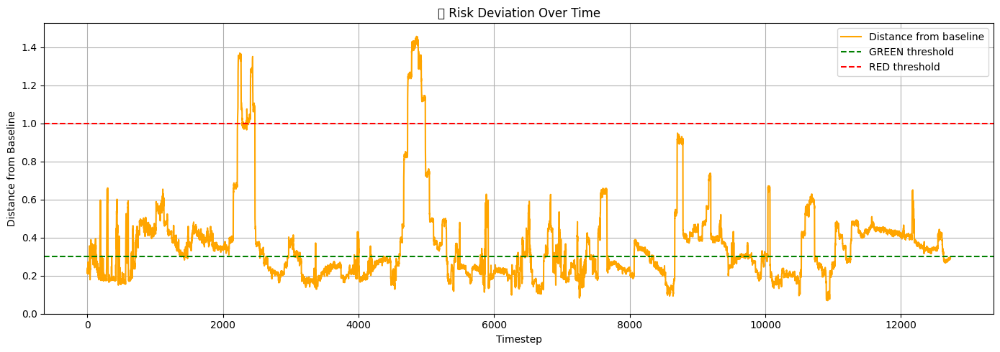

In [ ]:
plt.figure(figsize=(14, 5))
plt.plot(distances, label="Distance from baseline", color='orange')
plt.axhline(0.3, color='green', linestyle='--', label="GREEN threshold")
plt.axhline(1.0, color='red', linestyle='--', label="RED threshold")
plt.xlabel("Timestep")
plt.ylabel("Distance from Baseline")
plt.title("🧠 Risk Deviation Over Time")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()


## Sensitivity by pollutant

In [ ]:
def track_pollutant_reactions(
    model, dataset, device, scaler,
    baseline_vec, risk_indices, pollution_name, threshold
):
    """
    Track deviations from baseline ONLY when pollution_name > threshold
    Returns: list of (timestep, deviation)
    """
    deviations = []
    model.eval()

    with torch.no_grad():
        for i in range(len(dataset)):
            input_seq, _ = dataset[i]
            input_seq = input_seq.unsqueeze(1).to(device)

            output, _, _, _ = model(input_seq)
            output = output.squeeze(0).cpu().numpy()

            # Inverse scale
            output_full = np.zeros((scaler.n_features_in_,))
            output_full[:output.shape[0]] = output
            output_orig = scaler.inverse_transform(output_full.reshape(1, -1))[0]

            pollution_val = output_orig[feature_cols.index(pollution_name)]

            if pollution_val > threshold:
                pred_risk_vec = output_orig[risk_indices]
                dist = np.linalg.norm(pred_risk_vec - baseline_vec)
                deviations.append((i, dist))

    return deviations


In [ ]:
pollutant = "pm2_5_x"
threshold = 55.0  # Example

deviations = track_pollutant_reactions(
    model=fine_tune_model,
    dataset=val_dataset,
    device=device,
    scaler=scaler,
    baseline_vec=baseline_pred_vector,
    risk_indices=risk_indices,
    pollution_name=pollutant,
    threshold=threshold
)


/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128201 (\N{CHART WITH DOWNWARDS TREND}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


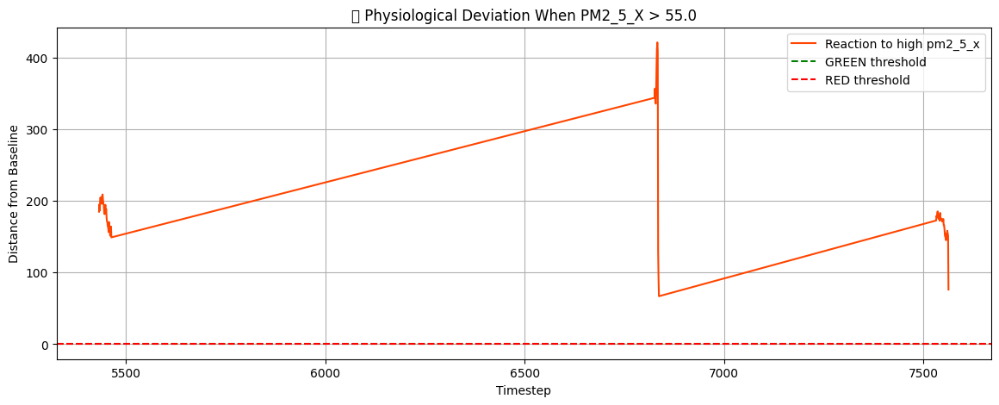

In [ ]:
import matplotlib.pyplot as plt

timesteps, distances = zip(*deviations)

plt.figure(figsize=(14, 5))
plt.plot(timesteps, distances, label=f'Reaction to high {pollutant}', color='orangered')

plt.axhline(y=0.3, color='green', linestyle='--', label='GREEN threshold')
plt.axhline(y=1.0, color='red', linestyle='--', label='RED threshold')

plt.title(f"📉 Physiological Deviation When {pollutant.upper()} > {threshold}")
plt.xlabel("Timestep")
plt.ylabel("Distance from Baseline")
plt.legend()
plt.grid(True)
plt.show()
